In [437]:
#General properties
import os
import struct
import numpy as np
import matplotlib.pyplot as plt
imageSize = 28

In [438]:
#read mnist dataset
def read(dataset = "training", path = "."):
    if dataset is "training":
        fname_img = os.path.join(path, 'train-images-idx3-ubyte')
        fname_lbl = os.path.join(path, 'train-labels-idx1-ubyte')
    elif dataset is "testing":
        fname_img = os.path.join(path, 't10k-images-idx3-ubyte')
        fname_lbl = os.path.join(path, 't10k-labels-idx1-ubyte')
    else:
        raise ValueError( "dataset must be 'testing' or 'training'")

    # Load everything in some numpy arrays
    with open(fname_lbl, 'rb') as flbl:
        magic, num = struct.unpack(">II", flbl.read(8))
        lbl = np.fromfile(flbl, dtype=np.int8)

    with open(fname_img, 'rb') as fimg:
        magic, num, rows, cols = struct.unpack(">IIII", fimg.read(16))
        img = np.fromfile(fimg, dtype=np.uint8).reshape(len(lbl), rows, cols)

    get_img = lambda idx: (lbl[idx], img[idx])

    # Create an iterator which returns each image in turn
    for i in range(len(lbl)):
        yield get_img(i)

def show(image):
    from matplotlib import pyplot
    import matplotlib as mpl
    fig = pyplot.figure()
    ax = fig.add_subplot(1,1,1)
    imgplot = ax.imshow(image, cmap=mpl.cm.Greys)
    imgplot.set_interpolation('nearest')
    ax.xaxis.set_ticks_position('top')
    ax.yaxis.set_ticks_position('left')
    pyplot.show()

In [456]:
#Main calculation block
def h(theta, x):
    a = 1 / (1 + np.exp(-np.dot(theta, x.T)))
    if a is np.array:
        #Prevent 0's and inf under log function
        a[np.where(a == 0)] = 10 ** -9
        a[np.where(a == 1)] = 0.999999
    return a

def bias(x):
    count, col = x.shape
    return np.column_stack((np.ones(count), x))     

def train(x, y, lr=0.1, iter=50,rr=0):
    bias_ = bias(x)
    thetha = np.zeros(bias_.shape[1], dtype=np.float128)
    costs = np.zeros(iter)   
    for i in range(iter):
        a = (1 / x.shape[0])
        a1 = h(thetha,bias_)
        b = np.dot(-y, np.log(a1))
        c = np.dot((1 - y), np.log(1 - h(thetha, bias_)))
        costs[i] =  a * np.sum(b - c)
        thetha_new = thetha - lr * (1/ (x.shape[0])) * np.sum((h(thetha, bias_) - y)* bias_.T, axis=1)
        thetha_reg = thetha * (rr / x.shape[0])
        thetha_reg[0] = 0
        thetha = thetha_new + thetha_reg
    return thetha, costs

def normalize(y):
    x = np.copy(y)
    m, features = x.shape
    
    for i in range(features):
        div = (x[0:, i].max() - x[0:, i].min())
        if div == 0:
            x[0:, i] = 0
        else :
            x[0:, i] = (x[0:, i] - x[0:, i].min()) / div
    return x

In [457]:
#Training mnist
mnist = list(read("training"))

In [458]:
#Mnist to predict
mnistP = list(read("testing"))

In [459]:
#fun to create dataset for each 0..9 number
#training mnist by default
def createFeature(sign = 0, data = mnist): 
    n = len(data)
    features = np.zeros((n, imageSize ** 2))
    labels = np.zeros((n, 1))
    for i in range(n):
        label, pixels = data[i]
        features[i, : imageSize**2] = pixels.flatten()
        if label == sign:
            labels[i] = 1
        else:
            labels[i] = 0
    return features, labels.flatten()

In [460]:
def createDataSets():
    FNorm = normalize(FD)
    return FNorm,[oneL, twoL, threeL, fourL, fiveL, sixL, sevenL, eightL, nineL, zeroL]

In [461]:
#Training datasets for each number
FD, oneL = createFeature(1)
twoL = createFeature(2)[1]
threeL = createFeature(3)[1]
fourL = createFeature(4)[1]
fiveL = createFeature(5)[1]
sixL = createFeature(6)[1]
sevenL = createFeature(7)[1]
eightL = createFeature(8)[1]
nineL = createFeature(9)[1]
zeroL = createFeature(0)[1]

In [462]:
#Training dataset combines all datasets
trainingF, trainingYs = createDataSets()

In [463]:
#Testing datasets for each number
FD, oneL = createFeature(1,mnistP)
twoL = createFeature(2,mnistP)[1]
threeL = createFeature(3,mnistP)[1]
fourL = createFeature(4,mnistP)[1]
fiveL = createFeature(5,mnistP)[1]
sixL = createFeature(6,mnistP)[1]
sevenL = createFeature(7,mnistP)[1]
eightL = createFeature(8,mnistP)[1]
nineL = createFeature(9,mnistP)[1]
zeroL = createFeature(0,mnistP)[1]

In [464]:
#Testing dataset combines all datasets
testingF, testingYs = createDataSets()

In [465]:
def trainAll():
    thethass = []
    costss = []
    for i in range(len(trainingYs)):
        thethas, costs = train(trainingF, trainingYs[i])
        thethass.append(thethas)
        costss.append(costs)
    print("trained")    
    return thethass, costss

In [469]:
#Predict fun
def predict(theta, x):
    m, features = x.shape
    x_bias = np.column_stack((np.ones(m), x))
    y = h(theta, x_bias)
    return y

def predictAll(thethas, xs):
    prs = []
    for i in range(len(thethas)):
        pr = predict(thethas[i], xs)
        prs.append(pr)
    return prs

In [467]:
thethas, costs = trainAll()

trained


image


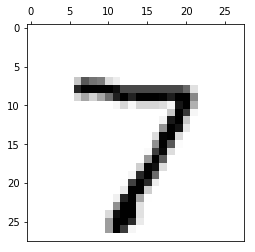

this is number
7
accuracy
0.868134913399


image


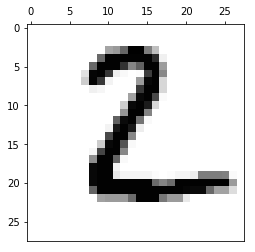

this is number
2
accuracy
0.41135330698


image


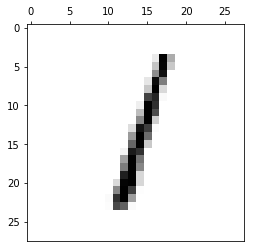

this is number
1
accuracy
0.792053449952


image


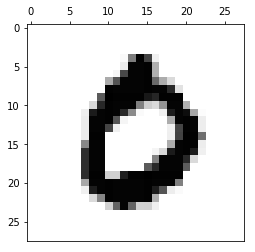

this is number
0
accuracy
0.562708072125


image


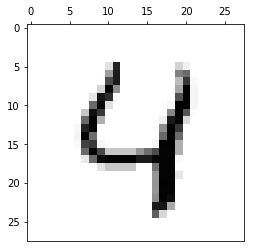

this is number
4
accuracy
0.582601342538


image


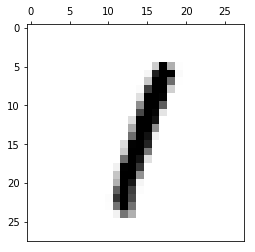

this is number
1
accuracy
0.804704146519


image


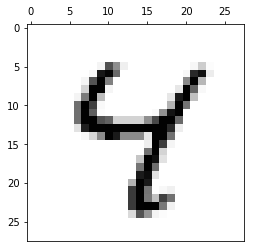

this is number
4
accuracy
0.420248949574


image


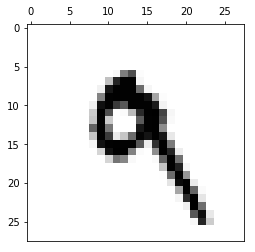

this is number
9
accuracy
0.33455865384


image


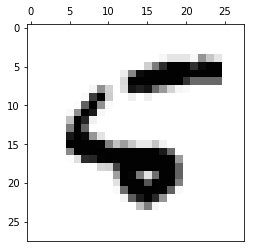

image


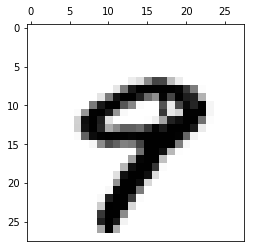

image


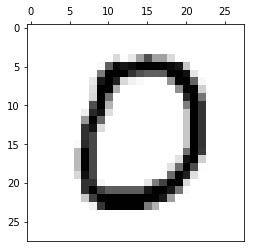

this is number
0
accuracy
0.870308230355


image


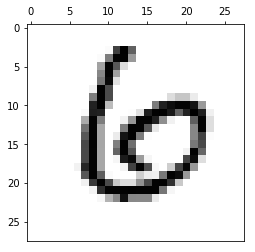

image


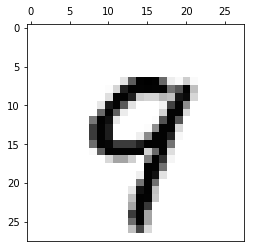

this is number
9
accuracy
0.519061670305


image


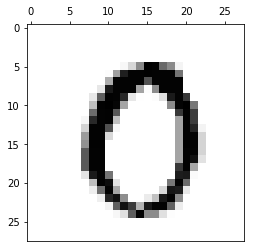

this is number
0
accuracy
0.811399937942


image


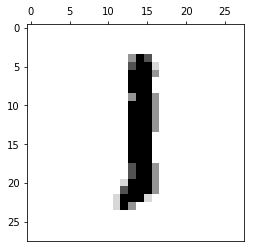

this is number
1
accuracy
0.737388448154


image


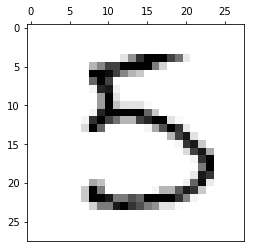

this is number
3
accuracy
0.451341938198


this is number
5
accuracy
0.325021460955


image


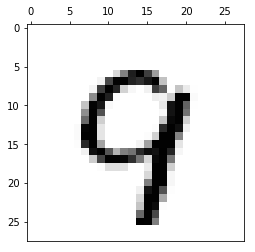

this is number
4
accuracy
0.306993259716


this is number
9
accuracy
0.39333721896


image


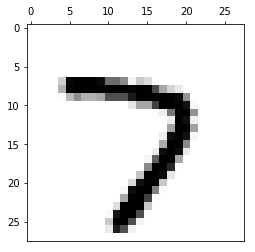

this is number
7
accuracy
0.801743054007


image


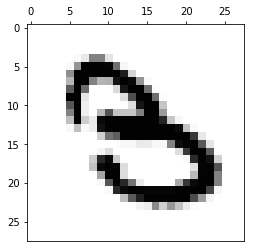

image


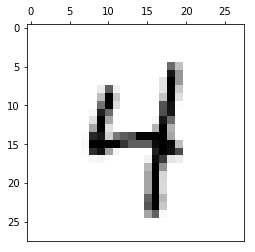

this is number
4
accuracy
0.669315120493


this is number
9
accuracy
0.455346941772


image


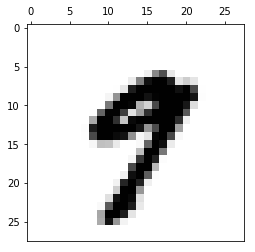

image


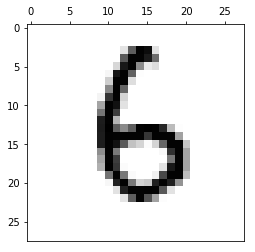

this is number
6
accuracy
0.675350307882


image


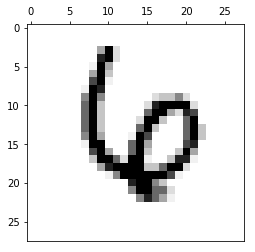

image


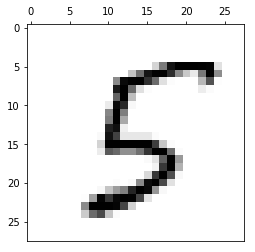

this is number
5
accuracy
0.418831655971


image


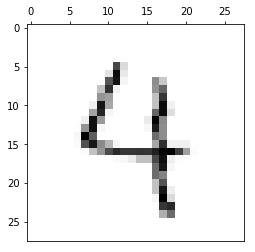

this is number
4
accuracy
0.574111449816


this is number
9
accuracy
0.424295393164


image


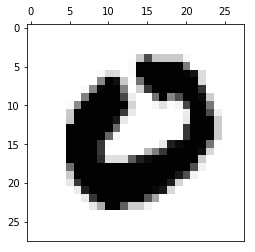

this is number
0
accuracy
0.785197819918


image


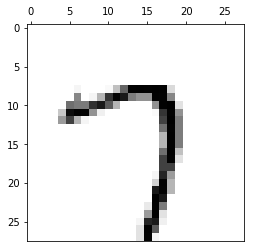

this is number
7
accuracy
0.70120875181


this is number
9
accuracy
0.435400800366


image


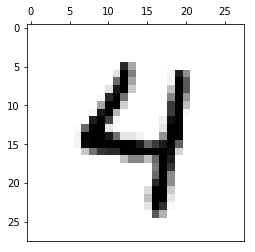

this is number
4
accuracy
0.669681489503


this is number
9
accuracy
0.370837936906


image


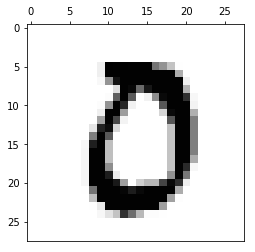

this is number
0
accuracy
0.605238572883


image


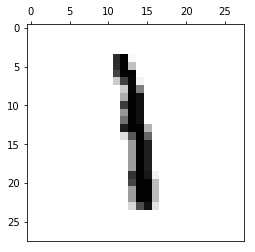

this is number
1
accuracy
0.52723907429


image


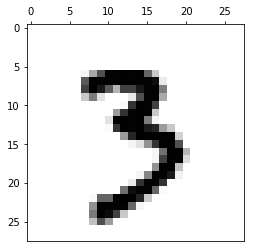

this is number
3
accuracy
0.5793320675


image


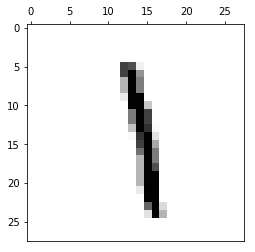

this is number
1
accuracy
0.473737874292


image


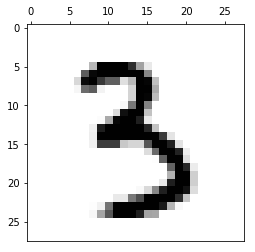

this is number
3
accuracy
0.668049230741


this is number
5
accuracy
0.305131190037


image


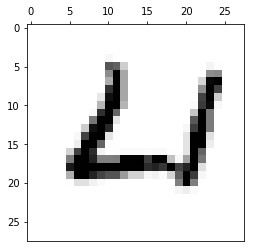

this is number
4
accuracy
0.302711061939


this is number
6
accuracy
0.548657227367


this is number
0
accuracy
0.622657089442


image


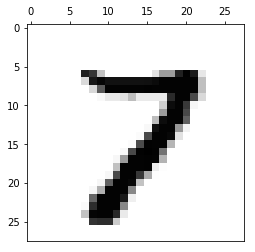

this is number
7
accuracy
0.40192376311


image


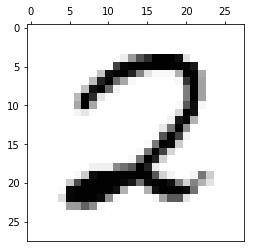

this is number
2
accuracy
0.77338369787


image


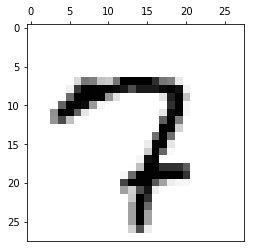

this is number
7
accuracy
0.69377860282


image


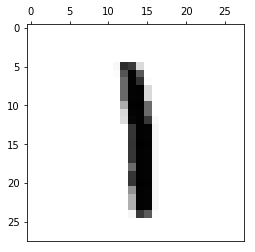

this is number
1
accuracy
0.66694636329


image


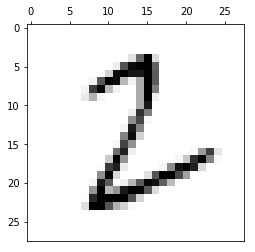

this is number
3
accuracy
0.403924729175


image


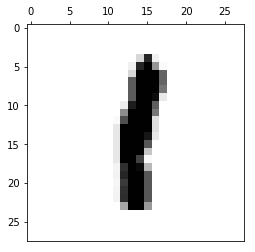

this is number
1
accuracy
0.751127006377


image


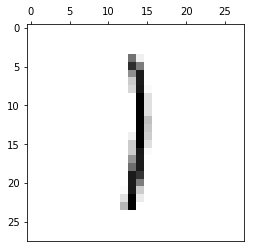

this is number
1
accuracy
0.716195904914


image


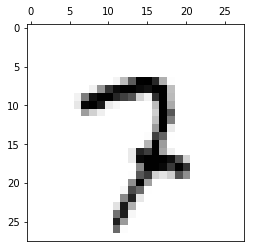

this is number
7
accuracy
0.654582649051


this is number
9
accuracy
0.344945661603


image


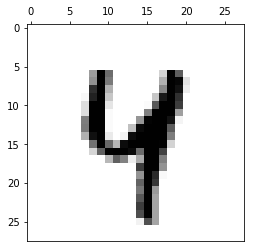

this is number
4
accuracy
0.482045288055


image


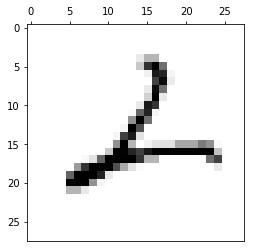

this is number
1
accuracy
0.364074667622


this is number
2
accuracy
0.479797576189


image


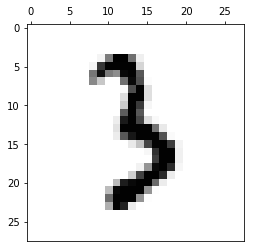

this is number
3
accuracy
0.391326237039


image


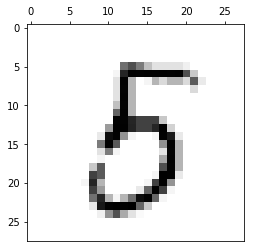

this is number
3
accuracy
0.543610862373


this is number
5
accuracy
0.437609380406


this is number
8
accuracy
0.33664818271


image


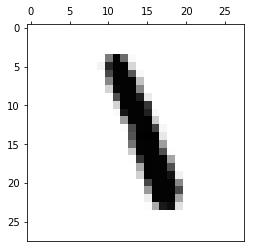

image


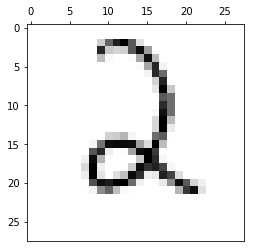

this is number
2
accuracy
0.605833166052


image


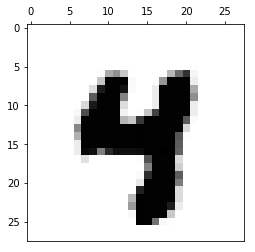

this is number
4
accuracy
0.405562718736


image


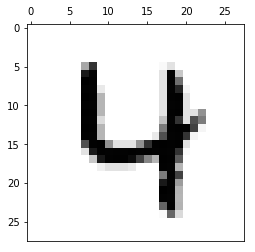

this is number
4
accuracy
0.684846317632


image


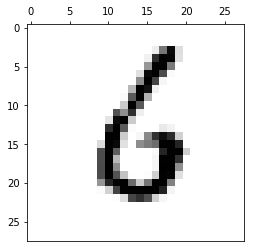

this is number
6
accuracy
0.696478798344


image


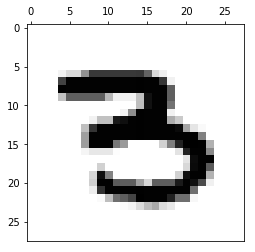

image


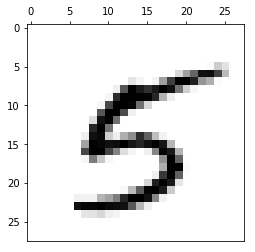

this is number
5
accuracy
0.339416037303


image


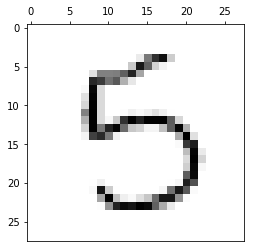

this is number
3
accuracy
0.468753842435


this is number
5
accuracy
0.35200765305


image


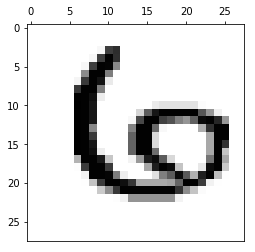

image


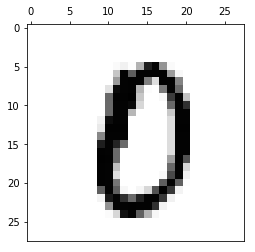

this is number
8
accuracy
0.349468500424


this is number
0
accuracy
0.351071464784


image


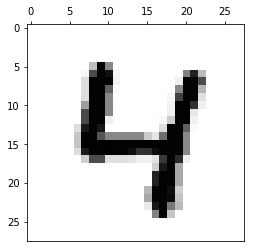

this is number
4
accuracy
0.733513531755


image


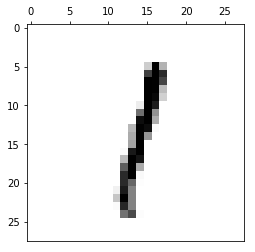

this is number
1
accuracy
0.794320549477


image


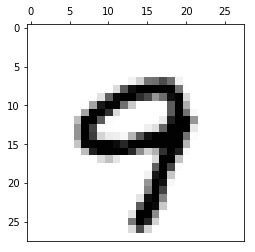

this is number
4
accuracy
0.338967731685


this is number
9
accuracy
0.470355808797


image


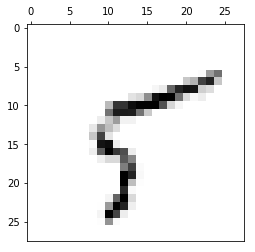

image


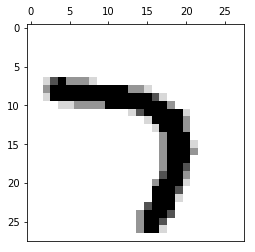

this is number
7
accuracy
0.642695744529


image


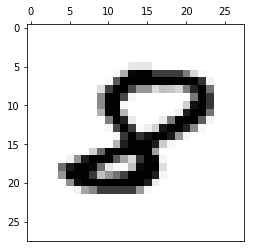

image


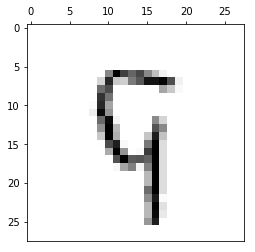

this is number
4
accuracy
0.304901559135


this is number
9
accuracy
0.399140867249


image


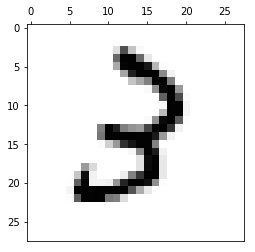

this is number
2
accuracy
0.30860788961


image


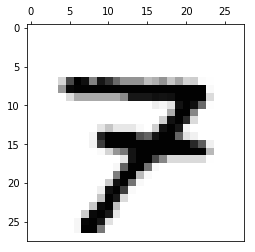

image


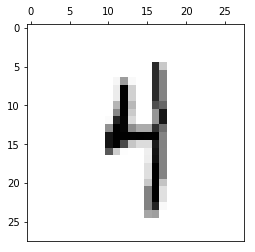

this is number
9
accuracy
0.331808438816


image


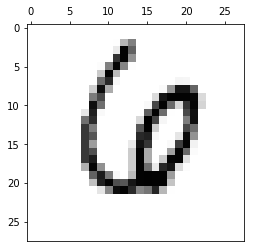

image


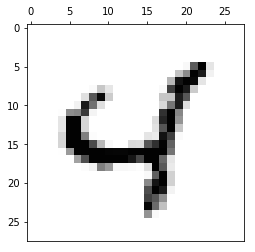

this is number
4
accuracy
0.686011595583


image


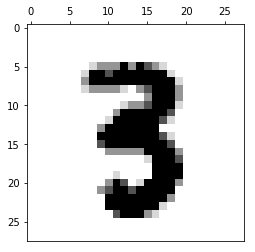

this is number
3
accuracy
0.417986149365


image


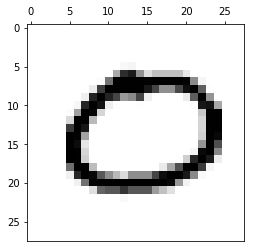

this is number
0
accuracy
0.772782864463


image


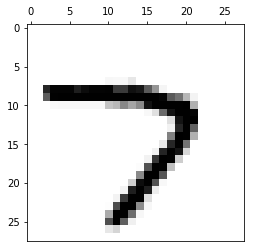

this is number
7
accuracy
0.835493051552


image


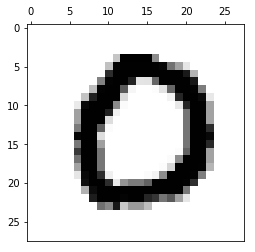

this is number
0
accuracy
0.931892744216


image


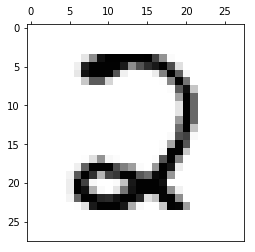

this is number
2
accuracy
0.561475189371


this is number
3
accuracy
0.386958502039


this is number
0
accuracy
0.424415899966


image


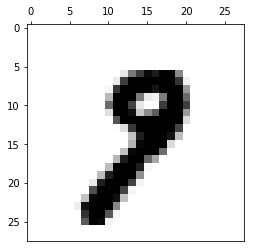

image


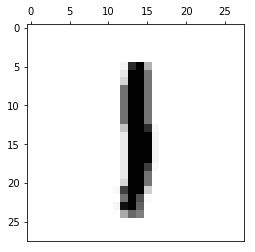

this is number
1
accuracy
0.680614072694


image


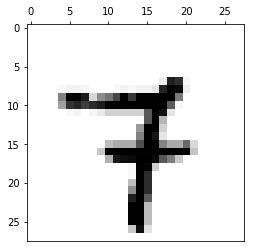

this is number
7
accuracy
0.369744602463


image


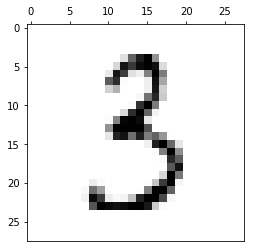

this is number
3
accuracy
0.7582722987


this is number
5
accuracy
0.310125859024


image


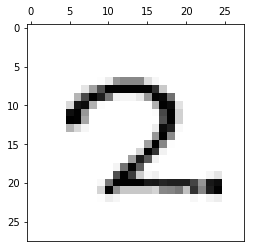

this is number
7
accuracy
0.566882135785


image


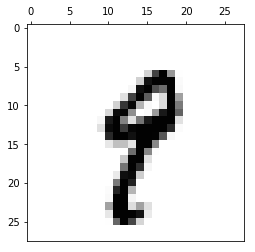

image


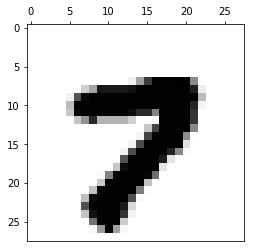

this is number
7
accuracy
0.634159638323


image


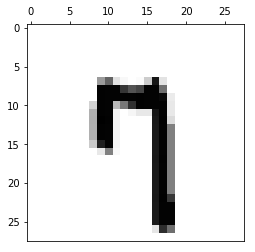

this is number
7
accuracy
0.377460394695


this is number
9
accuracy
0.476491557491


image


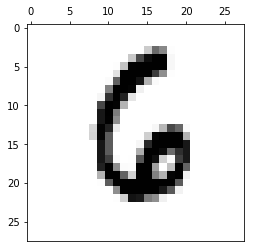

this is number
6
accuracy
0.600022944256


image


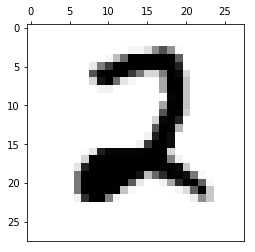

this is number
2
accuracy
0.928580167553


image


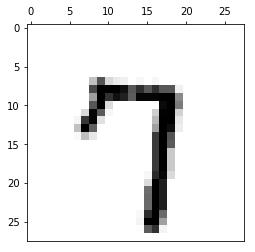

this is number
7
accuracy
0.703625111587


this is number
9
accuracy
0.467368431415


image


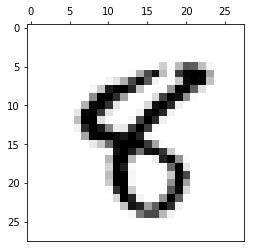

image


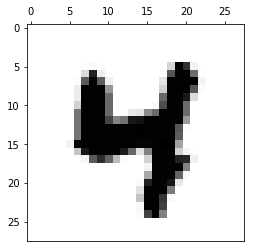

this is number
4
accuracy
0.578976706003


image


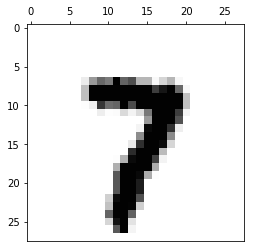

this is number
7
accuracy
0.68458847613


image


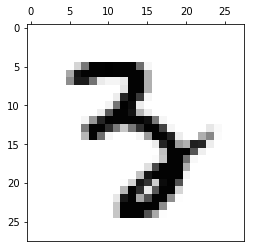

this is number
3
accuracy
0.432689150141


image


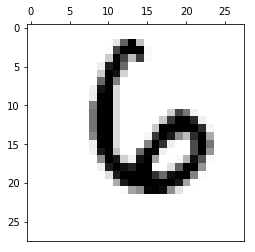

this is number
6
accuracy
0.717211929134


image


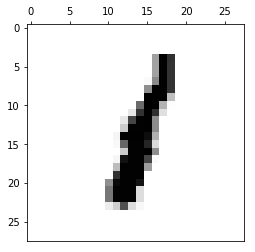

this is number
1
accuracy
0.782508627825


image


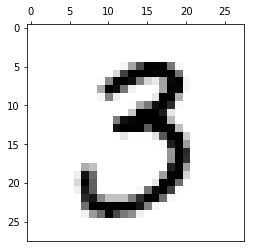

this is number
3
accuracy
0.781030598711


image


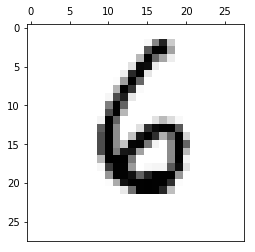

this is number
6
accuracy
0.792217857676


image


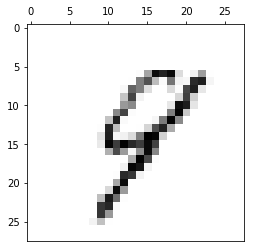

this is number
8
accuracy
0.327087363392


image


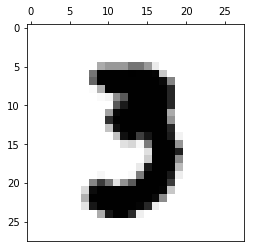

this is number
3
accuracy
0.372168871265


image


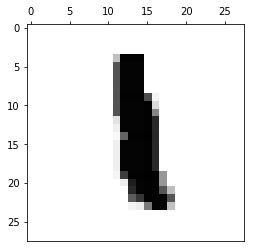

this is number
1
accuracy
0.324289712447


image


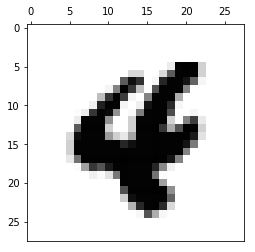

image


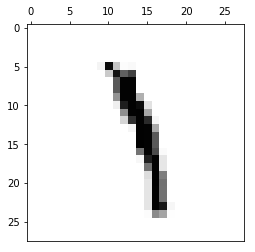

image


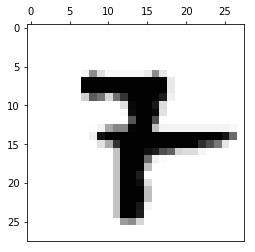

image


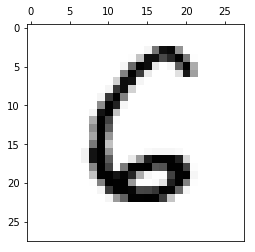

this is number
6
accuracy
0.613516204417


image


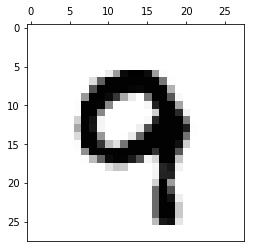

this is number
9
accuracy
0.395366081293


image


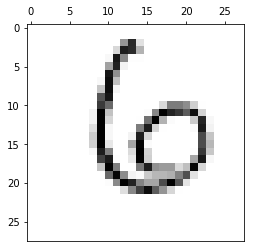

this is number
6
accuracy
0.452833302345


image


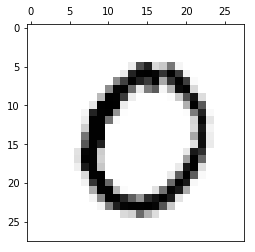

this is number
0
accuracy
0.858327752324


image


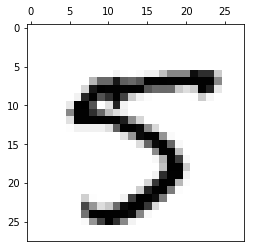

this is number
5
accuracy
0.473811904876


image


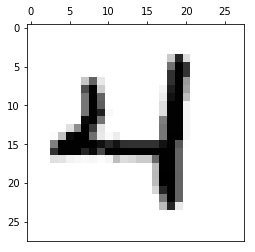

this is number
4
accuracy
0.750142306857


image


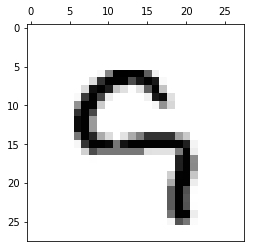

image


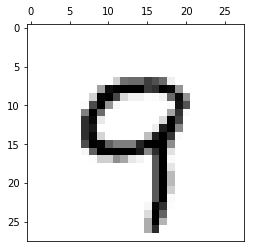

this is number
4
accuracy
0.389909176316


this is number
9
accuracy
0.595409312487


image


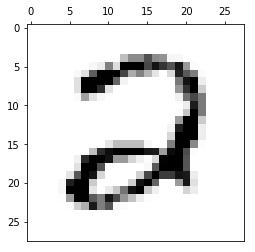

this is number
2
accuracy
0.642809230847


this is number
0
accuracy
0.353173288459


image


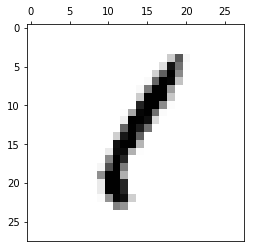

this is number
1
accuracy
0.648653268527


this is number
8
accuracy
0.306309948687


image


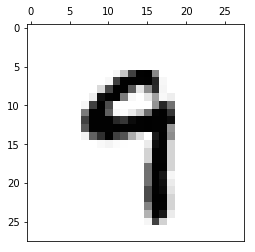

this is number
9
accuracy
0.465893591223


image


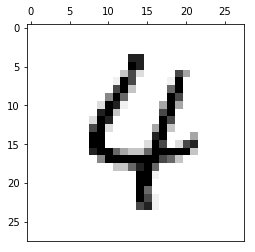

this is number
4
accuracy
0.481457092104


image


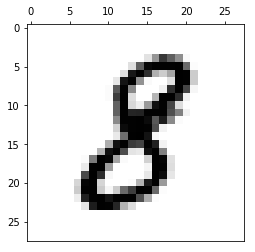

image


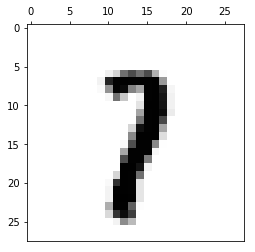

this is number
1
accuracy
0.494394529708


image


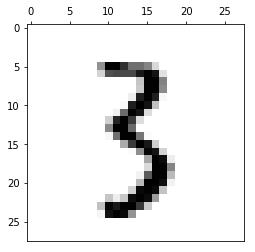

this is number
3
accuracy
0.430247482216


image


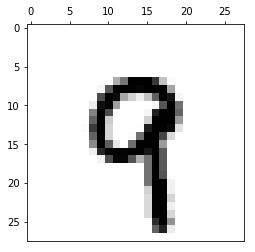

this is number
9
accuracy
0.571542799685


image


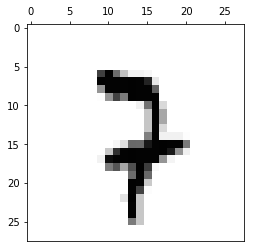

image


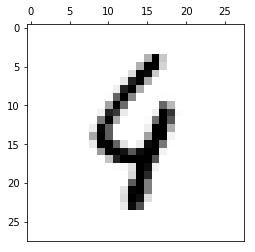

image


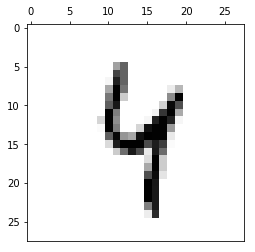

this is number
4
accuracy
0.443067098296


this is number
9
accuracy
0.388297292288


image


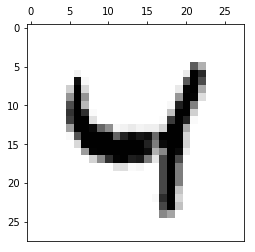

this is number
4
accuracy
0.790321451097


image


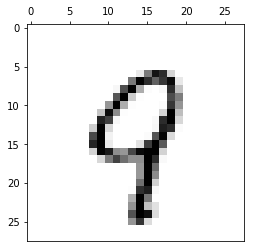

this is number
4
accuracy
0.332852048722


this is number
9
accuracy
0.48173795948


image


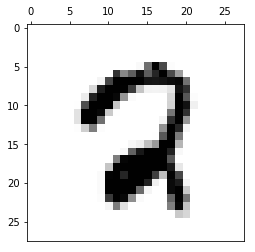

image


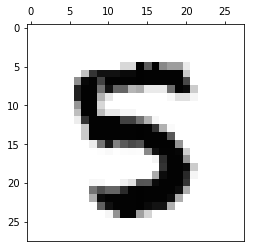

this is number
3
accuracy
0.305592879229


image


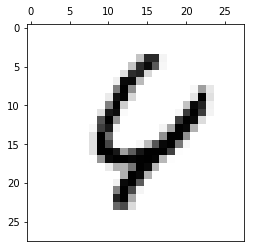

this is number
6
accuracy
0.31226843007


image


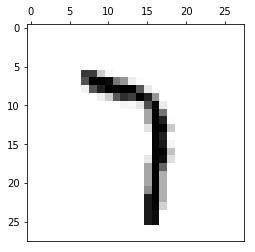

this is number
7
accuracy
0.568788258655


this is number
9
accuracy
0.312477926158


image


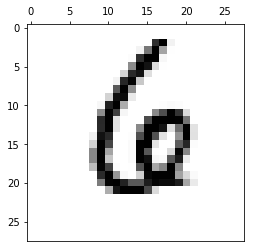

this is number
6
accuracy
0.619738823318


image


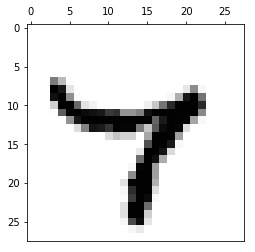

this is number
4
accuracy
0.319905454346


image


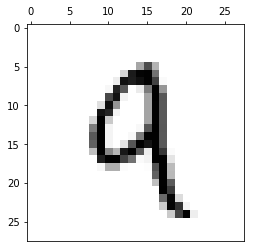

this is number
9
accuracy
0.399660960985


image


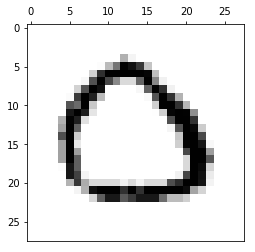

this is number
2
accuracy
0.351163591504


this is number
3
accuracy
0.357635598254


this is number
0
accuracy
0.577400877029


image


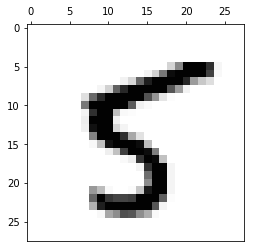

this is number
5
accuracy
0.39726728374


image


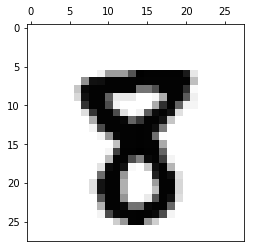

this is number
8
accuracy
0.328814231337


image


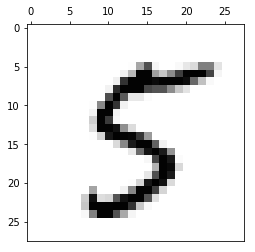

this is number
5
accuracy
0.408306192005


image


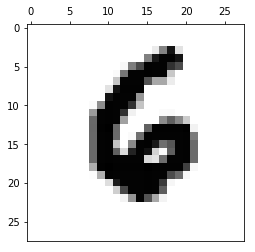

this is number
6
accuracy
0.681636562293


image


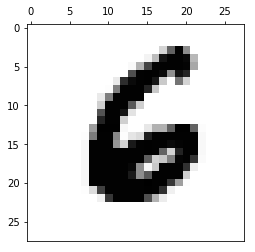

this is number
6
accuracy
0.598530011917


image


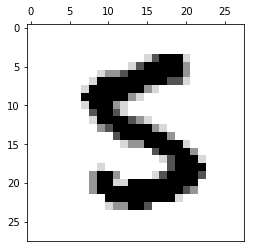

image


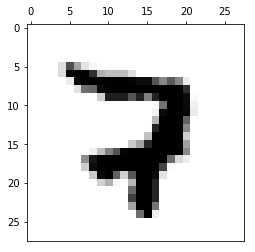

image


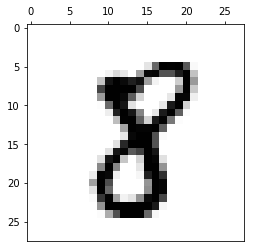

this is number
8
accuracy
0.593033248289


image


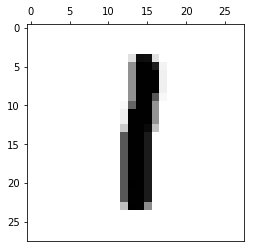

this is number
1
accuracy
0.7801723838


image


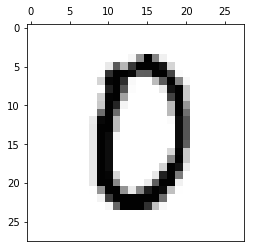

this is number
0
accuracy
0.503202329785


image


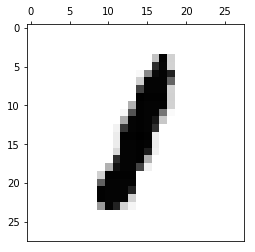

this is number
1
accuracy
0.752486325299


image


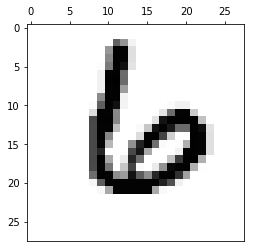

this is number
6
accuracy
0.732039496877


image


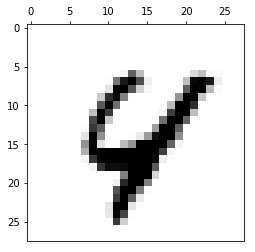

this is number
4
accuracy
0.310914978549


image


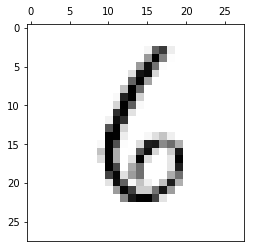

this is number
6
accuracy
0.599103919276


image


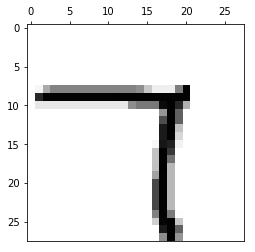

this is number
7
accuracy
0.774682404659


this is number
9
accuracy
0.3162428448


image


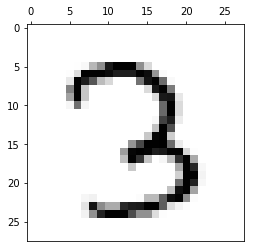

this is number
2
accuracy
0.304607903012


this is number
3
accuracy
0.449724109825


image


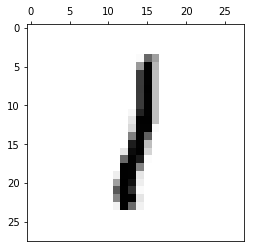

this is number
1
accuracy
0.828012634746


image


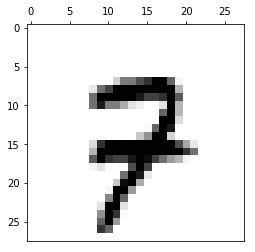

this is number
7
accuracy
0.310038754986


image


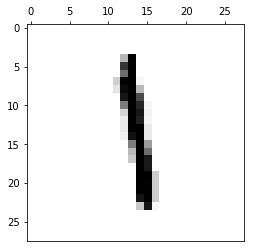

this is number
1
accuracy
0.532939369439


image


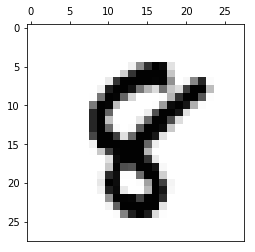

this is number
8
accuracy
0.314123695423


image


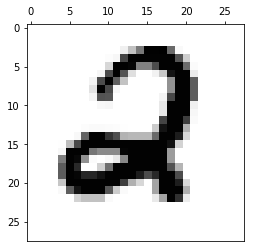

this is number
2
accuracy
0.721148823336


image


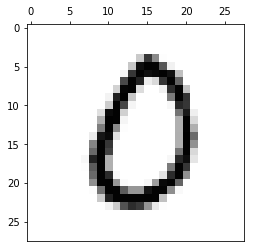

this is number
0
accuracy
0.716921392527


image


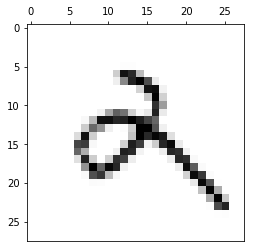

image


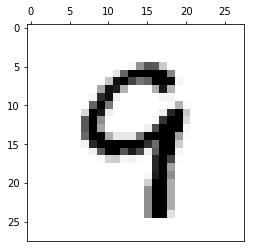

this is number
4
accuracy
0.305170361931


this is number
9
accuracy
0.433170222046


image


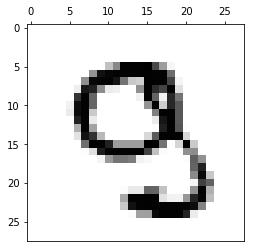

image


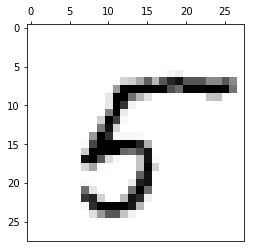

this is number
5
accuracy
0.305580334098


image


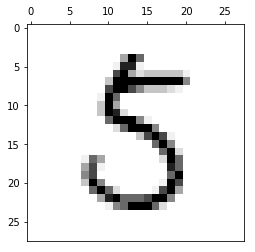

this is number
3
accuracy
0.373280269858


this is number
5
accuracy
0.397042625865


image


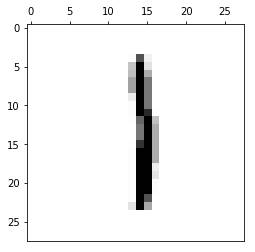

this is number
1
accuracy
0.605891426357


image


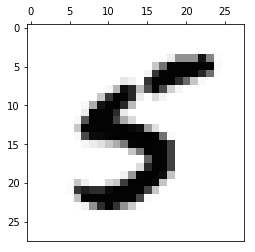

this is number
5
accuracy
0.334283839058


image


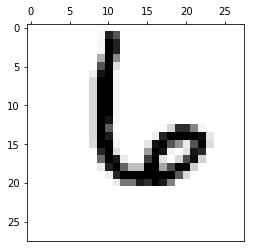

this is number
4
accuracy
0.394926480359


this is number
6
accuracy
0.740751750613


image


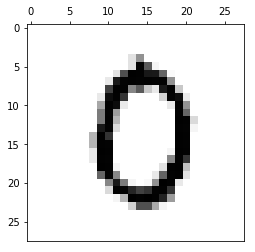

this is number
0
accuracy
0.469957695948


image


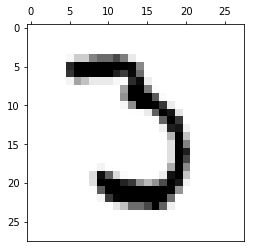

this is number
3
accuracy
0.499492022867


image


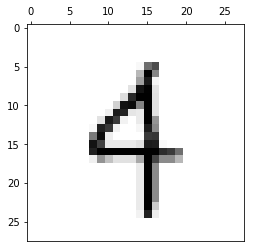

image


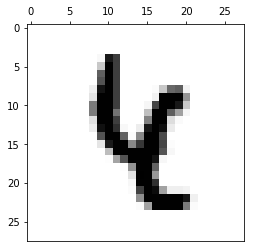

this is number
4
accuracy
0.43832265125


image


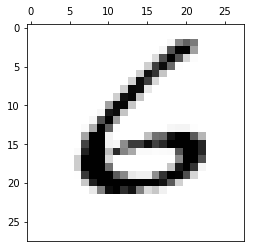

this is number
6
accuracy
0.843016786987


this is number
0
accuracy
0.415110848165


image


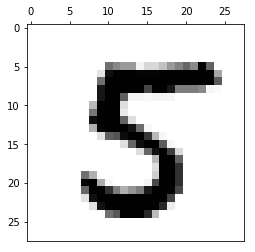

this is number
5
accuracy
0.582867365871


image


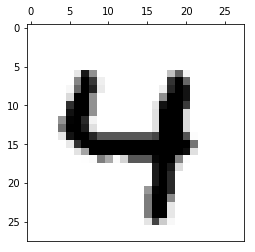

this is number
4
accuracy
0.725987646467


image


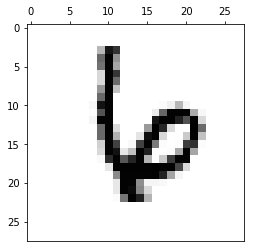

this is number
6
accuracy
0.439442611449


image


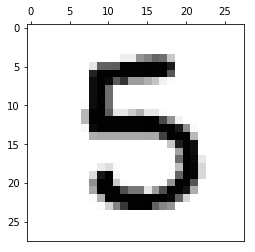

this is number
3
accuracy
0.402428928722


image


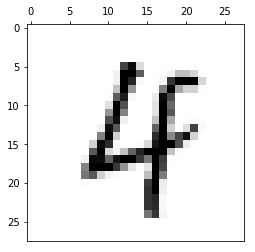

this is number
4
accuracy
0.344191363584


image


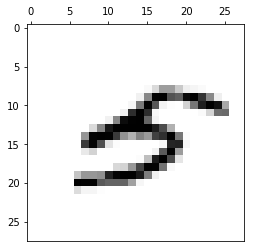

image


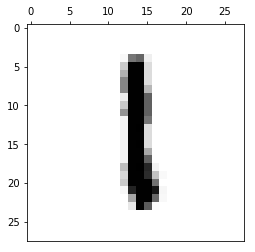

this is number
1
accuracy
0.680760654342


image


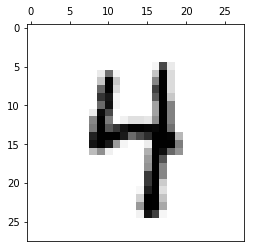

this is number
4
accuracy
0.432346929645


this is number
9
accuracy
0.380165602286


image


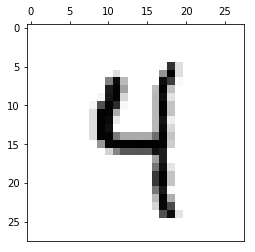

this is number
4
accuracy
0.505346449414


this is number
9
accuracy
0.456714584337


image


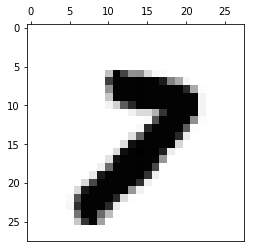

image


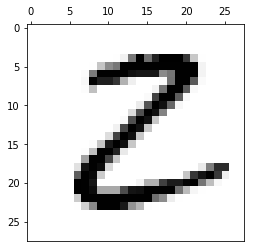

this is number
2
accuracy
0.391445464094


this is number
3
accuracy
0.598834281392


image


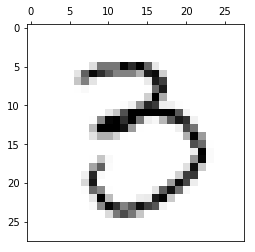

this is number
3
accuracy
0.603955221449


image


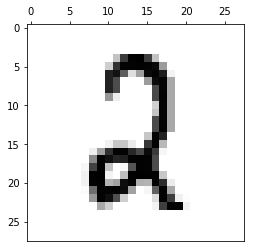

this is number
2
accuracy
0.603088289683


image


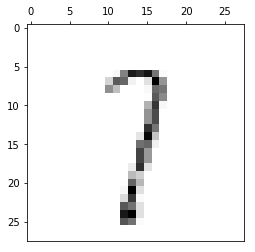

this is number
1
accuracy
0.447412353452


this is number
7
accuracy
0.302864521108


image


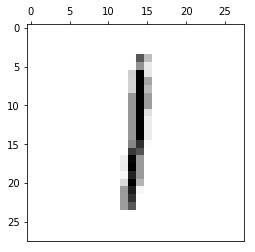

this is number
1
accuracy
0.747564384121


image


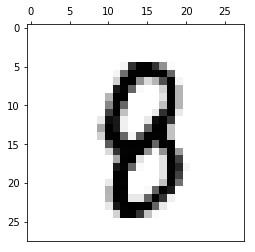

image


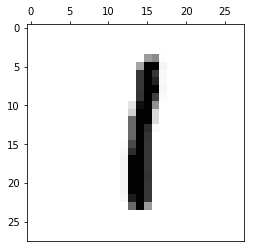

this is number
1
accuracy
0.794513947486


image


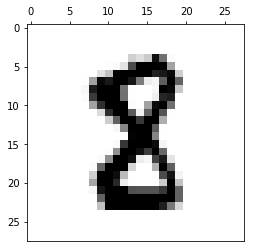

this is number
8
accuracy
0.376030592215


image


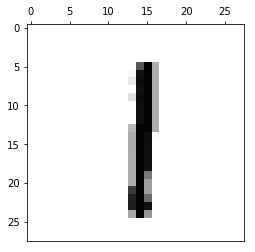

this is number
1
accuracy
0.738961009012


image


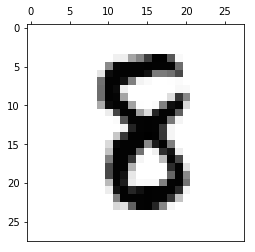

image


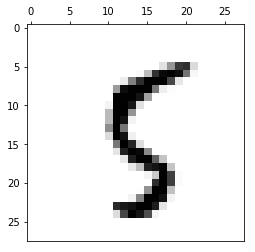

this is number
5
accuracy
0.358578115248


this is number
8
accuracy
0.336085868411


image


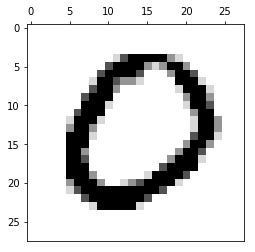

this is number
0
accuracy
0.888154225731


image


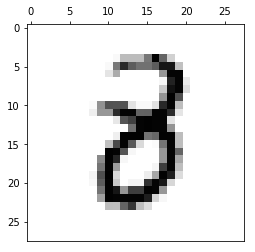

image


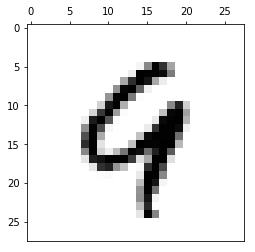

this is number
9
accuracy
0.378546353866


image


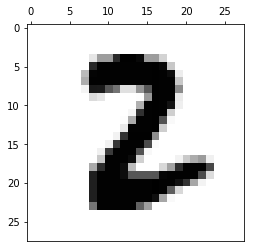

image


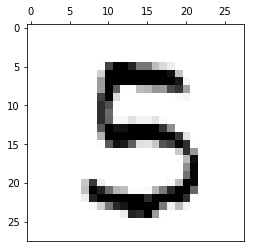

this is number
3
accuracy
0.444893826482


this is number
5
accuracy
0.321938058422


image


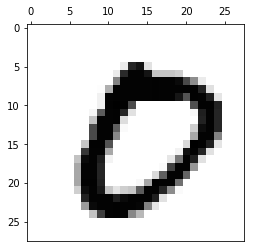

this is number
0
accuracy
0.882115081203


image


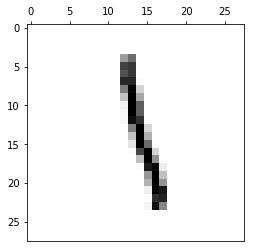

this is number
1
accuracy
0.406259604159


image


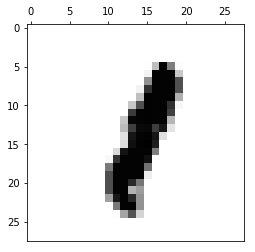

this is number
1
accuracy
0.593906489984


image


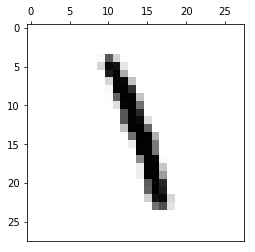

image


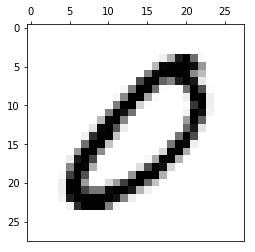

this is number
5
accuracy
0.311155586196


this is number
0
accuracy
0.76871678304


image


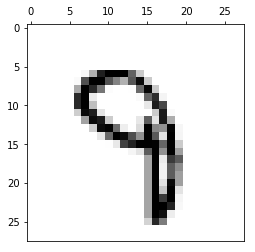

image


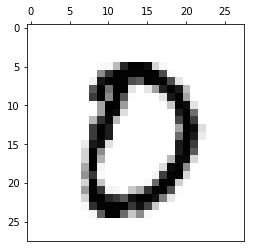

this is number
0
accuracy
0.707149618717


image


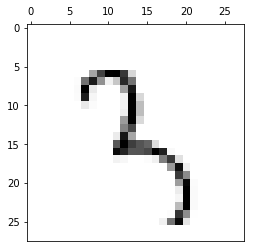

this is number
2
accuracy
0.319058293062


this is number
3
accuracy
0.34526701298


this is number
5
accuracy
0.306389845251


this is number
8
accuracy
0.350067942433


image


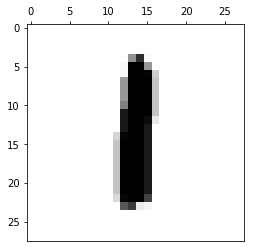

this is number
1
accuracy
0.70153443162


image


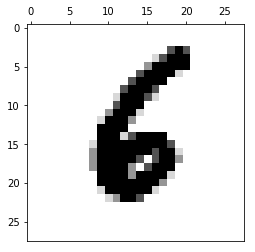

this is number
6
accuracy
0.484721633764


image


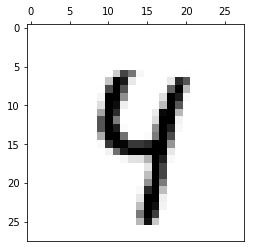

this is number
4
accuracy
0.506296231671


this is number
9
accuracy
0.391986104087


image


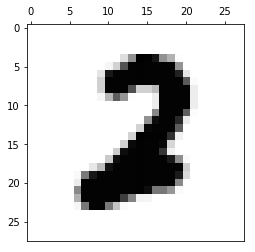

this is number
2
accuracy
0.37025172028


image


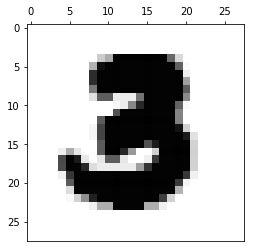

image


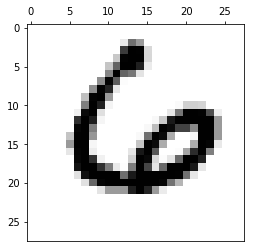

this is number
2
accuracy
0.337301843478


this is number
6
accuracy
0.564526625946


image


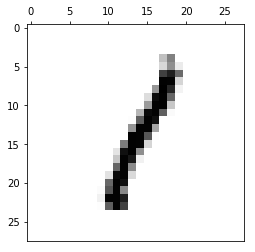

this is number
1
accuracy
0.723136677419


image


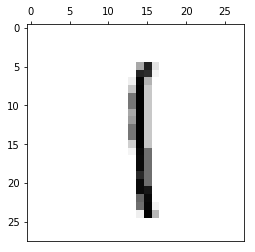

this is number
1
accuracy
0.672853943214


image


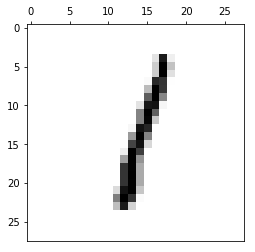

this is number
1
accuracy
0.787413589994


image


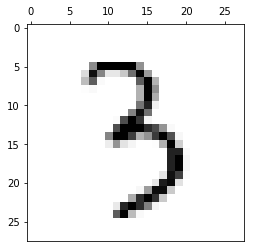

this is number
3
accuracy
0.74337363564


image


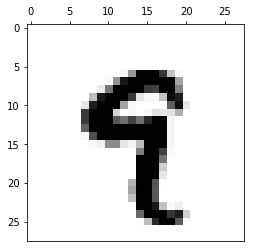

this is number
9
accuracy
0.429770570039


image


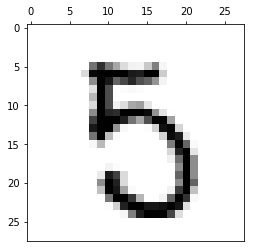

this is number
5
accuracy
0.301578796207


image


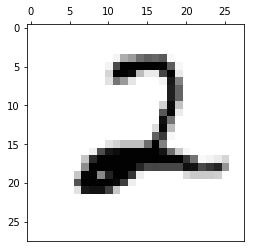

this is number
2
accuracy
0.878054059552


image


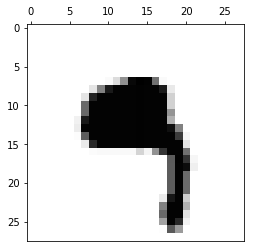

this is number
9
accuracy
0.327339595522


image


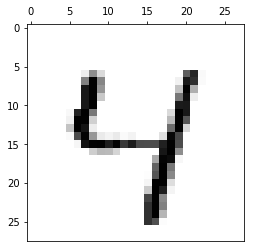

this is number
4
accuracy
0.610498737413


image


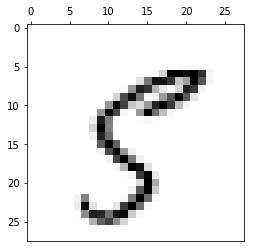

image


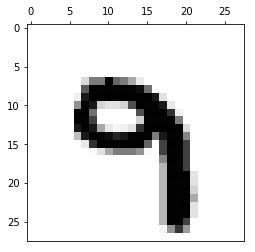

image


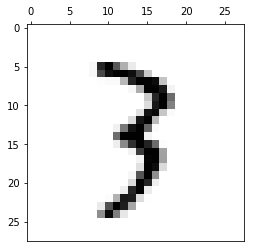

this is number
1
accuracy
0.30895513193


this is number
3
accuracy
0.34111792066


image


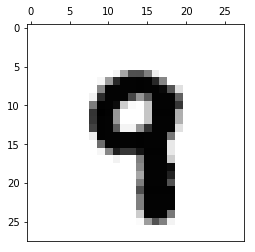

this is number
9
accuracy
0.371291070719


image


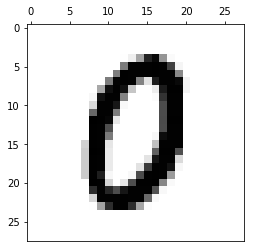

image


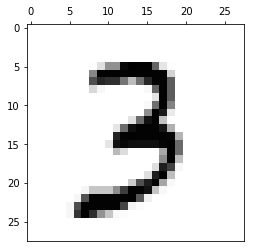

this is number
3
accuracy
0.706643317355


image


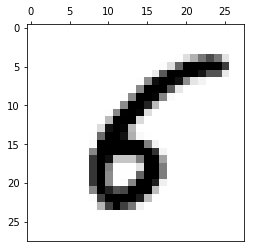

image


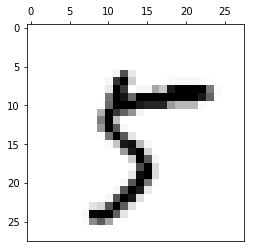

this is number
7
accuracy
0.348728862182


image


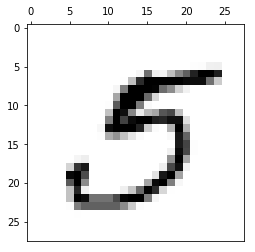

this is number
3
accuracy
0.396632594094


this is number
5
accuracy
0.424822733831


image


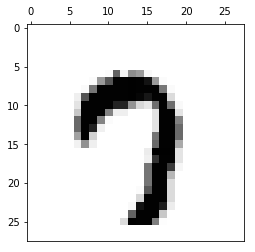

this is number
7
accuracy
0.622787338736


this is number
9
accuracy
0.426100967211


image


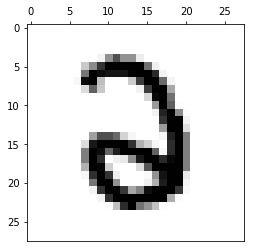

this is number
2
accuracy
0.317069267999


image


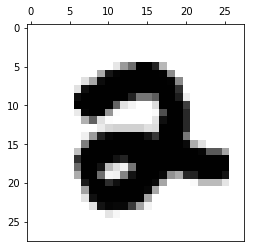

image


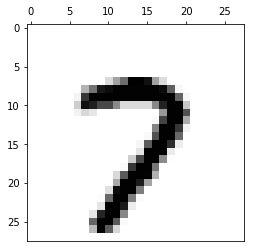

this is number
7
accuracy
0.848500466932


image


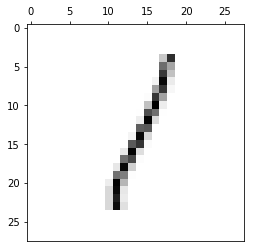

this is number
1
accuracy
0.695956185778


this is number
8
accuracy
0.307681649636


image


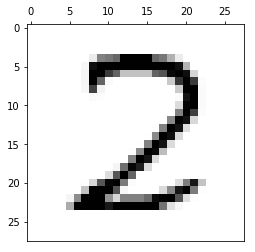

this is number
2
accuracy
0.561117989683


image


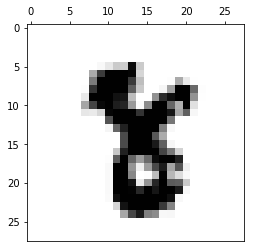

image


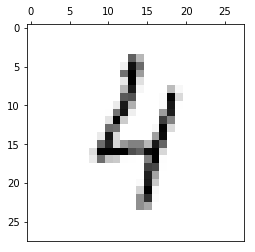

this is number
4
accuracy
0.421952118337


this is number
9
accuracy
0.332584876158


image


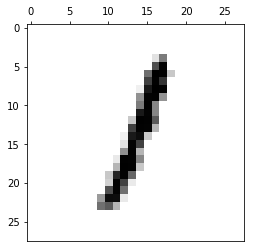

this is number
1
accuracy
0.818264332122


image


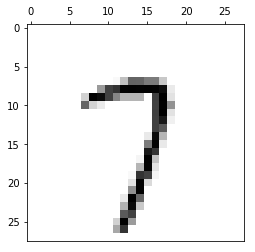

this is number
7
accuracy
0.699750212084


this is number
9
accuracy
0.421153626431


image


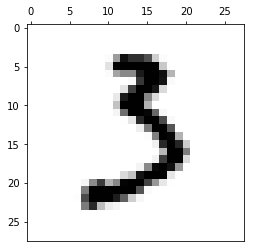

this is number
3
accuracy
0.348815742479


image


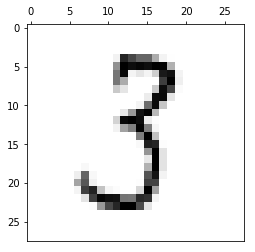

this is number
3
accuracy
0.559181838523


image


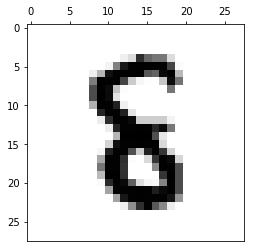

this is number
8
accuracy
0.357953118782


image


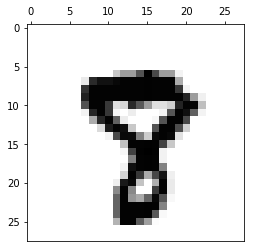

image


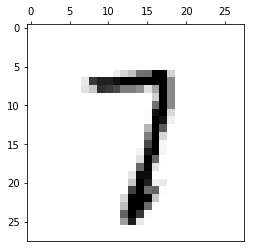

this is number
7
accuracy
0.380681002904


image


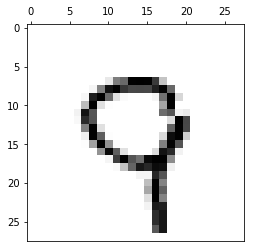

this is number
7
accuracy
0.358788973536


this is number
9
accuracy
0.470534917278


image


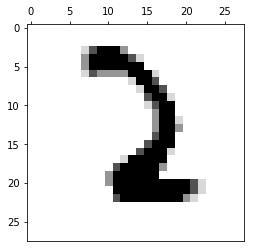

this is number
2
accuracy
0.402544321753


image


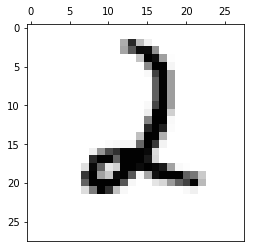

this is number
2
accuracy
0.679734604872


image


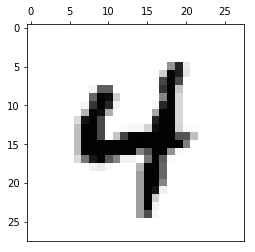

this is number
4
accuracy
0.70804637584


this is number
9
accuracy
0.342721338379


image


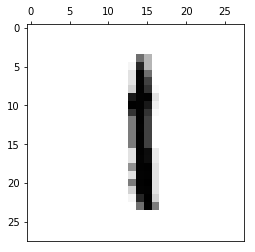

this is number
1
accuracy
0.721513018004


image


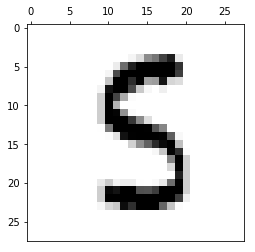

this is number
3
accuracy
0.347127238341


this is number
5
accuracy
0.319113545966


image


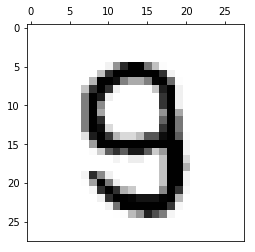

image


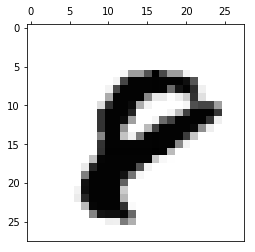

image


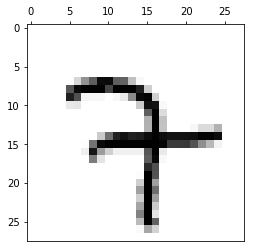

image


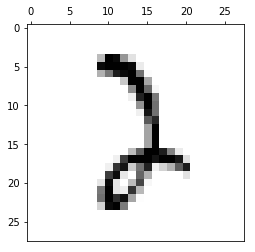

this is number
2
accuracy
0.327856467102


image


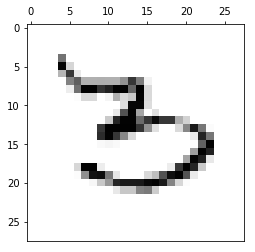

this is number
6
accuracy
0.534918918143


image


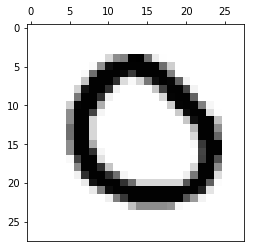

this is number
2
accuracy
0.423686422156


this is number
0
accuracy
0.796425097232


image


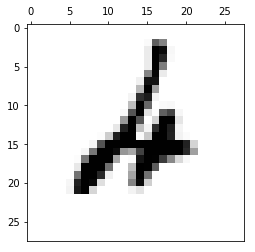

image


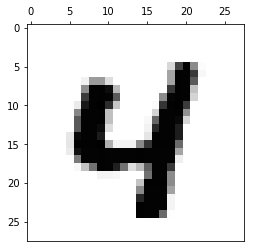

this is number
4
accuracy
0.662500148983


image


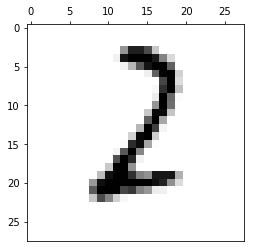

this is number
1
accuracy
0.375689351261


this is number
2
accuracy
0.481455990125


image


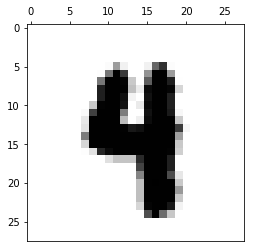

image


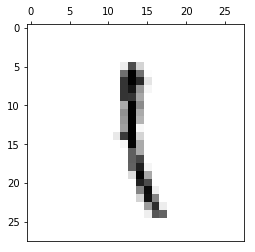

this is number
1
accuracy
0.469583029194


this is number
8
accuracy
0.320133055518


image


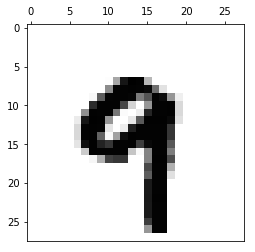

this is number
9
accuracy
0.478204199007


image


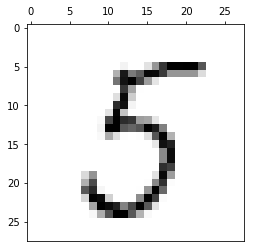

this is number
3
accuracy
0.501132247297


this is number
5
accuracy
0.531329991071


this is number
8
accuracy
0.38389290877


image


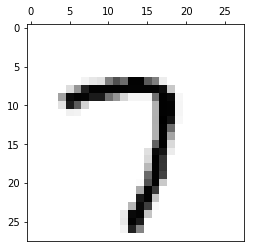

this is number
7
accuracy
0.754673765786


this is number
9
accuracy
0.381020378303


image


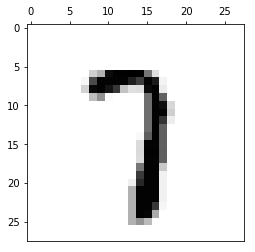

this is number
7
accuracy
0.341639999428


image


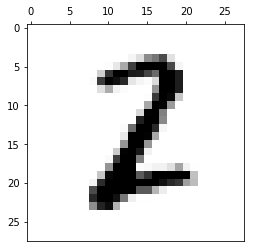

this is number
2
accuracy
0.303618735804


image


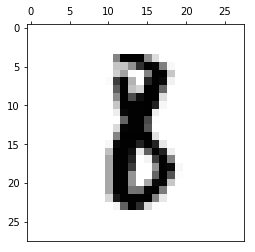

image


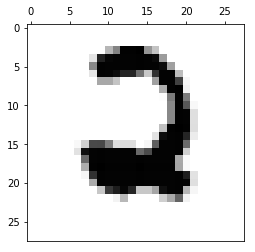

this is number
2
accuracy
0.818843337948


this is number
6
accuracy
0.3476638072


image


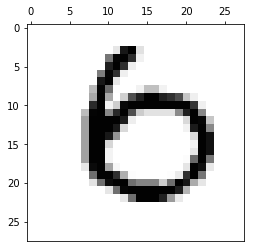

this is number
0
accuracy
0.555586110187


image


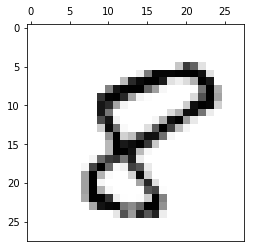

this is number
8
accuracy
0.506182584915


image


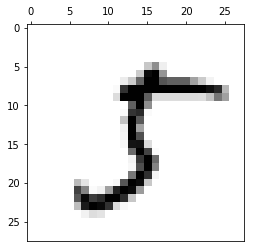

this is number
1
accuracy
0.396962142287


image


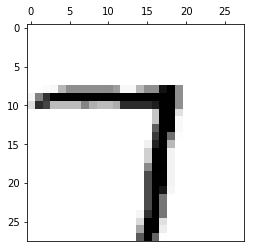

this is number
7
accuracy
0.79790626166


image


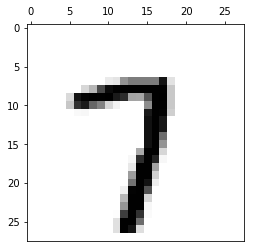

this is number
7
accuracy
0.713008908861


image


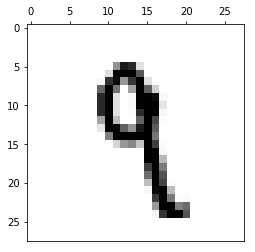

image


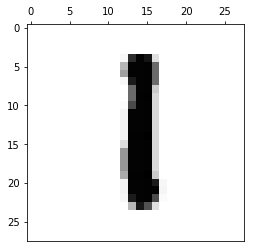

this is number
1
accuracy
0.711188288594


image


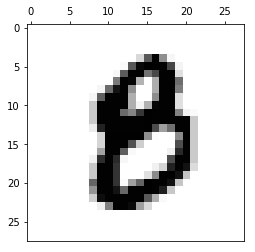

image


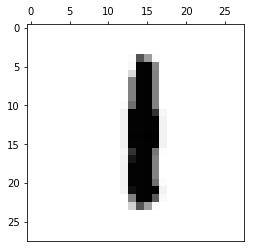

this is number
1
accuracy
0.66463405581


image


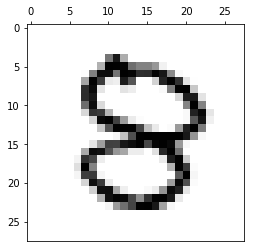

image


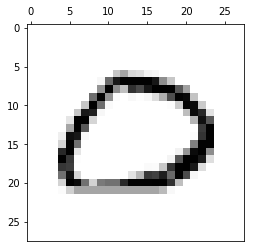

this is number
0
accuracy
0.728110861429


image


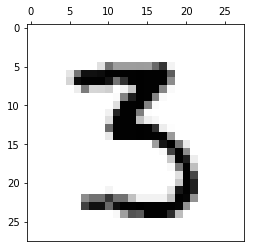

this is number
3
accuracy
0.655038142247


this is number
5
accuracy
0.310818011499


image


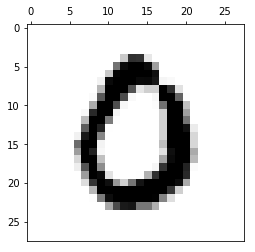

this is number
0
accuracy
0.473478987229


image


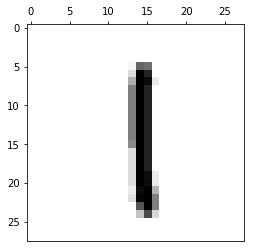

this is number
1
accuracy
0.712098156208


image


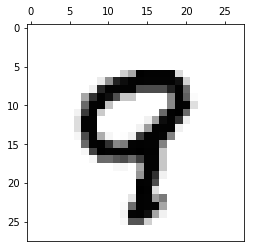

this is number
9
accuracy
0.391390074688


image


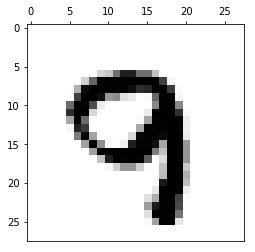

image


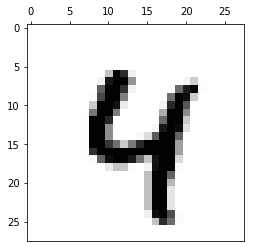

this is number
4
accuracy
0.619872459317


this is number
9
accuracy
0.365924356348


image


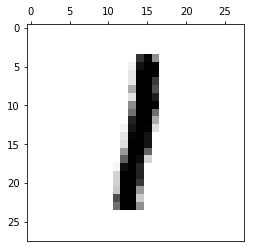

this is number
1
accuracy
0.83301788247


image


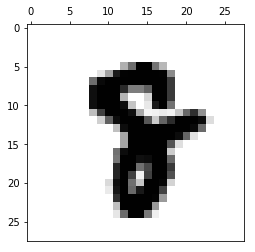

image


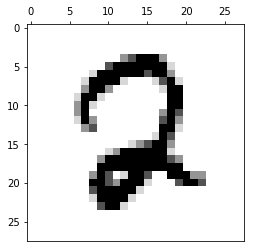

this is number
2
accuracy
0.660805309602


image


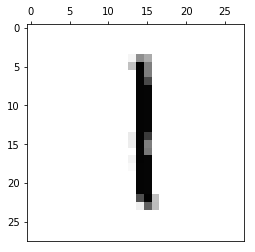

this is number
1
accuracy
0.721679987946


image


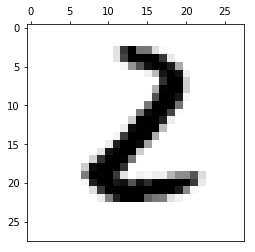

this is number
2
accuracy
0.325997474182


image


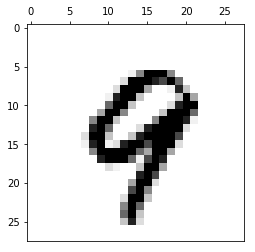

this is number
9
accuracy
0.421797836345


image


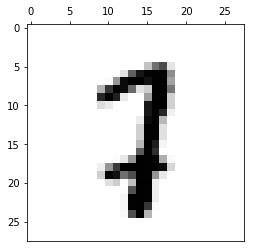

image


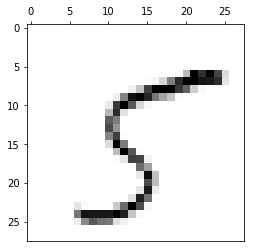

this is number
5
accuracy
0.468694385359


this is number
7
accuracy
0.335986968283


image


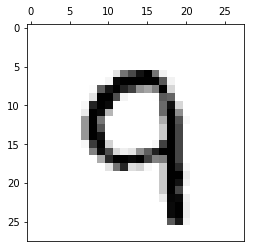

this is number
9
accuracy
0.46270459914


image


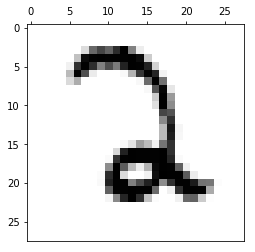

this is number
2
accuracy
0.64422489084


image


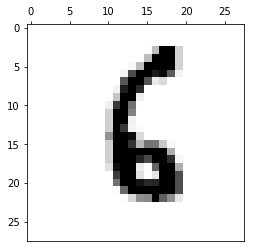

this is number
6
accuracy
0.451270708169


image


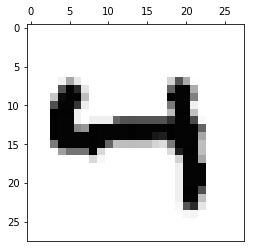

this is number
4
accuracy
0.583955036035


image


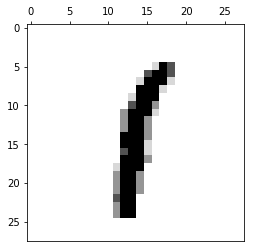

this is number
1
accuracy
0.791247815284


image


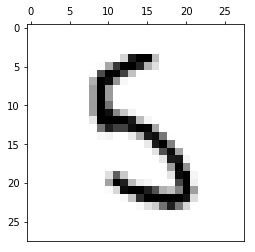

this is number
3
accuracy
0.355610407961


this is number
5
accuracy
0.339860220674


image


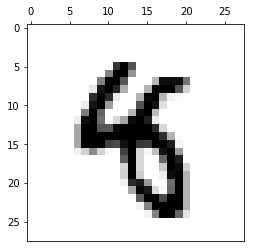

image


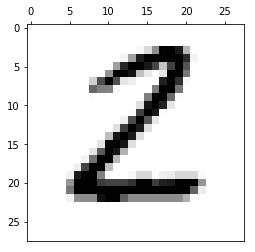

this is number
2
accuracy
0.475509227771


this is number
3
accuracy
0.361811020852


image


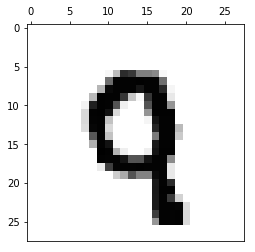

this is number
9
accuracy
0.43440639421


image


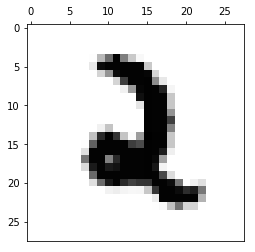

this is number
2
accuracy
0.402754018533


image


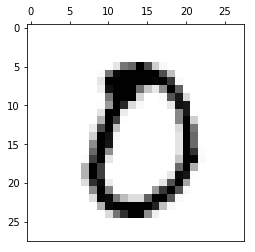

this is number
0
accuracy
0.664895254793


image


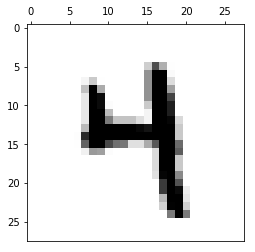

this is number
4
accuracy
0.363747389549


this is number
9
accuracy
0.384883622345


image


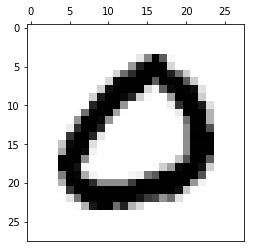

this is number
0
accuracy
0.935610233146


image


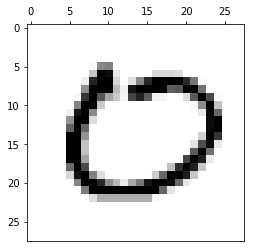

this is number
0
accuracy
0.78769114376


image


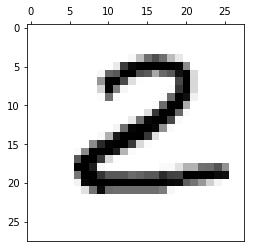

this is number
2
accuracy
0.573333800358


image


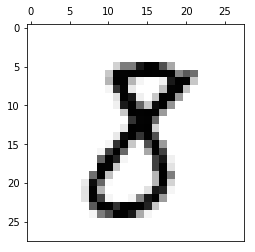

this is number
3
accuracy
0.332419926945


this is number
8
accuracy
0.389340148998


image


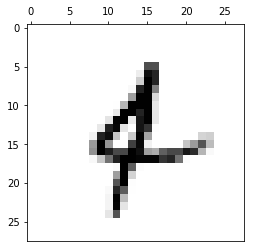

this is number
1
accuracy
0.383751416098


image


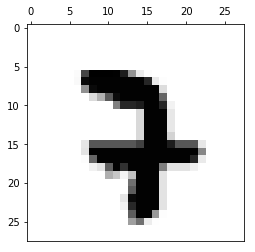

image


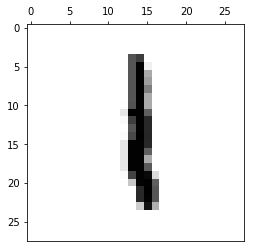

this is number
1
accuracy
0.74524754952


image


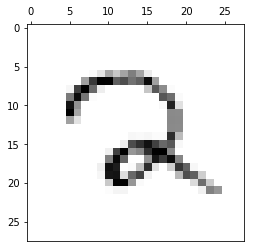

this is number
2
accuracy
0.521838537951


image


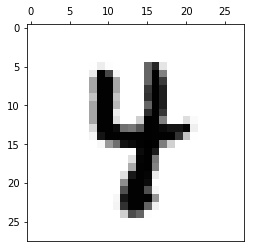

image


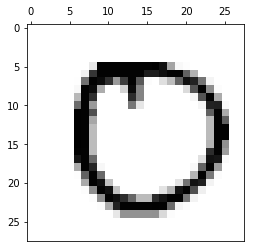

this is number
2
accuracy
0.318848142916


this is number
5
accuracy
0.312140121688


this is number
8
accuracy
0.307534318897


this is number
0
accuracy
0.665257454176


image


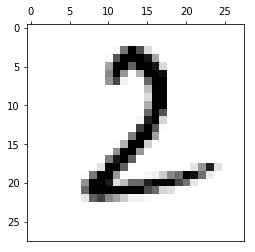

this is number
2
accuracy
0.562435974153


image


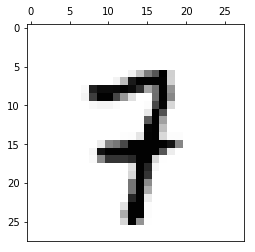

image


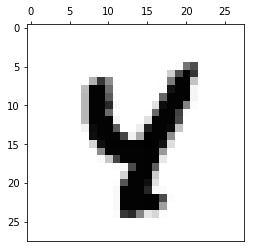

this is number
4
accuracy
0.478339090499


image


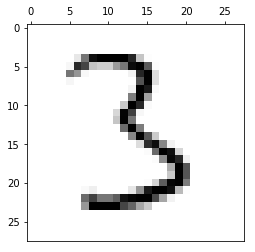

this is number
3
accuracy
0.637361310615


this is number
5
accuracy
0.321334268852


image


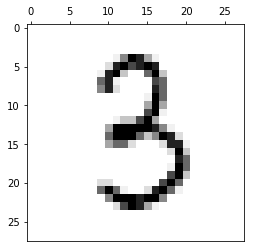

this is number
3
accuracy
0.729796901351


image


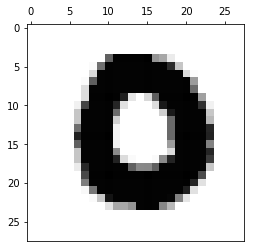

this is number
0
accuracy
0.595741688013


image


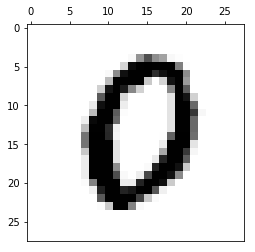

this is number
0
accuracy
0.631213482647


image


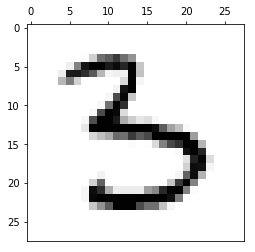

this is number
3
accuracy
0.41709584837


this is number
5
accuracy
0.431774786038


image


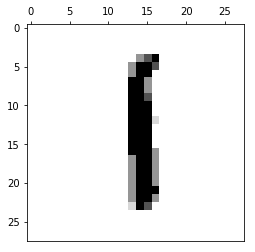

this is number
1
accuracy
0.704825041445


image


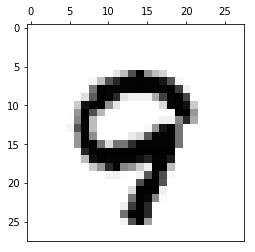

image


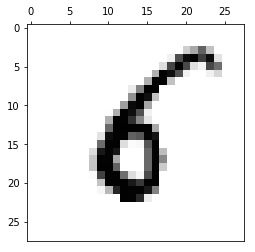

this is number
6
accuracy
0.389942989236


image


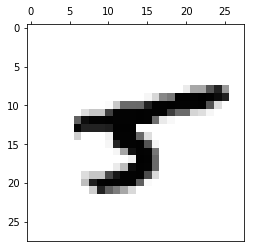

image


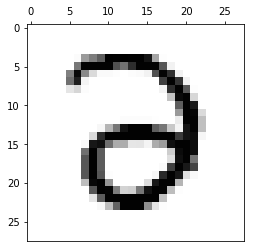

this is number
3
accuracy
0.398556490115


this is number
0
accuracy
0.325527217727


image


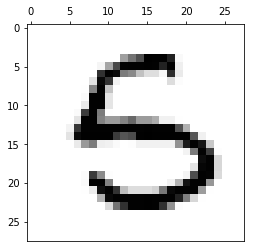

image


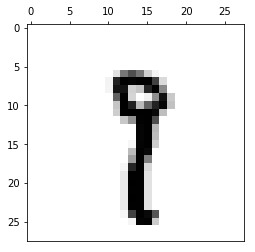

this is number
1
accuracy
0.481745536002


image


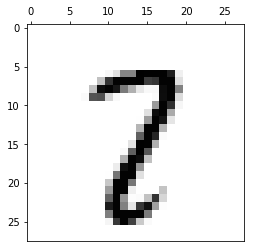

image


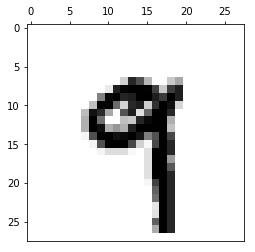

this is number
9
accuracy
0.419165268927


image


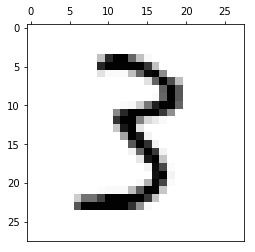

this is number
3
accuracy
0.585600163564


image


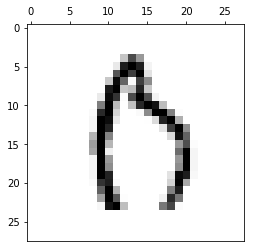

this is number
0
accuracy
0.317620323827


image


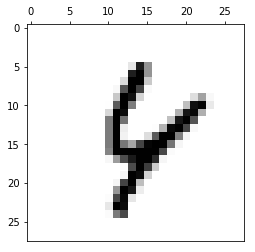

image


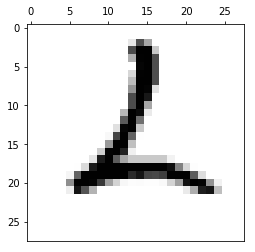

this is number
2
accuracy
0.635253643971


this is number
6
accuracy
0.483423425066


image


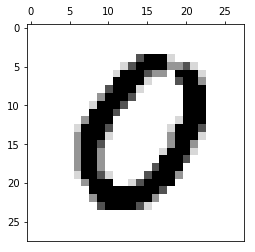

this is number
0
accuracy
0.874268224079


image


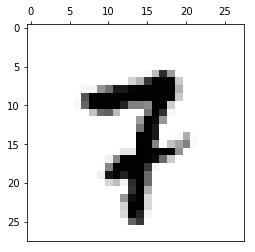

this is number
7
accuracy
0.341893705307


image


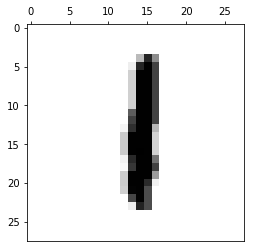

this is number
1
accuracy
0.751723732907


image


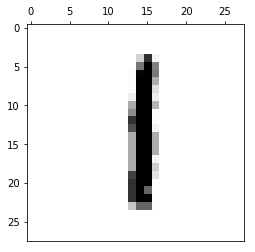

this is number
1
accuracy
0.72916765504


image


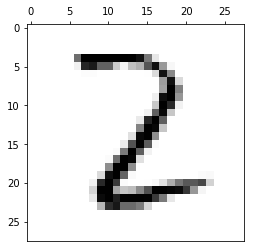

this is number
2
accuracy
0.340036591599


this is number
8
accuracy
0.315194284775


image


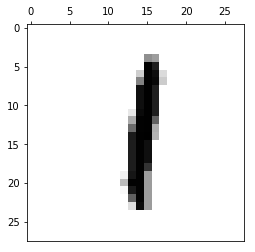

this is number
1
accuracy
0.80833322142


image


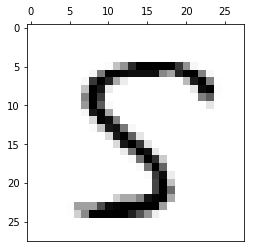

this is number
5
accuracy
0.436228255016


this is number
8
accuracy
0.547750308259


image


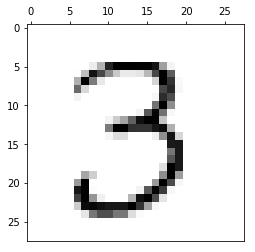

this is number
3
accuracy
0.862538391089


image


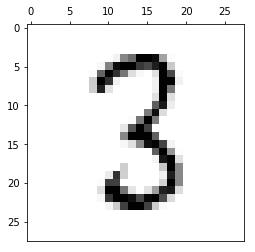

this is number
3
accuracy
0.568788718039


image


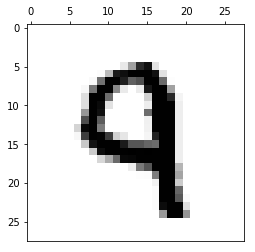

this is number
9
accuracy
0.307378411896


image


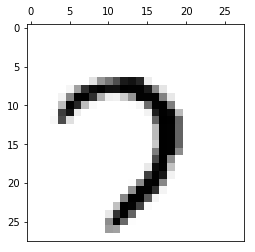

this is number
7
accuracy
0.747689468713


image


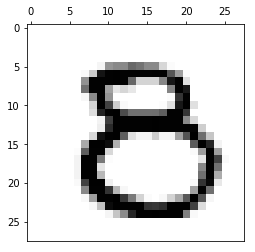

this is number
8
accuracy
0.316896870158


image


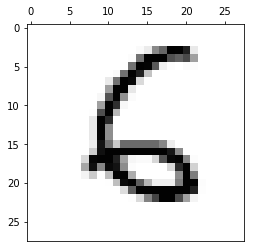

this is number
6
accuracy
0.630206821675


image


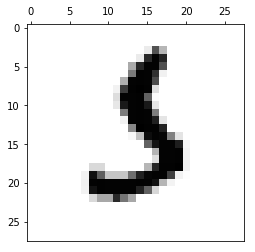

image


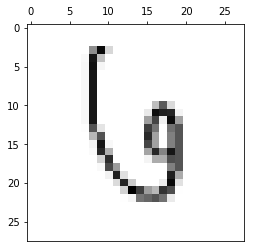

this is number
4
accuracy
0.384705320792


this is number
6
accuracy
0.340808168819


image


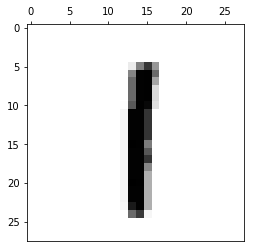

this is number
1
accuracy
0.783475453889


image


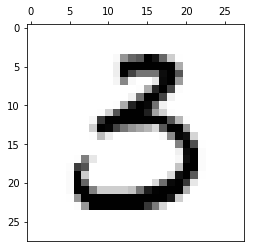

this is number
3
accuracy
0.63911950605


image


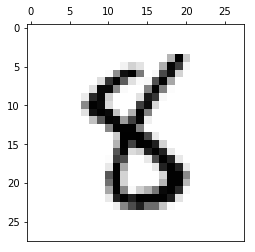

image


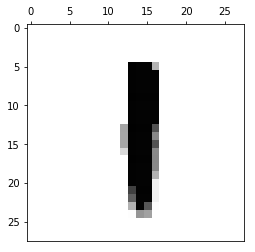

this is number
1
accuracy
0.693948838677


image


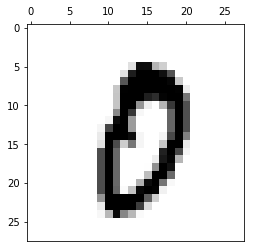

image


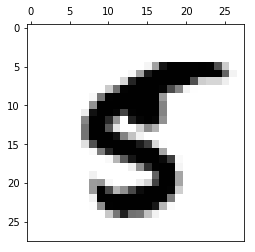

image


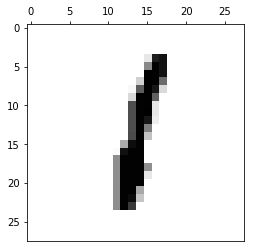

this is number
1
accuracy
0.825979270938


image


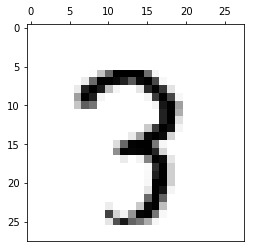

image


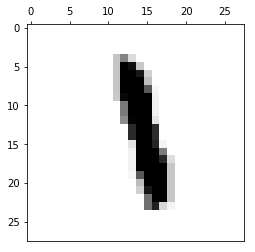

image


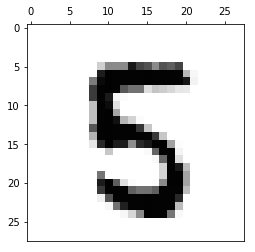

this is number
5
accuracy
0.338799377738


image


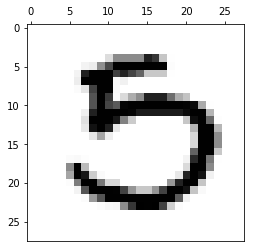

this is number
0
accuracy
0.545454258474


image


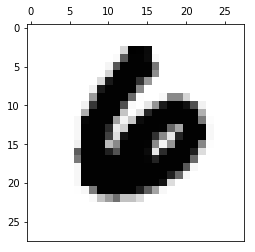

image


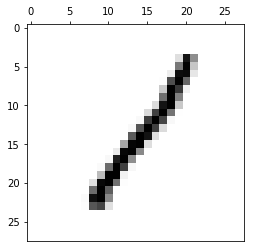

this is number
1
accuracy
0.499757304425


this is number
2
accuracy
0.360202746415


this is number
8
accuracy
0.47095833474


image


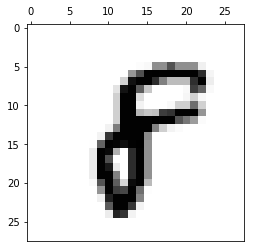

this is number
8
accuracy
0.375960193519


image


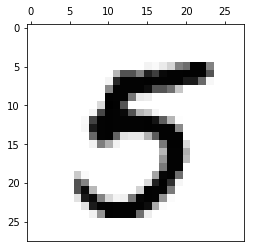

this is number
5
accuracy
0.495851493621


image


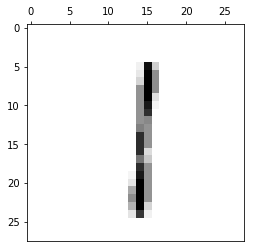

this is number
1
accuracy
0.639197471197


image


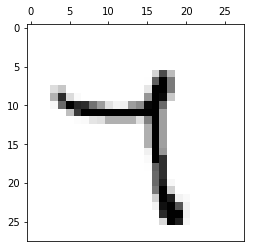

this is number
7
accuracy
0.341325147546


this is number
9
accuracy
0.329377384294


image


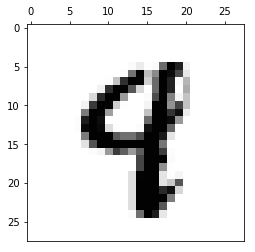

this is number
9
accuracy
0.308818560977


image


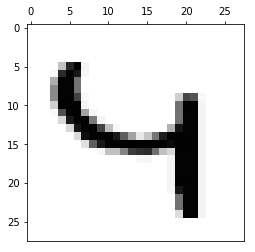

this is number
4
accuracy
0.667194295911


this is number
6
accuracy
0.338904342399


image


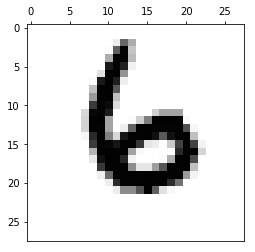

this is number
6
accuracy
0.680230422405


image


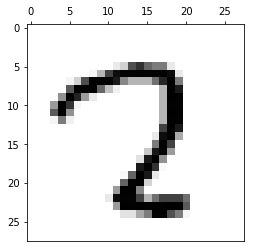

this is number
7
accuracy
0.336253080134


image


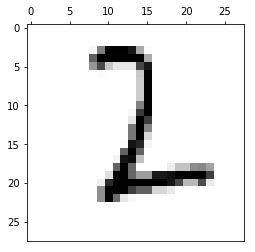

this is number
1
accuracy
0.561383383146


this is number
2
accuracy
0.422671465993


this is number
6
accuracy
0.375207529391


image


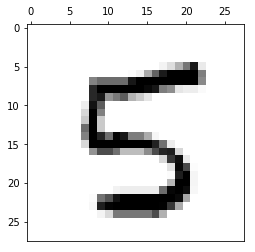

this is number
5
accuracy
0.319272554511


image


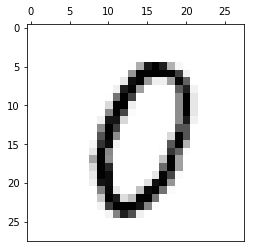

this is number
8
accuracy
0.312021895068


this is number
0
accuracy
0.548040940258


image


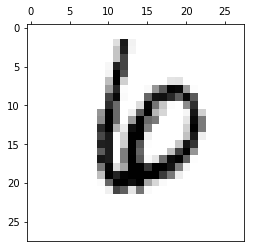

image


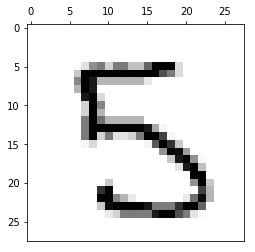

this is number
3
accuracy
0.498362090111


this is number
5
accuracy
0.33964670203


image


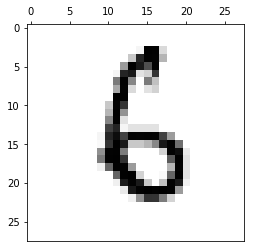

this is number
6
accuracy
0.620818691656


image


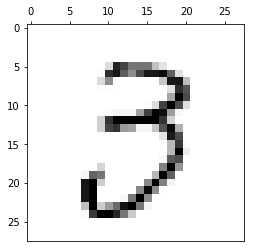

this is number
3
accuracy
0.732560763132


image


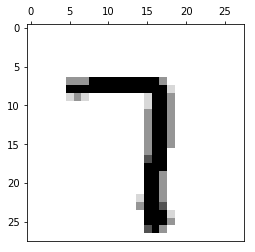

this is number
7
accuracy
0.571099535726


this is number
9
accuracy
0.365794822985


image


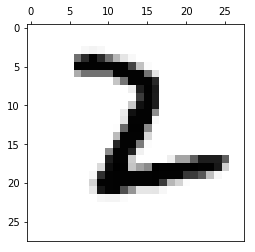

this is number
2
accuracy
0.392541040991


this is number
6
accuracy
0.315292776571


image


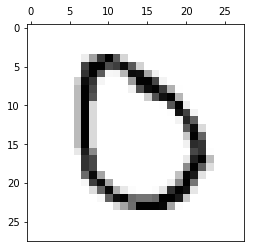

this is number
2
accuracy
0.321038722112


this is number
0
accuracy
0.643302220692


image


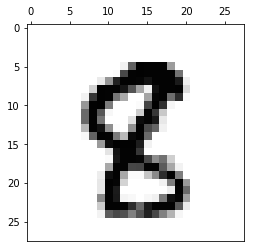

image


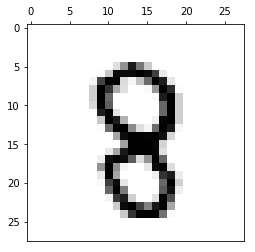

this is number
8
accuracy
0.410842302899


image


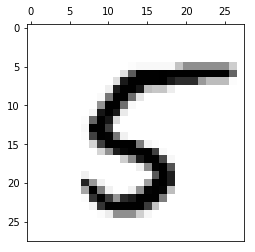

this is number
5
accuracy
0.422168573585


image


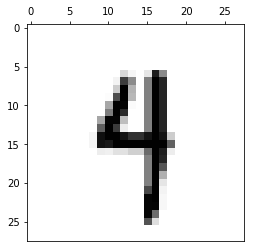

this is number
9
accuracy
0.399333713554


image


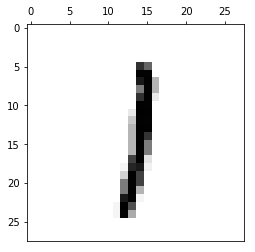

this is number
1
accuracy
0.790058610925


image


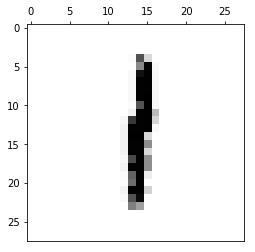

this is number
1
accuracy
0.820790034584


image


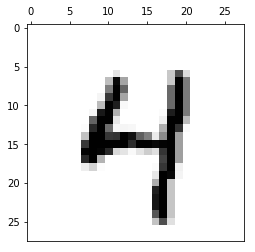

this is number
4
accuracy
0.686362368794


this is number
9
accuracy
0.435361685033


image


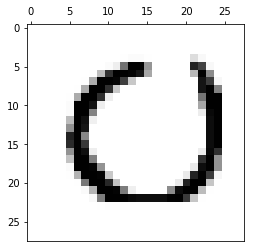

this is number
2
accuracy
0.512696767285


this is number
5
accuracy
0.368864457498


this is number
0
accuracy
0.74655542158


image


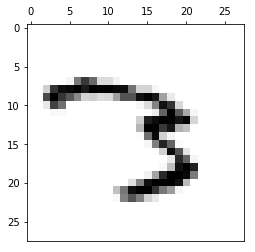

this is number
3
accuracy
0.336209515222


this is number
7
accuracy
0.448760090052


image


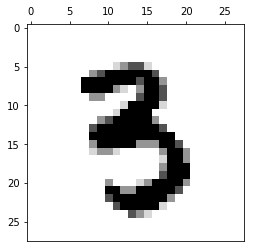

this is number
3
accuracy
0.48815616209


image


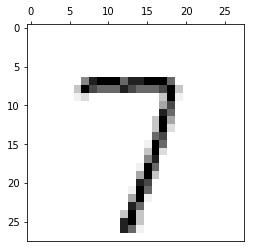

this is number
7
accuracy
0.640695156464


this is number
9
accuracy
0.422949277923


image


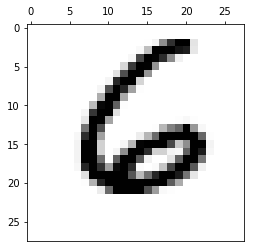

this is number
6
accuracy
0.827288964736


image


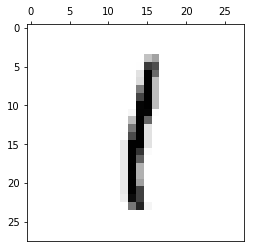

this is number
1
accuracy
0.812834089252


image


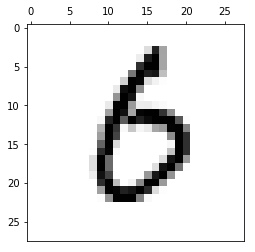

this is number
6
accuracy
0.505911229949


image


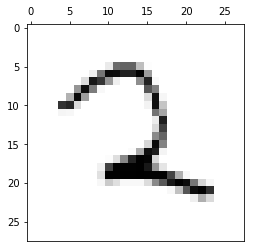

this is number
2
accuracy
0.645879631828


image


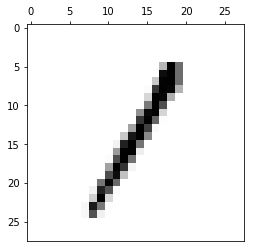

this is number
1
accuracy
0.695450824429


this is number
8
accuracy
0.343070212847


image


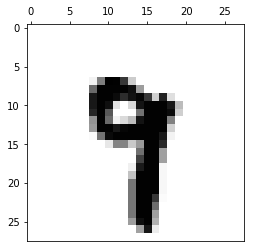

image


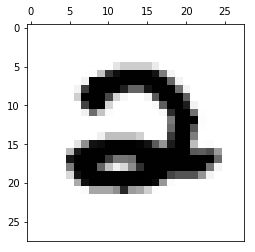

this is number
2
accuracy
0.374217331901


image


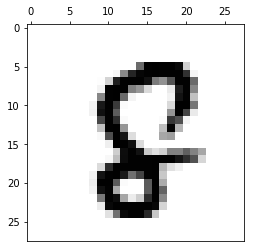

this is number
8
accuracy
0.390333778125


image


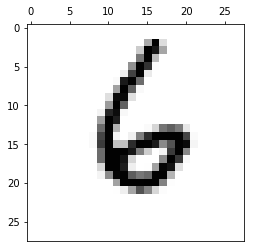

this is number
6
accuracy
0.782986611638


image


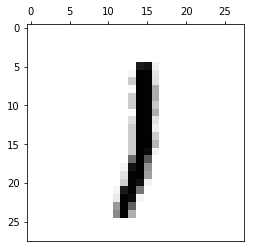

this is number
1
accuracy
0.749616905791


image


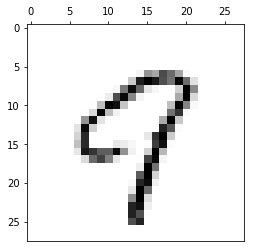

this is number
7
accuracy
0.30469972764


this is number
9
accuracy
0.484215513683


image


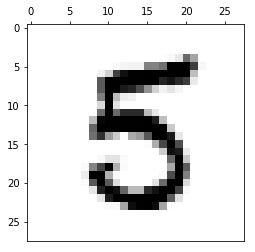

this is number
5
accuracy
0.340082895483


image


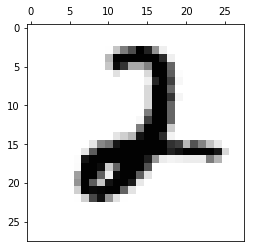

this is number
2
accuracy
0.605729276327


image


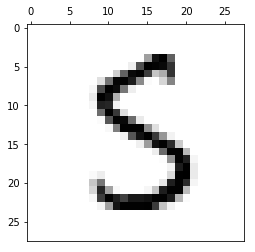

this is number
3
accuracy
0.424743078123


this is number
5
accuracy
0.404444112668


this is number
8
accuracy
0.354394081533


image


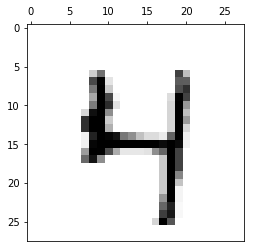

this is number
4
accuracy
0.741385778344


this is number
9
accuracy
0.400693044841


image


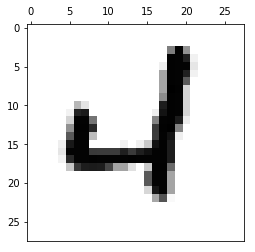

this is number
4
accuracy
0.605395477376


image


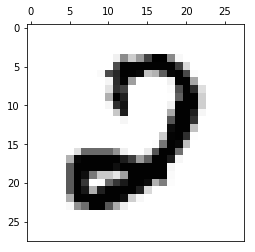

this is number
2
accuracy
0.573187439921


image


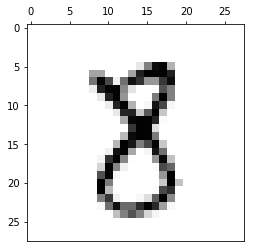

this is number
8
accuracy
0.432933663422


image


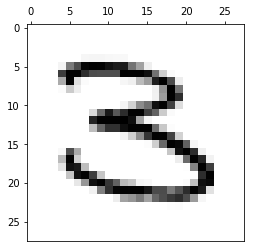

this is number
3
accuracy
0.489848439926


image


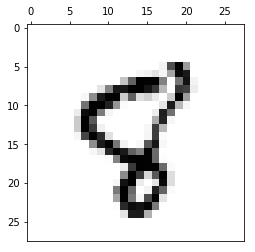

image


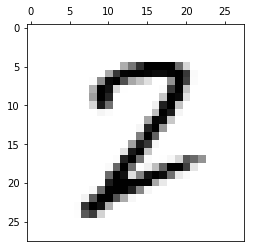

image


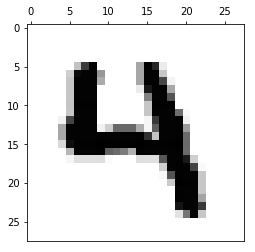

this is number
4
accuracy
0.374935052484


image


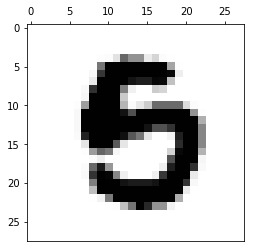

image


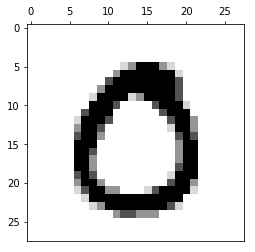

this is number
0
accuracy
0.726618978616


image


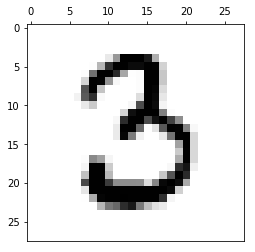

this is number
3
accuracy
0.642241706193


image


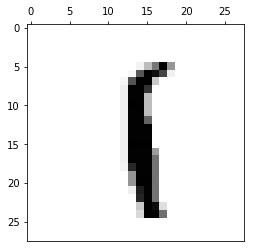

this is number
1
accuracy
0.653419228398


image


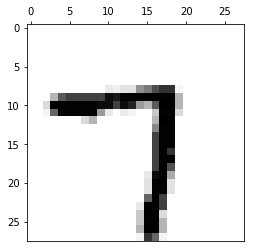

this is number
7
accuracy
0.777205965357


this is number
9
accuracy
0.351014582854


image


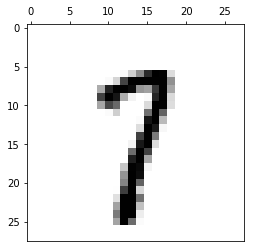

image


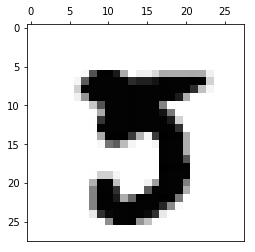

image


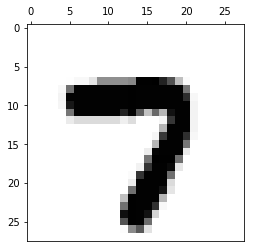

this is number
7
accuracy
0.786240407164


image


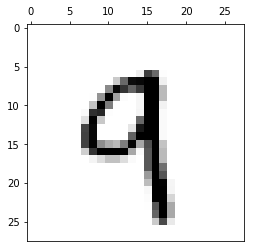

this is number
9
accuracy
0.442949212605


image


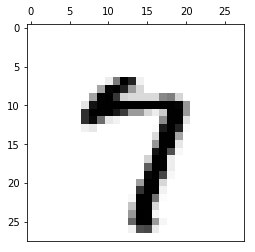

this is number
7
accuracy
0.680383317406


this is number
9
accuracy
0.353138740048


image


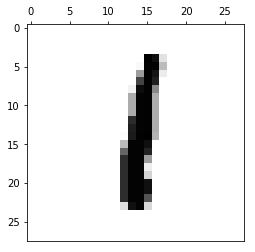

this is number
1
accuracy
0.814065002379


image


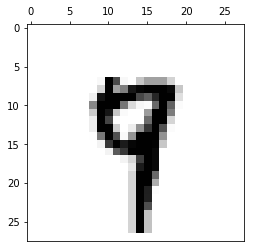

this is number
9
accuracy
0.323747084564


image


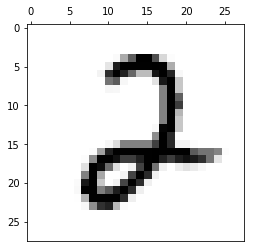

this is number
2
accuracy
0.645954611318


image


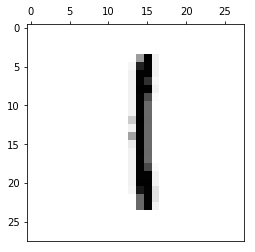

this is number
1
accuracy
0.694184566272


image


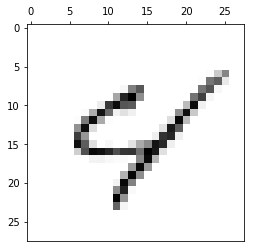

this is number
4
accuracy
0.48100047642


this is number
7
accuracy
0.333916892204


this is number
9
accuracy
0.344382298942


image


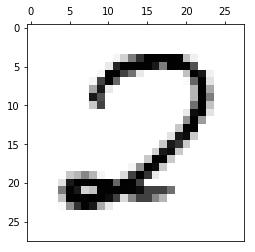

this is number
2
accuracy
0.509941784445


this is number
0
accuracy
0.398368502404


image


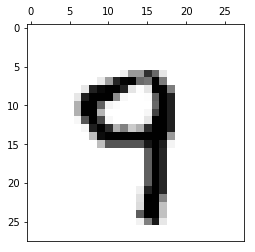

this is number
9
accuracy
0.448040861162


image


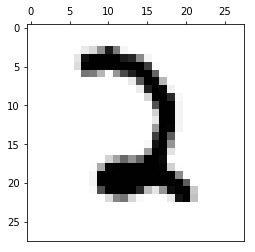

this is number
2
accuracy
0.659940869631


image


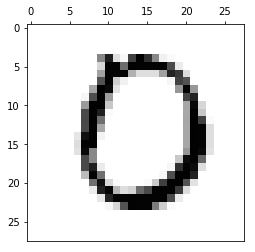

this is number
0
accuracy
0.822437005725


image


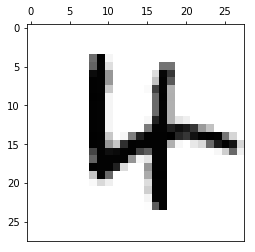

this is number
4
accuracy
0.430016396086


image


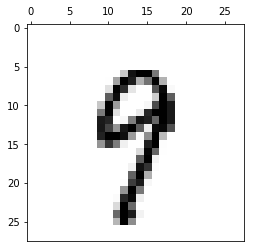

this is number
9
accuracy
0.368440621525


image


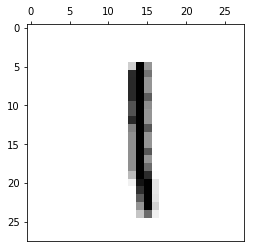

this is number
1
accuracy
0.704621761087


image


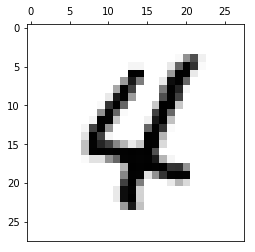

image


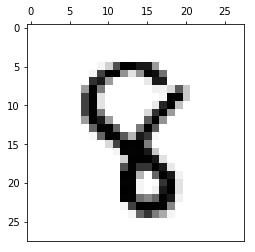

image


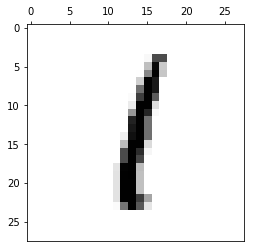

this is number
1
accuracy
0.828932428456


image


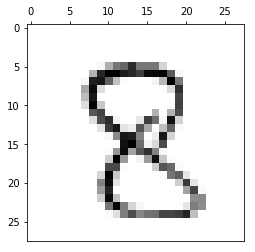

this is number
8
accuracy
0.467802625765


image


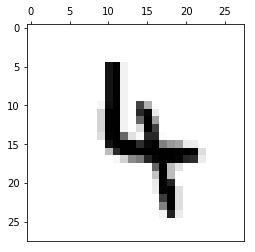

this is number
4
accuracy
0.407187695623


image


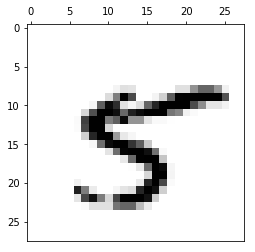

image


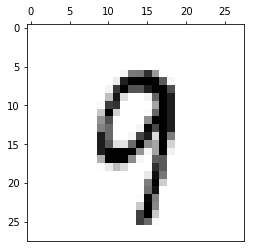

this is number
9
accuracy
0.485485436717


image


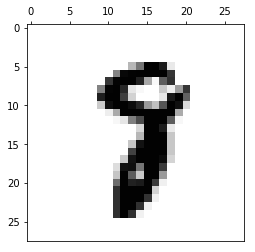

image


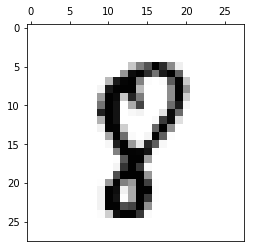

this is number
8
accuracy
0.327320094596


image


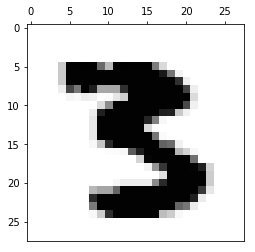

image


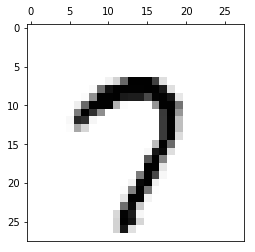

this is number
7
accuracy
0.80941984841


this is number
9
accuracy
0.490373968434


image


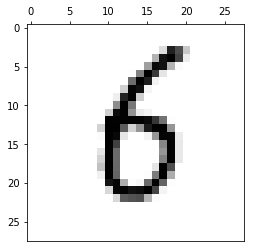

this is number
6
accuracy
0.586508501809


image


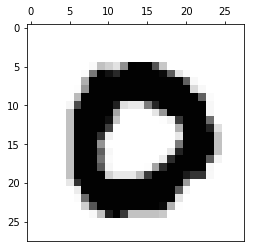

this is number
0
accuracy
0.858542150597


image


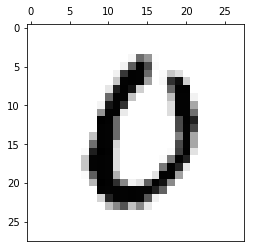

this is number
6
accuracy
0.305797989222


this is number
0
accuracy
0.691662569992


image


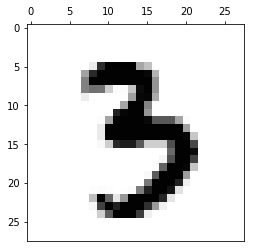

this is number
3
accuracy
0.701370426073


image


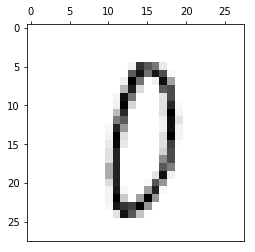

this is number
8
accuracy
0.393206862868


image


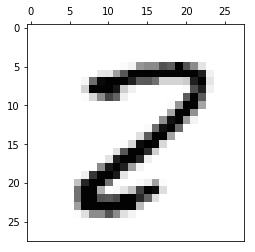

this is number
8
accuracy
0.60656427302


image


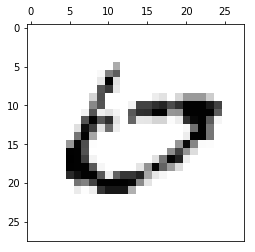

this is number
0
accuracy
0.697053822704


image


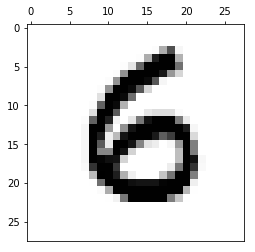

this is number
6
accuracy
0.434328389104


image


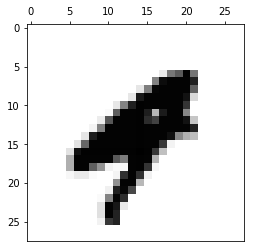

image


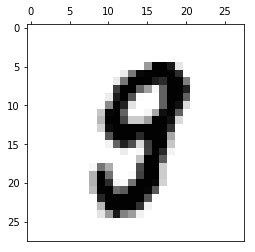

image


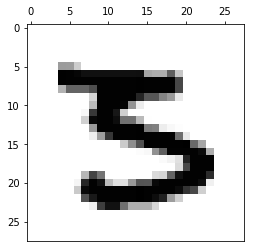

image


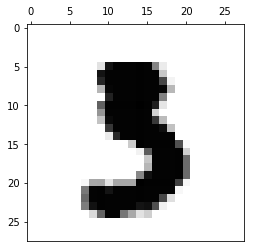

image


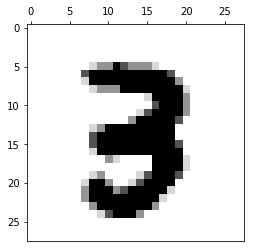

image


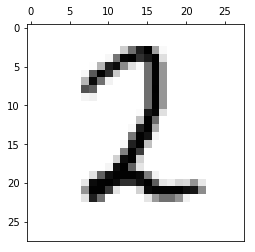

this is number
1
accuracy
0.47458056615


this is number
2
accuracy
0.551278518823


image


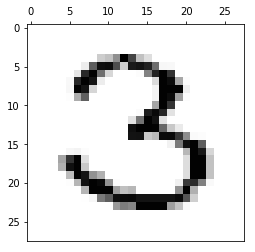

this is number
2
accuracy
0.354386215584


this is number
3
accuracy
0.641191473637


image


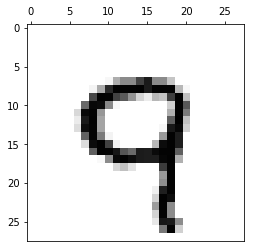

this is number
4
accuracy
0.343408398188


this is number
9
accuracy
0.51264204433


image


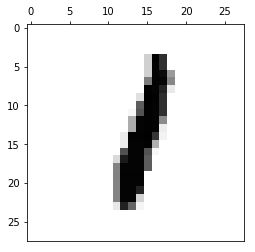

this is number
1
accuracy
0.768516497537


image


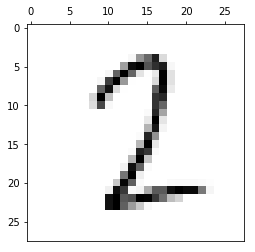

image


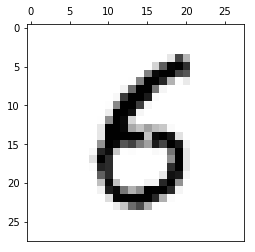

image


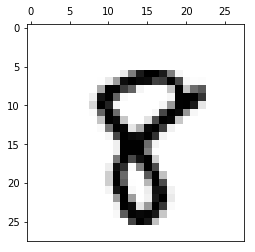

this is number
8
accuracy
0.51425807693


image


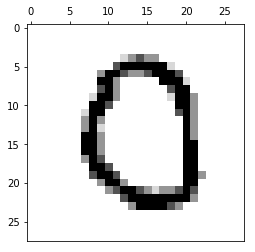

this is number
0
accuracy
0.712099025422


image


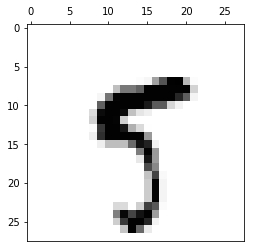

image


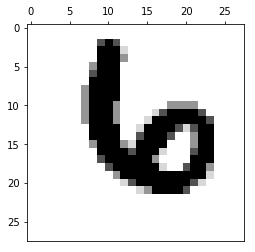

this is number
6
accuracy
0.32395483104


image


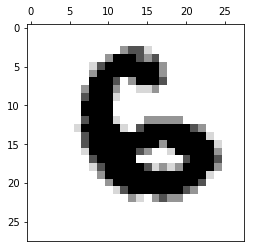

this is number
6
accuracy
0.519472489607


image


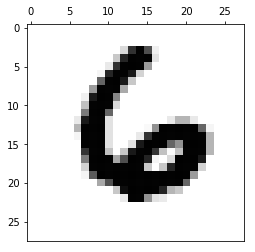

this is number
6
accuracy
0.729859885641


image


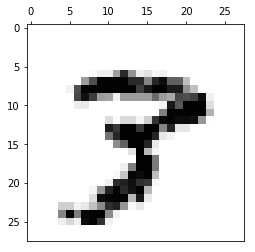

image


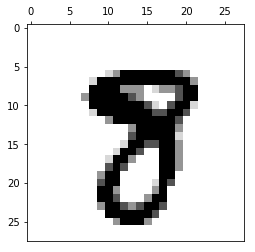

image


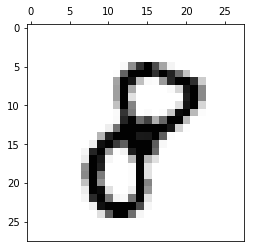

this is number
8
accuracy
0.45858037036


image


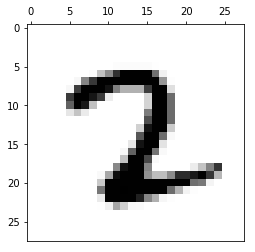

image


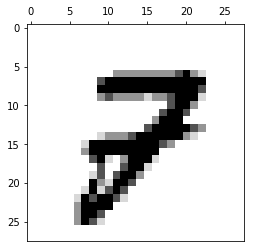

image


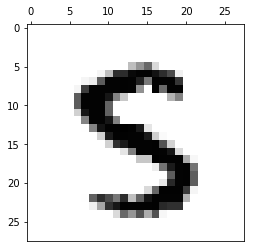

image


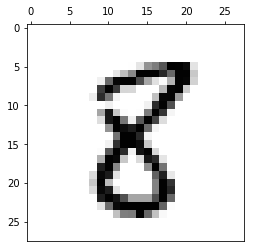

this is number
8
accuracy
0.557056237916


image


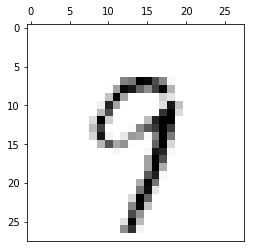

this is number
7
accuracy
0.351288387193


this is number
9
accuracy
0.59889882956


image


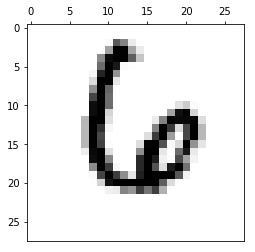

this is number
6
accuracy
0.618295936553


image


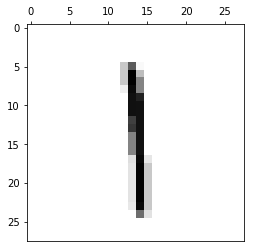

this is number
1
accuracy
0.649347010294


image


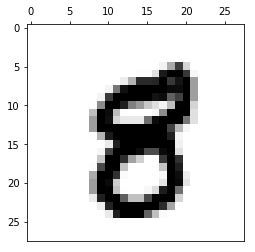

image


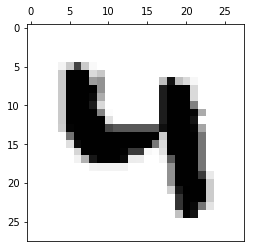

this is number
4
accuracy
0.640882915007


image


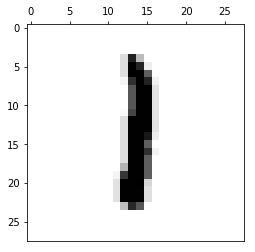

this is number
1
accuracy
0.787901645347


image


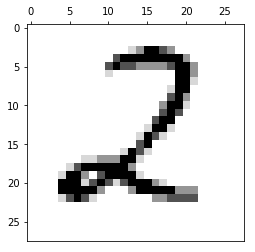

this is number
2
accuracy
0.774312404758


image


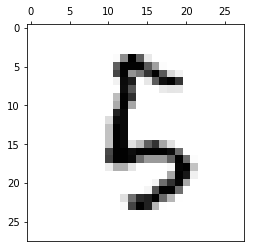

this is number
8
accuracy
0.320015565326


image


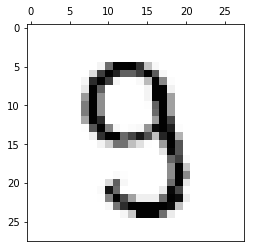

this is number
3
accuracy
0.421547068538


image


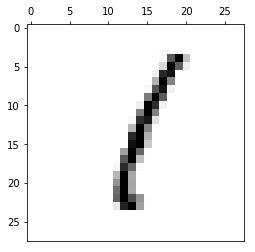

this is number
1
accuracy
0.78478268172


image


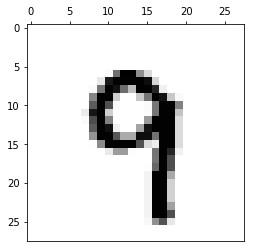

this is number
9
accuracy
0.497404561121


image


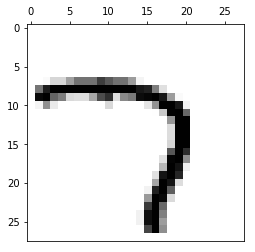

this is number
3
accuracy
0.300098000465


this is number
7
accuracy
0.629888946969


image


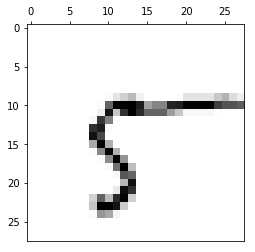

this is number
0
accuracy
0.330837541722


image


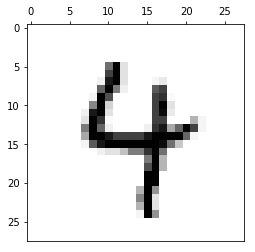

this is number
4
accuracy
0.544742702152


this is number
9
accuracy
0.378186290689


image


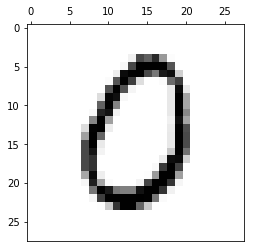

this is number
0
accuracy
0.673532600291


image


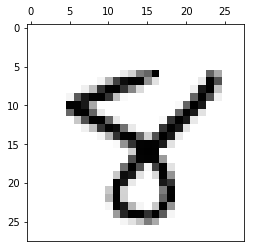

image


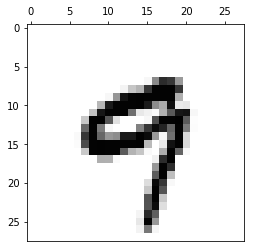

this is number
4
accuracy
0.323484741262


this is number
9
accuracy
0.346328499041


image


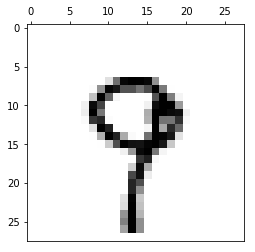

this is number
7
accuracy
0.395023280157


this is number
9
accuracy
0.466842329558


image


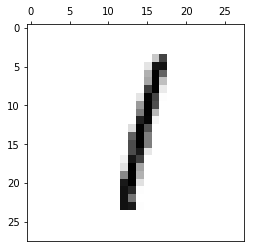

this is number
1
accuracy
0.80186122516


image


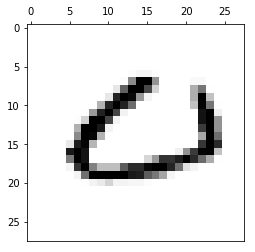

this is number
6
accuracy
0.461460709589


this is number
0
accuracy
0.705520519894


image


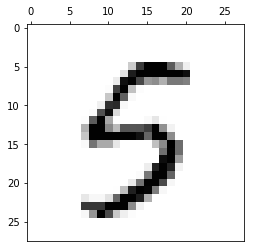

image


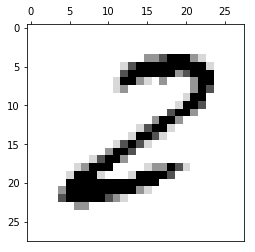

this is number
2
accuracy
0.604660623181


this is number
8
accuracy
0.323353168572


image


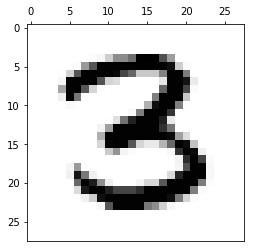

this is number
3
accuracy
0.780533691591


image


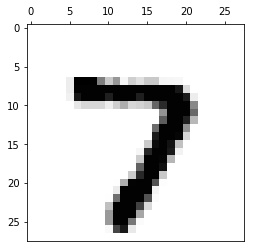

this is number
7
accuracy
0.883730897303


image


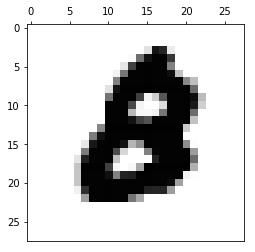

image


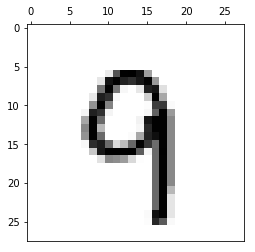

this is number
9
accuracy
0.450606133764


image


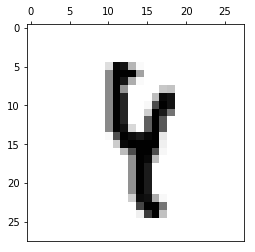

image


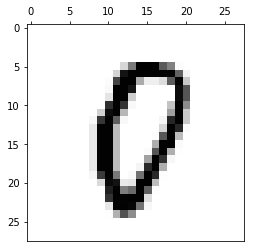

image


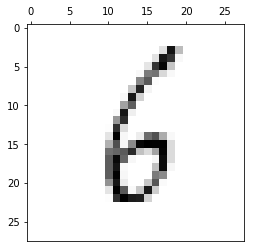

this is number
6
accuracy
0.49261339374


this is number
8
accuracy
0.324911513285


image


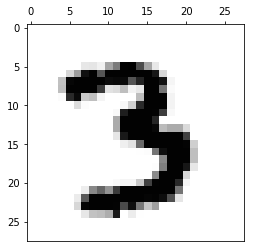

this is number
3
accuracy
0.820337542298


image


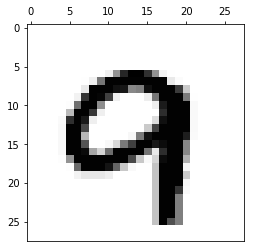

image


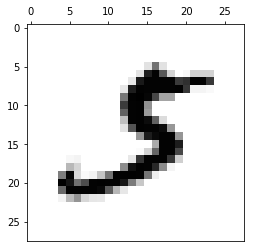

image


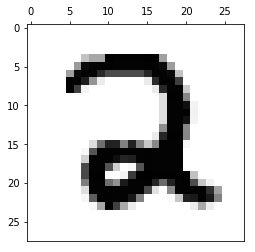

this is number
2
accuracy
0.773540399546


image


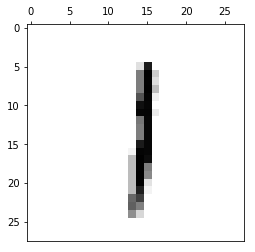

this is number
1
accuracy
0.721329454316


image


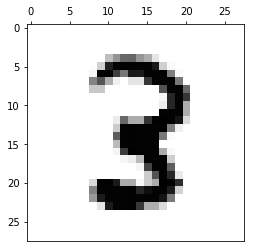

this is number
3
accuracy
0.317268928731


image


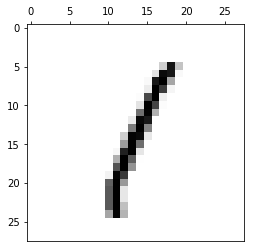

this is number
1
accuracy
0.757726154908


this is number
8
accuracy
0.31948373338


image


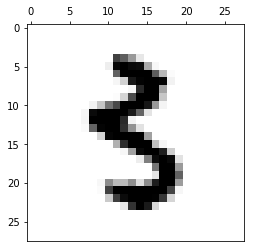

image


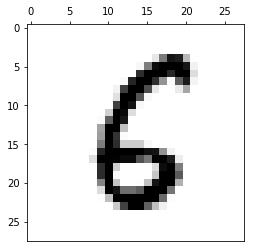

image


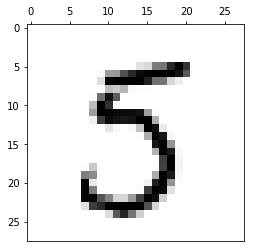

this is number
3
accuracy
0.437677313417


this is number
5
accuracy
0.40315895059


this is number
8
accuracy
0.307023448801


image


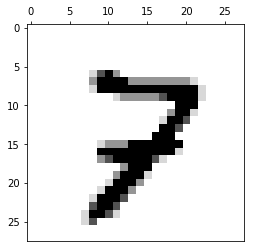

image


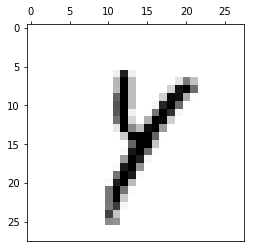

this is number
8
accuracy
0.358199332981


image


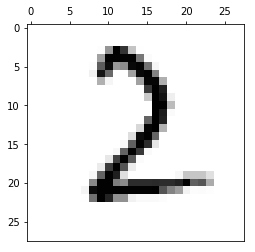

this is number
2
accuracy
0.490836108973


image


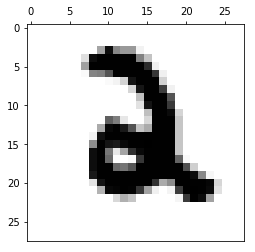

this is number
2
accuracy
0.388450504907


image


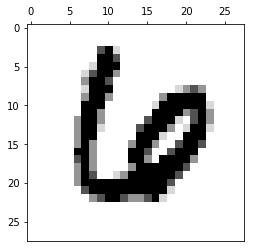

image


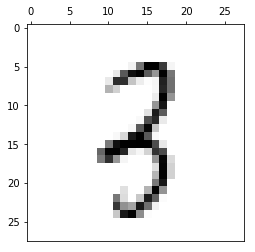

this is number
3
accuracy
0.300897579905


this is number
8
accuracy
0.358846581353


image


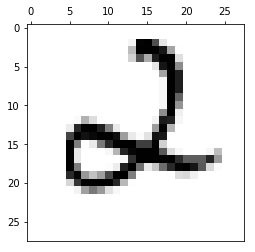

this is number
2
accuracy
0.449463306582


this is number
4
accuracy
0.340889383873


image


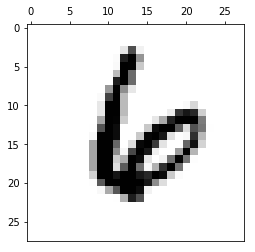

this is number
6
accuracy
0.728398076725


image


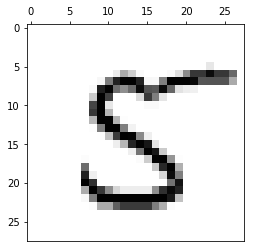

this is number
5
accuracy
0.559565348735


image


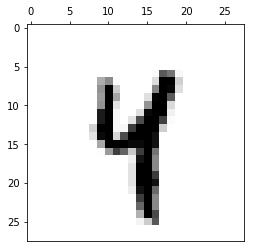

image


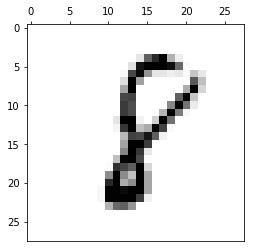

this is number
8
accuracy
0.386244126555


image


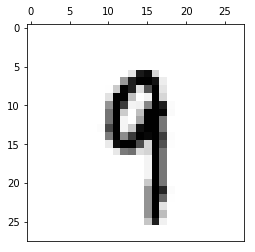

this is number
9
accuracy
0.379651476715


image


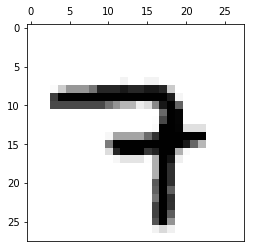

this is number
7
accuracy
0.440890609191


image


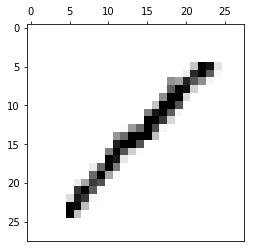

this is number
2
accuracy
0.364353292891


this is number
8
accuracy
0.522421239801


image


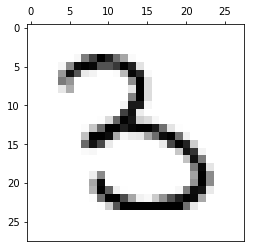

this is number
3
accuracy
0.50059490469


this is number
5
accuracy
0.39115672585


image


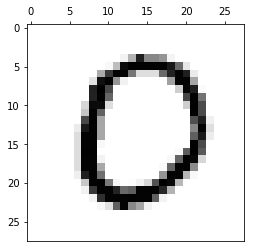

this is number
0
accuracy
0.874583937859


image


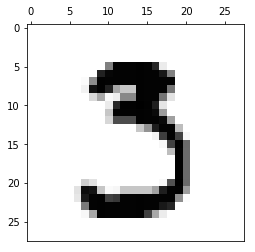

this is number
3
accuracy
0.6831931442


image


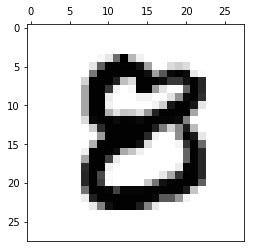

image


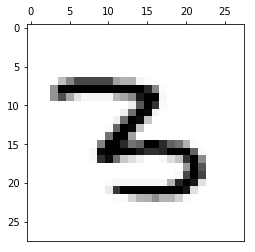

image


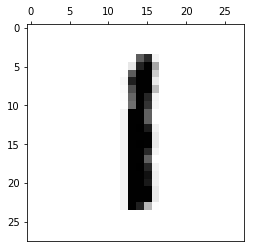

this is number
1
accuracy
0.746866043463


image


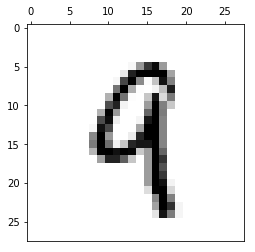

this is number
9
accuracy
0.310590976301


image


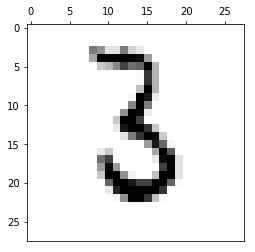

this is number
6
accuracy
0.414431163994


image


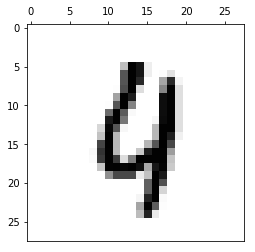

image


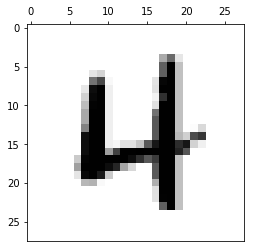

this is number
4
accuracy
0.535590110284


image


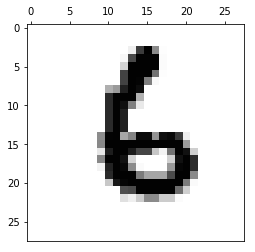

this is number
6
accuracy
0.713696538716


image


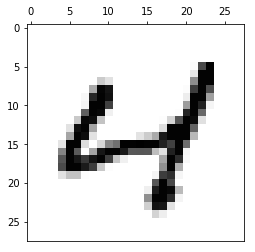

this is number
4
accuracy
0.618145234543


image


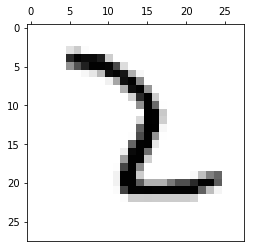

this is number
1
accuracy
0.486361505493


image


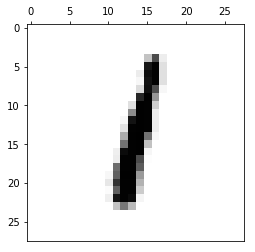

this is number
1
accuracy
0.842636946286


image


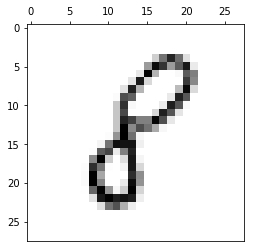

this is number
8
accuracy
0.433861647707


image


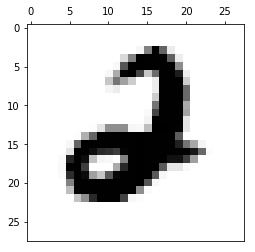

this is number
2
accuracy
0.387594183278


image


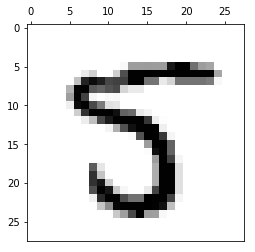

this is number
3
accuracy
0.324077306078


this is number
5
accuracy
0.456139232916


this is number
8
accuracy
0.35659730486


image


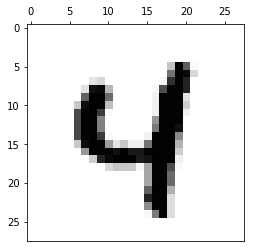

this is number
4
accuracy
0.692017858166


image


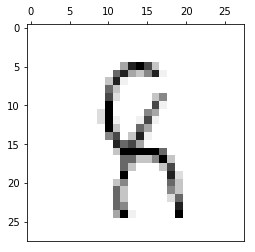

this is number
8
accuracy
0.321509785195


image


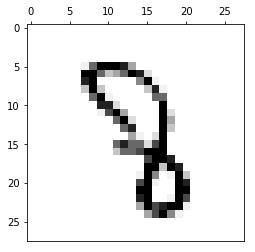

image


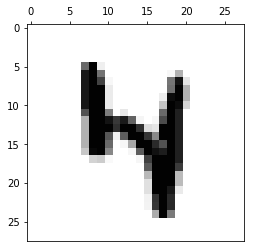

this is number
4
accuracy
0.613884352342


image


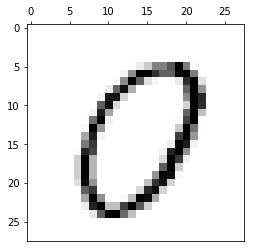

this is number
5
accuracy
0.312346391526


this is number
0
accuracy
0.769029934753


image


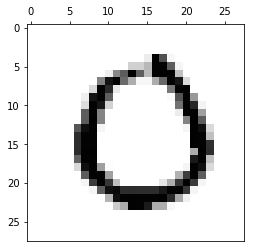

this is number
0
accuracy
0.882484841659


image


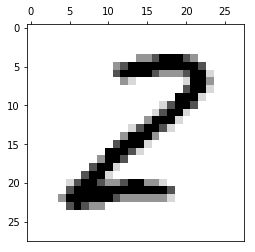

this is number
2
accuracy
0.457508398716


this is number
8
accuracy
0.478205711094


image


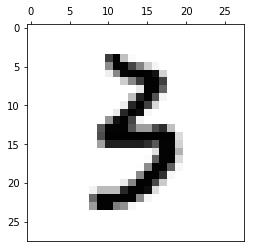

this is number
3
accuracy
0.359918934421


image


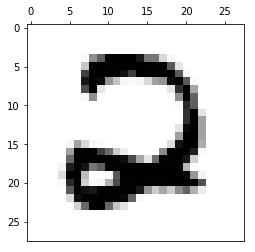

this is number
2
accuracy
0.807480685334


this is number
0
accuracy
0.468396215861


image


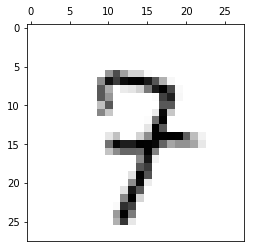

this is number
9
accuracy
0.334928532862


image


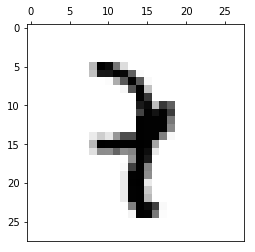

this is number
1
accuracy
0.344863106298


image


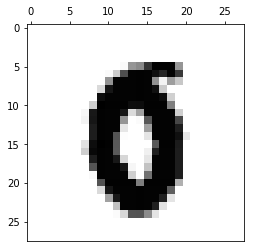

image


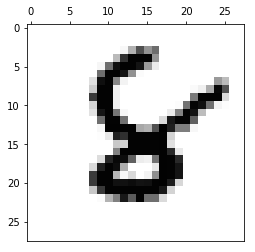

this is number
6
accuracy
0.301988481466


image


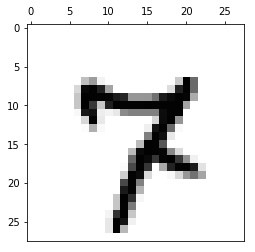

this is number
7
accuracy
0.702794198244


image


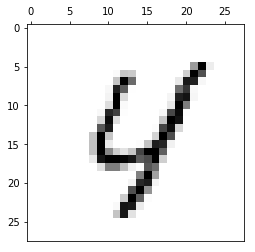

this is number
4
accuracy
0.487181552188


image


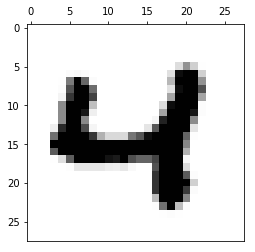

this is number
4
accuracy
0.71517204657


image


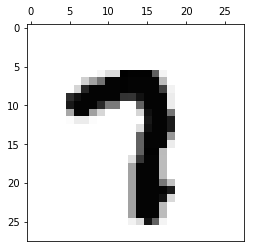

this is number
7
accuracy
0.439857434893


image


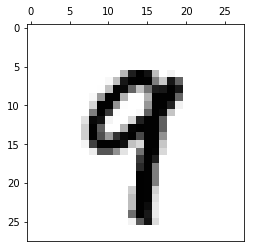

this is number
9
accuracy
0.367894967


image


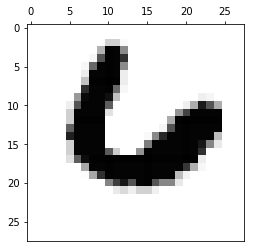

this is number
6
accuracy
0.639168597503


image


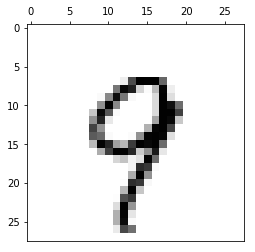

this is number
4
accuracy
0.307236337745


this is number
9
accuracy
0.556241644086


image


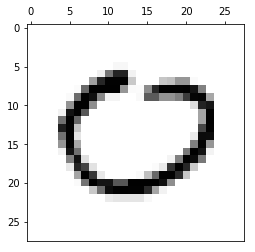

this is number
0
accuracy
0.717298218289


image


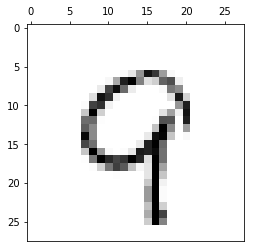

this is number
4
accuracy
0.339248638349


this is number
9
accuracy
0.41646712808


image


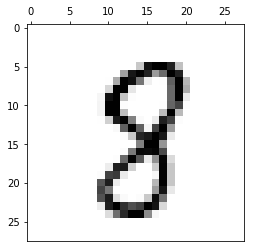

this is number
8
accuracy
0.502037699599


image


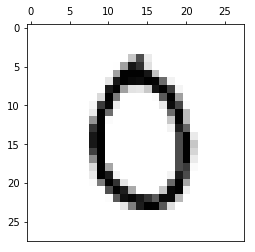

this is number
0
accuracy
0.50599195481


image


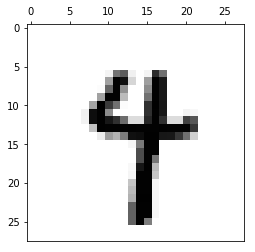

image


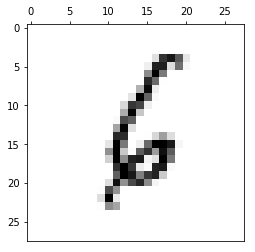

this is number
6
accuracy
0.381021863926


image


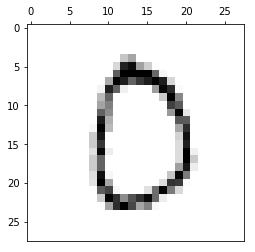

this is number
0
accuracy
0.551010236432


image


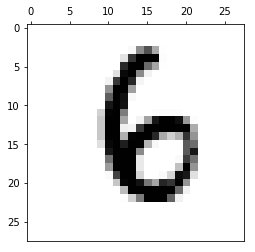

this is number
6
accuracy
0.525075852342


image


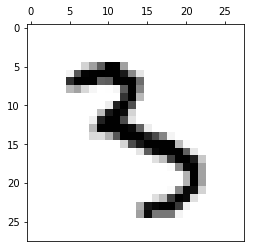

this is number
3
accuracy
0.313933467176


this is number
5
accuracy
0.390706867827


image


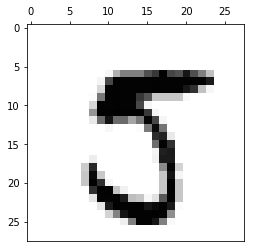

this is number
5
accuracy
0.411432705521


image


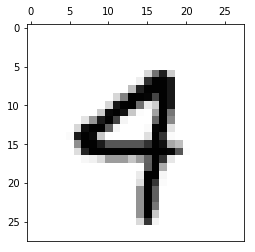

this is number
4
accuracy
0.381632663741


this is number
9
accuracy
0.353398102989


image


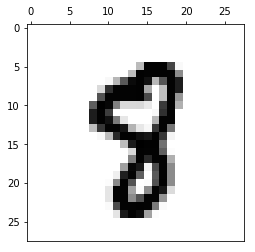

image


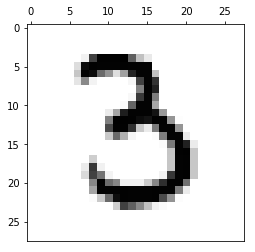

this is number
3
accuracy
0.713048043349


image


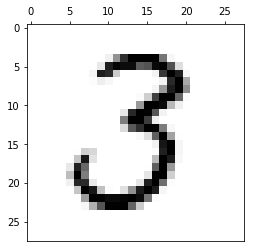

this is number
3
accuracy
0.700645201599


image


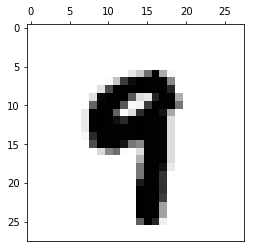

this is number
9
accuracy
0.33358276404


image


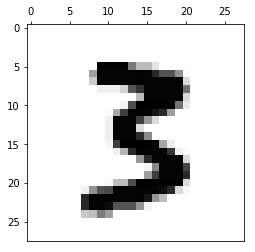

this is number
3
accuracy
0.459949981447


image


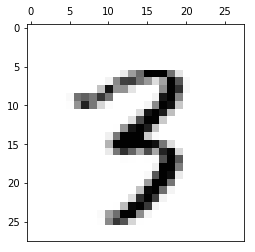

this is number
3
accuracy
0.300086716914


image


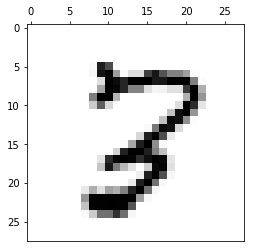

this is number
8
accuracy
0.340054013841


image


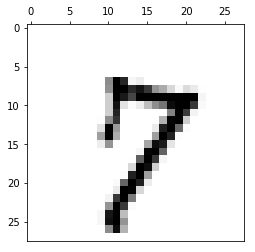

this is number
7
accuracy
0.709119171606


image


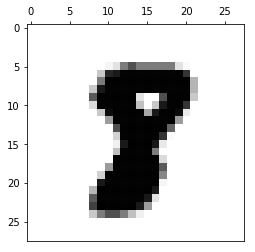

image


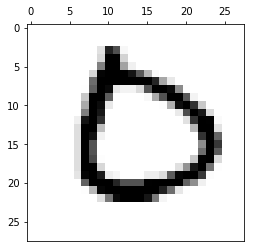

this is number
0
accuracy
0.781530541655


image


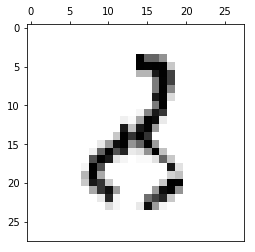

this is number
2
accuracy
0.327288456342


image


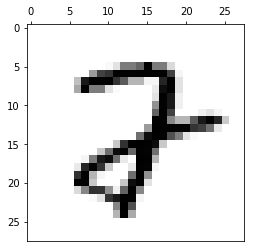

this is number
2
accuracy
0.338242430236


image


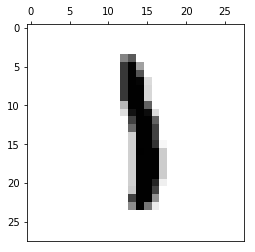

this is number
1
accuracy
0.41924303998


image


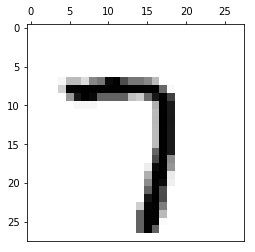

this is number
7
accuracy
0.722704883474


this is number
9
accuracy
0.33738841075


image


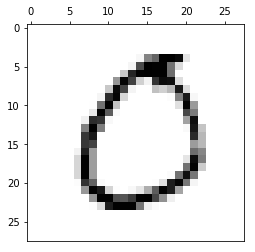

this is number
0
accuracy
0.821362356501


image


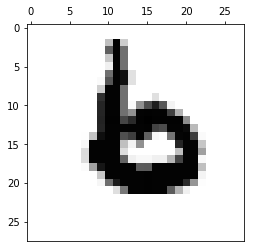

this is number
6
accuracy
0.645935759237


image


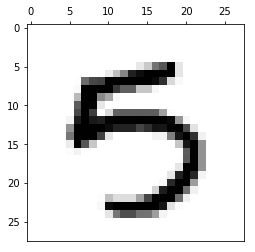

image


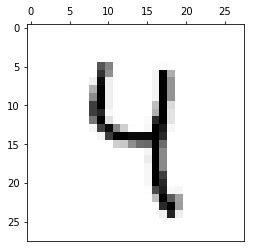

this is number
4
accuracy
0.425665642297


this is number
9
accuracy
0.407700138554


image


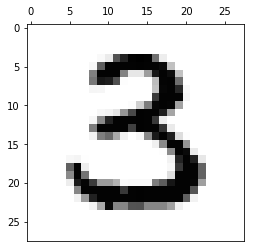

this is number
3
accuracy
0.785330168461


image


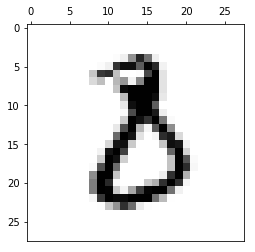

this is number
3
accuracy
0.386996773005


image


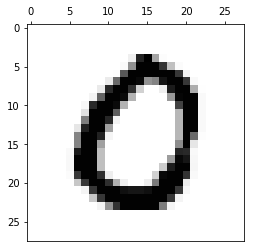

this is number
0
accuracy
0.893849454927


image


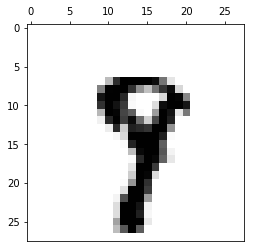

this is number
7
accuracy
0.306796745015


image


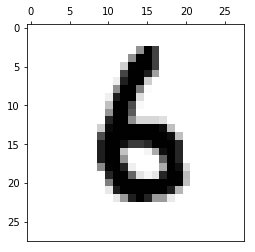

this is number
6
accuracy
0.621112738928


image


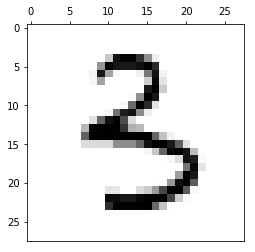

this is number
3
accuracy
0.452978101969


this is number
5
accuracy
0.31673011378


image


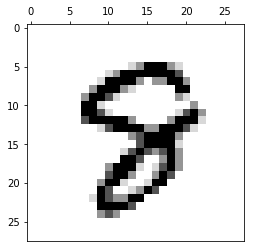

image


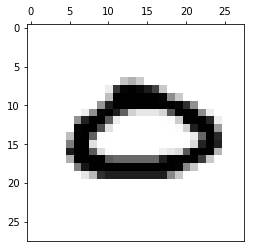

this is number
0
accuracy
0.523414948341


image


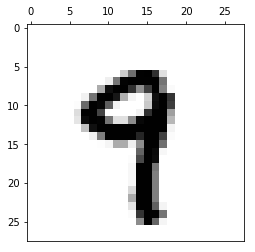

this is number
9
accuracy
0.349152210972


image


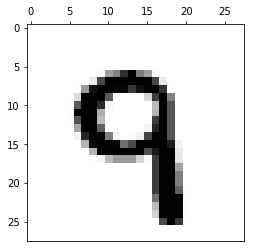

this is number
9
accuracy
0.416111381878


image


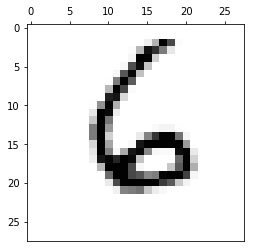

this is number
6
accuracy
0.796281687287


image


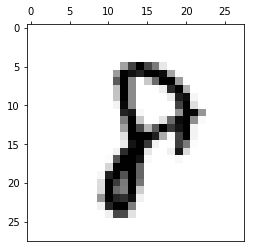

this is number
8
accuracy
0.336616847949


image


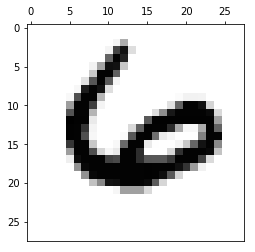

this is number
2
accuracy
0.309993087331


this is number
6
accuracy
0.412480686916


image


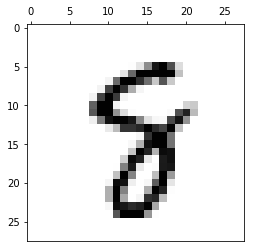

image


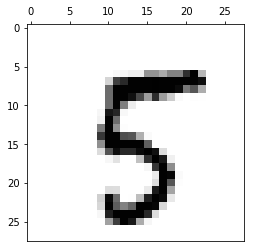

this is number
5
accuracy
0.321523937136


image


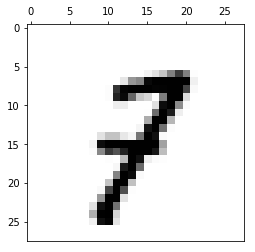

image


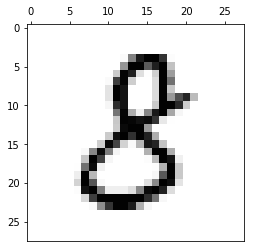

this is number
3
accuracy
0.382585588666


image


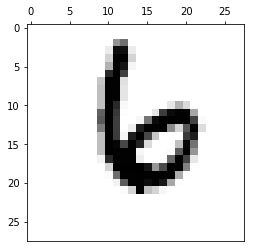

this is number
6
accuracy
0.531130974488


image


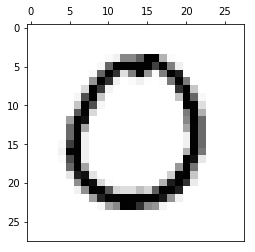

this is number
2
accuracy
0.32802651813


this is number
3
accuracy
0.39123756791


this is number
0
accuracy
0.818626492462


image


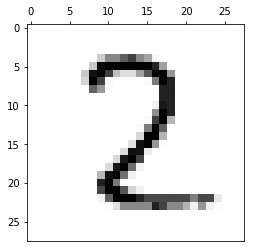

this is number
2
accuracy
0.446233207209


this is number
8
accuracy
0.319917267774


image


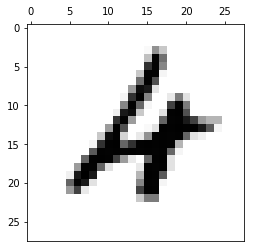

image


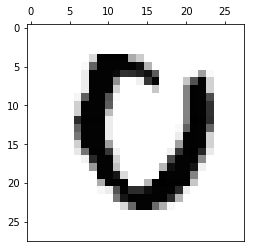

this is number
0
accuracy
0.744199111457


image


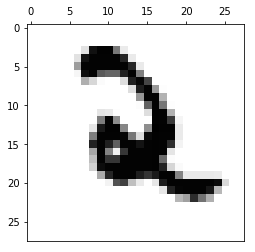

this is number
2
accuracy
0.417347319288


image


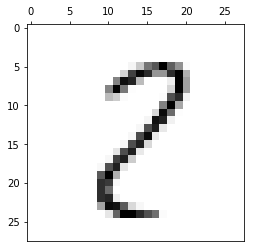

this is number
8
accuracy
0.644587742859


image


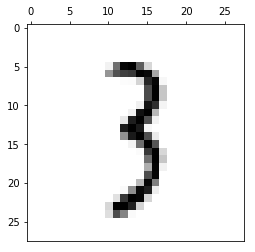

this is number
1
accuracy
0.393359026961


this is number
3
accuracy
0.466323608273


image


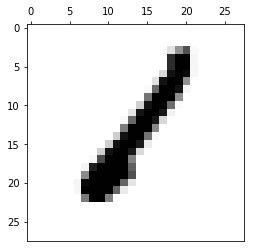

this is number
1
accuracy
0.514186037881


this is number
2
accuracy
0.347957390771


image


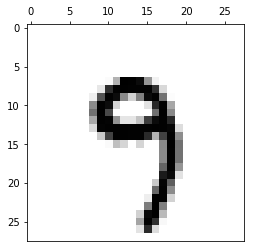

this is number
9
accuracy
0.429750560432


image


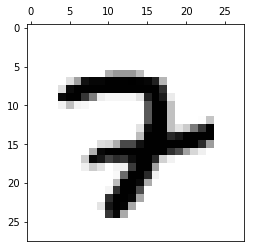

image


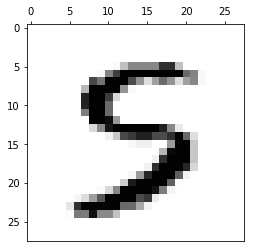

this is number
3
accuracy
0.312935324573


image


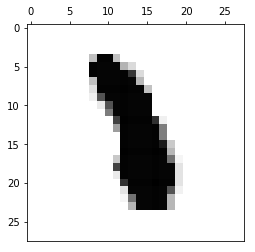

image


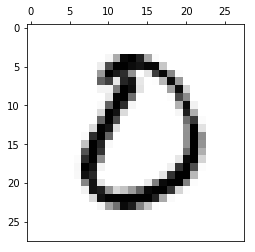

this is number
0
accuracy
0.797150425493


image


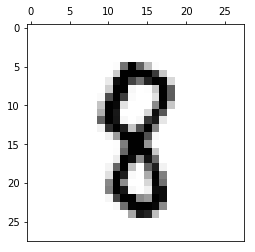

this is number
8
accuracy
0.317573301608


image


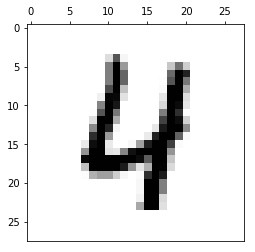

this is number
4
accuracy
0.487712679348


image


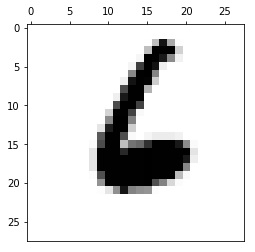

this is number
6
accuracy
0.804169676008


image


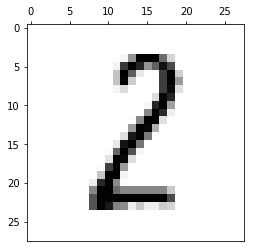

this is number
1
accuracy
0.356766964358


this is number
3
accuracy
0.300871735646


this is number
8
accuracy
0.418876508381


image


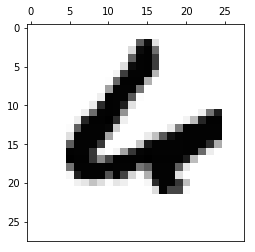

this is number
6
accuracy
0.620927555912


image


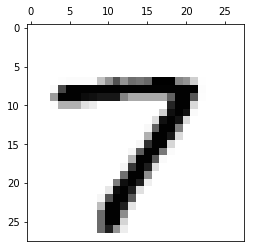

this is number
7
accuracy
0.813388232632


image


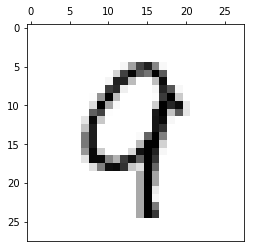

image


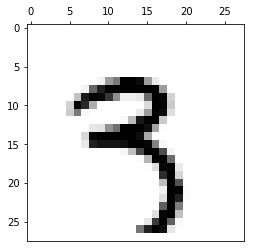

this is number
9
accuracy
0.336295759565


image


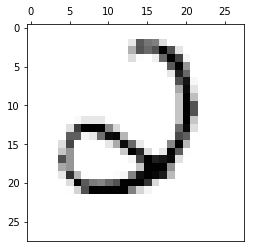

this is number
2
accuracy
0.30110523376


this is number
6
accuracy
0.330374708592


image


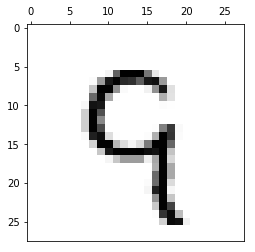

this is number
4
accuracy
0.361621173883


this is number
9
accuracy
0.452094894342


image


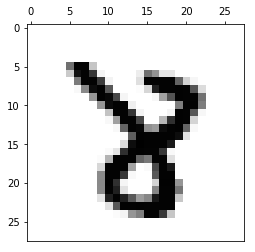

this is number
8
accuracy
0.303333777679


image


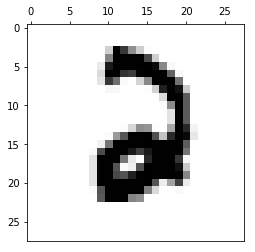

this is number
2
accuracy
0.486382690868


image


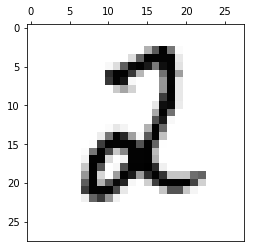

this is number
2
accuracy
0.704571801072


image


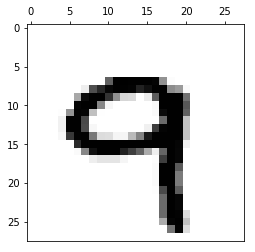

this is number
9
accuracy
0.463722825939


image


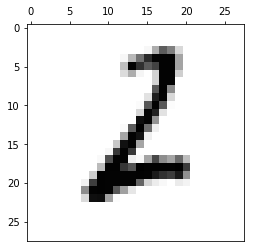

this is number
1
accuracy
0.359694171458


this is number
2
accuracy
0.542258328345


image


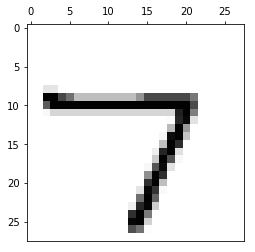

this is number
7
accuracy
0.722127754062


image


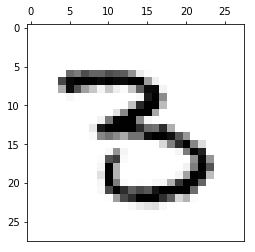

this is number
3
accuracy
0.424040828552


image


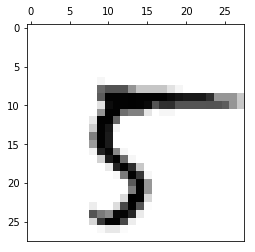

this is number
7
accuracy
0.407833384203


image


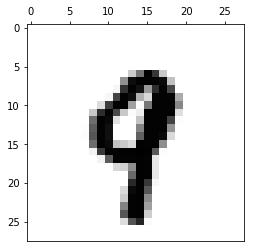

image


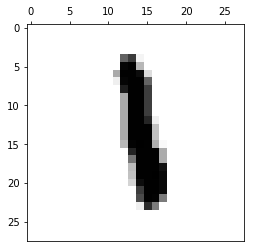

this is number
1
accuracy
0.389625706914


image


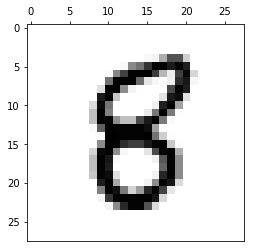

image


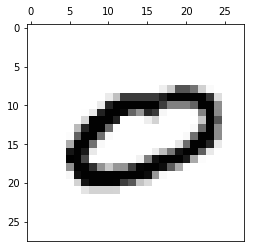

this is number
0
accuracy
0.655853781201


image


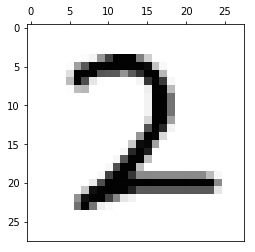

this is number
2
accuracy
0.656843464436


image


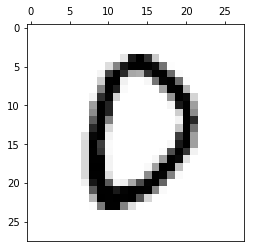

this is number
0
accuracy
0.729082633386


image


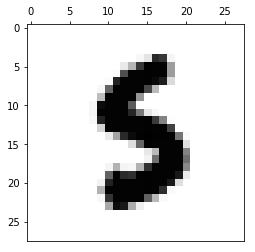

image


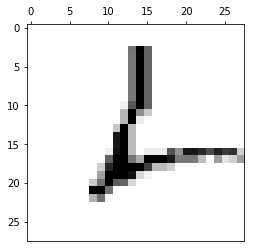

this is number
2
accuracy
0.417047110363


this is number
6
accuracy
0.47844288615


image


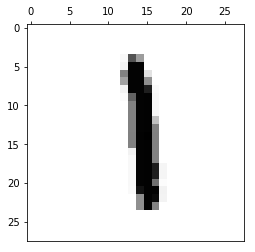

this is number
1
accuracy
0.567090678502


image


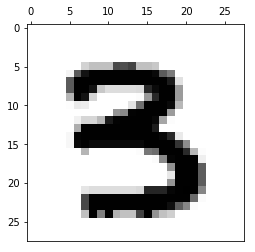

this is number
3
accuracy
0.600188838378


image


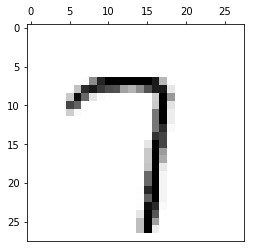

this is number
7
accuracy
0.598305101962


this is number
9
accuracy
0.406296622332


image


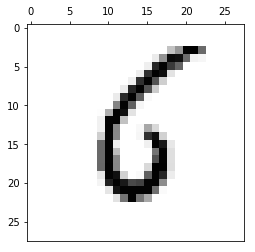

this is number
6
accuracy
0.607113961306


image


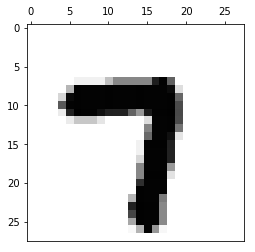

this is number
7
accuracy
0.769799968515


image


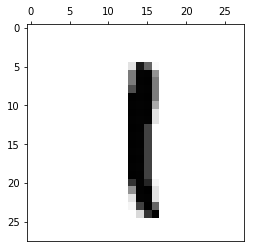

this is number
1
accuracy
0.783448933597


image


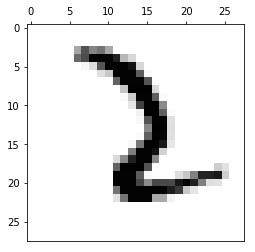

image


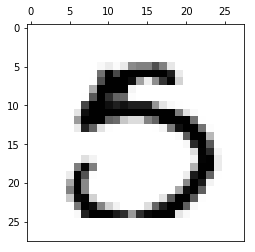

this is number
0
accuracy
0.312586258068


image


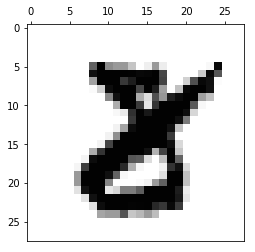

image


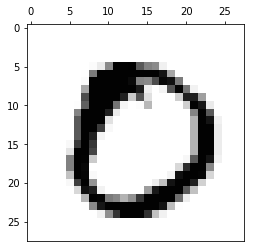

this is number
0
accuracy
0.806727814381


image


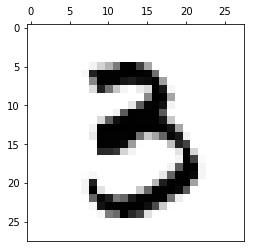

this is number
3
accuracy
0.722686454384


image


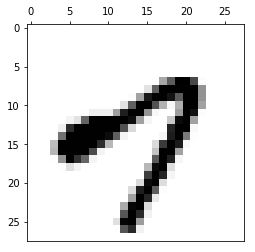

this is number
4
accuracy
0.356013492691


this is number
0
accuracy
0.320151433053


image


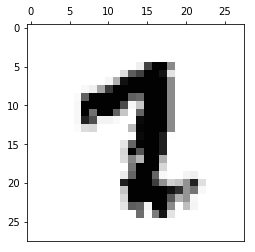

image


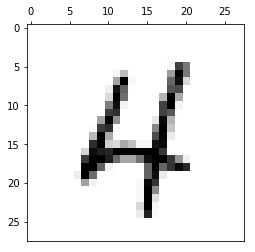

this is number
4
accuracy
0.534172519114


image


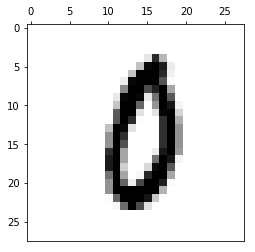

image


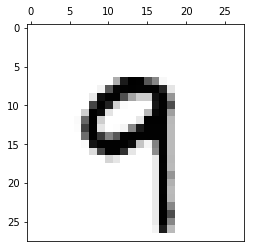

this is number
9
accuracy
0.622079183608


image


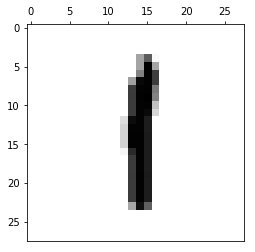

this is number
1
accuracy
0.776693287872


image


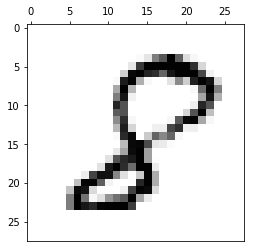

this is number
8
accuracy
0.49178351385


image


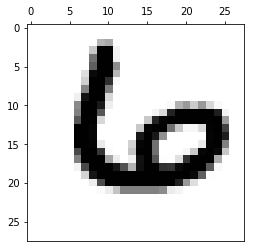

this is number
6
accuracy
0.441317772454


image


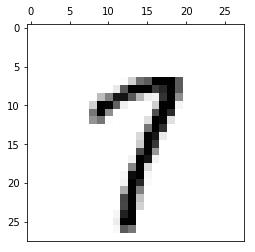

this is number
7
accuracy
0.566897112074


this is number
9
accuracy
0.394294047673


image


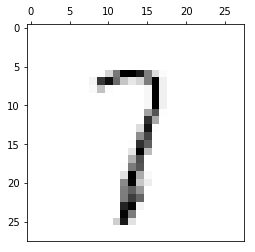

this is number
1
accuracy
0.506836069345


image


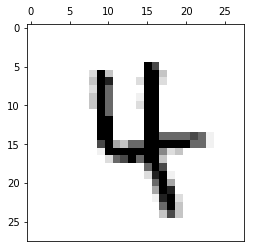

image


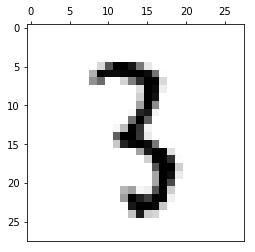

this is number
3
accuracy
0.530217891445


image


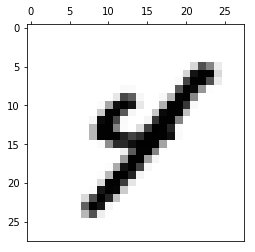

this is number
4
accuracy
0.357434072188


image


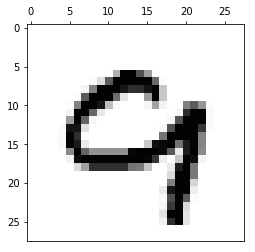

image


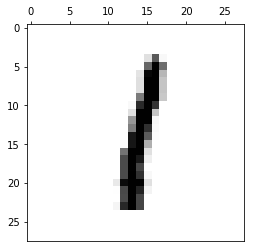

this is number
1
accuracy
0.831144960877


image


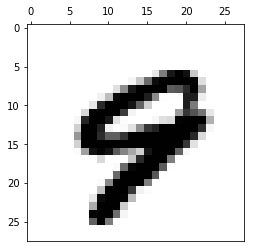

image


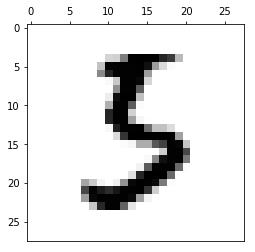

this is number
3
accuracy
0.313896881658


image


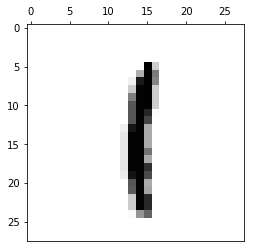

this is number
1
accuracy
0.79740553637


image


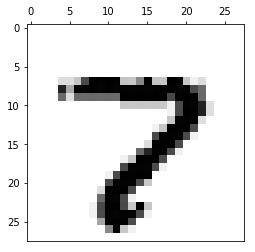

this is number
7
accuracy
0.804135281531


image


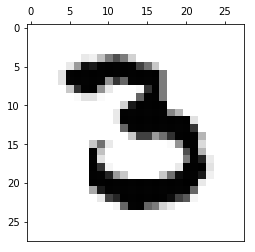

this is number
3
accuracy
0.487039652174


image


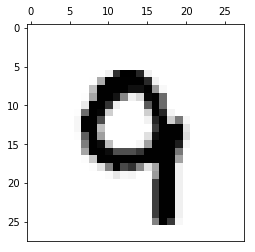

this is number
9
accuracy
0.313838212912


image


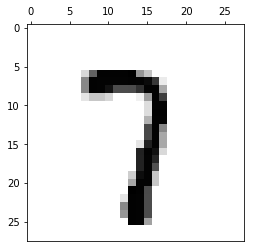

this is number
7
accuracy
0.43888228824


image


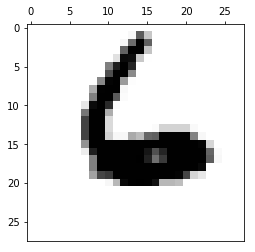

this is number
6
accuracy
0.739054930983


image


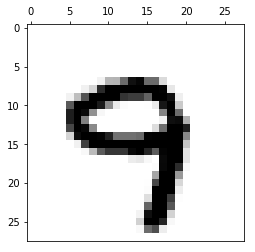

this is number
9
accuracy
0.400739456827


image


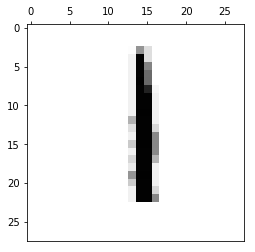

this is number
1
accuracy
0.687321636957


image


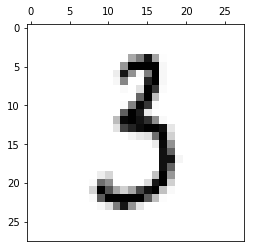

this is number
3
accuracy
0.599829152092


image


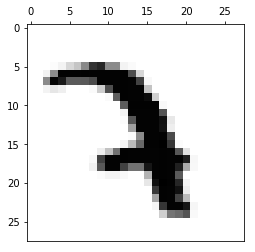

image


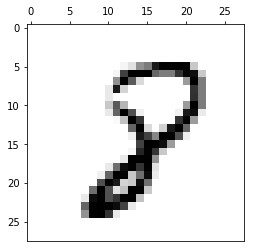

image


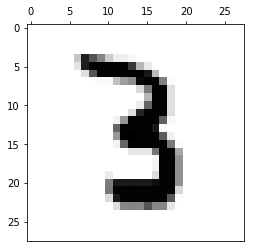

this is number
3
accuracy
0.609079771704


image


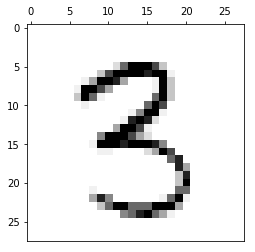

this is number
3
accuracy
0.616830908715


image


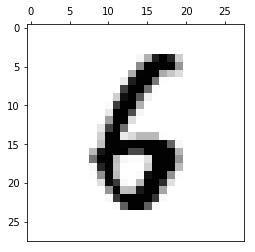

this is number
6
accuracy
0.325501638092


image


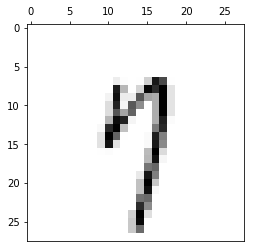

this is number
7
accuracy
0.404137111174


this is number
9
accuracy
0.394575523984


image


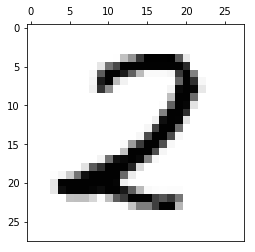

this is number
2
accuracy
0.673190809837


this is number
8
accuracy
0.372641214646


image


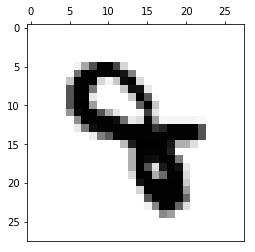

image


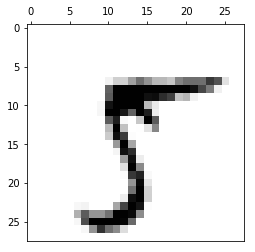

this is number
7
accuracy
0.381882997086


image


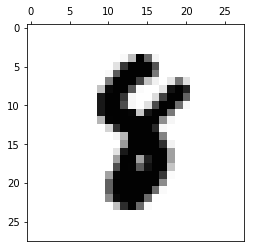

image


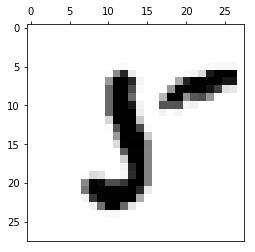

this is number
5
accuracy
0.336498274001


this is number
8
accuracy
0.38212030642


image


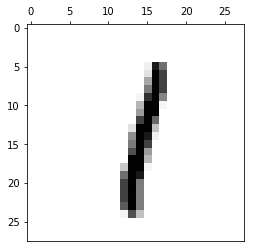

this is number
1
accuracy
0.781370494398


image


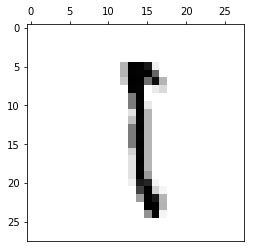

this is number
1
accuracy
0.605865223246


image


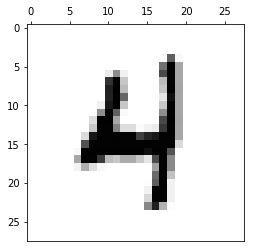

this is number
4
accuracy
0.679523416781


this is number
9
accuracy
0.319106747962


image


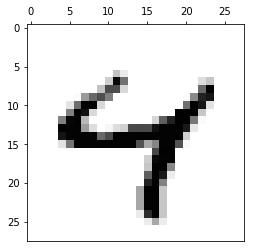

this is number
4
accuracy
0.529109890376


this is number
9
accuracy
0.344342889349


image


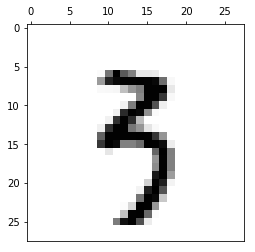

this is number
3
accuracy
0.349151309591


image


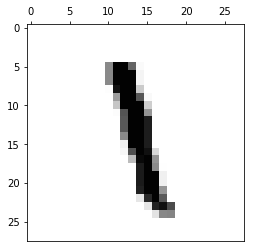

this is number
1
accuracy
0.366546881174


image


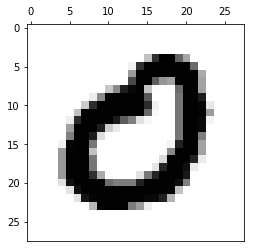

this is number
0
accuracy
0.921541846921


image


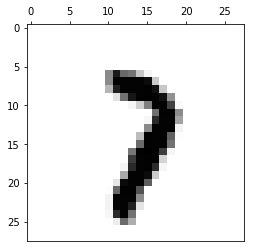

this is number
7
accuracy
0.482907489428


image


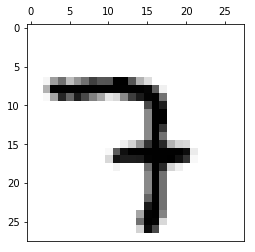

this is number
7
accuracy
0.422747245399


image


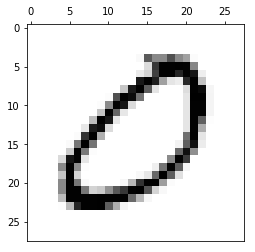

this is number
5
accuracy
0.319773715847


this is number
0
accuracy
0.852012124539


image


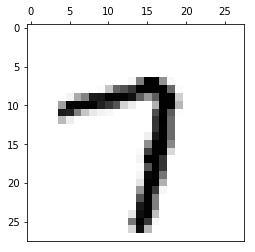

this is number
7
accuracy
0.758887827406


this is number
9
accuracy
0.433265881486


image


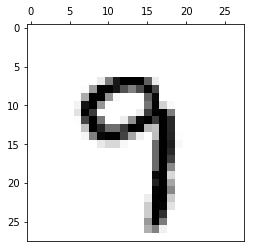

this is number
9
accuracy
0.418418382947


image


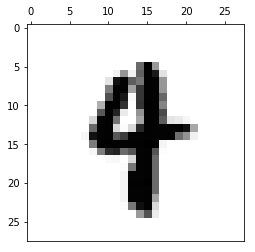

image


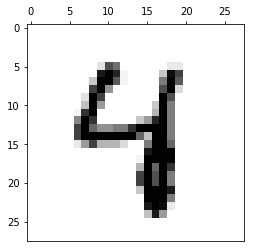

this is number
4
accuracy
0.390273856674


image


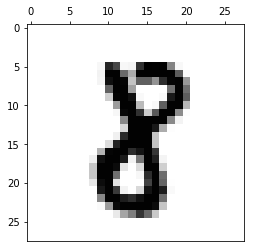

this is number
8
accuracy
0.485411611973


image


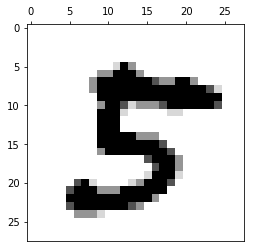

image


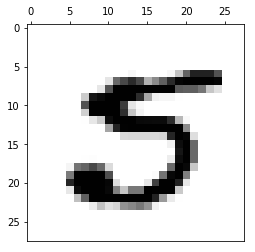

this is number
5
accuracy
0.446825602488


image


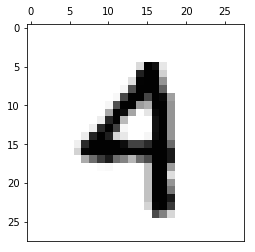

image


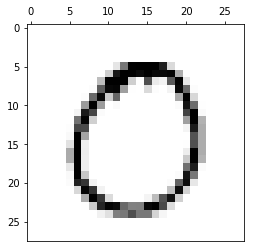

this is number
3
accuracy
0.308513072688


this is number
8
accuracy
0.356923224654


this is number
0
accuracy
0.728026090065


image


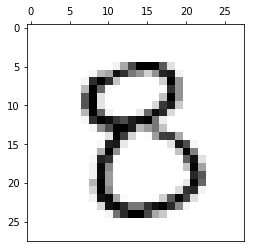

this is number
3
accuracy
0.392821101213


this is number
8
accuracy
0.368531887618


image


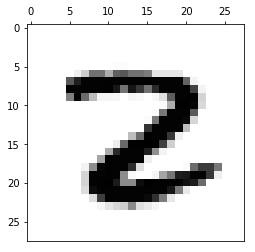

image


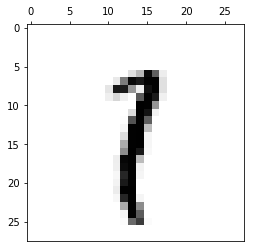

this is number
1
accuracy
0.743859097823


image


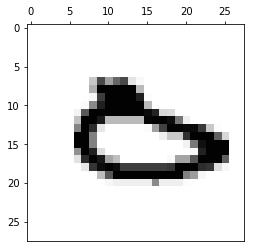

this is number
6
accuracy
0.527827844588


image


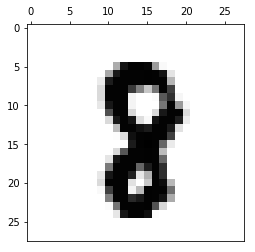

image


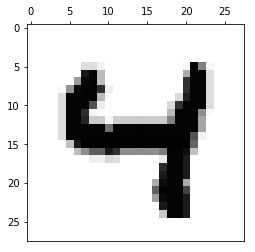

this is number
4
accuracy
0.644199006117


image


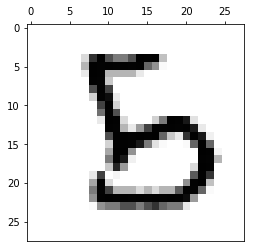

this is number
8
accuracy
0.366120770733


image


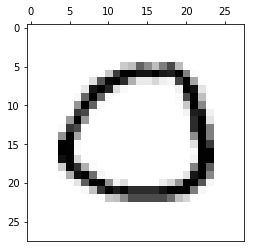

this is number
2
accuracy
0.418308810562


this is number
0
accuracy
0.795880919007


image


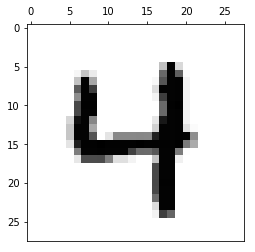

this is number
4
accuracy
0.683292214887


image


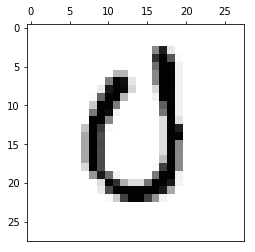

this is number
0
accuracy
0.359415376458


image


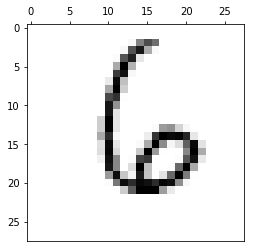

this is number
6
accuracy
0.739390072389


image


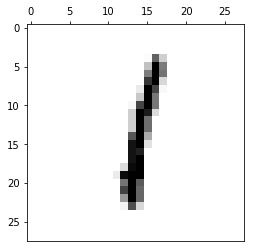

this is number
1
accuracy
0.819042492293


image


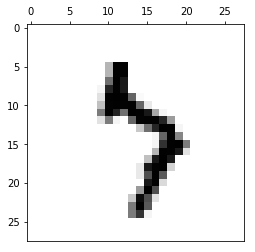

image


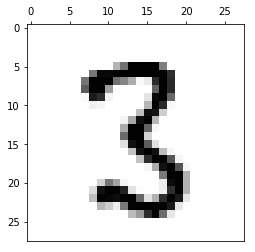

this is number
3
accuracy
0.499930664699


image


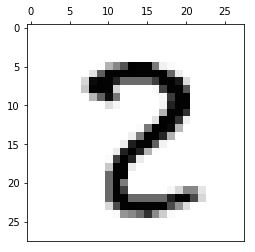

this is number
8
accuracy
0.504134051922


image


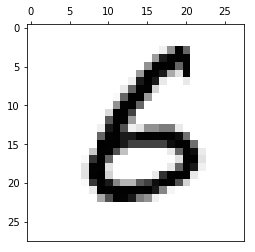

this is number
6
accuracy
0.544991769172


image


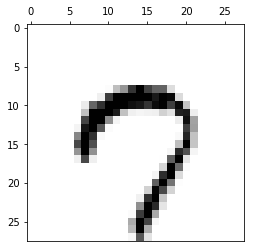

this is number
7
accuracy
0.412148481175


this is number
0
accuracy
0.493255793044


image


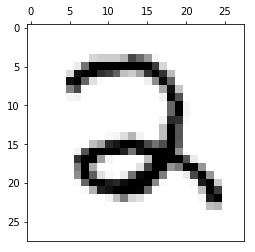

this is number
2
accuracy
0.73265265624


image


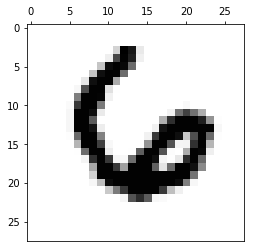

this is number
6
accuracy
0.620360405186


image


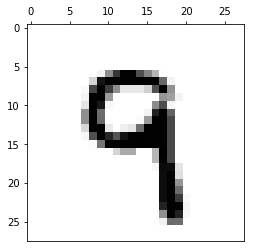

this is number
9
accuracy
0.458448855838


image


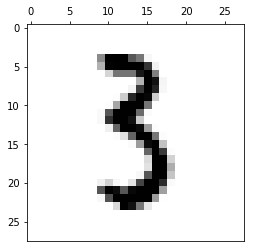

this is number
3
accuracy
0.300409642273


image


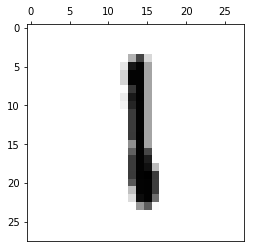

this is number
1
accuracy
0.650709286611


image


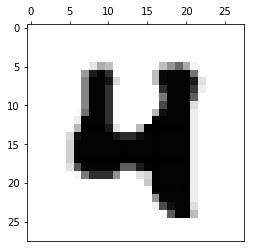

this is number
4
accuracy
0.504196783497


image


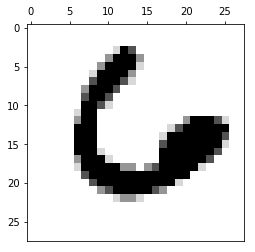

this is number
2
accuracy
0.305517163217


this is number
6
accuracy
0.779520294307


this is number
0
accuracy
0.558434625631


image


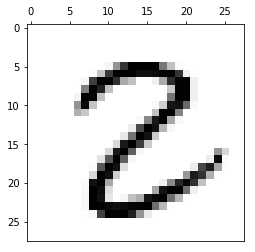

this is number
2
accuracy
0.326206837807


this is number
3
accuracy
0.306060951441


this is number
8
accuracy
0.678281545402


image


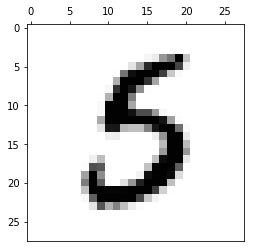

image


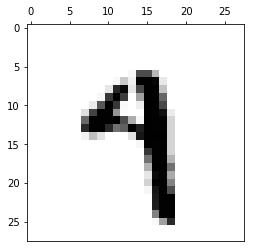

this is number
9
accuracy
0.448847754365


image


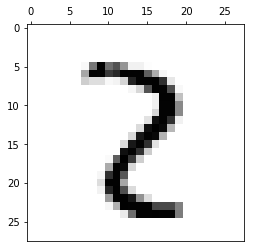

this is number
8
accuracy
0.360512945351


image


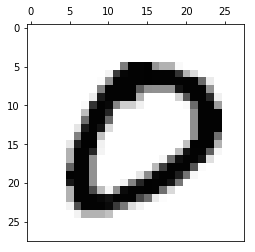

this is number
0
accuracy
0.927635263797


image


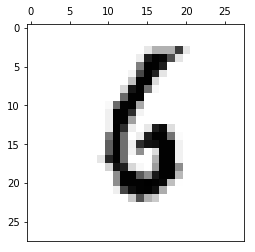

this is number
6
accuracy
0.614055623433


image


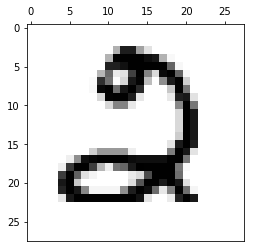

this is number
2
accuracy
0.494717793782


this is number
0
accuracy
0.331728289529


image


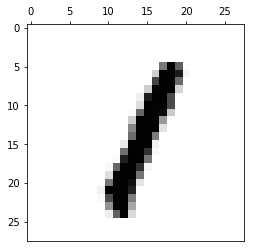

this is number
1
accuracy
0.712472814514


image


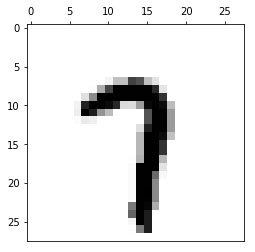

this is number
7
accuracy
0.635708858366


this is number
9
accuracy
0.328576227678


image


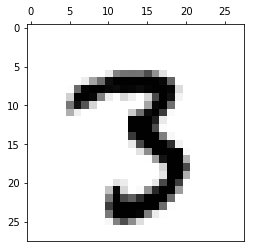

this is number
3
accuracy
0.442513768021


image


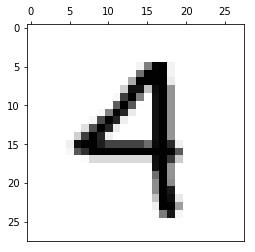

this is number
4
accuracy
0.338692039388


this is number
9
accuracy
0.358422086726


image


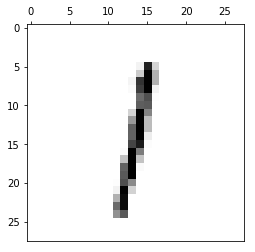

this is number
1
accuracy
0.774132760129


image


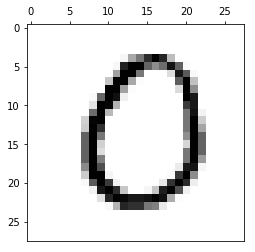

this is number
0
accuracy
0.8402722267


image


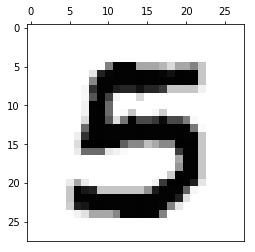

image


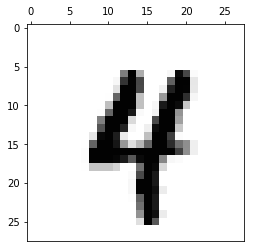

this is number
4
accuracy
0.371403446607


image


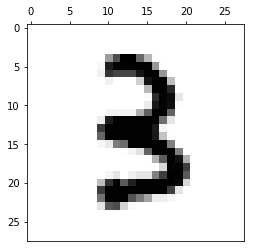

this is number
3
accuracy
0.493473140799


image


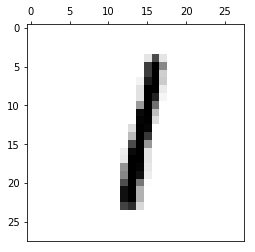

this is number
1
accuracy
0.814105773887


image


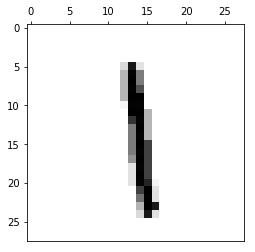

this is number
1
accuracy
0.642562491531


image


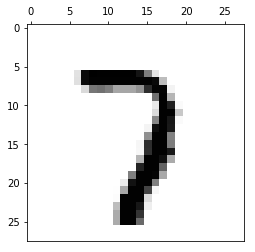

this is number
7
accuracy
0.469488856492


image


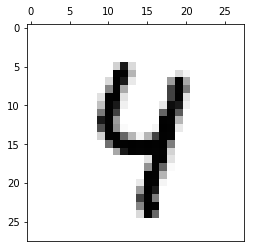

this is number
4
accuracy
0.475608951644


this is number
9
accuracy
0.332027670316


image


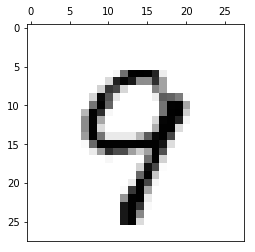

this is number
9
accuracy
0.48907904877


image


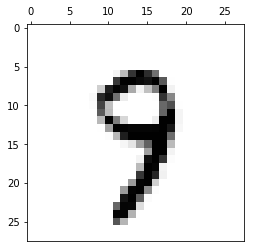

this is number
9
accuracy
0.360426322904


image


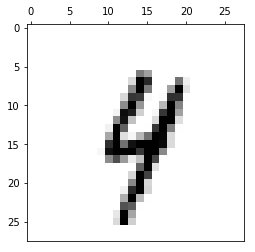

image


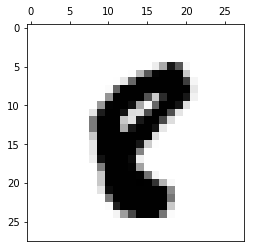

image


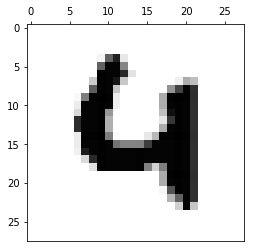

this is number
4
accuracy
0.597229282582


image


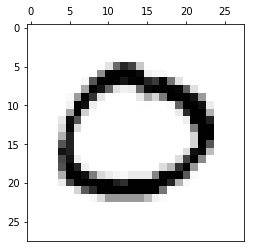

this is number
2
accuracy
0.311808549242


this is number
0
accuracy
0.775390359609


image


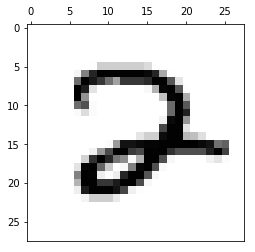

this is number
2
accuracy
0.588981543101


image


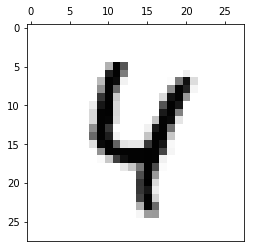

this is number
4
accuracy
0.609173615387


image


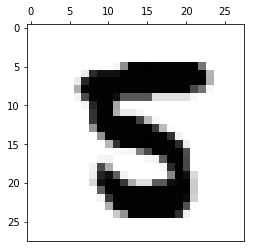

image


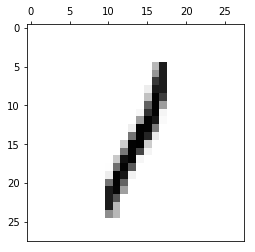

this is number
1
accuracy
0.754744386833


image


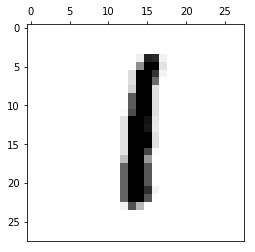

this is number
1
accuracy
0.795423341826


image


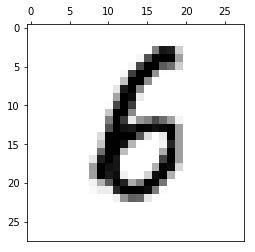

this is number
6
accuracy
0.695354396222


image


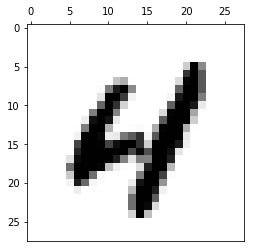

this is number
4
accuracy
0.613554088575


image


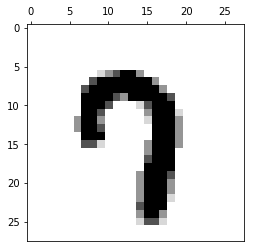

this is number
7
accuracy
0.452988059123


this is number
9
accuracy
0.310547202512


image


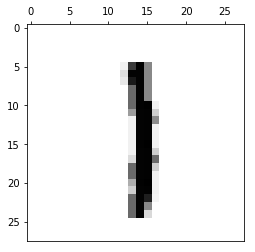

this is number
1
accuracy
0.649270726463


image


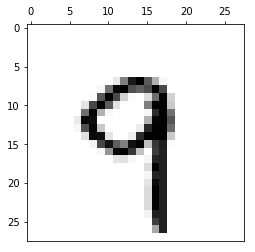

this is number
9
accuracy
0.572993820094


image


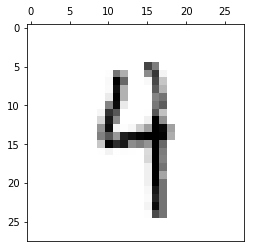

this is number
4
accuracy
0.338971955188


this is number
9
accuracy
0.429050385575


image


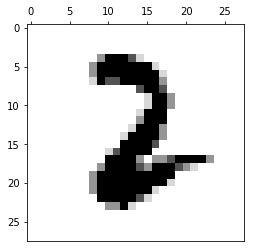

image


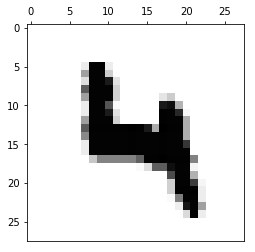

this is number
4
accuracy
0.721772889076


image


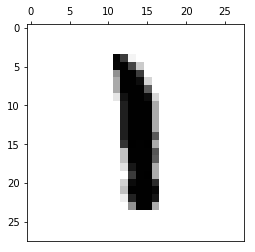

this is number
1
accuracy
0.494660920528


image


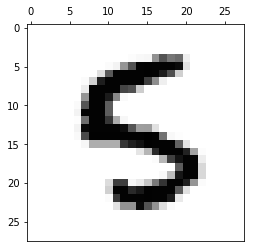

image


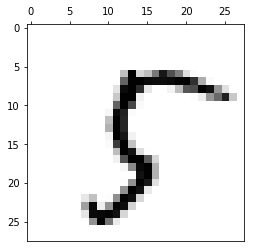

this is number
5
accuracy
0.36851011337


this is number
8
accuracy
0.37056511528


image


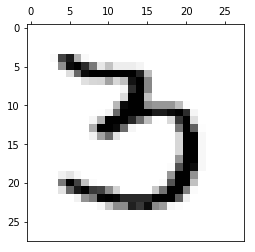

this is number
3
accuracy
0.581005501581


this is number
5
accuracy
0.304483569702


this is number
0
accuracy
0.352996298902


image


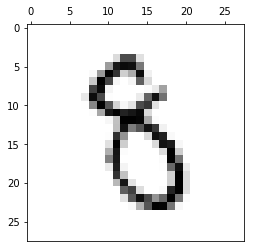

this is number
3
accuracy
0.384645769214


image


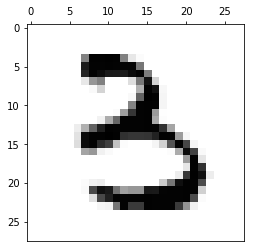

this is number
3
accuracy
0.640995848297


image


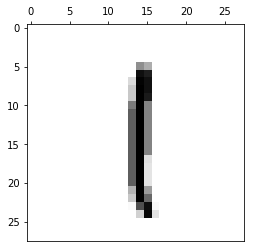

this is number
1
accuracy
0.770581294344


image


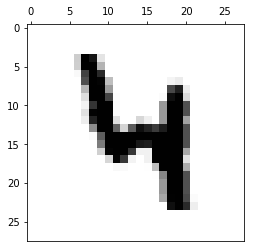

this is number
4
accuracy
0.585384468338


image


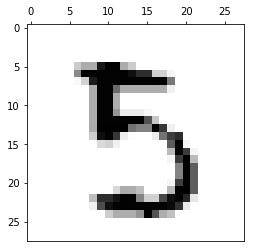

this is number
3
accuracy
0.470858959216


this is number
5
accuracy
0.443928755107


image


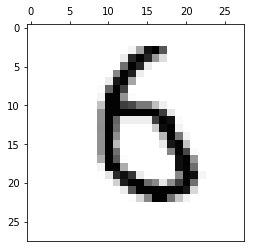

this is number
6
accuracy
0.569272288425


image


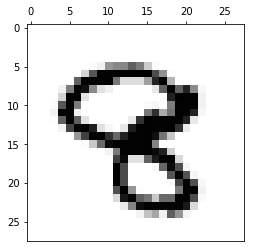

image


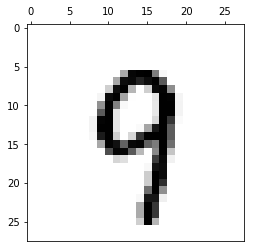

this is number
9
accuracy
0.527650302261


image


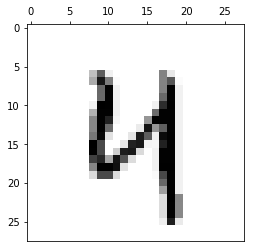

this is number
4
accuracy
0.478380824837


this is number
9
accuracy
0.32650913052


image


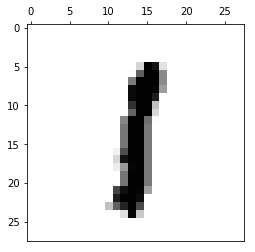

this is number
1
accuracy
0.743763769393


image


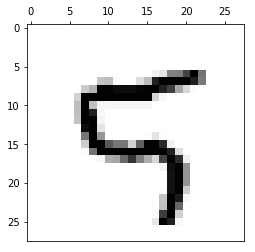

this is number
9
accuracy
0.304505360677


image


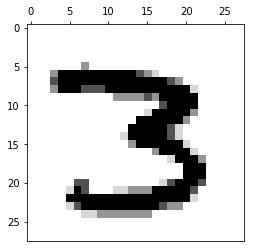

this is number
3
accuracy
0.595880538547


image


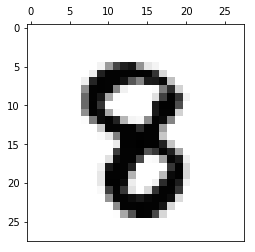

image


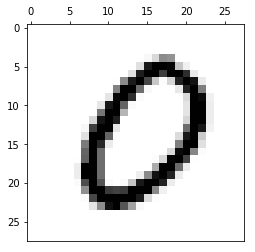

this is number
0
accuracy
0.893586788854


image


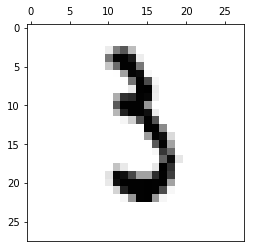

this is number
6
accuracy
0.307390987675


image


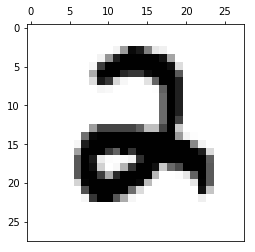

this is number
2
accuracy
0.583314147948


image


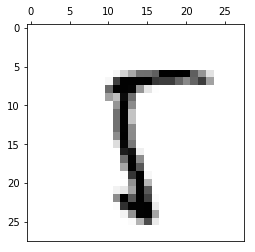

this is number
5
accuracy
0.366638422325


this is number
8
accuracy
0.45972142503


image


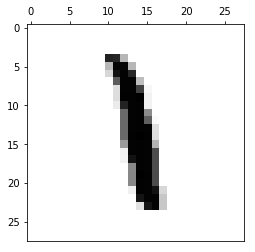

this is number
1
accuracy
0.42877622209


image


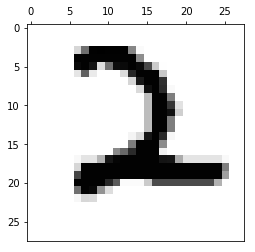

this is number
2
accuracy
0.860599184668


image


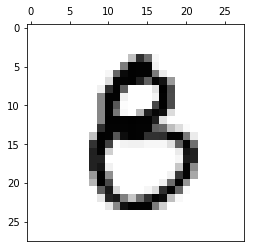

image


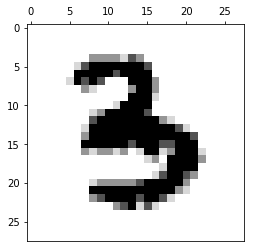

image


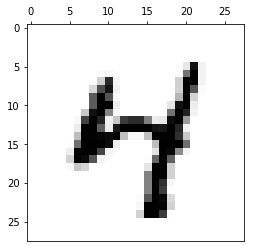

this is number
4
accuracy
0.665213575326


image


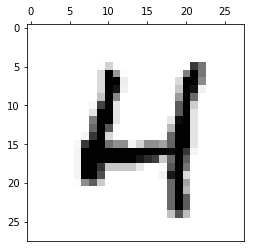

this is number
4
accuracy
0.630775525994


image


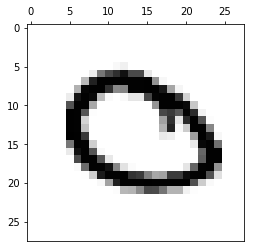

this is number
0
accuracy
0.431042108219


image


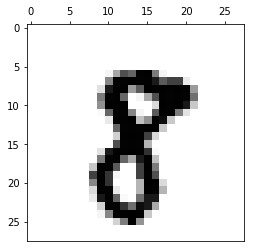

this is number
8
accuracy
0.430436439378


image


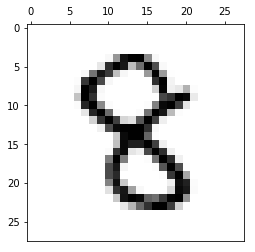

image


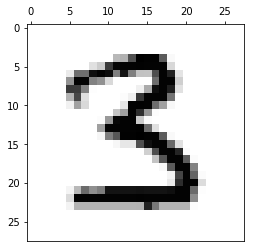

this is number
3
accuracy
0.708091633244


image


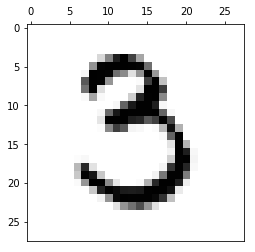

this is number
3
accuracy
0.644285434071


image


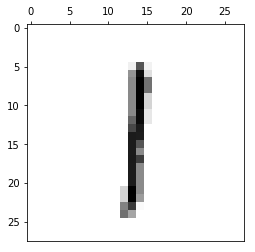

this is number
1
accuracy
0.719488695097


image


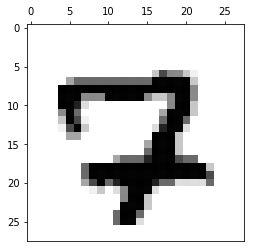

this is number
7
accuracy
0.355770807697


image


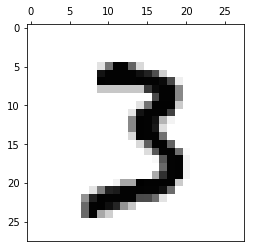

this is number
3
accuracy
0.695089746862


image


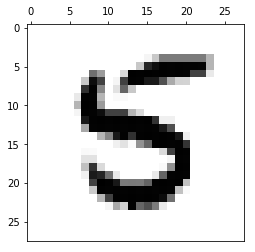

image


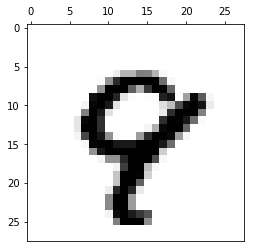

this is number
9
accuracy
0.34012780802


image


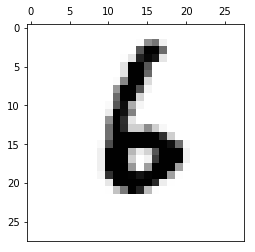

this is number
6
accuracy
0.696528073303


image


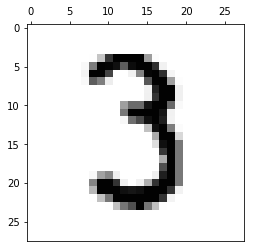

this is number
3
accuracy
0.682037454053


image


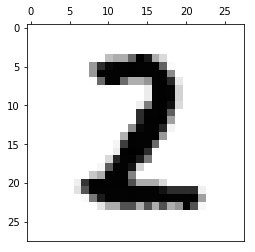

image


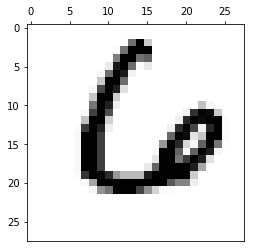

this is number
6
accuracy
0.777660443354


this is number
0
accuracy
0.654204992475


image


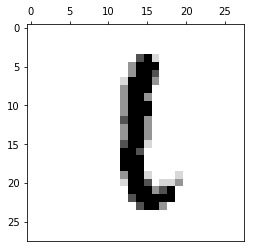

this is number
1
accuracy
0.658495723033


image


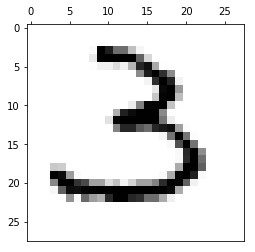

this is number
3
accuracy
0.722428331753


image


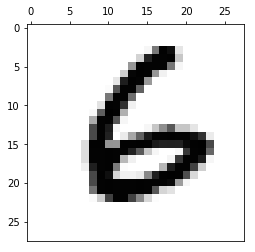

this is number
6
accuracy
0.780977791897


image


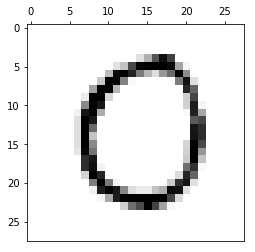

this is number
0
accuracy
0.794012909721


image


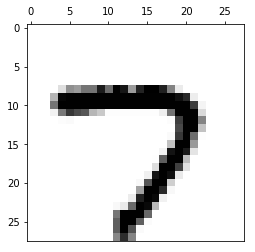

this is number
7
accuracy
0.810171589031


image


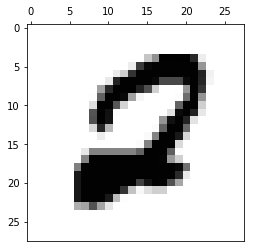

image


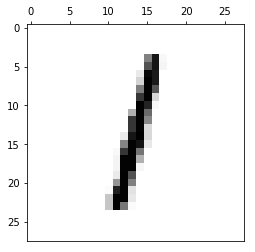

this is number
1
accuracy
0.806610079321


image


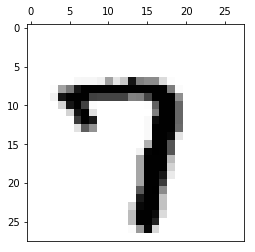

this is number
7
accuracy
0.784062293726


this is number
9
accuracy
0.336556707771


image


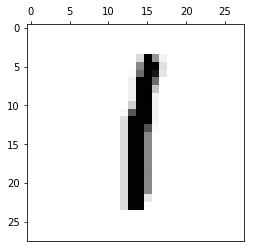

this is number
1
accuracy
0.802976787358


image


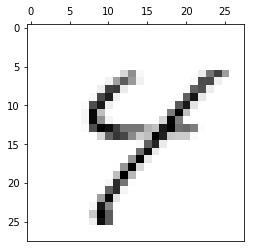

this is number
4
accuracy
0.329762526151


this is number
8
accuracy
0.322738355021


image


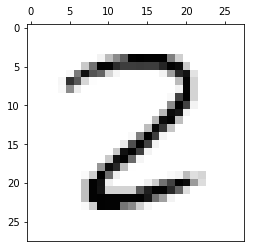

this is number
2
accuracy
0.503652486171


this is number
8
accuracy
0.454579303022


image


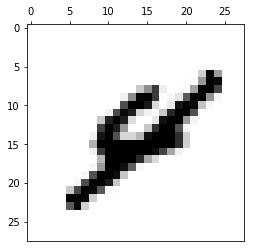

this is number
4
accuracy
0.305595449385


image


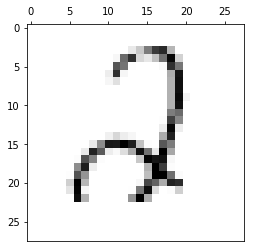

this is number
2
accuracy
0.494514085875


this is number
4
accuracy
0.354014254786


image


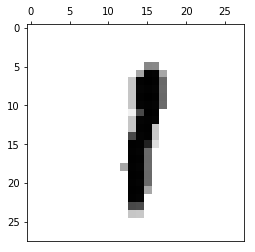

this is number
1
accuracy
0.782393099033


image


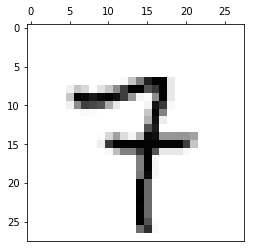

this is number
7
accuracy
0.361711237873


this is number
9
accuracy
0.339482221984


image


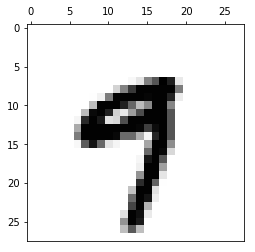

this is number
9
accuracy
0.364630263914


image


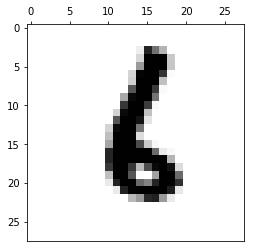

this is number
6
accuracy
0.309947592766


image


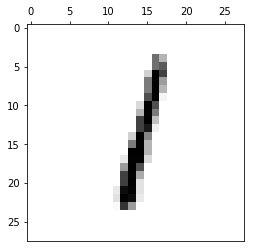

this is number
1
accuracy
0.787347917539


image


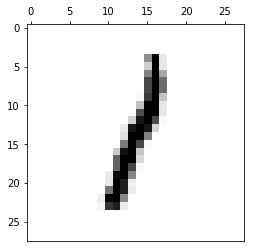

this is number
1
accuracy
0.797378895414


image


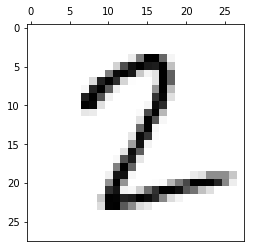

image


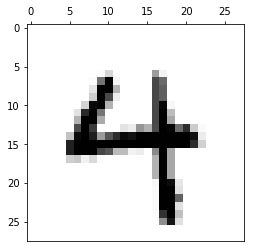

this is number
4
accuracy
0.655404628332


this is number
9
accuracy
0.445852770228


image


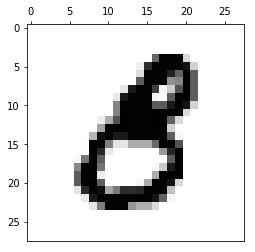

image


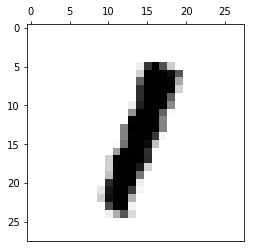

this is number
1
accuracy
0.694876924851


image


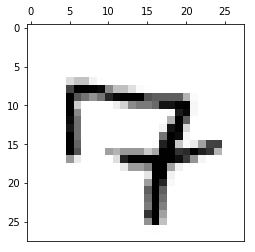

this is number
7
accuracy
0.567016590671


image


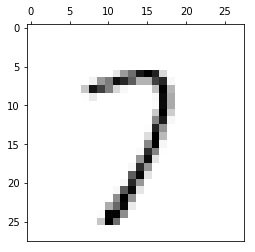

this is number
7
accuracy
0.459250808412


image


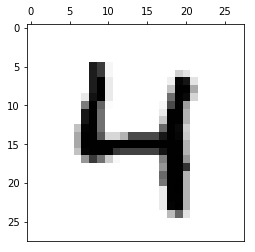

this is number
4
accuracy
0.755487947239


image


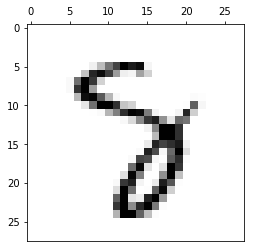

image


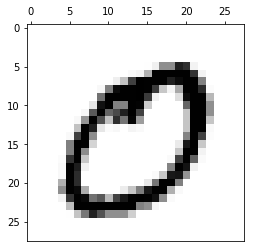

this is number
5
accuracy
0.310722511406


this is number
0
accuracy
0.84787054343


image


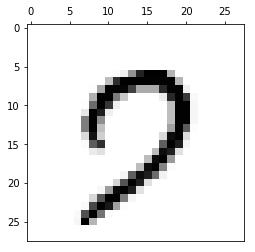

this is number
7
accuracy
0.358406441724


image


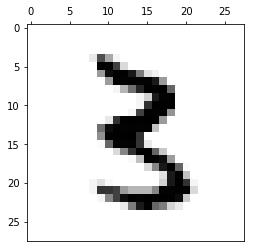

this is number
3
accuracy
0.41999848045


image


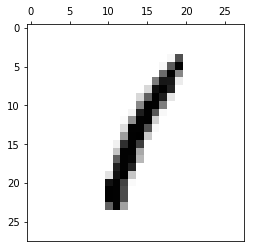

this is number
1
accuracy
0.788733144006


image


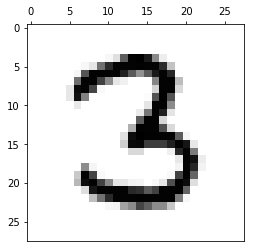

this is number
3
accuracy
0.665163228247


image


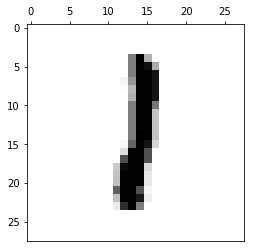

this is number
1
accuracy
0.795940266233


image


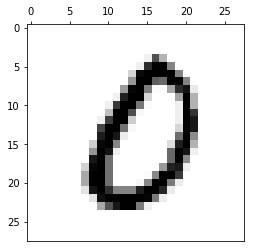

this is number
0
accuracy
0.726215000034


image


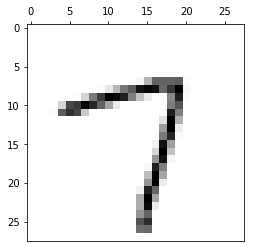

this is number
7
accuracy
0.692120270819


this is number
9
accuracy
0.452006144134


image


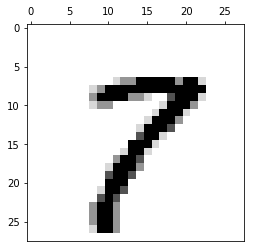

this is number
7
accuracy
0.343351358279


image


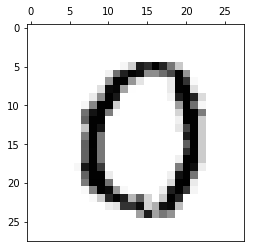

this is number
0
accuracy
0.871312057139


image


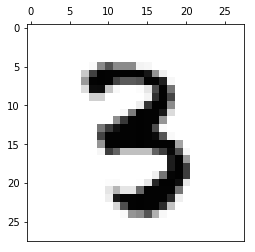

this is number
3
accuracy
0.616999751311


image


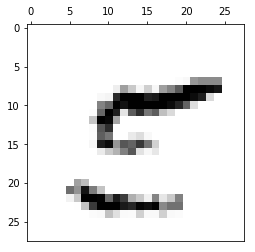

this is number
5
accuracy
0.357375411663


image


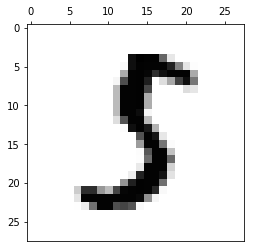

image


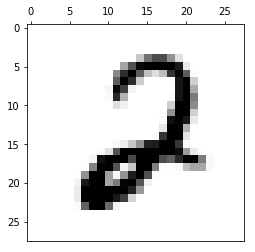

this is number
2
accuracy
0.551220497125


image


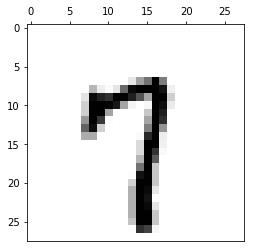

this is number
7
accuracy
0.572936829605


this is number
9
accuracy
0.421625401574


image


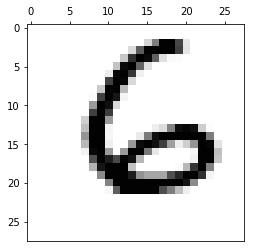

this is number
6
accuracy
0.829309811464


image


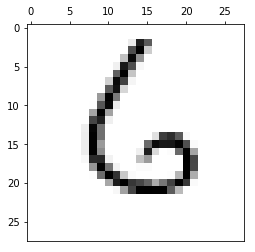

this is number
6
accuracy
0.672162182618


image


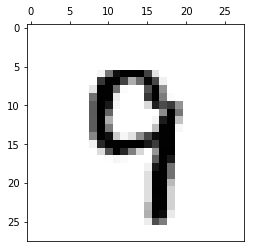

this is number
9
accuracy
0.424167671336


image


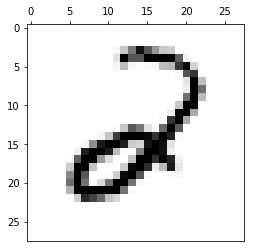

this is number
2
accuracy
0.56866461897


image


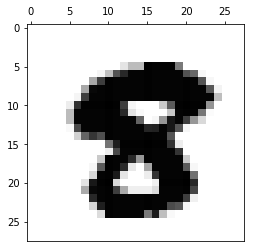

image


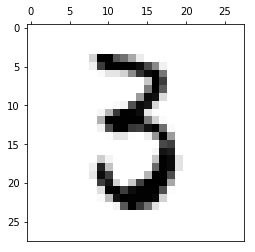

this is number
3
accuracy
0.464506687743


image


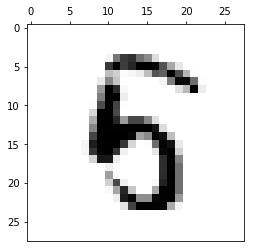

this is number
5
accuracy
0.308040345474


image


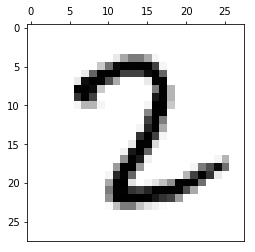

this is number
2
accuracy
0.355713285965


image


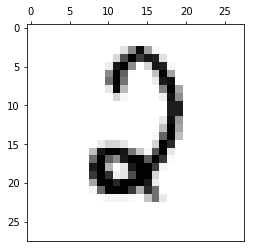

this is number
2
accuracy
0.655904305593


image


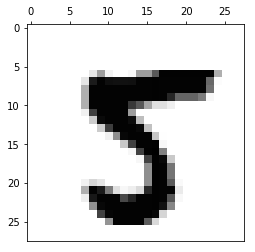

this is number
5
accuracy
0.385832591554


image


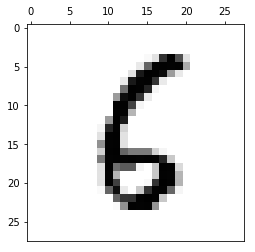

this is number
6
accuracy
0.307991121359


image


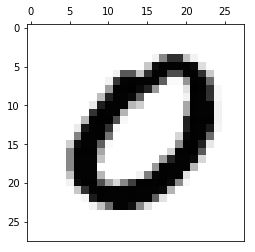

this is number
0
accuracy
0.944423561805


image


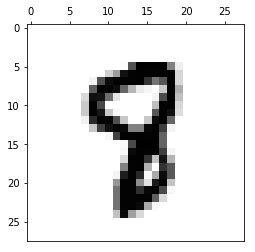

image


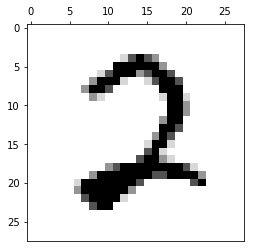

this is number
2
accuracy
0.75497960897


image


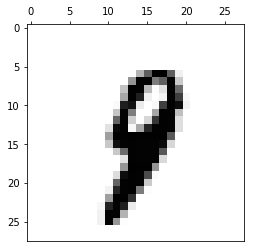

image


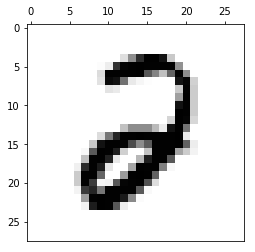

this is number
2
accuracy
0.439429793709


image


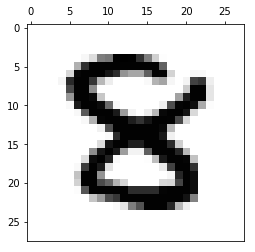

image


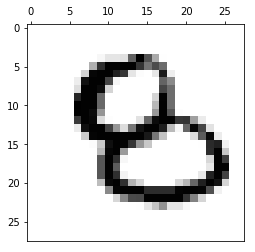

image


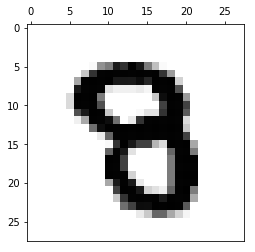

image


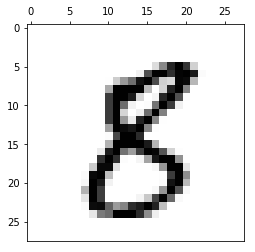

this is number
8
accuracy
0.400808373703


image


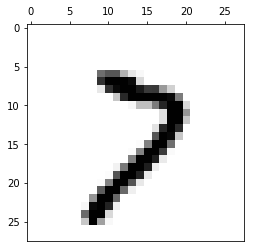

this is number
7
accuracy
0.641090301275


image


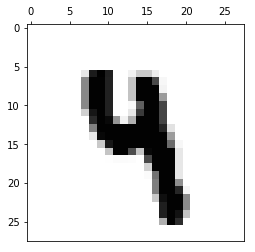

image


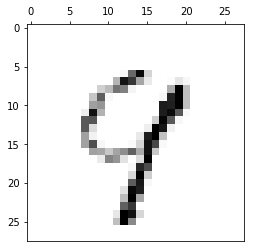

this is number
4
accuracy
0.310131917822


this is number
7
accuracy
0.393114256651


this is number
9
accuracy
0.375236422009


image


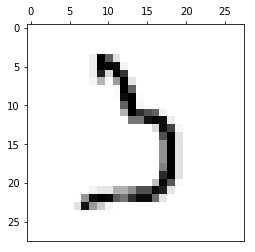

this is number
3
accuracy
0.642328995872


image


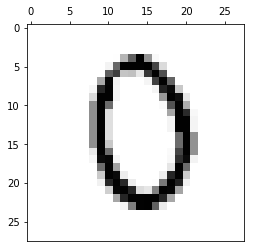

this is number
0
accuracy
0.453873069431


image


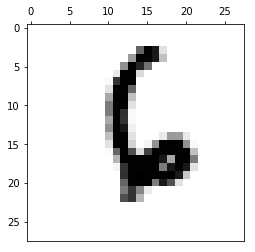

this is number
6
accuracy
0.572806411964


image


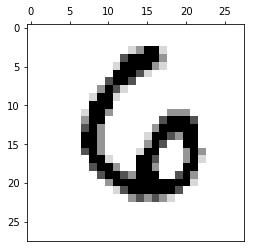

this is number
6
accuracy
0.561178471754


image


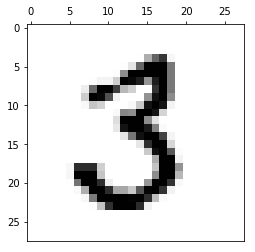

this is number
3
accuracy
0.454126434015


image


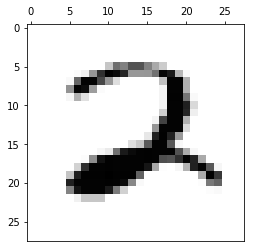

this is number
2
accuracy
0.852128697664


image


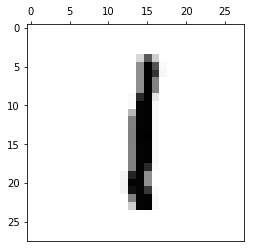

this is number
1
accuracy
0.774580452629


image


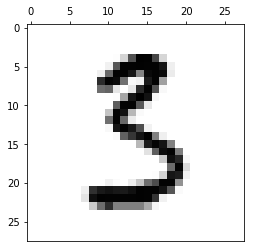

this is number
3
accuracy
0.476383322264


image


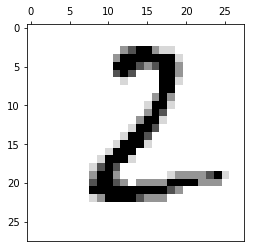

this is number
2
accuracy
0.509319289806


image


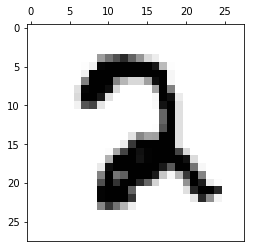

this is number
2
accuracy
0.618944142602


image


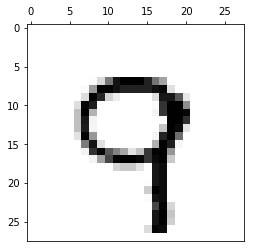

this is number
7
accuracy
0.430150150466


this is number
9
accuracy
0.462040374751


image


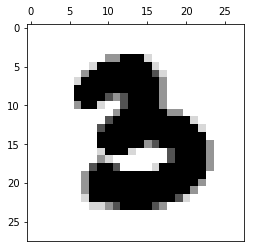

image


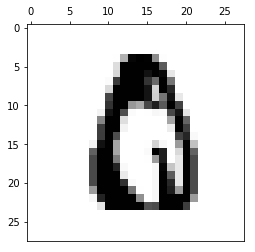

image


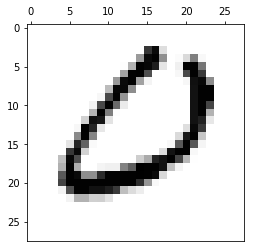

this is number
2
accuracy
0.316202600142


this is number
0
accuracy
0.649587278098


image


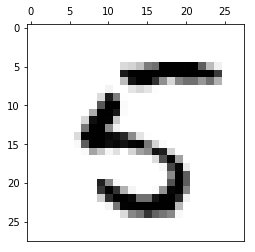

this is number
5
accuracy
0.52375378436


image


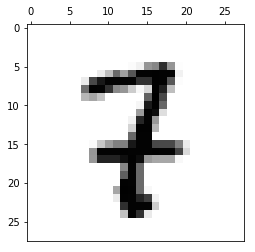

image


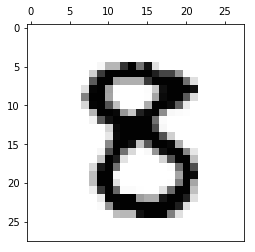

image


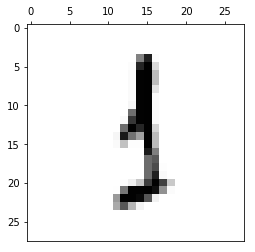

this is number
1
accuracy
0.457017759665


this is number
3
accuracy
0.364714285922


image


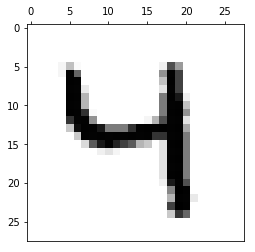

this is number
4
accuracy
0.536588773374


this is number
9
accuracy
0.303765772095


image


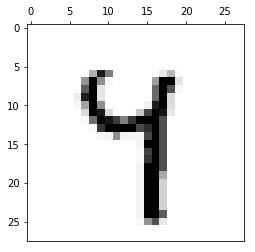

image


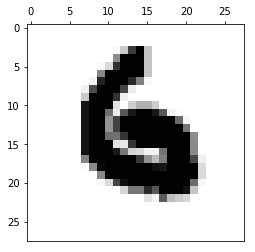

this is number
6
accuracy
0.400518794652


image


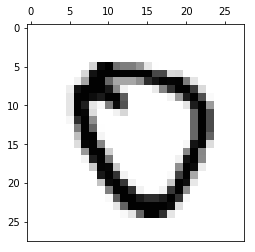

this is number
0
accuracy
0.688259314571


image


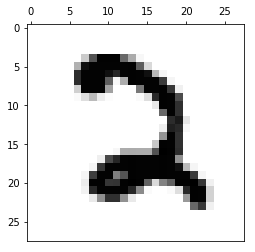

this is number
2
accuracy
0.782497838042


image


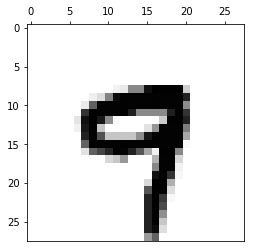

this is number
4
accuracy
0.345556223746


this is number
9
accuracy
0.310553682964


image


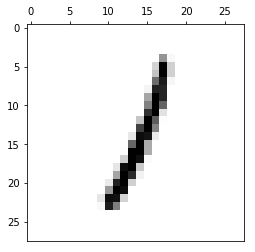

this is number
1
accuracy
0.754346518639


image


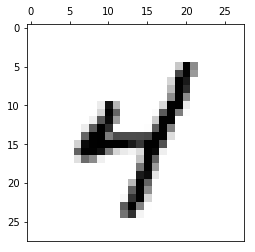

this is number
4
accuracy
0.731165589444


this is number
9
accuracy
0.341875128648


image


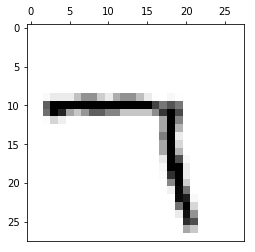

this is number
4
accuracy
0.307841014495


this is number
7
accuracy
0.577679812764


this is number
9
accuracy
0.32602266419


image


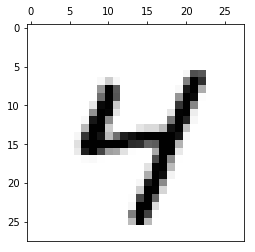

this is number
4
accuracy
0.684448916455


this is number
9
accuracy
0.394058130217


image


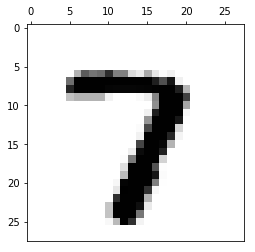

this is number
7
accuracy
0.573845387271


image


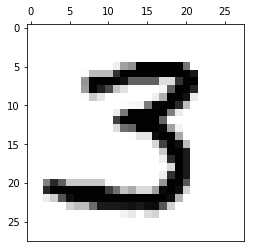

this is number
3
accuracy
0.841538567756


image


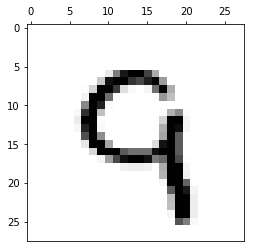

this is number
4
accuracy
0.319313044349


this is number
9
accuracy
0.385670902785


image


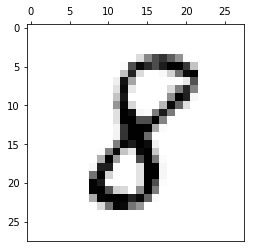

this is number
8
accuracy
0.477796105107


image


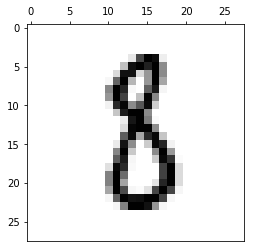

image


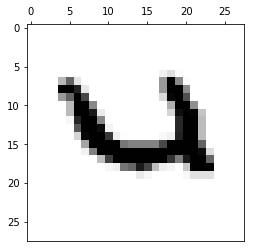

this is number
4
accuracy
0.728343370593


image


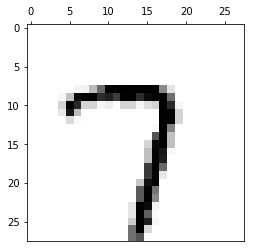

this is number
7
accuracy
0.817833698988


this is number
9
accuracy
0.354583429987


image


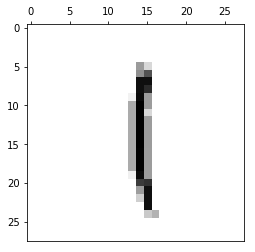

this is number
1
accuracy
0.730222984358


image


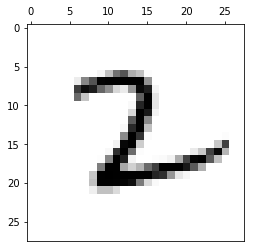

this is number
1
accuracy
0.33323462364


this is number
2
accuracy
0.339445639636


this is number
6
accuracy
0.387012110253


image


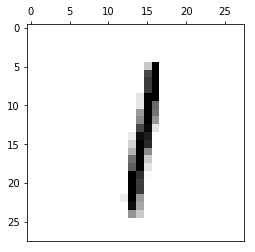

this is number
1
accuracy
0.755201979466


image


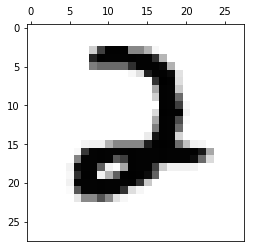

this is number
2
accuracy
0.794827221799


image


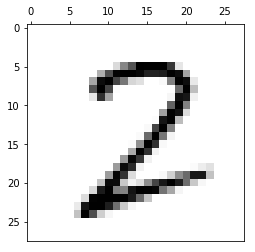

this is number
2
accuracy
0.360526502908


this is number
8
accuracy
0.323286184915


image


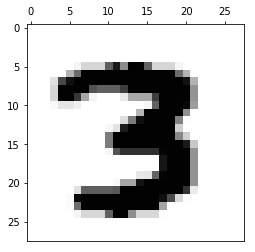

this is number
3
accuracy
0.54355634382


image


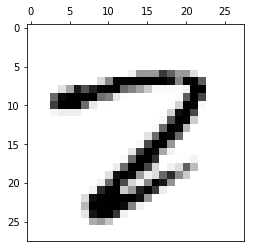

image


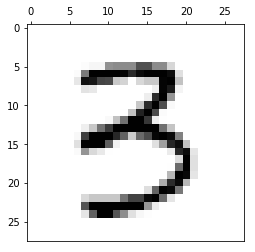

this is number
3
accuracy
0.774127963127


image


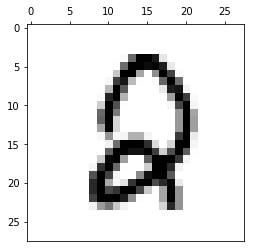

image


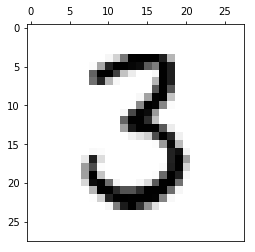

this is number
3
accuracy
0.718682260897


image


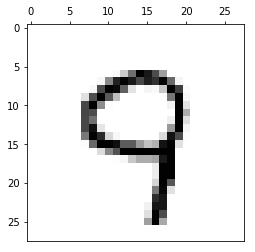

this is number
4
accuracy
0.310163912904


this is number
9
accuracy
0.430333859629


image


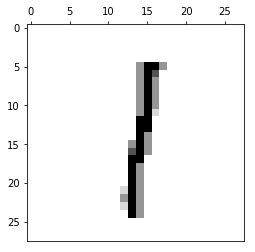

this is number
1
accuracy
0.77564013136


image


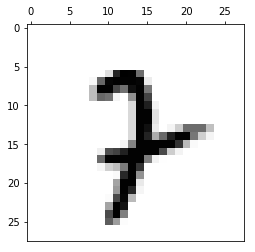

image


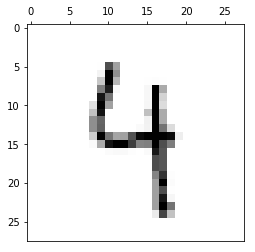

this is number
4
accuracy
0.48304747853


this is number
9
accuracy
0.435589350561


image


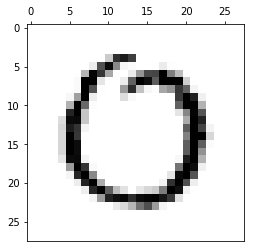

this is number
3
accuracy
0.314409049139


this is number
0
accuracy
0.84500781489


image


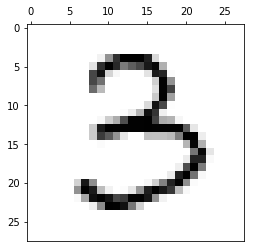

this is number
3
accuracy
0.750935768884


image


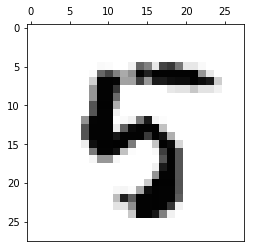

this is number
5
accuracy
0.310152006621


image


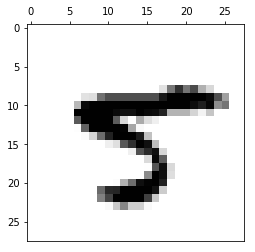

image


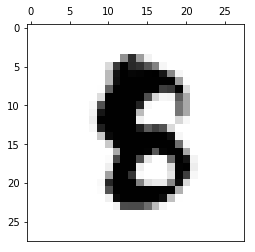

image


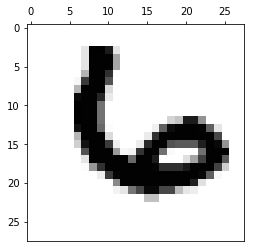

this is number
6
accuracy
0.686137292159


image


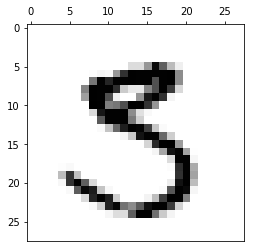

this is number
3
accuracy
0.348481130453


this is number
5
accuracy
0.357589952087


image


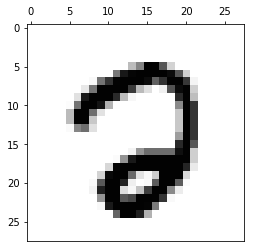

image


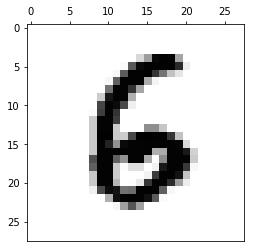

this is number
6
accuracy
0.373172428075


image


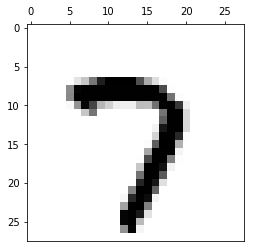

this is number
7
accuracy
0.850523869369


image


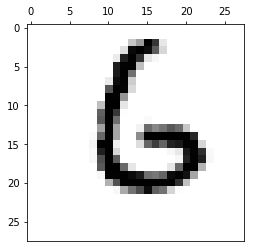

this is number
6
accuracy
0.870000203758


image


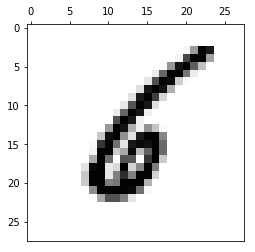

image


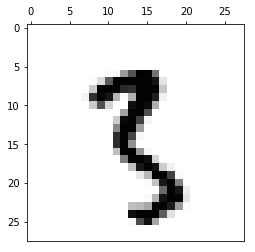

image


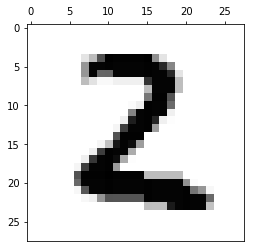

this is number
2
accuracy
0.482635981355


image


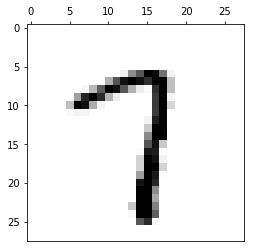

this is number
7
accuracy
0.449805850086


this is number
9
accuracy
0.322644939512


image


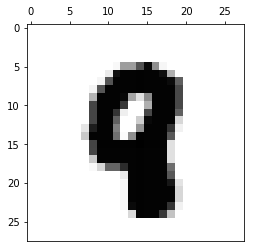

image


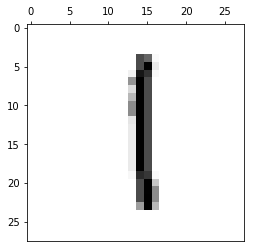

this is number
1
accuracy
0.690718048154


image


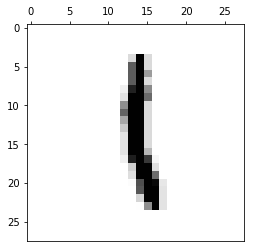

this is number
1
accuracy
0.617699228419


image


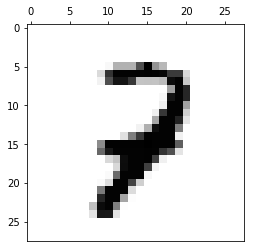

this is number
2
accuracy
0.305090600279


image


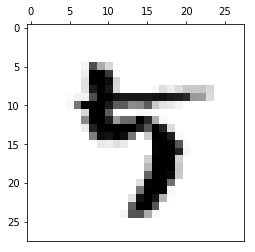

image


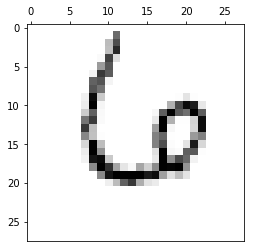

this is number
2
accuracy
0.366769175989


this is number
4
accuracy
0.340220794643


this is number
6
accuracy
0.538289863627


image


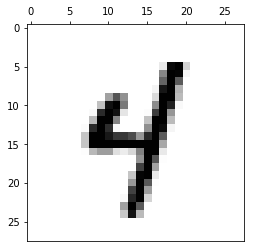

this is number
4
accuracy
0.513903715634


this is number
9
accuracy
0.319674603998


image


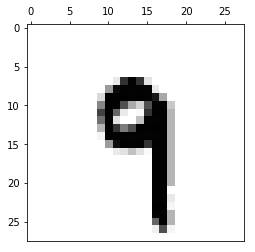

this is number
9
accuracy
0.412640455259


image


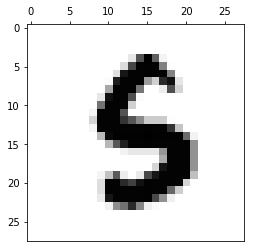

image


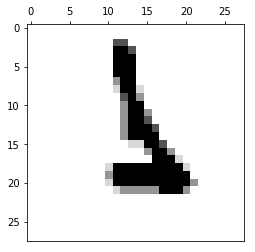

this is number
6
accuracy
0.383346746926


image


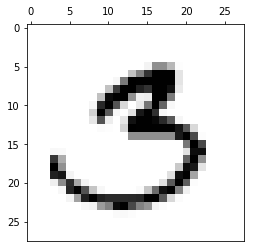

this is number
3
accuracy
0.359396953052


image


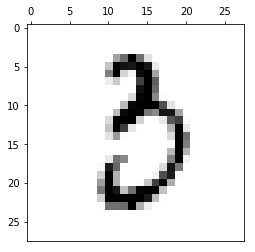

this is number
3
accuracy
0.461571901158


image


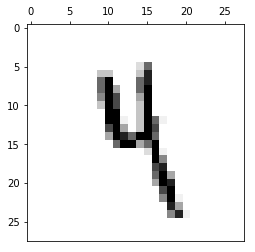

this is number
9
accuracy
0.304285261704


image


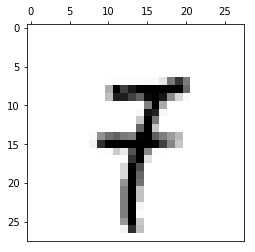

this is number
1
accuracy
0.332241728743


image


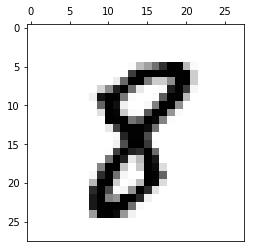

this is number
8
accuracy
0.481484854925


image


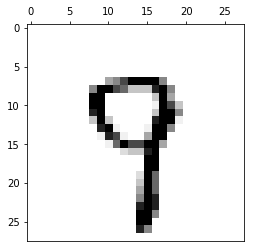

this is number
7
accuracy
0.357325365942


this is number
9
accuracy
0.495304144693


image


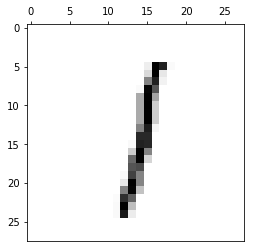

this is number
1
accuracy
0.729101916512


image


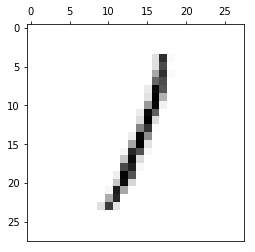

this is number
1
accuracy
0.743269177181


image


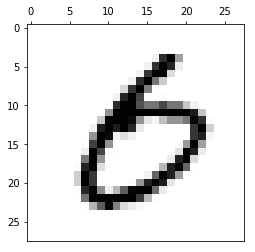

this is number
0
accuracy
0.602432412459


image


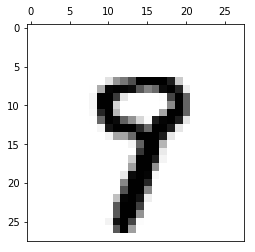

this is number
7
accuracy
0.303270704333


image


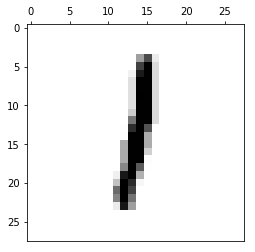

this is number
1
accuracy
0.835641339986


image


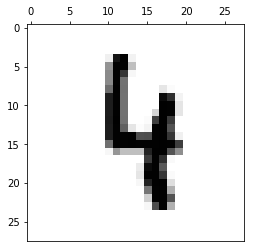

this is number
4
accuracy
0.40242016589


image


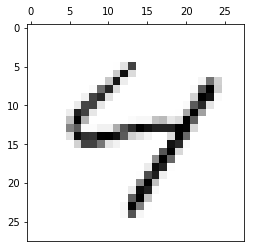

this is number
4
accuracy
0.385402755492


image


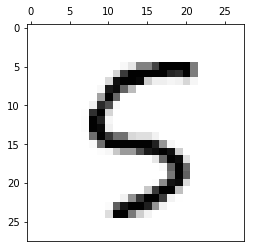

this is number
5
accuracy
0.3093373144


image


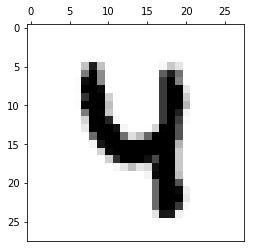

this is number
4
accuracy
0.631878920161


image


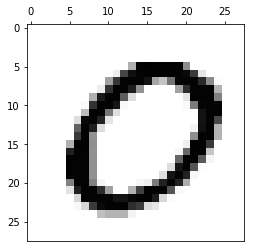

this is number
5
accuracy
0.343958312555


this is number
0
accuracy
0.930239642606


image


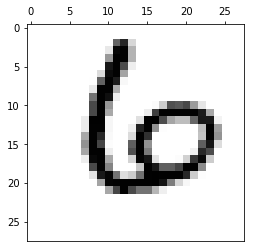

this is number
6
accuracy
0.381418315504


image


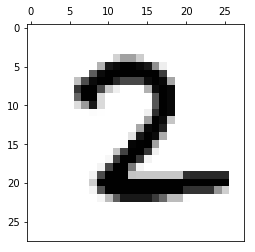

this is number
2
accuracy
0.445908381317


image


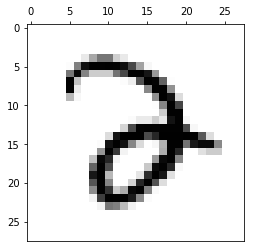

image


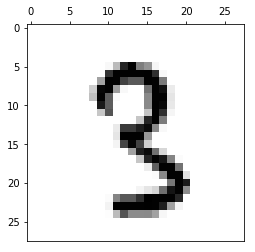

this is number
3
accuracy
0.365246061652


image


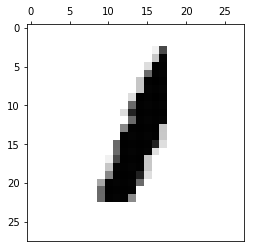

this is number
1
accuracy
0.706147648469


image


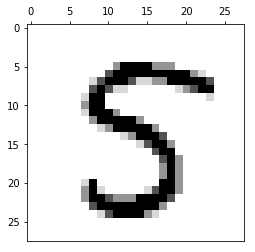

this is number
3
accuracy
0.482271608433


this is number
5
accuracy
0.516012157663


this is number
8
accuracy
0.442858955669


image


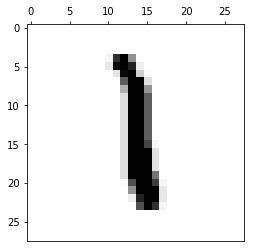

this is number
1
accuracy
0.638782079718


image


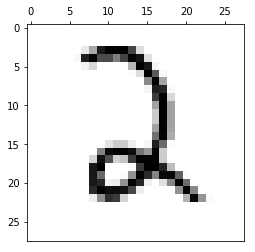

this is number
2
accuracy
0.660336040258


image


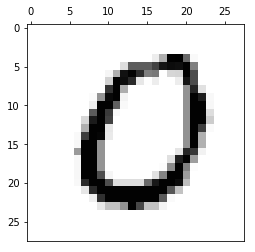

this is number
0
accuracy
0.895346409046


image


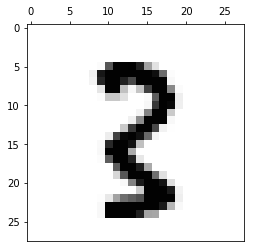

image


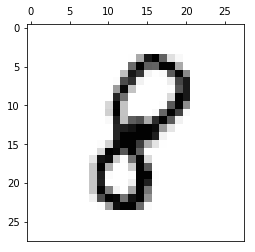

this is number
8
accuracy
0.507109178043


image


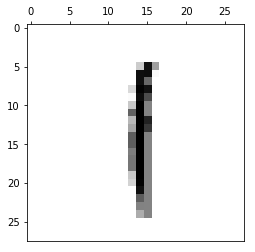

this is number
1
accuracy
0.768552168836


image


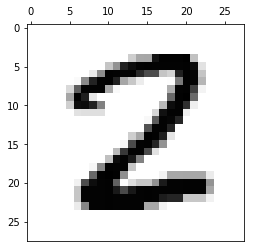

this is number
2
accuracy
0.390970416597


this is number
8
accuracy
0.376971412285


image


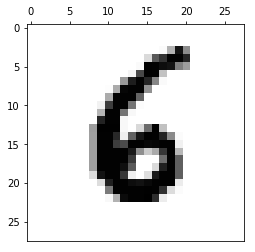

this is number
6
accuracy
0.624036583845


image


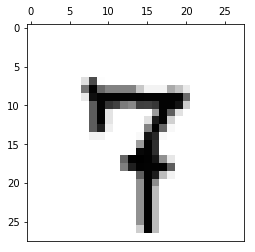

this is number
7
accuracy
0.608153945654


image


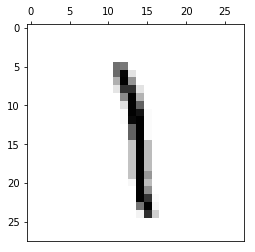

this is number
1
accuracy
0.586465386616


image


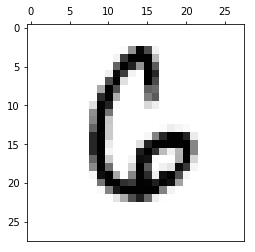

this is number
6
accuracy
0.51281819528


image


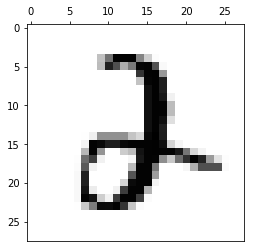

image


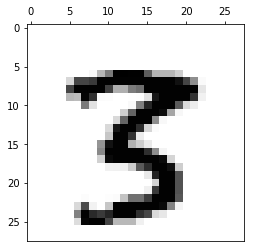

image


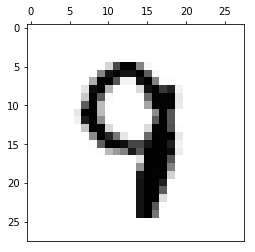

image


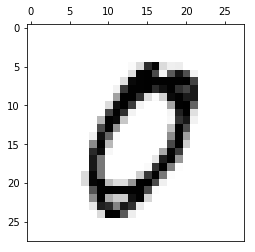

this is number
0
accuracy
0.559522356934


image


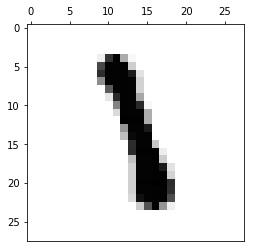

image


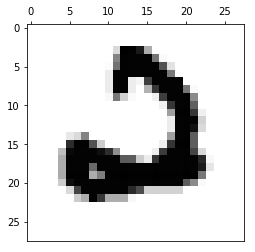

this is number
2
accuracy
0.782477239837


this is number
0
accuracy
0.534997996938


image


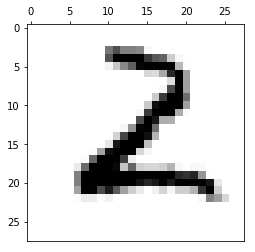

this is number
2
accuracy
0.764146149905


image


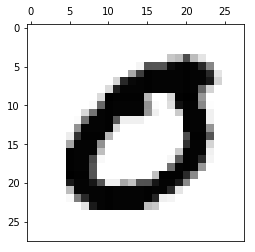

this is number
0
accuracy
0.948856321673


image


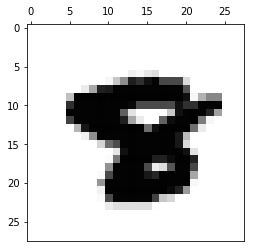

image


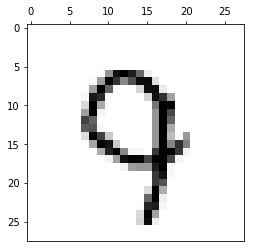

this is number
4
accuracy
0.32290793662


this is number
9
accuracy
0.343140491475


image


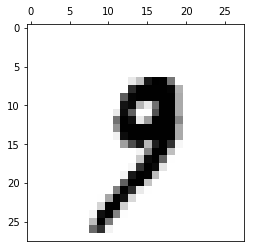

this is number
7
accuracy
0.315497027024


image


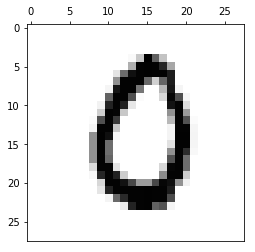

this is number
0
accuracy
0.446739022726


image


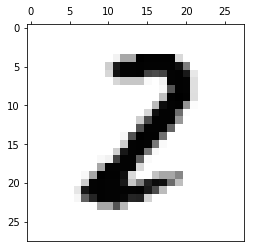

this is number
2
accuracy
0.391429429438


image


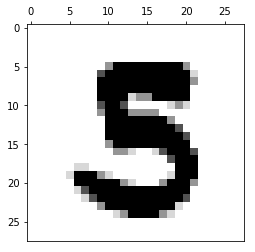

image


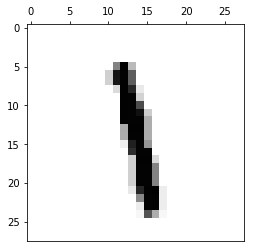

this is number
1
accuracy
0.436240768101


image


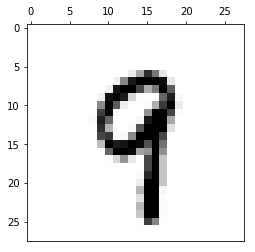

this is number
9
accuracy
0.488555368819


image


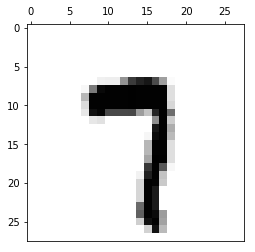

this is number
7
accuracy
0.699608260919


this is number
9
accuracy
0.369816182859


image


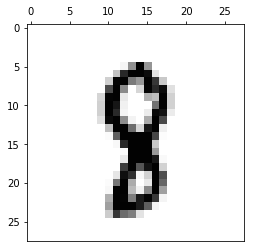

image


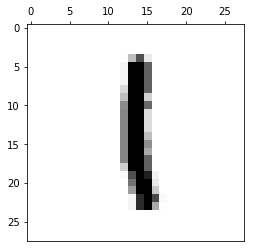

this is number
1
accuracy
0.668598163633


image


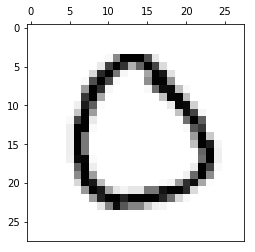

this is number
2
accuracy
0.372753965593


this is number
3
accuracy
0.308249557267


this is number
0
accuracy
0.766130582814


image


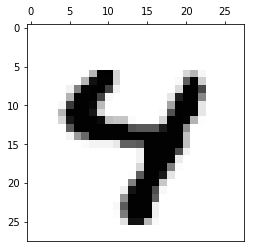

this is number
4
accuracy
0.387840915725


image


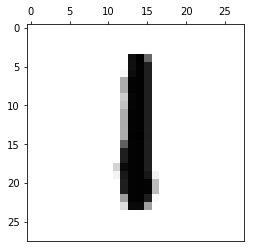

this is number
1
accuracy
0.730140277552


image


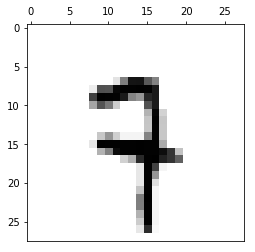

this is number
9
accuracy
0.361666845367


image


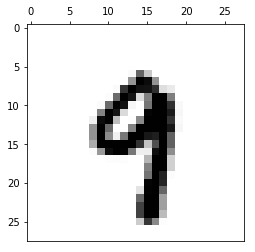

this is number
9
accuracy
0.412568320861


image


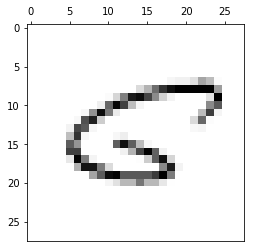

this is number
0
accuracy
0.309272699212


image


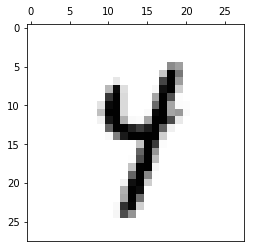

image


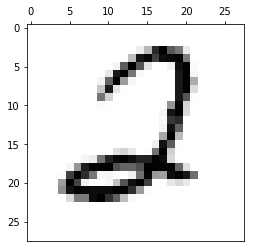

this is number
2
accuracy
0.743929268441


image


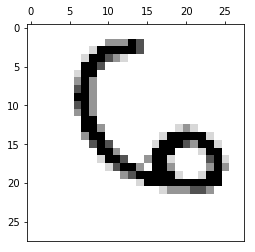

this is number
2
accuracy
0.445326617486


this is number
4
accuracy
0.464574711282


this is number
6
accuracy
0.611637439674


image


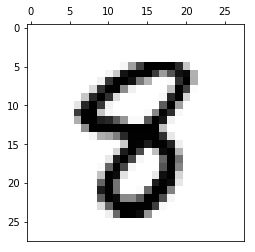

this is number
8
accuracy
0.355827967534


image


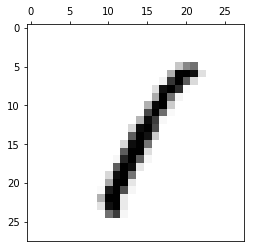

this is number
1
accuracy
0.691099592419


image


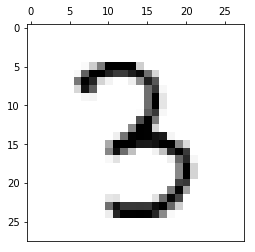

this is number
3
accuracy
0.601237923733


image


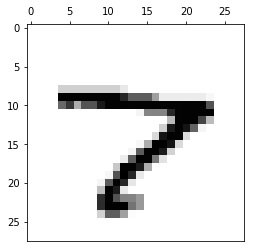

this is number
7
accuracy
0.707633747779


image


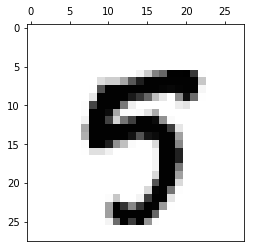

image


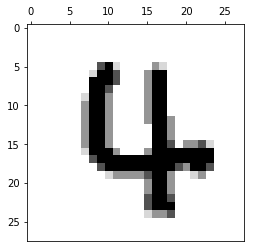

image


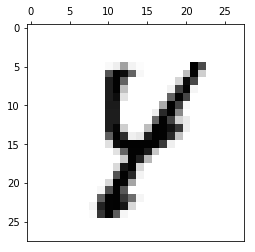

this is number
8
accuracy
0.351168107613


image


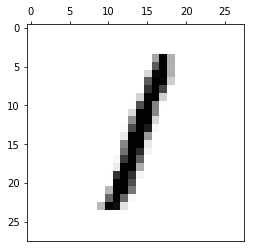

this is number
1
accuracy
0.831753466764


image


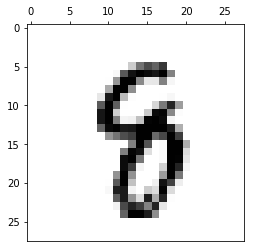

image


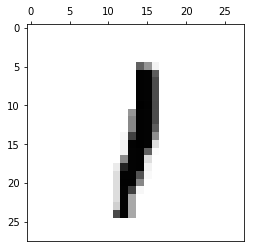

this is number
1
accuracy
0.822807809517


image


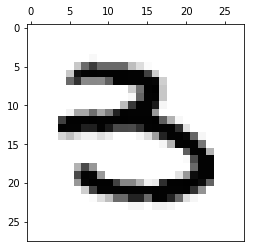

this is number
3
accuracy
0.334275387963


image


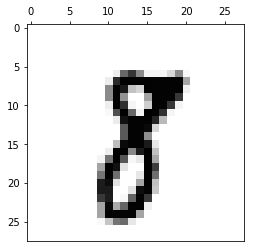

this is number
8
accuracy
0.30815756495


image


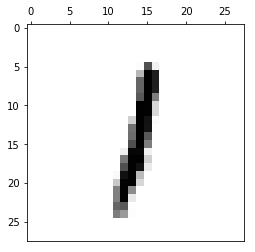

this is number
1
accuracy
0.834051633291


image


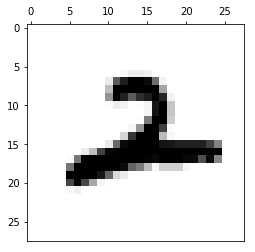

image


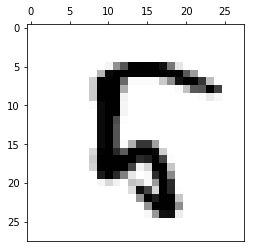

this is number
8
accuracy
0.353451263027


image


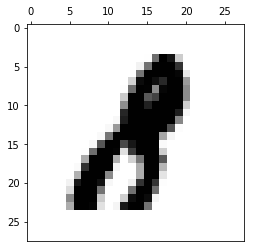

image


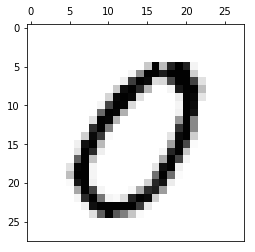

this is number
5
accuracy
0.323839895979


this is number
0
accuracy
0.796955762693


image


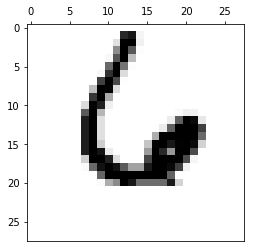

this is number
4
accuracy
0.325027624059


this is number
6
accuracy
0.735141582686


image


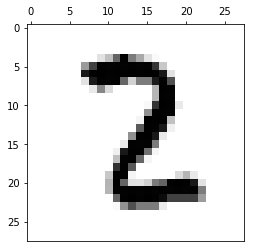

this is number
2
accuracy
0.313493861336


image


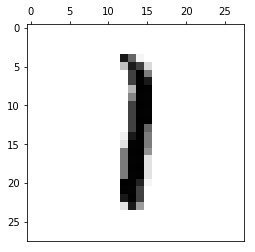

this is number
1
accuracy
0.813954068445


image


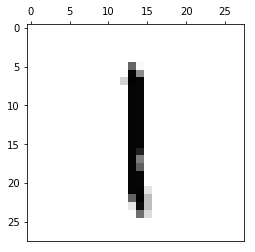

this is number
1
accuracy
0.718261417956


image


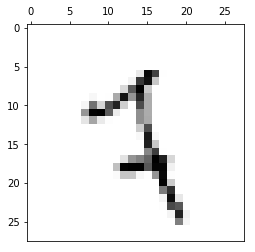

this is number
9
accuracy
0.348911951129


image


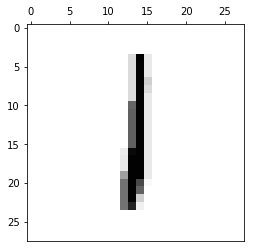

this is number
1
accuracy
0.760076429479


image


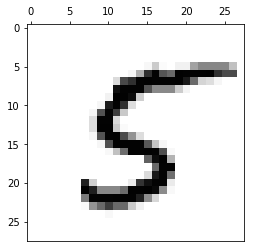

this is number
5
accuracy
0.428645419818


image


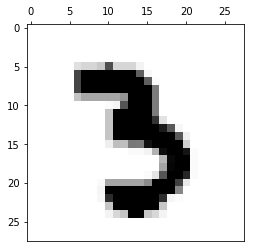

this is number
3
accuracy
0.479548642346


image


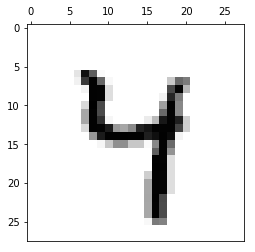

this is number
4
accuracy
0.516686042


this is number
9
accuracy
0.407450539322


image


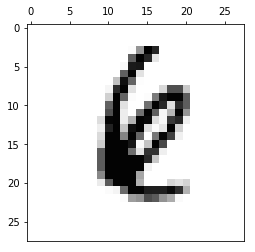

image


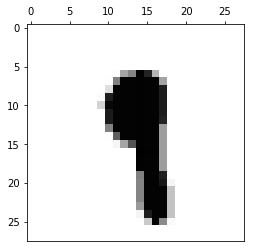

image


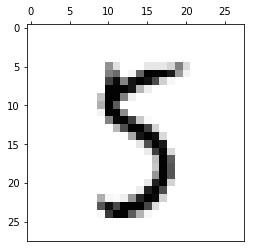

this is number
5
accuracy
0.367533982427


this is number
8
accuracy
0.389818493572


image


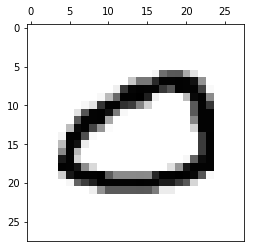

this is number
0
accuracy
0.850754224097


image


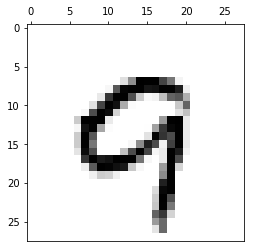

this is number
9
accuracy
0.398345015701


image


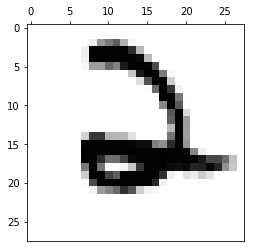

this is number
2
accuracy
0.655676607902


this is number
6
accuracy
0.349966300062


image


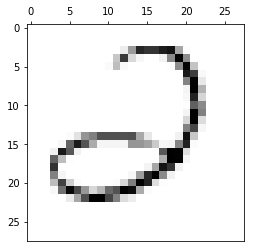

this is number
6
accuracy
0.39319268867


this is number
0
accuracy
0.411149066055


image


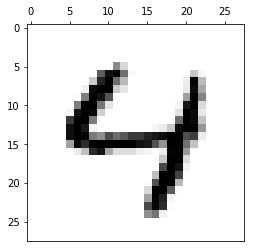

this is number
4
accuracy
0.515179982318


image


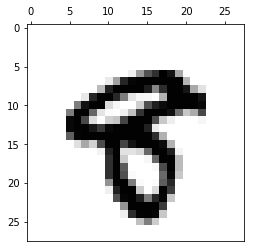

image


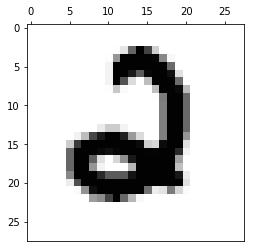

this is number
2
accuracy
0.565540462117


image


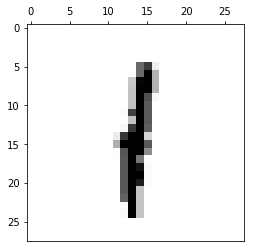

this is number
1
accuracy
0.79159884266


image


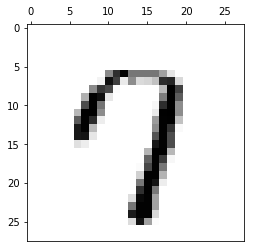

this is number
7
accuracy
0.482885852899


this is number
9
accuracy
0.351867170913


image


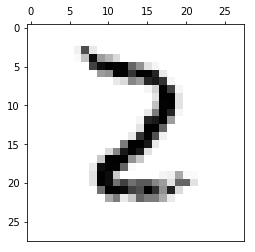

this is number
2
accuracy
0.405868075009


image


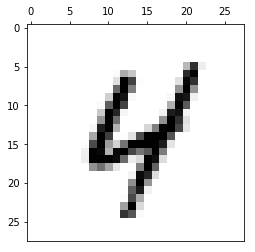

this is number
4
accuracy
0.545748515773


this is number
9
accuracy
0.33162189877


image


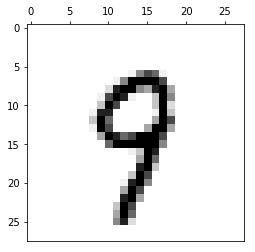

this is number
9
accuracy
0.480932895046


image


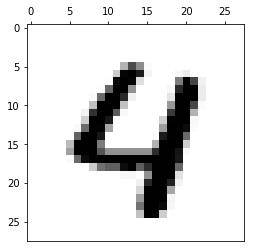

this is number
4
accuracy
0.392674739452


image


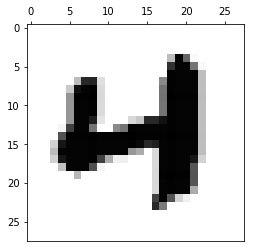

this is number
4
accuracy
0.527077398106


image


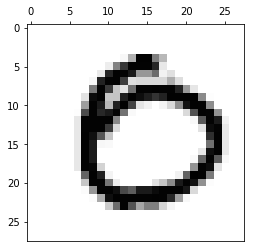

this is number
0
accuracy
0.780691699424


image


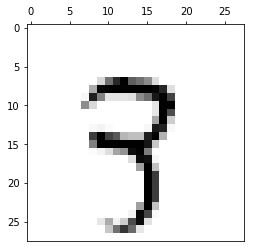

this is number
9
accuracy
0.379526927035


image


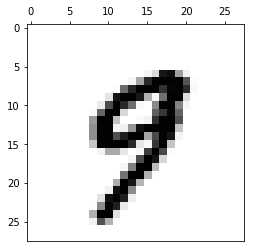

this is number
9
accuracy
0.309140059927


image


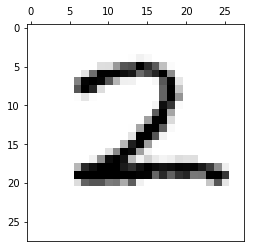

this is number
2
accuracy
0.783344090268


image


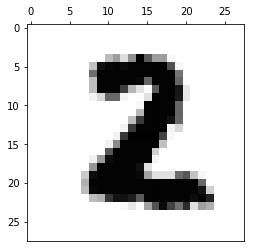

this is number
2
accuracy
0.335842598753


image


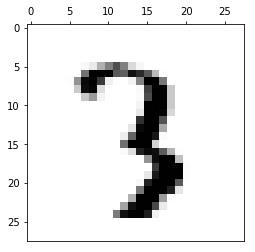

this is number
3
accuracy
0.499756907549


image


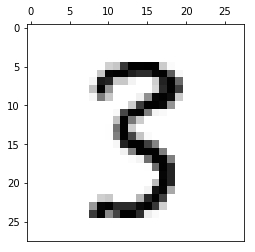

this is number
3
accuracy
0.509154475064


image


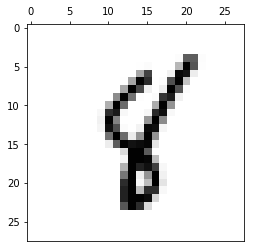

image


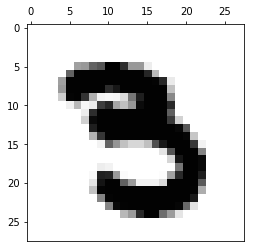

image


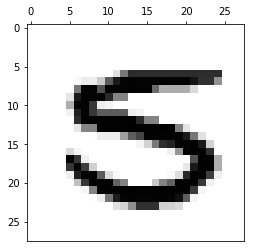

this is number
5
accuracy
0.338040545689


image


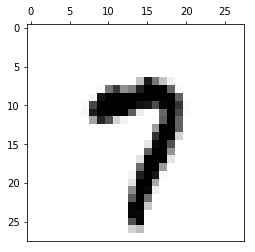

this is number
7
accuracy
0.74953580472


this is number
9
accuracy
0.348774540692


image


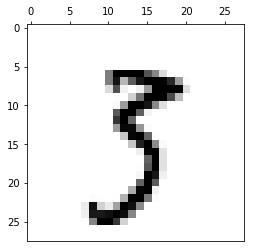

image


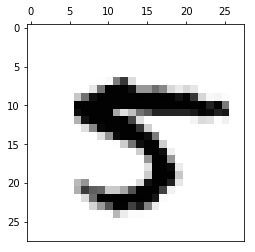

image


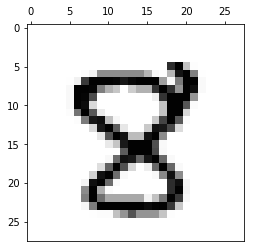

this is number
8
accuracy
0.368795218047


image


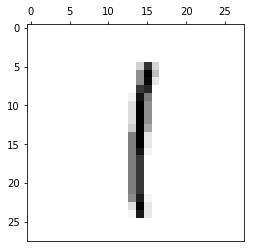

this is number
1
accuracy
0.755982797331


image


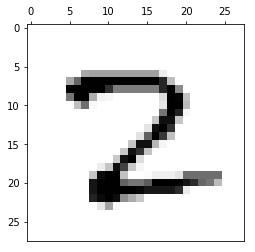

this is number
2
accuracy
0.374422877999


image


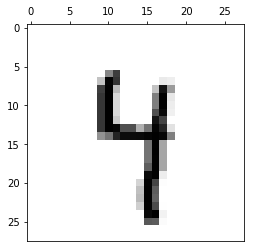

this is number
4
accuracy
0.3504964547


this is number
9
accuracy
0.364419588546


image


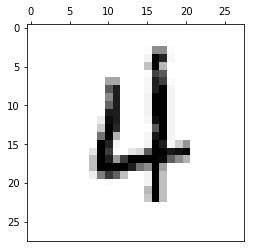

image


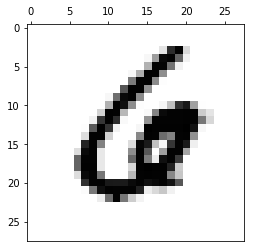

image


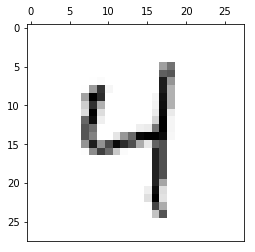

this is number
4
accuracy
0.54619916929


this is number
9
accuracy
0.450155895236


image


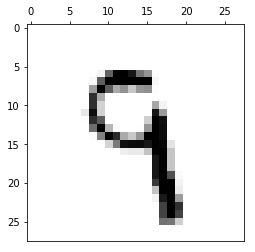

this is number
9
accuracy
0.425564159674


image


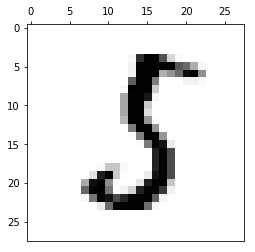

this is number
3
accuracy
0.307436938736


image


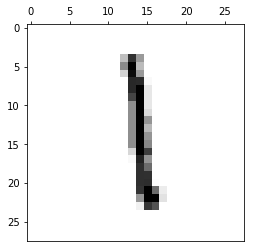

this is number
1
accuracy
0.632073151401


image


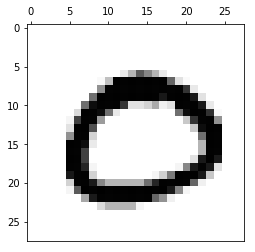

this is number
0
accuracy
0.887179862667


image


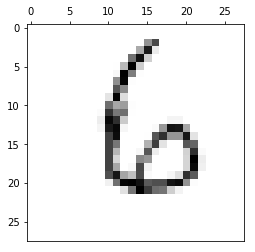

this is number
6
accuracy
0.741041183566


image


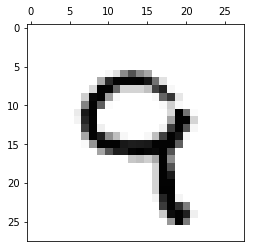

this is number
4
accuracy
0.389774619346


this is number
9
accuracy
0.473570954292


image


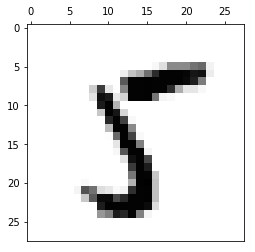

this is number
5
accuracy
0.328097372015


image


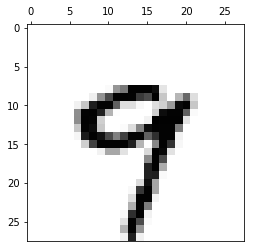

this is number
4
accuracy
0.350978129497


this is number
9
accuracy
0.569793583235


image


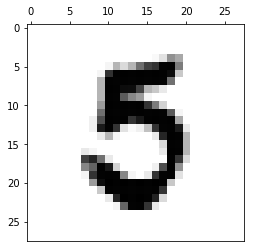

image


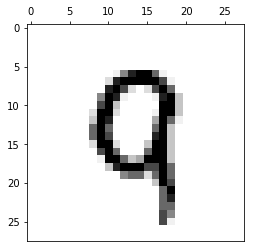

this is number
9
accuracy
0.486181717095


image


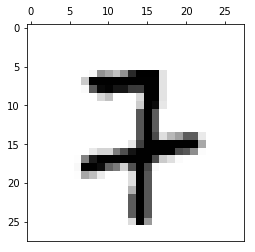

image


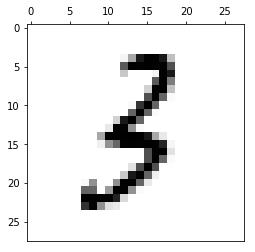

image


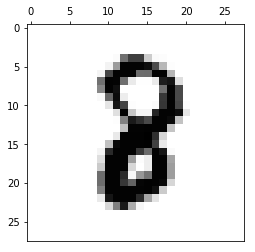

image


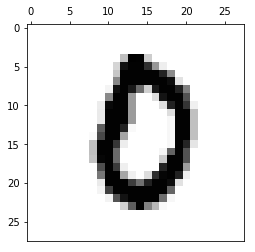

this is number
0
accuracy
0.301812313175


image


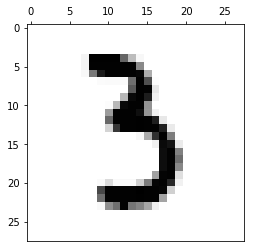

this is number
3
accuracy
0.631331357747


image


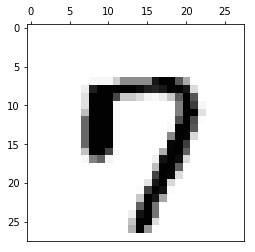

this is number
9
accuracy
0.352002887541


this is number
0
accuracy
0.503138184746


image


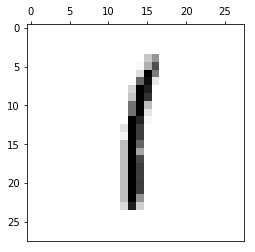

this is number
1
accuracy
0.755988876821


image


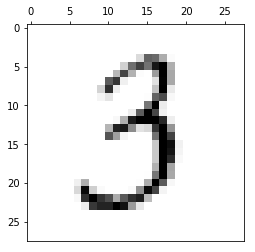

this is number
3
accuracy
0.697254967897


image


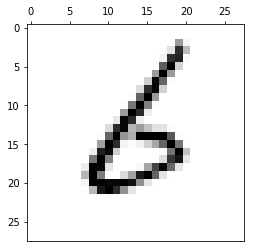

this is number
6
accuracy
0.454378004486


image


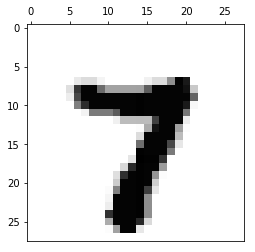

this is number
7
accuracy
0.789780146675


image


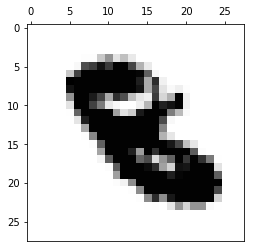

image


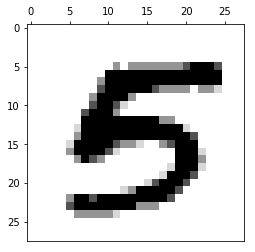

image


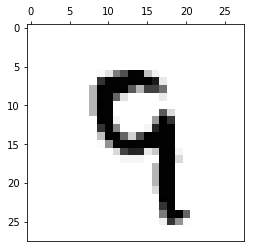

this is number
9
accuracy
0.482153396391


image


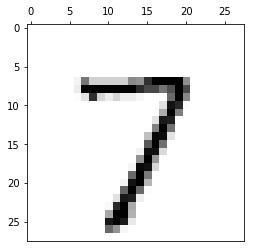

this is number
7
accuracy
0.716637603761


this is number
9
accuracy
0.335094429879


image


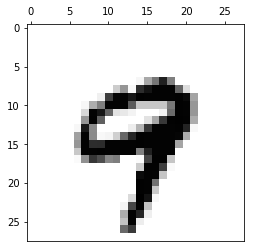

this is number
4
accuracy
0.304171190293


this is number
9
accuracy
0.365908707704


image


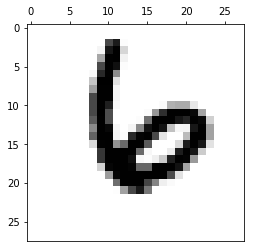

this is number
6
accuracy
0.5567539384


image


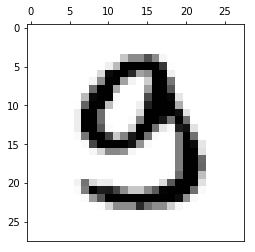

image


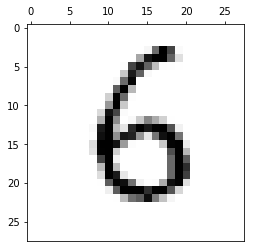

this is number
6
accuracy
0.685782877755


image


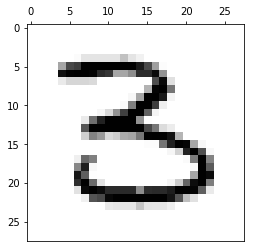

this is number
3
accuracy
0.587045106577


image


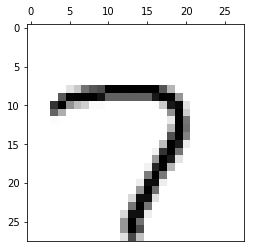

this is number
7
accuracy
0.793610737756


image


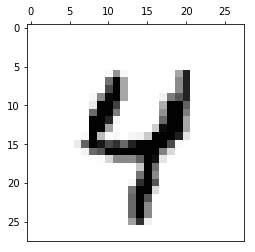

this is number
4
accuracy
0.632957181598


this is number
9
accuracy
0.379199307037


image


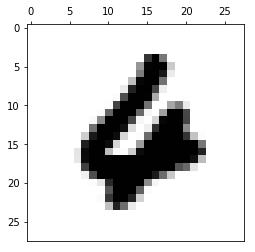

this is number
6
accuracy
0.36560972143


image


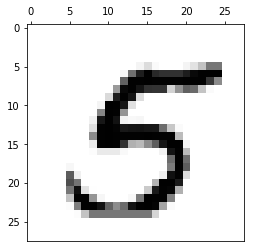

this is number
5
accuracy
0.538614327824


image


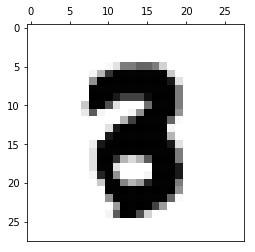

image


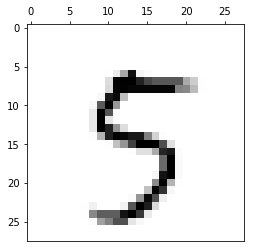

this is number
5
accuracy
0.342399055856


this is number
9
accuracy
0.400741595589


image


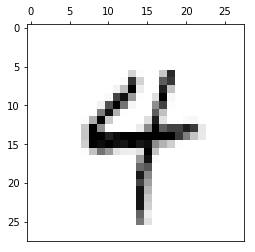

this is number
4
accuracy
0.470161747789


this is number
9
accuracy
0.473410491692


image


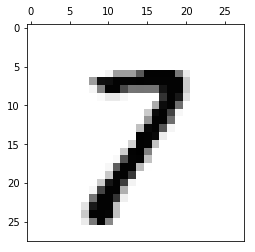

image


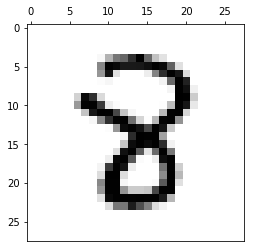

this is number
8
accuracy
0.412792783663


image


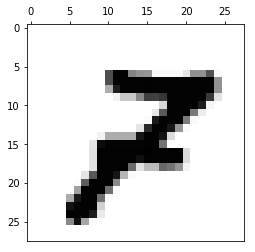

image


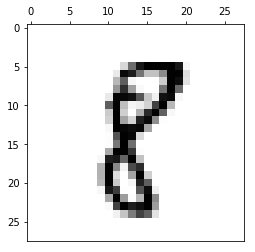

this is number
8
accuracy
0.437302544056


image


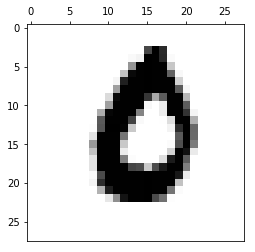

this is number
6
accuracy
0.314344019111


image


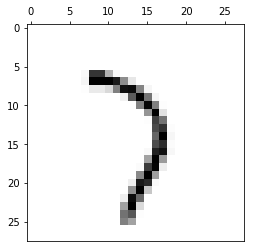

this is number
7
accuracy
0.564451402782


image


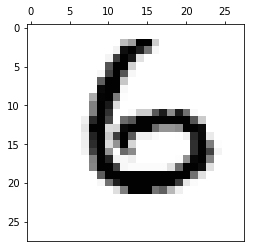

this is number
6
accuracy
0.68578610789


image


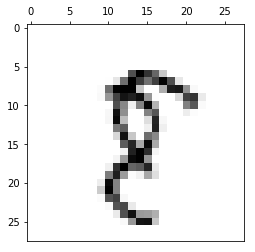

this is number
8
accuracy
0.349627023371


image


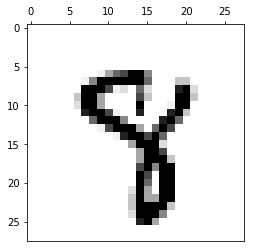

image


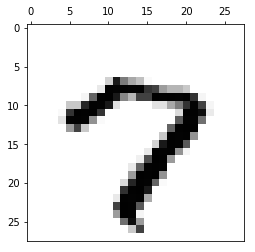

this is number
7
accuracy
0.757088577192


image


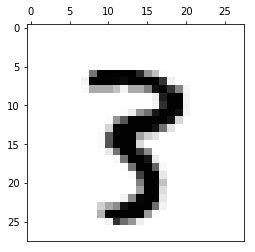

image


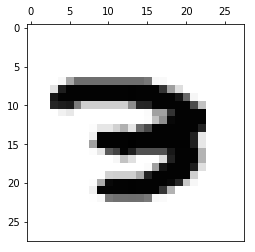

image


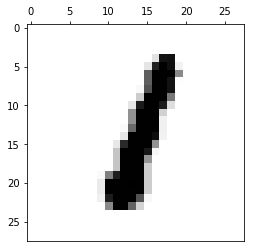

this is number
1
accuracy
0.730009476667


image


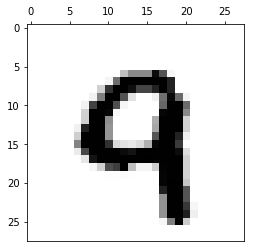

this is number
4
accuracy
0.312075365605


this is number
9
accuracy
0.458271804666


image


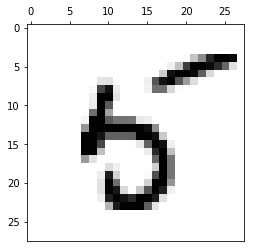

this is number
5
accuracy
0.425484542802


image


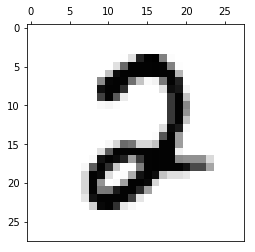

this is number
2
accuracy
0.475158018327


image


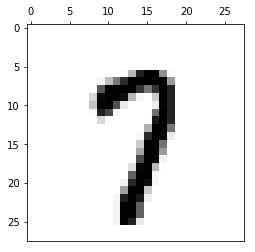

this is number
7
accuracy
0.522420590502


this is number
9
accuracy
0.379402829788


image


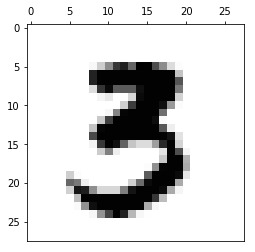

this is number
3
accuracy
0.629863505518


image


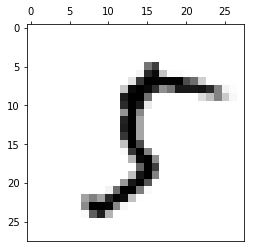

this is number
1
accuracy
0.350147074352


image


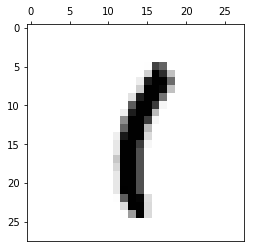

this is number
1
accuracy
0.78562926596


image


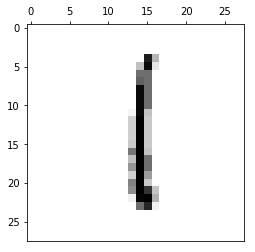

this is number
1
accuracy
0.716486773129


image


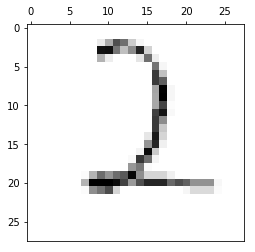

this is number
2
accuracy
0.554030836291


image


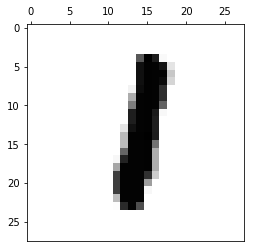

this is number
1
accuracy
0.740603323083


image


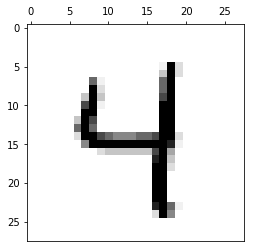

this is number
4
accuracy
0.659774280512


this is number
9
accuracy
0.435117017173


image


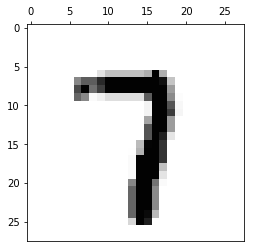

this is number
7
accuracy
0.491619699565


image


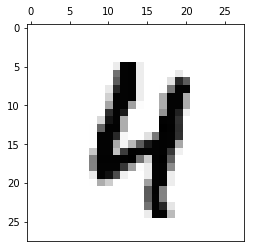

image


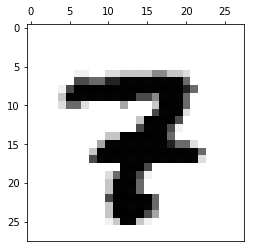

image


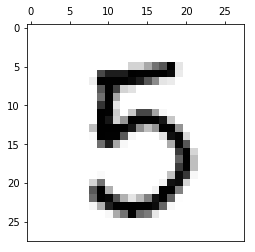

this is number
3
accuracy
0.504668764355


this is number
5
accuracy
0.397404366225


image


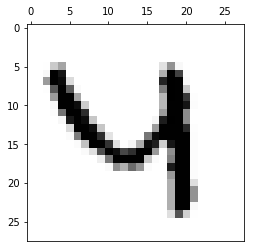

this is number
4
accuracy
0.612271630426


image


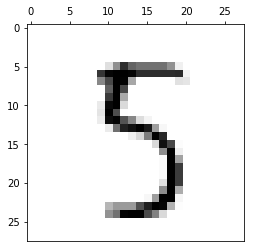

this is number
3
accuracy
0.485806199272


this is number
5
accuracy
0.425992702517


this is number
8
accuracy
0.430285464548


image


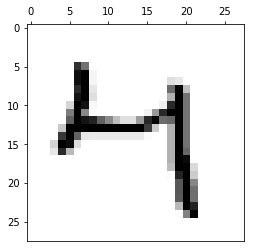

this is number
3
accuracy
0.348994382799


this is number
4
accuracy
0.419218774307


image


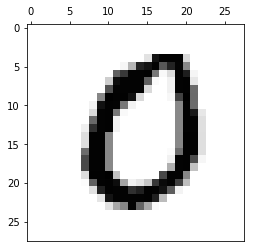

this is number
0
accuracy
0.834333202217


image


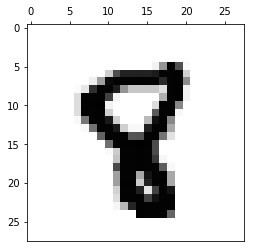

image


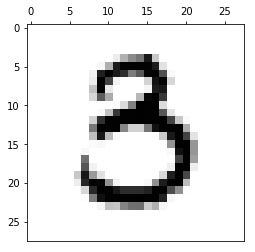

this is number
3
accuracy
0.590042443679


image


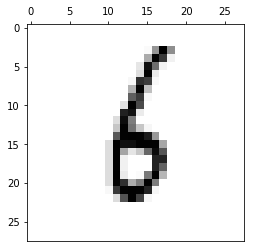

this is number
6
accuracy
0.429256523701


image


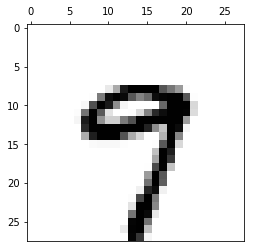

this is number
7
accuracy
0.311321733445


this is number
9
accuracy
0.406739544266


image


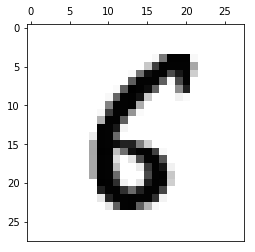

image


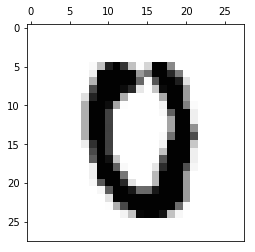

this is number
0
accuracy
0.324163046983


image


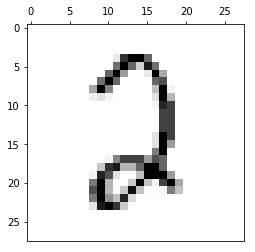

this is number
2
accuracy
0.547980586715


image


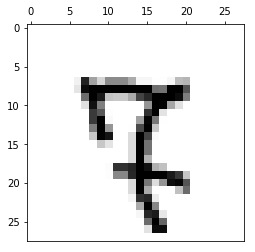

image


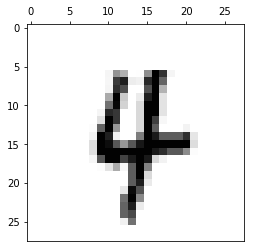

image


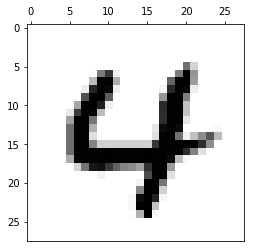

this is number
4
accuracy
0.580322167933


image


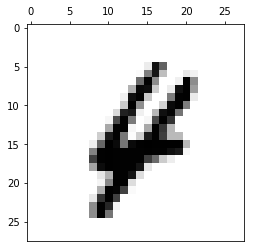

image


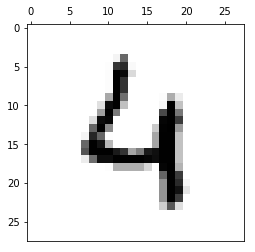

this is number
4
accuracy
0.628063214483


this is number
9
accuracy
0.356201477822


image


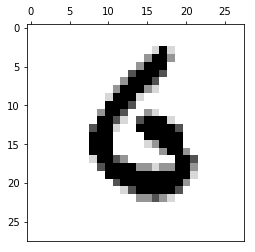

this is number
6
accuracy
0.637192118111


image


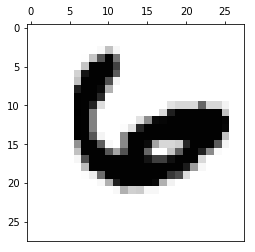

this is number
6
accuracy
0.519759605038


image


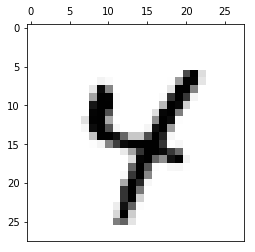

this is number
4
accuracy
0.551598159187


image


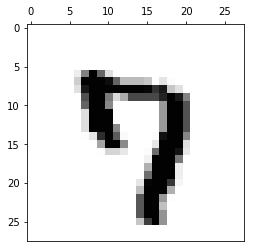

this is number
7
accuracy
0.401503776757


image


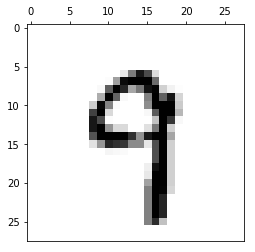

this is number
9
accuracy
0.536562114503


image


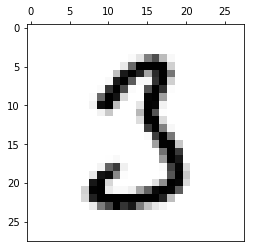

this is number
3
accuracy
0.416041227728


image


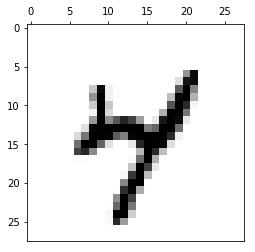

this is number
4
accuracy
0.53603971621


image


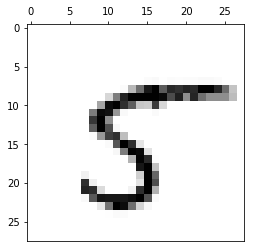

this is number
5
accuracy
0.310719366976


image


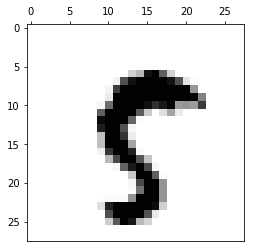

image


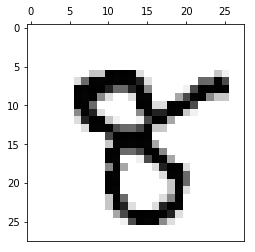

image


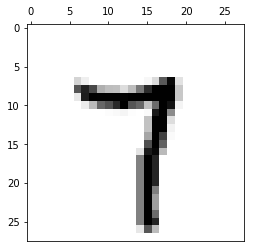

this is number
7
accuracy
0.745523255905


image


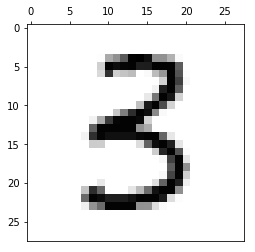

this is number
3
accuracy
0.695627878738


image


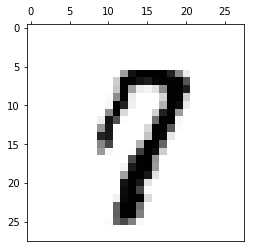

image


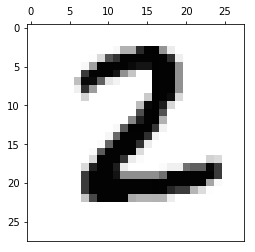

this is number
2
accuracy
0.63322723763


image


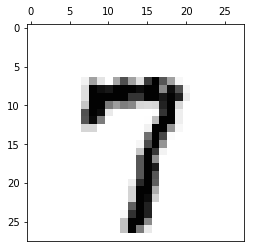

this is number
7
accuracy
0.762474789822


this is number
9
accuracy
0.379754848472


image


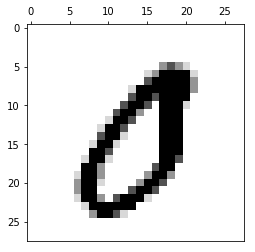

image


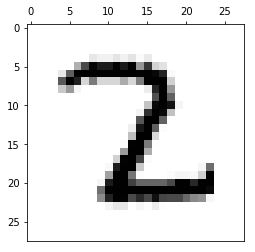

this is number
2
accuracy
0.369117278937


image


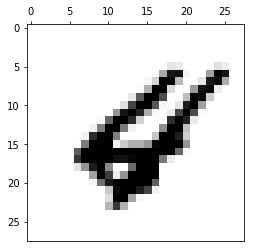

image


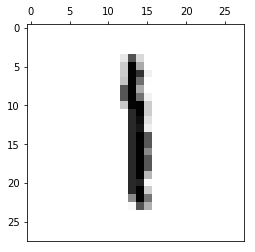

this is number
1
accuracy
0.691456269248


image


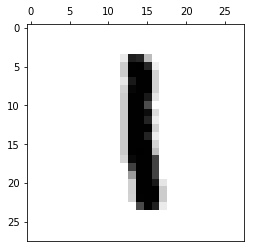

this is number
1
accuracy
0.610942913242


image


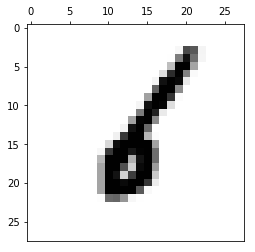

this is number
1
accuracy
0.575870686506


image


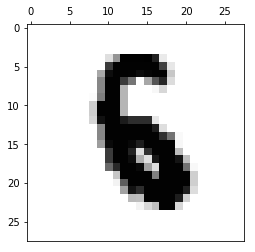

image


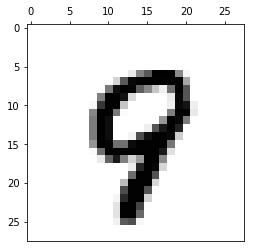

this is number
9
accuracy
0.372203017987


image


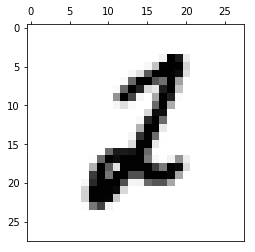

this is number
2
accuracy
0.35304104984


image


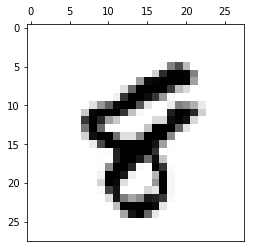

image


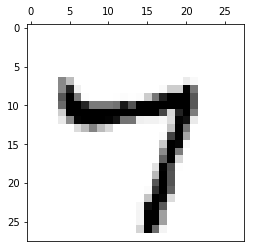

this is number
7
accuracy
0.465268170355


image


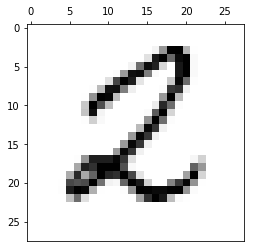

this is number
2
accuracy
0.465345715634


image


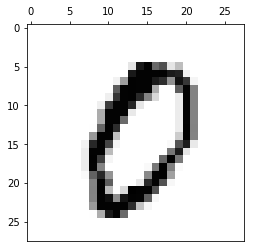

this is number
0
accuracy
0.684064879411


image


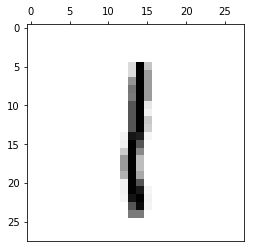

this is number
1
accuracy
0.741173644813


image


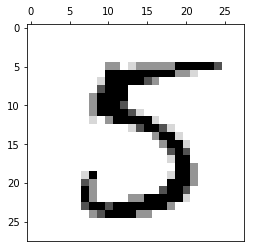

this is number
3
accuracy
0.428562592639


this is number
5
accuracy
0.468347814205


this is number
8
accuracy
0.321444891672


image


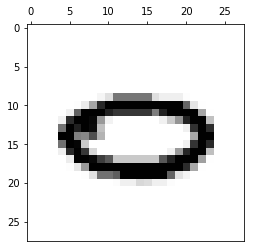

this is number
6
accuracy
0.393867305405


this is number
0
accuracy
0.476693013459


image


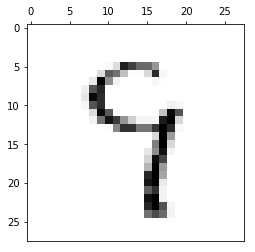

this is number
3
accuracy
0.31032065492


this is number
4
accuracy
0.317464517024


image


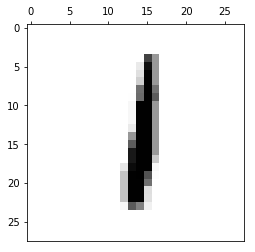

this is number
1
accuracy
0.769661208183


image


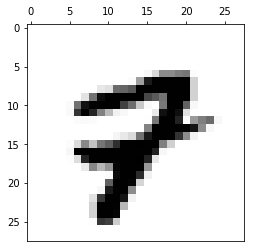

image


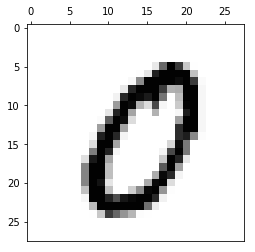

this is number
0
accuracy
0.687823261608


image


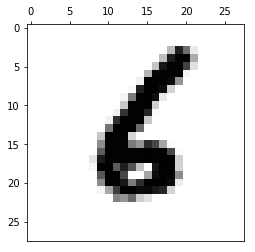

image


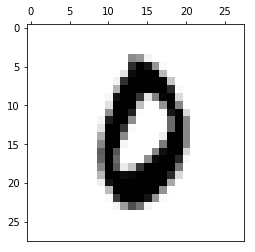

image


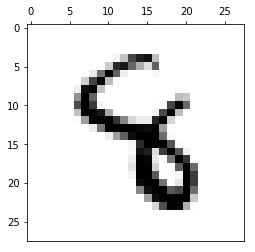

image


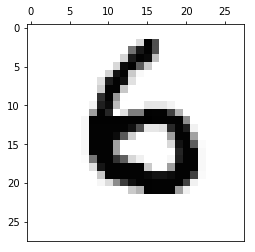

this is number
6
accuracy
0.747773624053


image


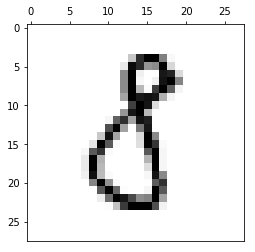

image


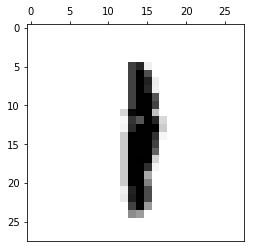

this is number
1
accuracy
0.718814425209


image


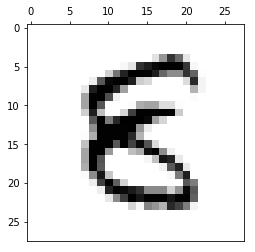

image


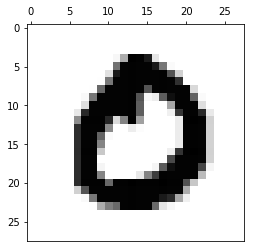

this is number
0
accuracy
0.881047686462


image


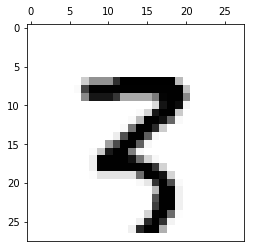

image


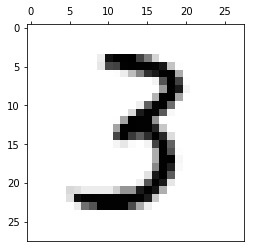

this is number
3
accuracy
0.763925982816


image


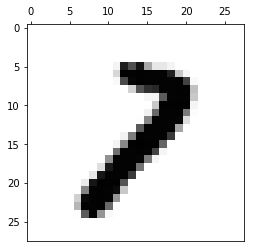

this is number
2
accuracy
0.34486690709


image


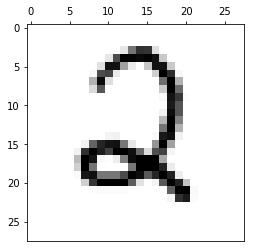

this is number
2
accuracy
0.791355783665


image


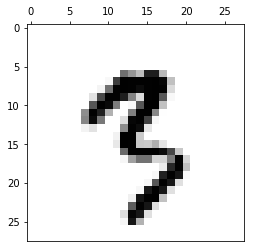

image


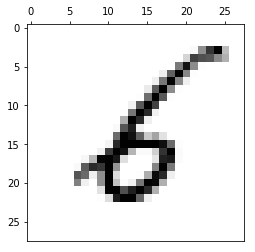

image


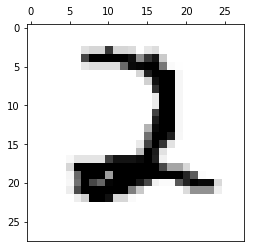

this is number
2
accuracy
0.840802214059


image


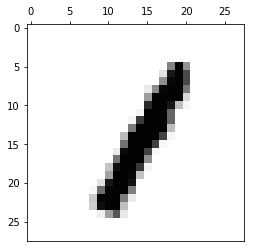

this is number
1
accuracy
0.511887474329


image


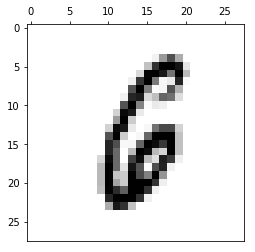

image


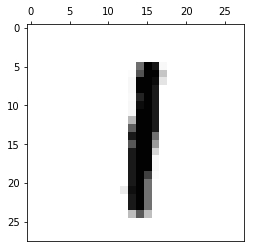

this is number
1
accuracy
0.753962844496


image


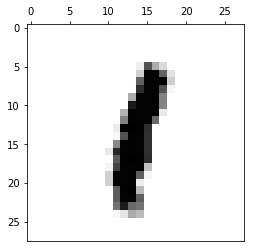

this is number
1
accuracy
0.774562229603


image


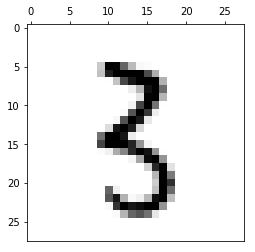

this is number
3
accuracy
0.397786307465


image


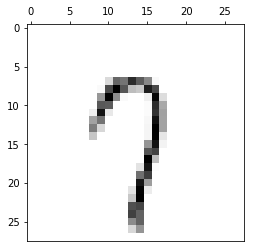

this is number
7
accuracy
0.541745875799


this is number
9
accuracy
0.47127461187


image


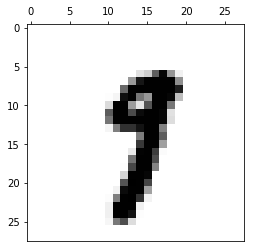

image


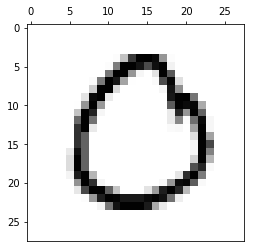

this is number
2
accuracy
0.300375920153


this is number
0
accuracy
0.796295609249


image


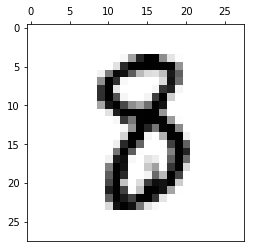

image


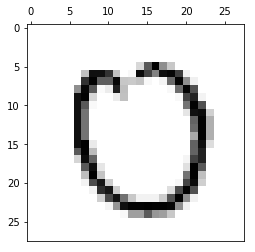

this is number
8
accuracy
0.342021166443


this is number
0
accuracy
0.798908287442


image


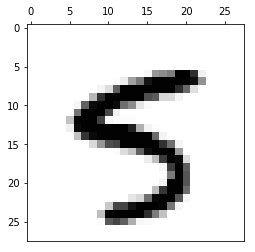

this is number
5
accuracy
0.318601689802


image


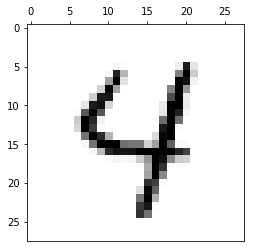

this is number
4
accuracy
0.660353285316


this is number
9
accuracy
0.331230001511


image


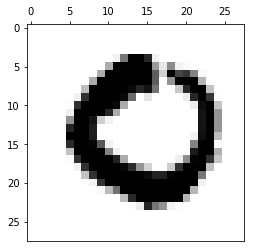

this is number
0
accuracy
0.598209060067


image


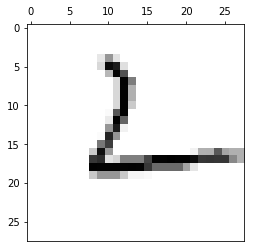

this is number
2
accuracy
0.414278851833


this is number
6
accuracy
0.664473885861


image


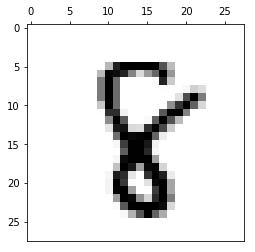

this is number
8
accuracy
0.464200699895


image


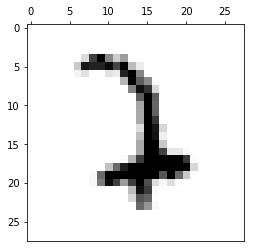

image


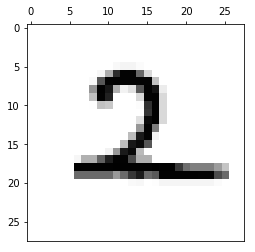

this is number
2
accuracy
0.445802966656


image


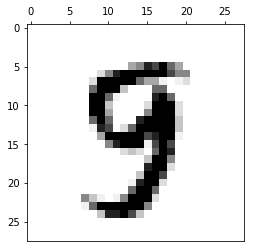

image


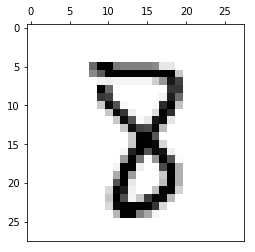

image


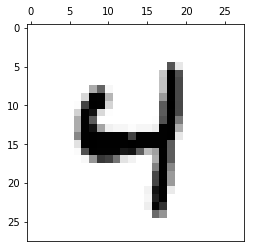

this is number
4
accuracy
0.737510524926


this is number
9
accuracy
0.401184811572


image


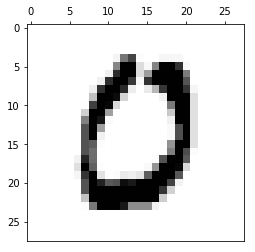

this is number
0
accuracy
0.680706102219


image


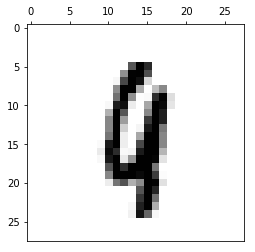

image


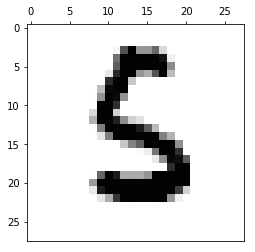

this is number
6
accuracy
0.336167994582


image


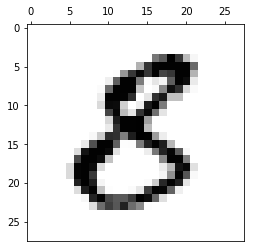

image


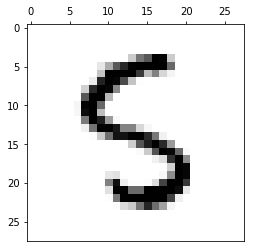

this is number
3
accuracy
0.310486798791


image


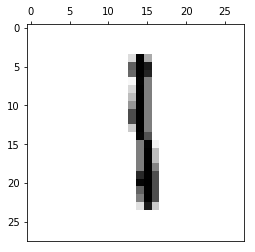

this is number
1
accuracy
0.57045915908


image


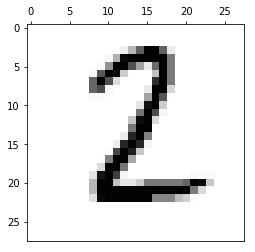

this is number
1
accuracy
0.330730962138


this is number
2
accuracy
0.387846071464


image


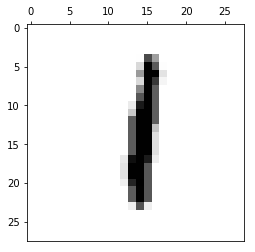

this is number
1
accuracy
0.799221752693


image


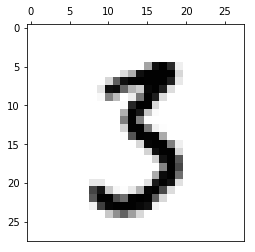

this is number
3
accuracy
0.466461713094


image


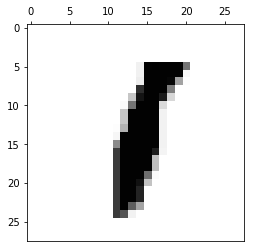

this is number
1
accuracy
0.655497119291


image


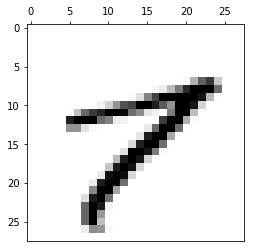

image


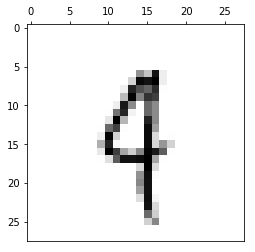

this is number
9
accuracy
0.301542385445


image


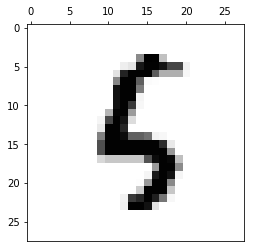

image


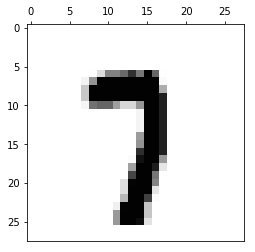

this is number
7
accuracy
0.496713071673


image


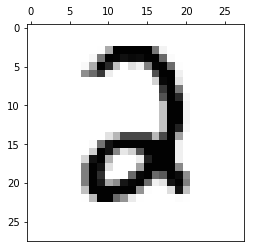

this is number
2
accuracy
0.651521872565


image


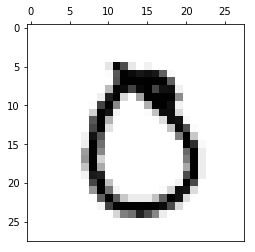

this is number
0
accuracy
0.471847953104


image


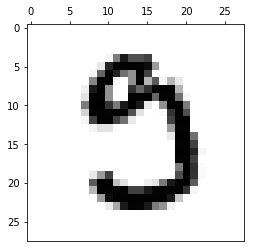

this is number
0
accuracy
0.356073263602


image


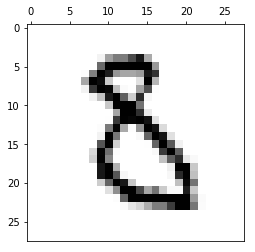

image


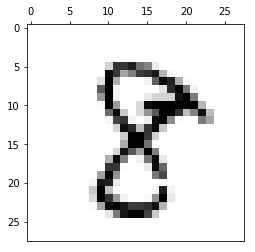

this is number
8
accuracy
0.572759749109


image


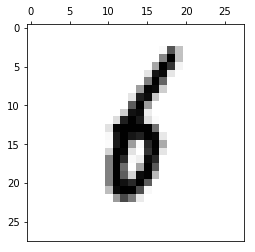

this is number
1
accuracy
0.371241823362


image


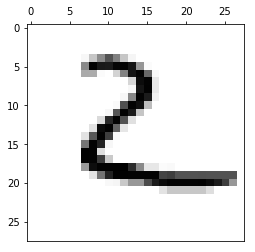

this is number
2
accuracy
0.370395728877


this is number
6
accuracy
0.608253541719


image


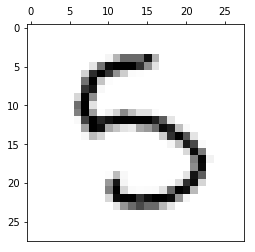

this is number
3
accuracy
0.462993740934


image


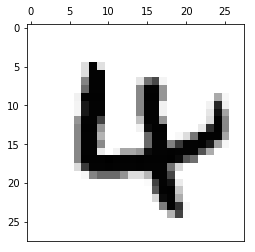

image


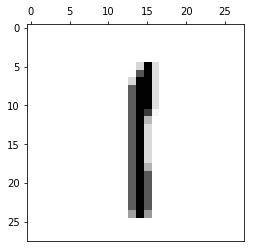

this is number
1
accuracy
0.745046128814


image


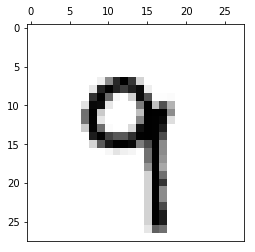

this is number
9
accuracy
0.428036900336


image


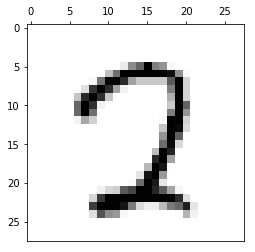

this is number
3
accuracy
0.321170960975


image


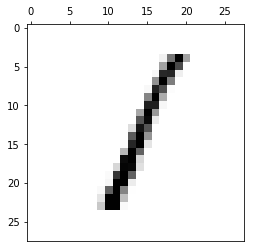

this is number
1
accuracy
0.795069611195


image


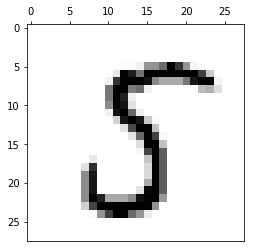

this is number
5
accuracy
0.433063900091


this is number
8
accuracy
0.444843564409


image


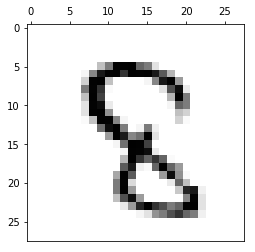

image


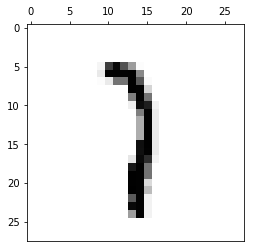

this is number
1
accuracy
0.553548566209


image


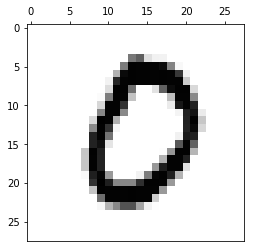

this is number
0
accuracy
0.791775851716


image


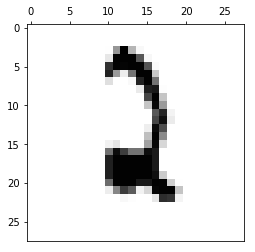

this is number
2
accuracy
0.539182760196


image


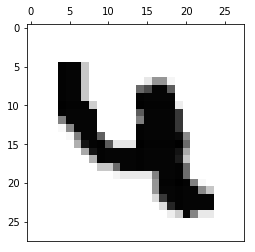

image


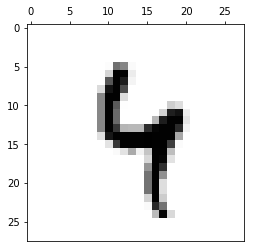

this is number
4
accuracy
0.453983276172


this is number
9
accuracy
0.435593450031


image


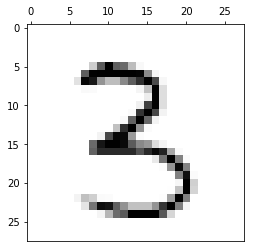

this is number
3
accuracy
0.535908352487


image


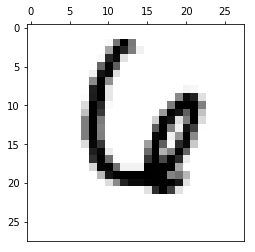

this is number
4
accuracy
0.333332352612


this is number
6
accuracy
0.443611402695


image


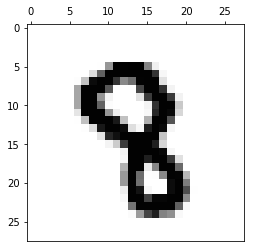

image


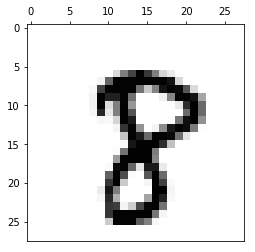

image


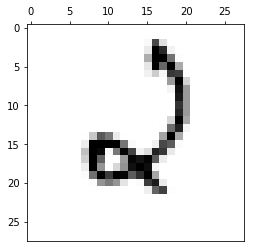

this is number
2
accuracy
0.534370892997


this is number
4
accuracy
0.39168574264


this is number
6
accuracy
0.431266904981


image


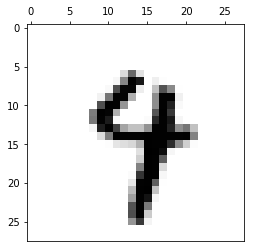

this is number
9
accuracy
0.402568429883


image


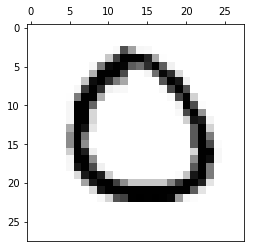

this is number
2
accuracy
0.530404286857


this is number
0
accuracy
0.798462107009


image


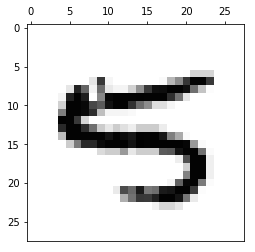

image


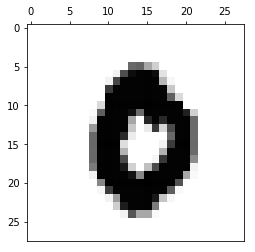

image


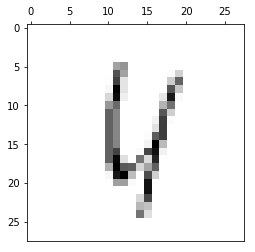

this is number
4
accuracy
0.388872008095


this is number
8
accuracy
0.304811432366


image


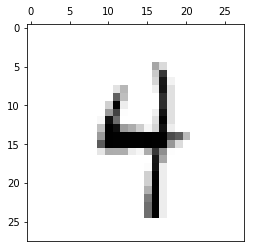

this is number
4
accuracy
0.514076277182


this is number
9
accuracy
0.42836996493


image


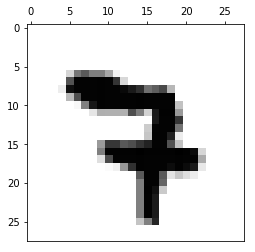

this is number
7
accuracy
0.349363659997


image


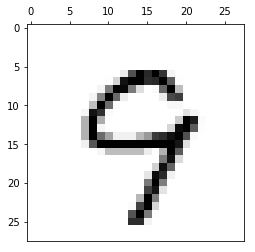

this is number
9
accuracy
0.432209433636


image


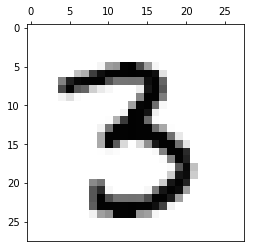

this is number
3
accuracy
0.810524227805


image


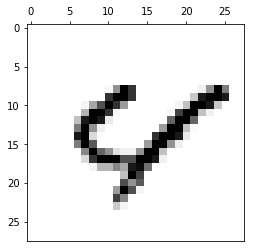

this is number
4
accuracy
0.485705337238


this is number
7
accuracy
0.325965417855


this is number
9
accuracy
0.35381324805


image


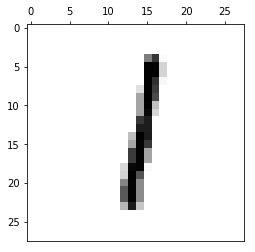

this is number
1
accuracy
0.782643997358


image


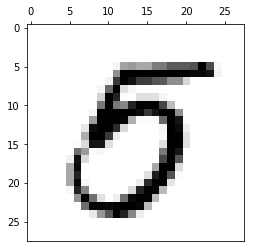

image


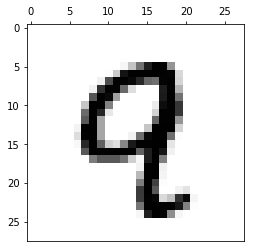

this is number
9
accuracy
0.30132450562


image


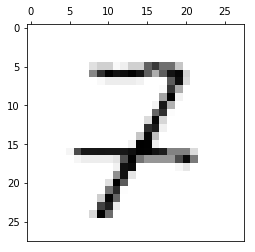

this is number
2
accuracy
0.418126702439


image


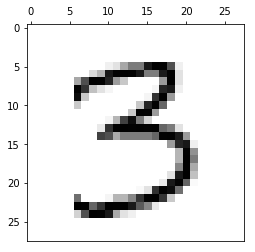

this is number
3
accuracy
0.814966348998


image


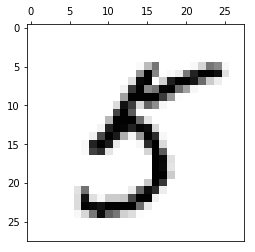

this is number
5
accuracy
0.396784882823


image


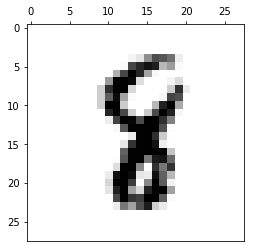

image


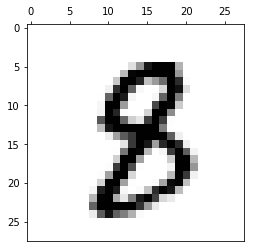

image


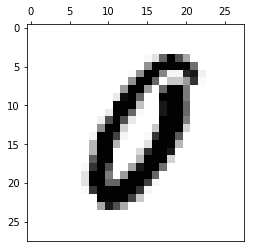

image


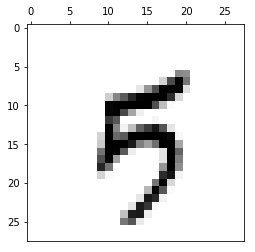

image


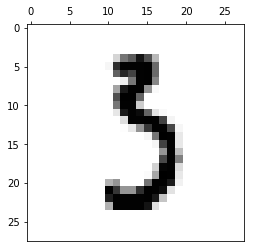

this is number
3
accuracy
0.487540464784


image


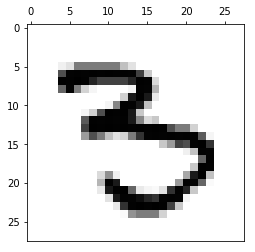

image


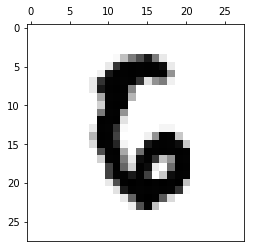

this is number
6
accuracy
0.386168913102


image


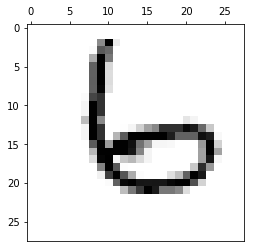

this is number
4
accuracy
0.322504582839


this is number
6
accuracy
0.650988852807


image


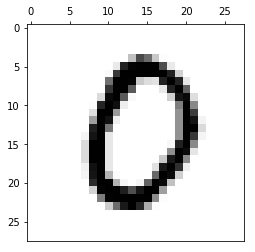

this is number
0
accuracy
0.775706365295


image


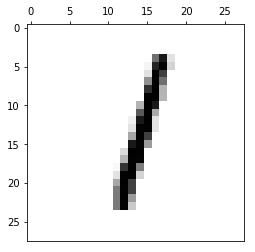

this is number
1
accuracy
0.819972610632


image


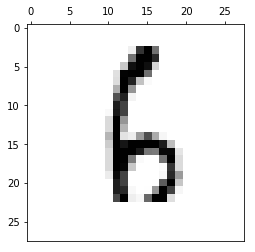

this is number
6
accuracy
0.437865242728


this is number
8
accuracy
0.310440987679


image


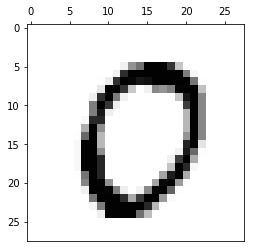

this is number
0
accuracy
0.884860182031


image


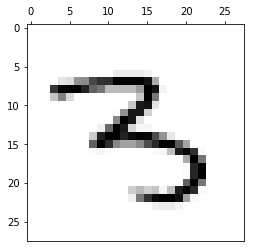

this is number
3
accuracy
0.382596635502


this is number
5
accuracy
0.309297280412


image


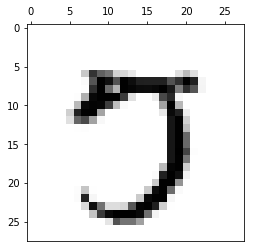

this is number
7
accuracy
0.518946719365


image


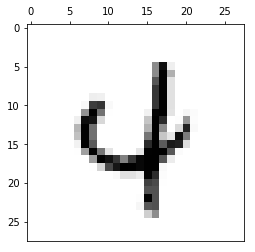

this is number
4
accuracy
0.415859700535


image


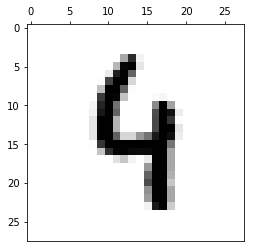

this is number
4
accuracy
0.496102626014


this is number
9
accuracy
0.330645191502


image


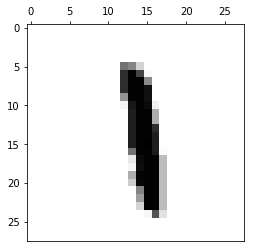

this is number
1
accuracy
0.474166120479


image


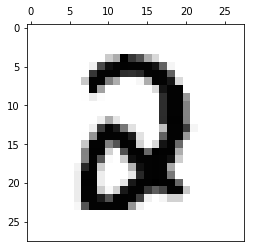

image


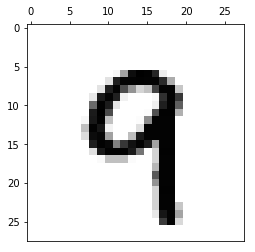

this is number
9
accuracy
0.560404968911


image


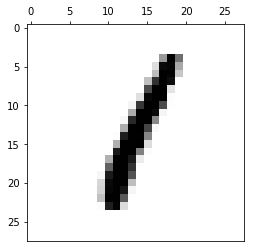

this is number
1
accuracy
0.776560224614


image


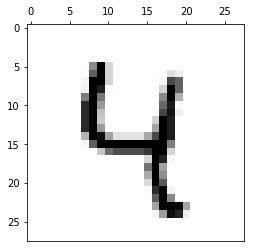

this is number
4
accuracy
0.702439669206


this is number
9
accuracy
0.423398610166


image


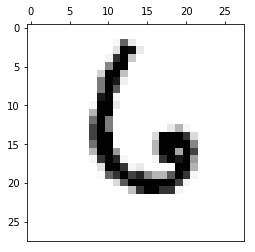

this is number
6
accuracy
0.780972869345


image


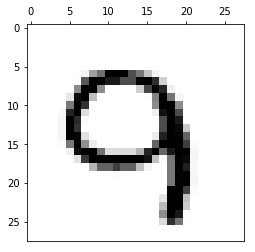

this is number
2
accuracy
0.37337482612


image


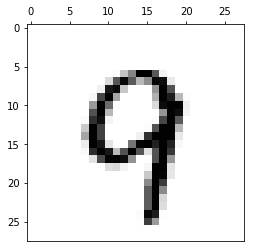

this is number
4
accuracy
0.359352404169


this is number
9
accuracy
0.463411694794


image


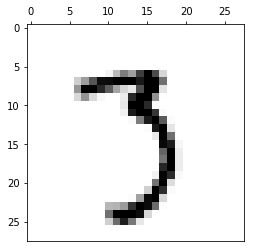

this is number
3
accuracy
0.504807177661


this is number
7
accuracy
0.341183791958


image


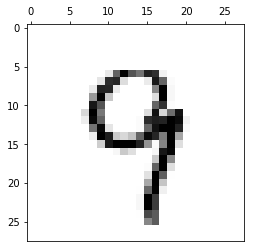

this is number
4
accuracy
0.301494664811


this is number
9
accuracy
0.405632291714


image


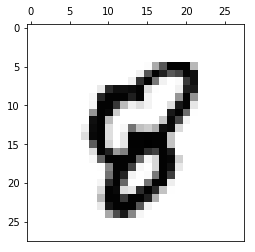

image


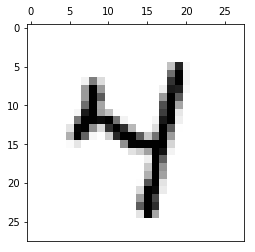

this is number
4
accuracy
0.528040698514


this is number
9
accuracy
0.325118101589


image


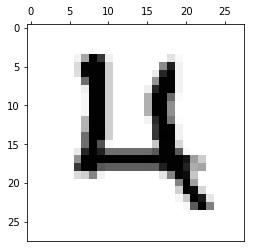

this is number
4
accuracy
0.400106837829


image


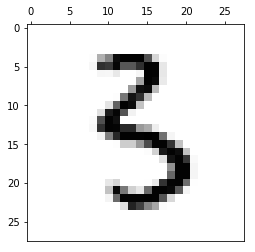

this is number
3
accuracy
0.349645014547


this is number
5
accuracy
0.319560980494


image


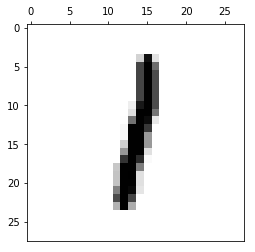

this is number
1
accuracy
0.843569295621


image


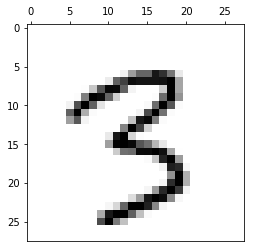

image


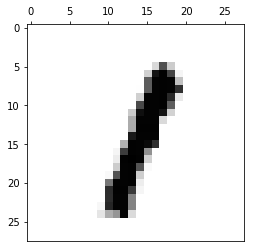

this is number
1
accuracy
0.704060176374


image


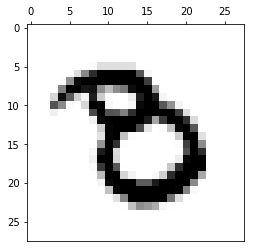

image


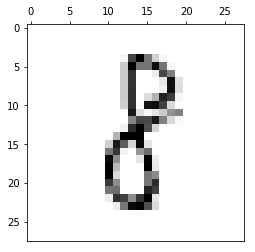

this is number
8
accuracy
0.329601419003


image


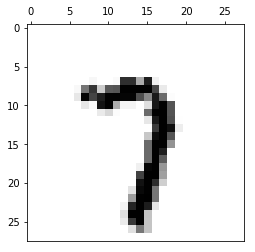

this is number
7
accuracy
0.708574114267


this is number
9
accuracy
0.356458630366


image


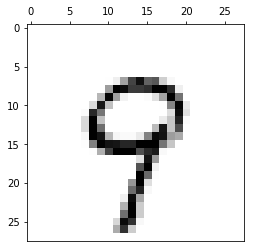

this is number
4
accuracy
0.317359889927


this is number
9
accuracy
0.556547182054


image


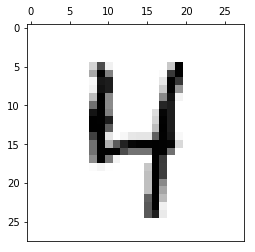

this is number
4
accuracy
0.688705672848


this is number
9
accuracy
0.369214735183


image


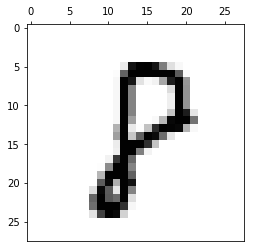

this is number
8
accuracy
0.568834424404


image


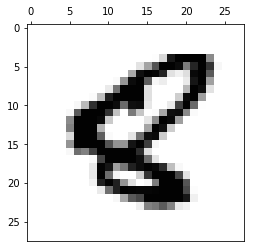

image


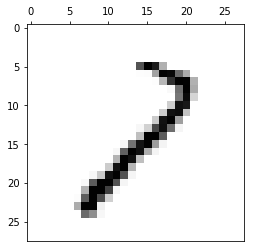

this is number
2
accuracy
0.507271106273


this is number
8
accuracy
0.526045199087


image


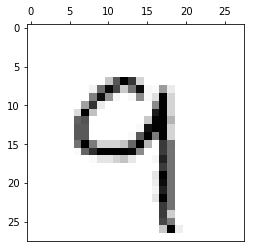

this is number
4
accuracy
0.394033366382


this is number
9
accuracy
0.417119885169


image


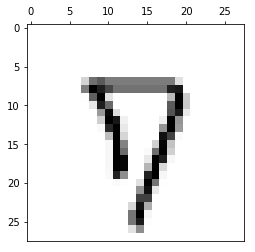

this is number
7
accuracy
0.348190652218


this is number
9
accuracy
0.355536239274


image


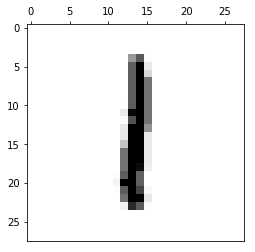

this is number
1
accuracy
0.794875507619


image


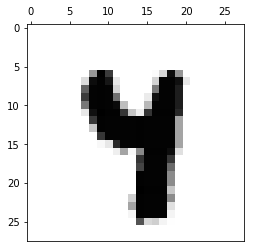

image


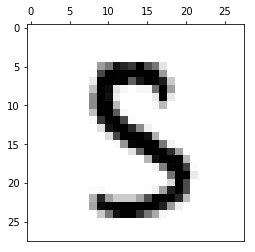

this is number
3
accuracy
0.340391851619


image


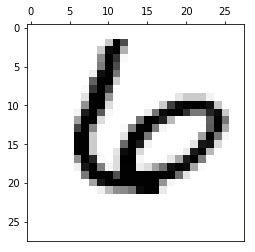

image


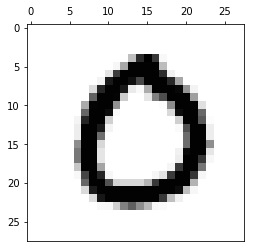

this is number
0
accuracy
0.891780901694


image


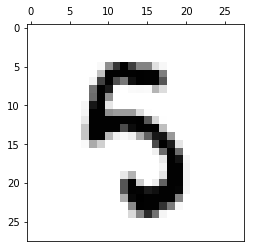

this is number
3
accuracy
0.334966438412


image


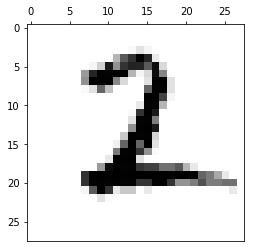

this is number
2
accuracy
0.625011364359


image


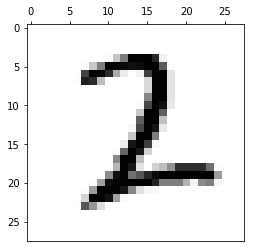

this is number
1
accuracy
0.351052087393


this is number
2
accuracy
0.535429609891


image


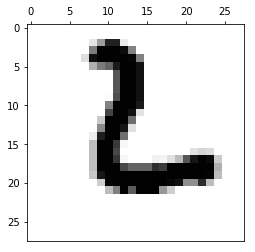

this is number
6
accuracy
0.851860285219


image


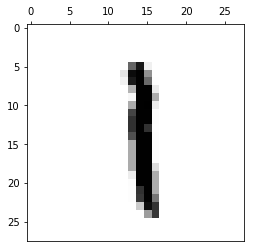

this is number
1
accuracy
0.720556651774


image


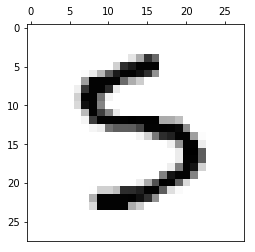

this is number
3
accuracy
0.549892109898


image


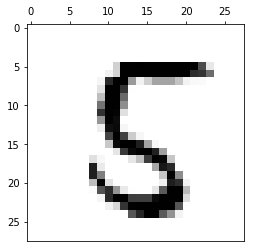

this is number
5
accuracy
0.426021784396


this is number
8
accuracy
0.51376456452


image


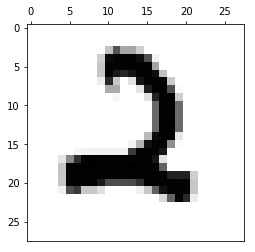

this is number
2
accuracy
0.858102213123


image


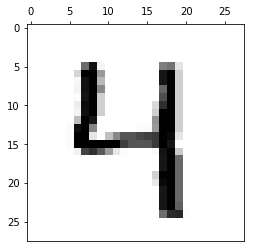

this is number
4
accuracy
0.569332010762


this is number
9
accuracy
0.31973159252


image


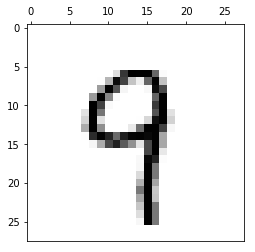

this is number
9
accuracy
0.435991010967


image


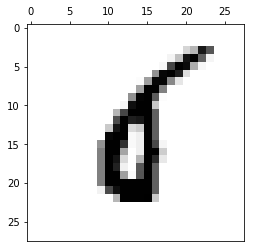

image


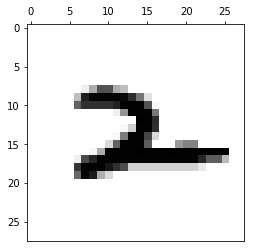

image


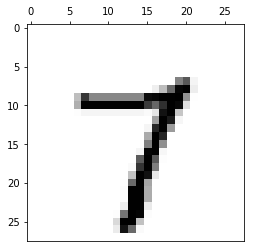

this is number
7
accuracy
0.78380361883


image


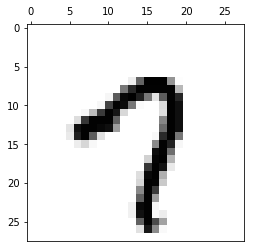

this is number
7
accuracy
0.479428822018


this is number
9
accuracy
0.541354472387


image


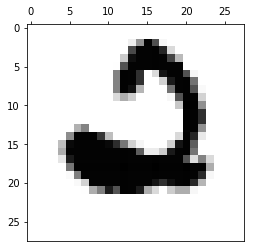

this is number
2
accuracy
0.668759136991


this is number
6
accuracy
0.514275025809


this is number
0
accuracy
0.409105996029


image


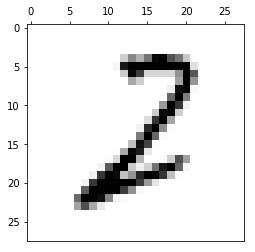

this is number
2
accuracy
0.593216884632


image


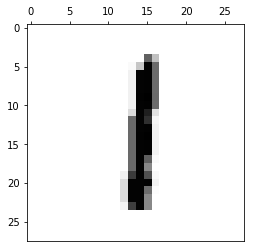

this is number
1
accuracy
0.767333135845


image


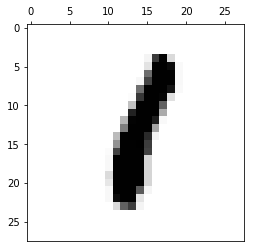

this is number
1
accuracy
0.771731560735


image


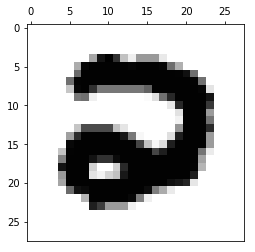

image


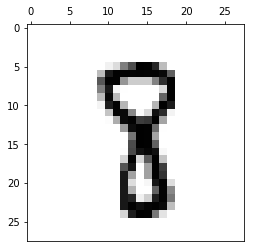

image


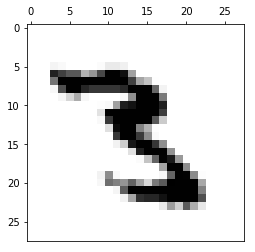

image


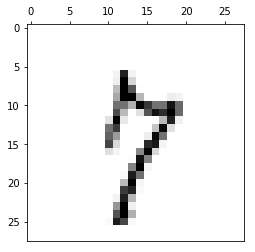

this is number
7
accuracy
0.463026719549


image


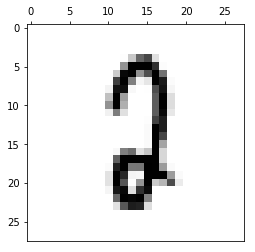

image


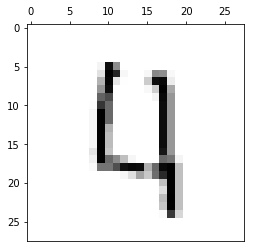

this is number
4
accuracy
0.34864798422


this is number
9
accuracy
0.330865265906


image


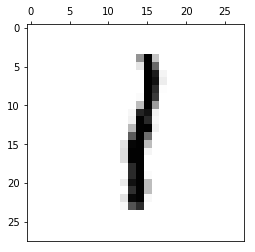

this is number
1
accuracy
0.806574001725


image


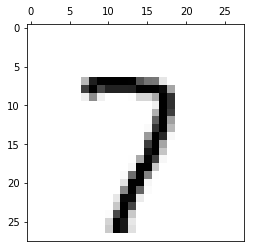

this is number
7
accuracy
0.709781306751


this is number
9
accuracy
0.321963987283


image


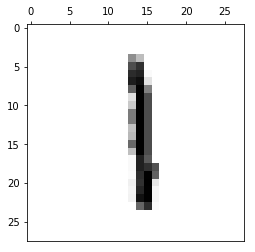

this is number
1
accuracy
0.68049437477


image


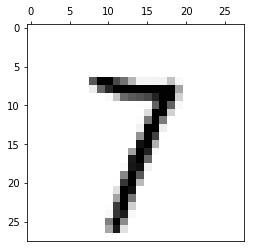

this is number
1
accuracy
0.305392346252


this is number
7
accuracy
0.537277970417


image


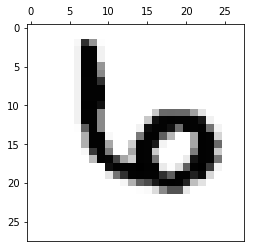

this is number
4
accuracy
0.338603249548


this is number
6
accuracy
0.421138328594


image


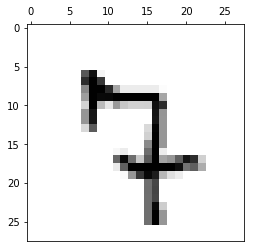

this is number
7
accuracy
0.522701659696


image


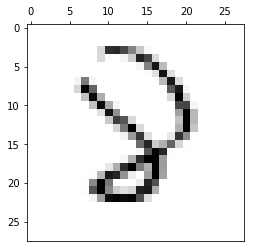

image


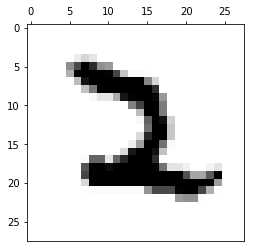

this is number
2
accuracy
0.479889747841


image


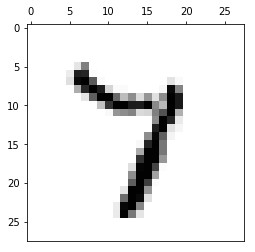

this is number
7
accuracy
0.693748248587


image


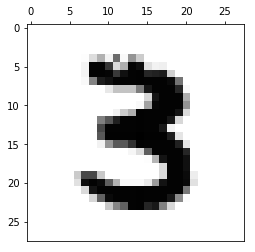

this is number
3
accuracy
0.564355115206


image


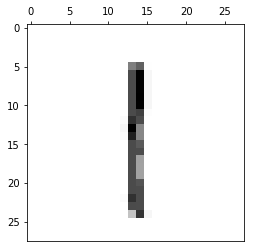

this is number
1
accuracy
0.662434702662


image


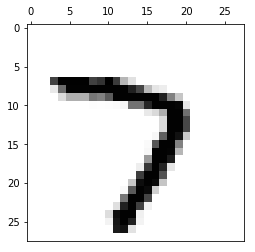

this is number
7
accuracy
0.841490728998


image


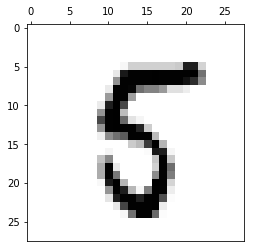

this is number
5
accuracy
0.421711375572


this is number
8
accuracy
0.387052910667


image


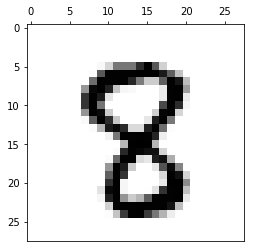

this is number
8
accuracy
0.420361155609


image


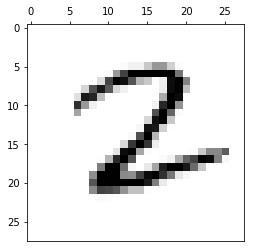

this is number
2
accuracy
0.445789797303


image


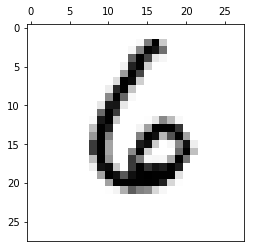

this is number
6
accuracy
0.772781410006


image


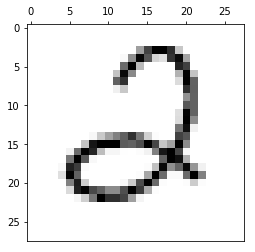

this is number
2
accuracy
0.382528429451


this is number
0
accuracy
0.325485743692


image


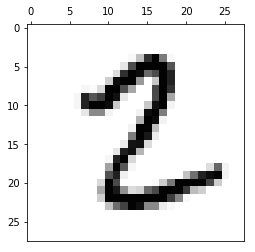

this is number
8
accuracy
0.313682517952


image


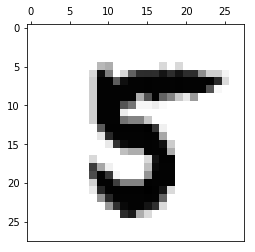

image


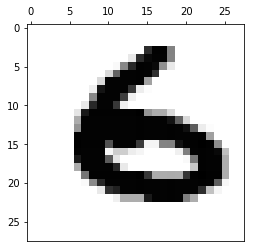

this is number
6
accuracy
0.434919108371


image


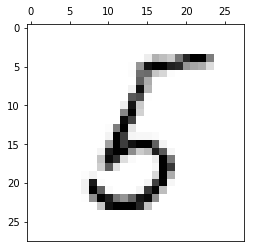

this is number
8
accuracy
0.424873731844


image


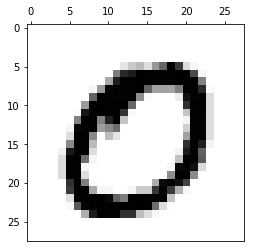

this is number
5
accuracy
0.337349970826


this is number
0
accuracy
0.893934815069


image


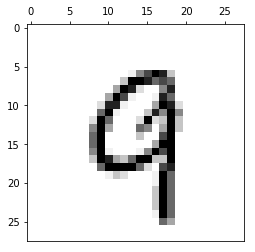

this is number
9
accuracy
0.406274258639


image


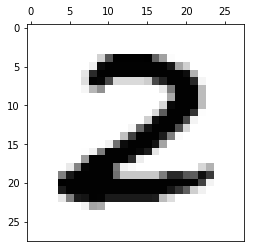

this is number
2
accuracy
0.750346544233


image


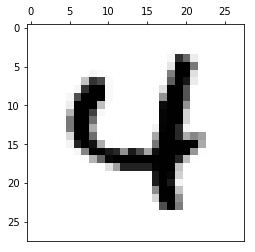

this is number
4
accuracy
0.617692444722


image


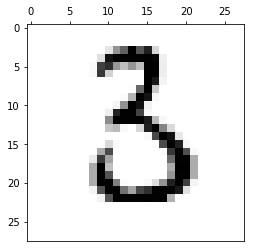

this is number
3
accuracy
0.42817407932


this is number
6
accuracy
0.341773582273


image


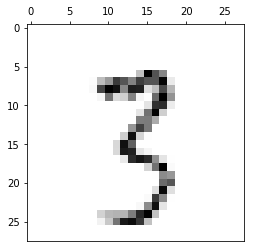

this is number
9
accuracy
0.324226002396


image


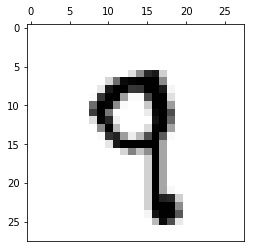

this is number
9
accuracy
0.560526707972


image


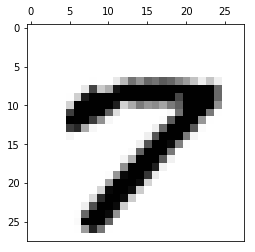

this is number
7
accuracy
0.757951415515


image


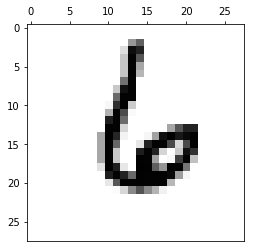

this is number
6
accuracy
0.820380721988


image


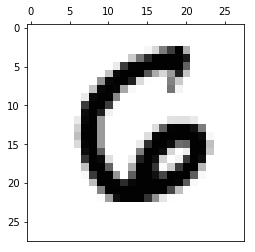

this is number
6
accuracy
0.406104253481


image


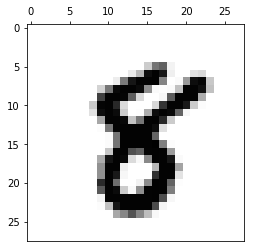

this is number
8
accuracy
0.444118793281


image


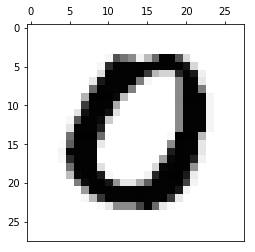

this is number
0
accuracy
0.898235802888


image


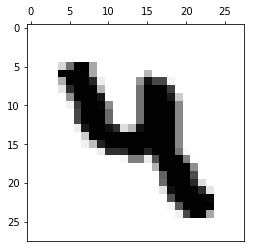

image


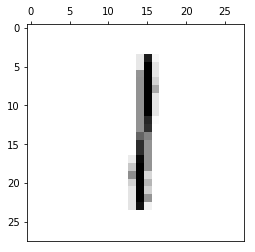

this is number
1
accuracy
0.692517569823


image


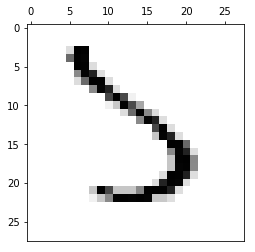

this is number
3
accuracy
0.570561225247


image


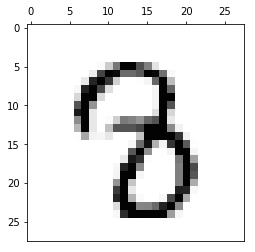

image


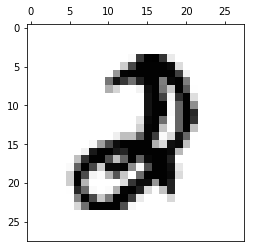

image


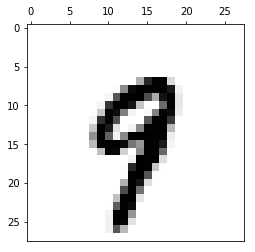

this is number
9
accuracy
0.35893287659


image


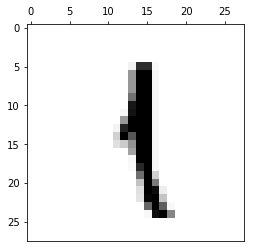

this is number
1
accuracy
0.653031214116


image


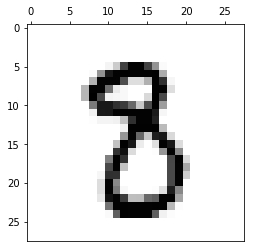

image


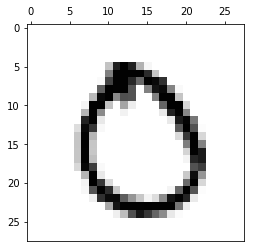

this is number
0
accuracy
0.625515244325


image


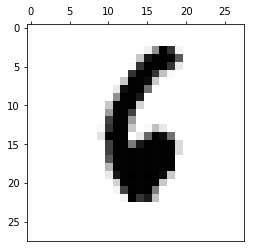

this is number
6
accuracy
0.4545735267


image


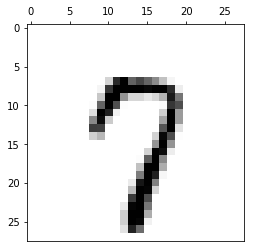

this is number
7
accuracy
0.635007459364


this is number
9
accuracy
0.513336790867


image


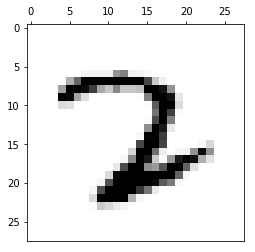

image


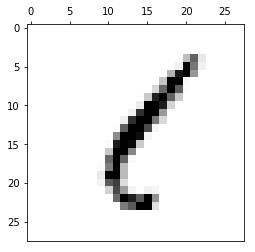

this is number
1
accuracy
0.559853352818


this is number
8
accuracy
0.416091624813


image


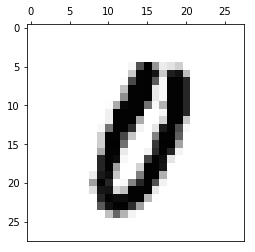

image


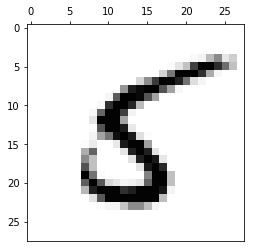

this is number
5
accuracy
0.452138958917


image


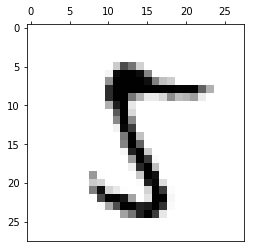

this is number
8
accuracy
0.377302982638


image


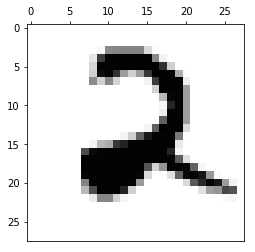

this is number
2
accuracy
0.8733863156


image


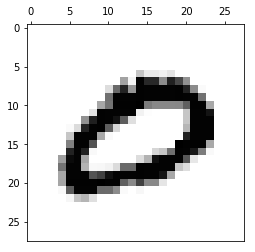

this is number
0
accuracy
0.782224844529


image


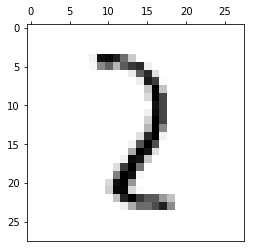

this is number
1
accuracy
0.431789808154


image


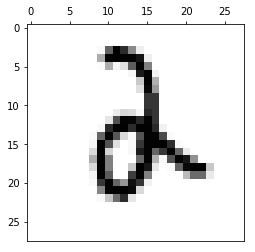

image


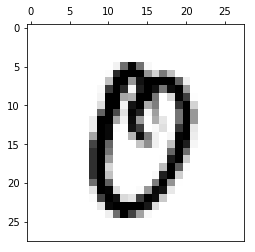

this is number
0
accuracy
0.314849846916


image


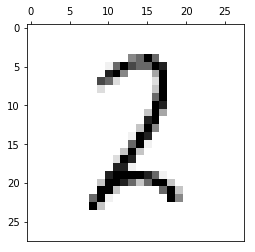

this is number
1
accuracy
0.449655401875


this is number
2
accuracy
0.504096730163


image


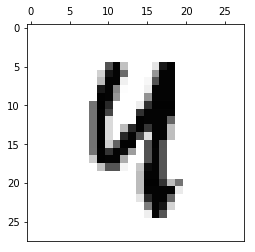

image


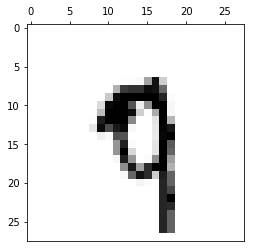

this is number
9
accuracy
0.334528932593


image


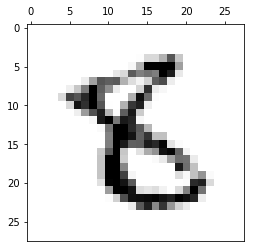

image


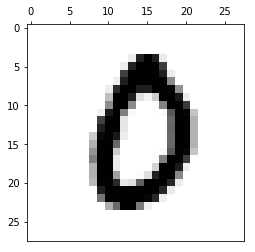

this is number
0
accuracy
0.418128845309


image


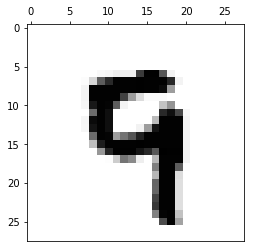

this is number
9
accuracy
0.484783614656


image


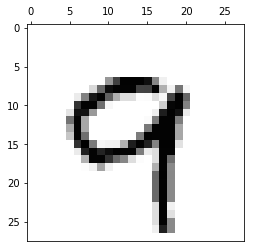

this is number
9
accuracy
0.453687070045


image


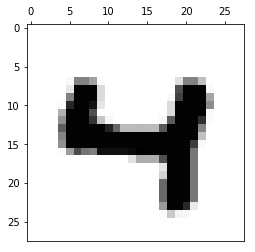

this is number
4
accuracy
0.73083361359


image


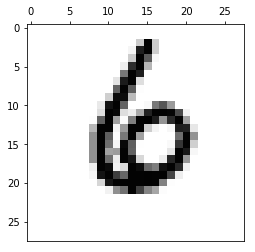

this is number
6
accuracy
0.595729303161


image


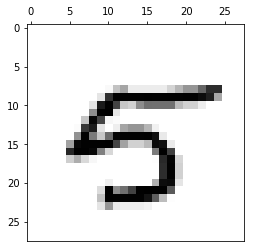

image


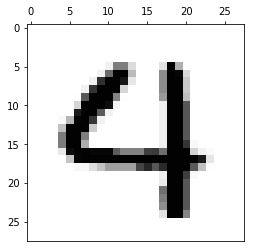

this is number
4
accuracy
0.331604373749


image


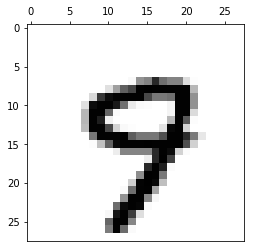

this is number
9
accuracy
0.334502578056


image


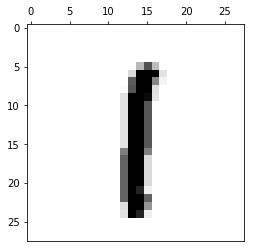

this is number
1
accuracy
0.772624900789


image


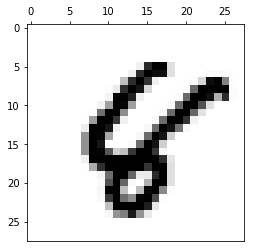

image


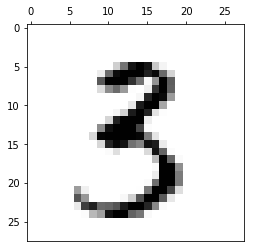

this is number
3
accuracy
0.627952428395


image


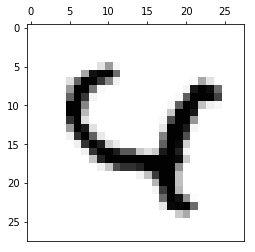

this is number
2
accuracy
0.332393721233


this is number
4
accuracy
0.556433353392


image


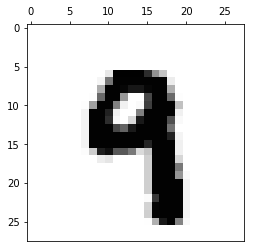

this is number
9
accuracy
0.384504407417


image


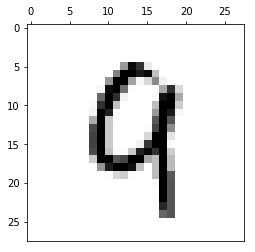

this is number
4
accuracy
0.332709975553


this is number
9
accuracy
0.312396505899


image


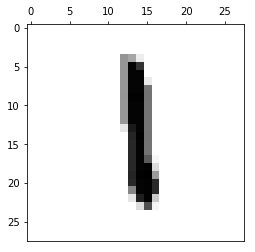

this is number
1
accuracy
0.649502221176


image


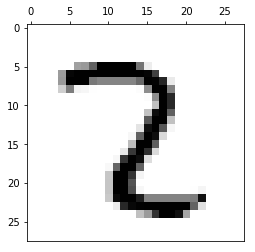

image


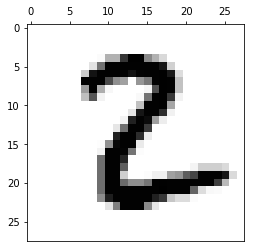

this is number
3
accuracy
0.351570456181


image


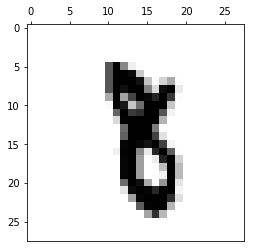

image


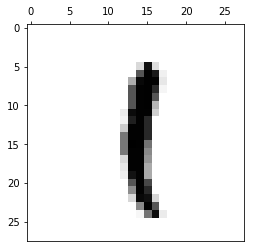

this is number
1
accuracy
0.791242323494


image


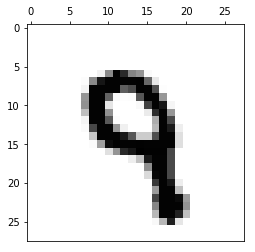

this is number
9
accuracy
0.367598850046


image


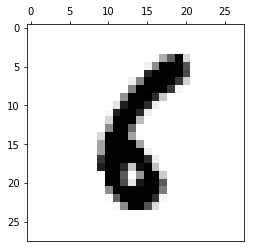

image


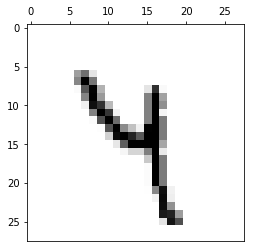

this is number
4
accuracy
0.367970110817


this is number
9
accuracy
0.344609880154


image


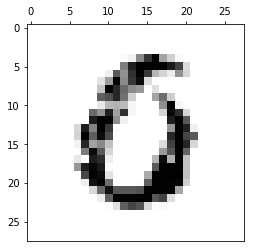

this is number
0
accuracy
0.489322916524


image


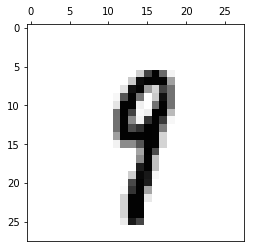

image


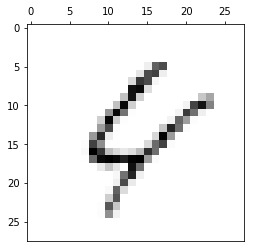

this is number
6
accuracy
0.3668637636


image


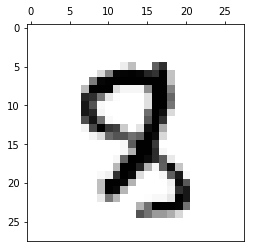

image


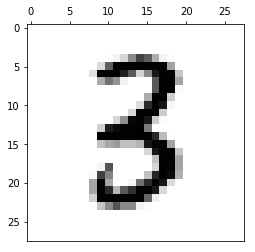

this is number
3
accuracy
0.588350098104


image


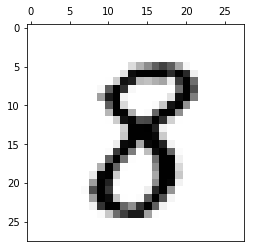

this is number
8
accuracy
0.572568542177


image


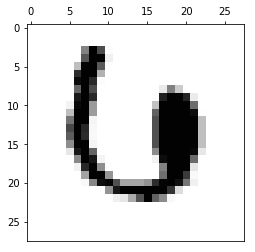

image


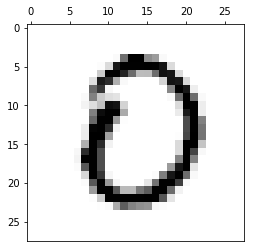

this is number
0
accuracy
0.851295135066


image


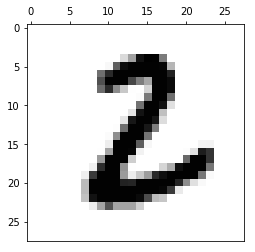

image


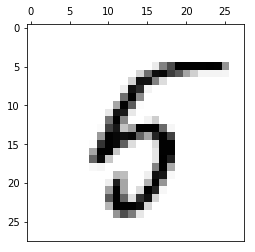

this is number
5
accuracy
0.341238944361


image


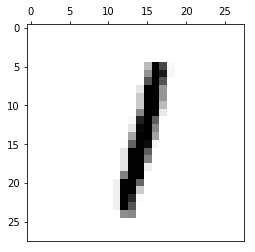

this is number
1
accuracy
0.778819061542


image


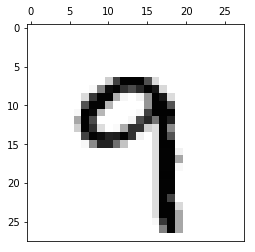

this is number
9
accuracy
0.501947958431


image


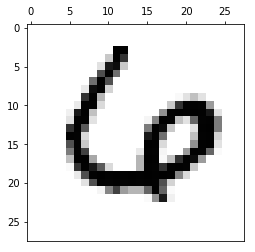

this is number
2
accuracy
0.31679045271


this is number
6
accuracy
0.347321016544


image


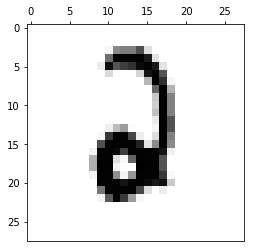

this is number
2
accuracy
0.491265124102


image


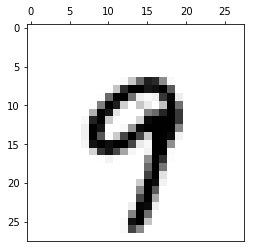

this is number
9
accuracy
0.600989785094


image


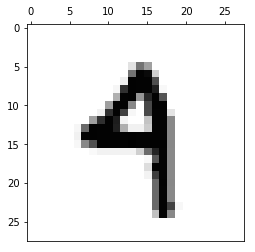

this is number
9
accuracy
0.433269154561


image


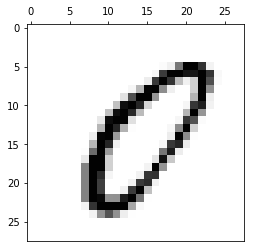

this is number
5
accuracy
0.462483310315


this is number
0
accuracy
0.582293252604


image


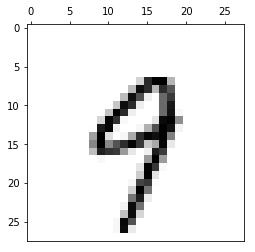

this is number
4
accuracy
0.322581149619


this is number
9
accuracy
0.473502946868


image


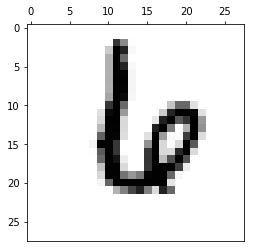

this is number
6
accuracy
0.708353163006


image


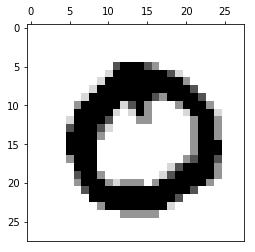

this is number
0
accuracy
0.883306807563


image


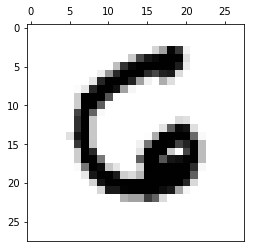

this is number
2
accuracy
0.311583169934


this is number
6
accuracy
0.472281990765


image


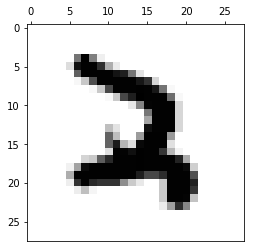

this is number
2
accuracy
0.533696656612


image


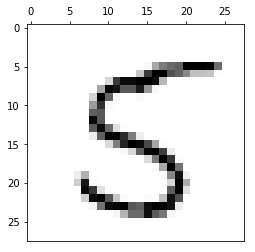

this is number
5
accuracy
0.457021841264


this is number
8
accuracy
0.328097584833


image


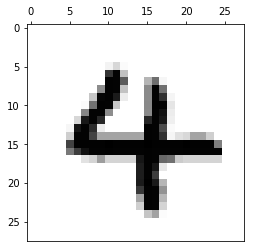

this is number
4
accuracy
0.466702771385


image


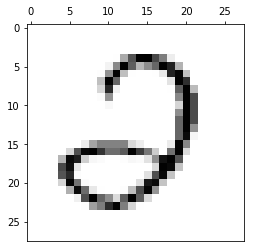

this is number
2
accuracy
0.369143932287


this is number
0
accuracy
0.435487443999


image


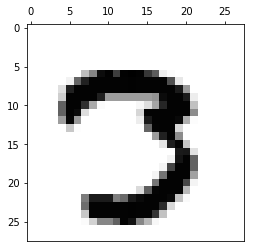

this is number
3
accuracy
0.513772707243


this is number
7
accuracy
0.42530621155


image


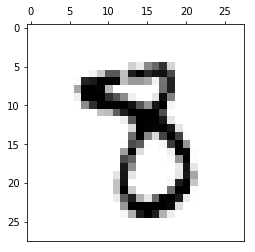

image


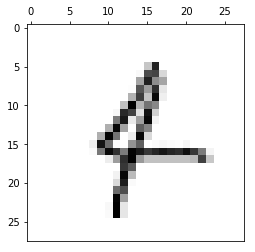

this is number
1
accuracy
0.360219471178


image


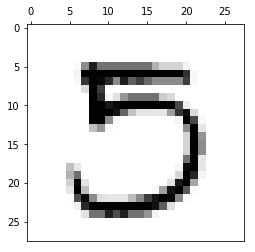

this is number
3
accuracy
0.364228796365


this is number
0
accuracy
0.402358103345


image


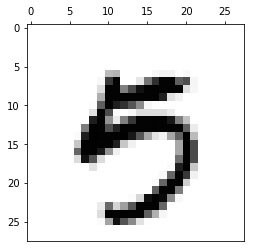

image


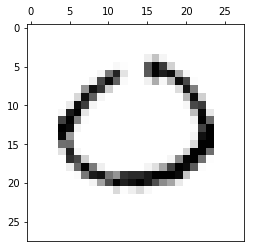

this is number
2
accuracy
0.459729257305


this is number
6
accuracy
0.448436275088


this is number
0
accuracy
0.675413376928


image


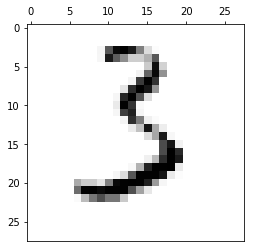

image


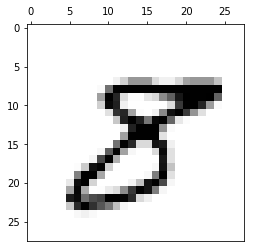

this is number
8
accuracy
0.305822778103


image


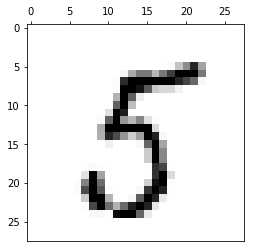

this is number
5
accuracy
0.543432267406


this is number
8
accuracy
0.333161263881


image


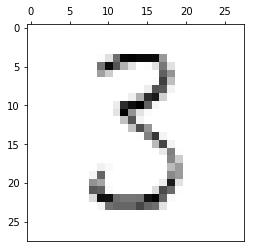

this is number
3
accuracy
0.541038069605


this is number
5
accuracy
0.351778564058


image


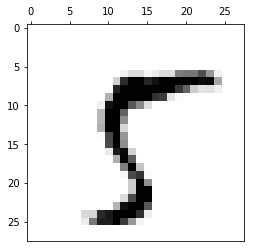

this is number
5
accuracy
0.409643488166


image


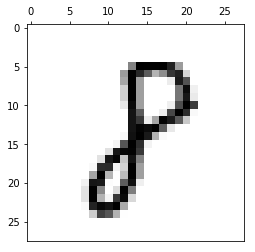

this is number
1
accuracy
0.302821628696


this is number
8
accuracy
0.494716336179


image


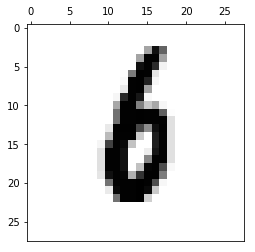

this is number
6
accuracy
0.337527873428


image


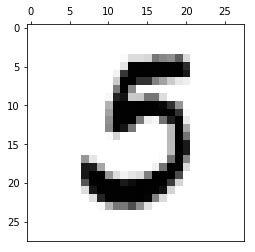

image


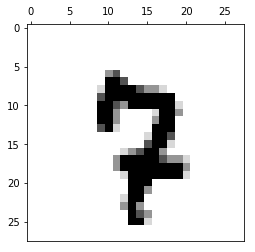

this is number
7
accuracy
0.487080073264


image


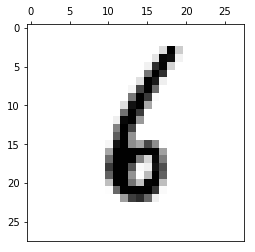

this is number
6
accuracy
0.395117922021


image


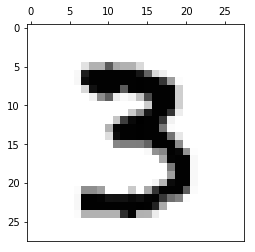

this is number
3
accuracy
0.761360901822


image


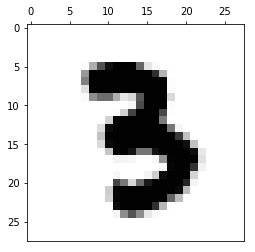

this is number
3
accuracy
0.394344681379


image


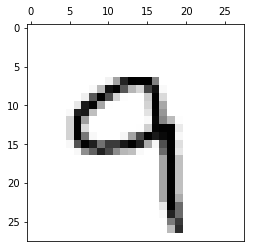

this is number
4
accuracy
0.304763377282


this is number
9
accuracy
0.481969424334


image


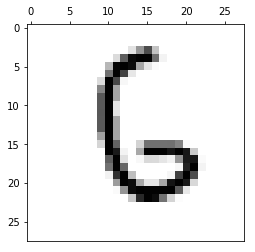

this is number
6
accuracy
0.58132147067


image


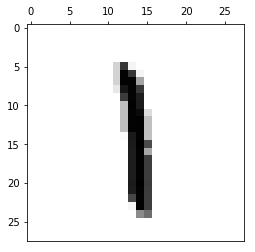

this is number
1
accuracy
0.61721834566


image


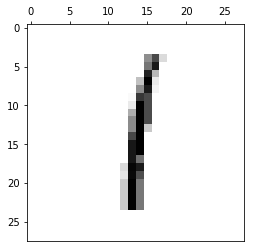

this is number
1
accuracy
0.80448199597


image


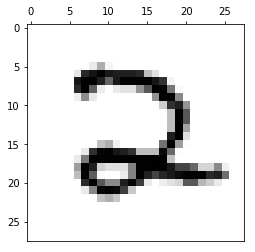

this is number
2
accuracy
0.724340878159


image


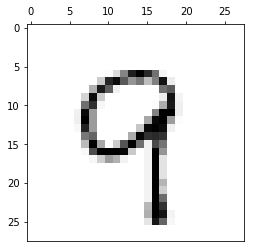

this is number
4
accuracy
0.340336557741


this is number
9
accuracy
0.458557266189


image


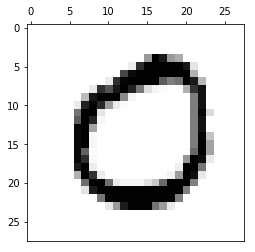

this is number
0
accuracy
0.843417488163


image


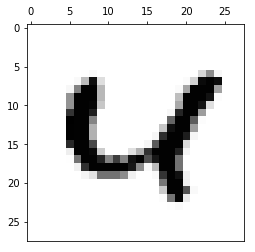

this is number
4
accuracy
0.512698439464


image


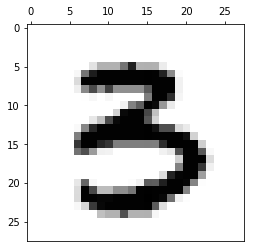

this is number
3
accuracy
0.566047422949


image


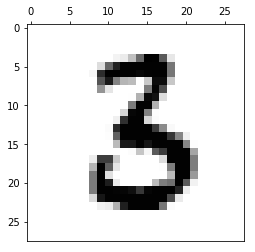

this is number
3
accuracy
0.55172644212


image


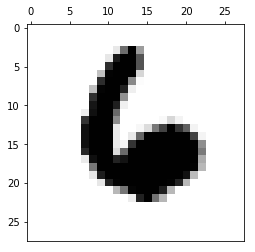

this is number
6
accuracy
0.656131154517


image


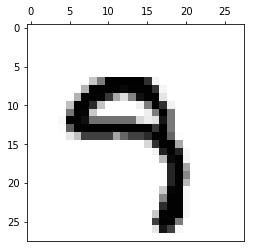

this is number
9
accuracy
0.387313713752


image


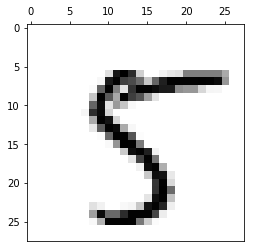

this is number
5
accuracy
0.405665030448


image


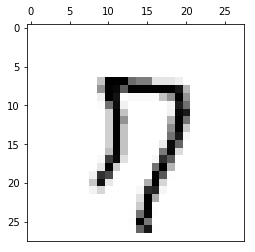

image


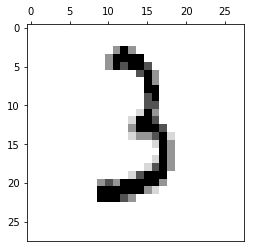

this is number
3
accuracy
0.405272843625


image


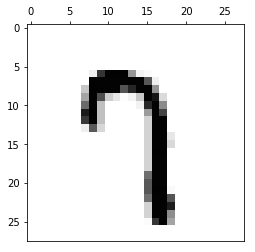

this is number
7
accuracy
0.432397198087


this is number
9
accuracy
0.336165685611


image


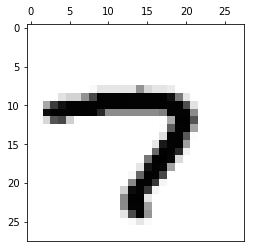

this is number
7
accuracy
0.779981936993


image


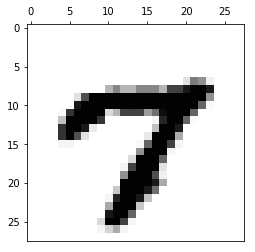

this is number
7
accuracy
0.803236900293


image


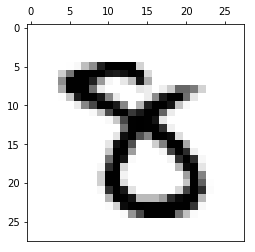

image


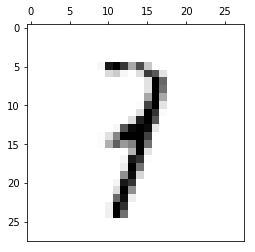

this is number
1
accuracy
0.687249291377


image


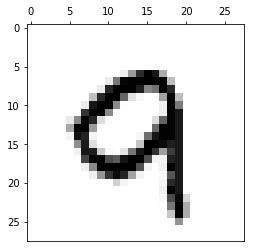

this is number
9
accuracy
0.318293519775


image


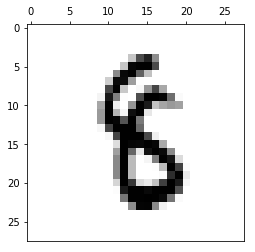

image


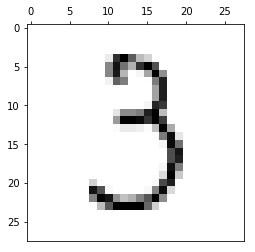

this is number
3
accuracy
0.777041934128


image


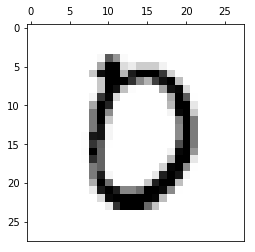

this is number
0
accuracy
0.672146773678


image


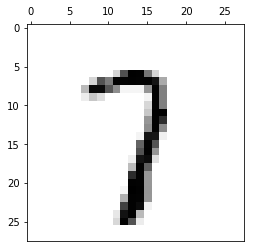

this is number
7
accuracy
0.354571456956


image


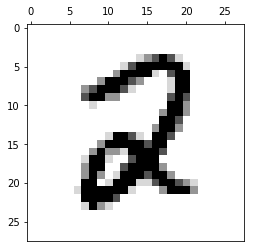

this is number
2
accuracy
0.54399830693


image


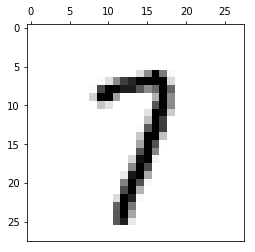

this is number
7
accuracy
0.445116630222


image


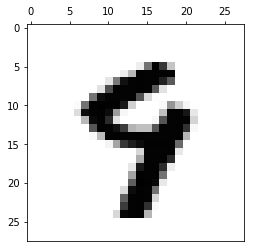

image


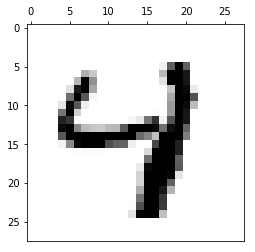

this is number
4
accuracy
0.450126966828


image


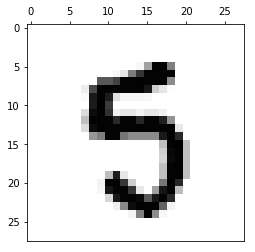

image


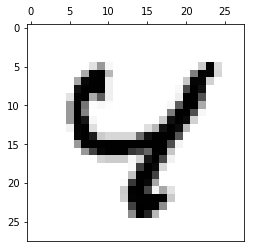

this is number
4
accuracy
0.60044796594


image


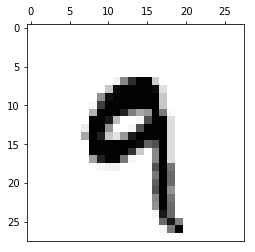

this is number
9
accuracy
0.437467050431


image


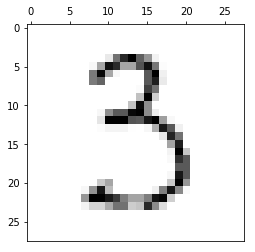

this is number
3
accuracy
0.68282253212


this is number
5
accuracy
0.328473005639


image


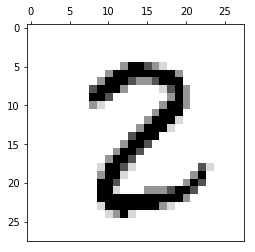

this is number
8
accuracy
0.629611364538


image


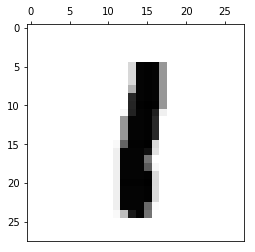

this is number
1
accuracy
0.711180727209


image


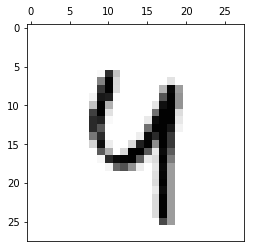

this is number
4
accuracy
0.548626888156


this is number
9
accuracy
0.368753415207


image


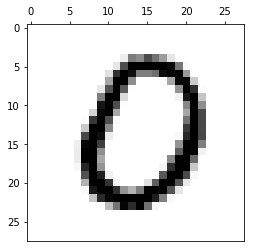

this is number
0
accuracy
0.902215030299


image


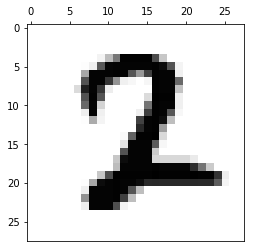

this is number
2
accuracy
0.459706504368


image


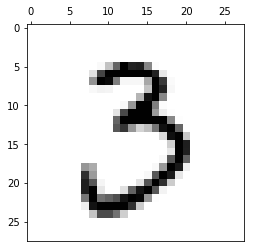

this is number
3
accuracy
0.802995168341


image


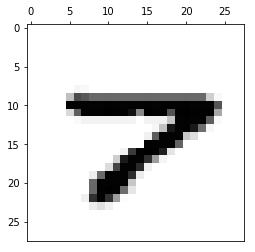

this is number
7
accuracy
0.450366744085


image


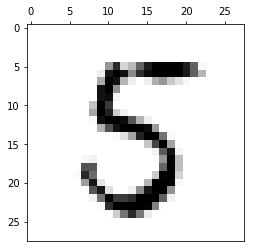

this is number
3
accuracy
0.420452642244


this is number
5
accuracy
0.455610357854


this is number
8
accuracy
0.362877205705


image


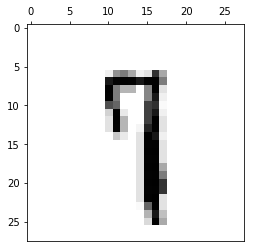

image


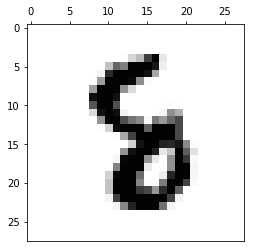

image


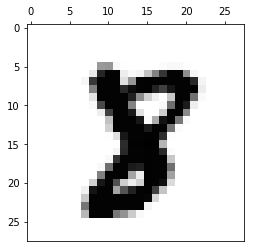

image


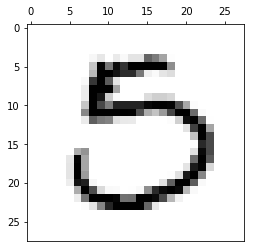

this is number
3
accuracy
0.337116427805


this is number
0
accuracy
0.542058062506


image


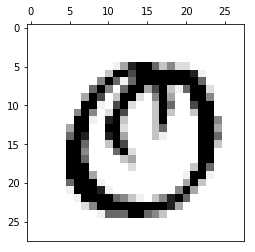

this is number
0
accuracy
0.575916853818


image


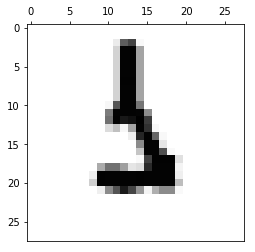

this is number
6
accuracy
0.484539240937


image


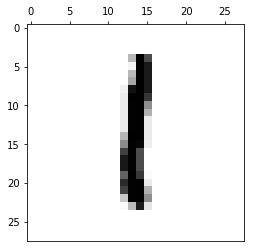

this is number
1
accuracy
0.761529187985


image


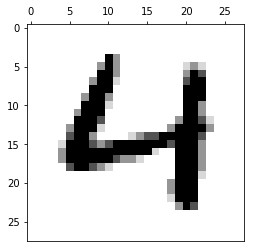

this is number
4
accuracy
0.631748438162


image


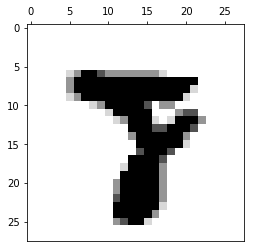

image


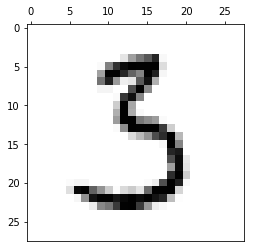

this is number
3
accuracy
0.725613414991


image


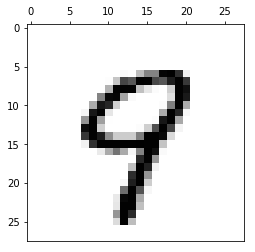

this is number
9
accuracy
0.441529086264


image


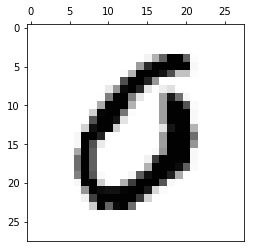

this is number
0
accuracy
0.530552956762


image


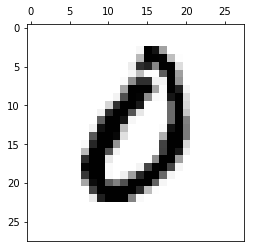

this is number
0
accuracy
0.336496285312


image


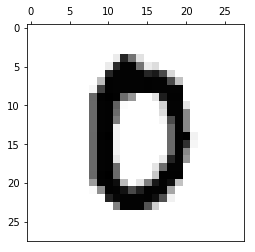

this is number
0
accuracy
0.343478792588


image


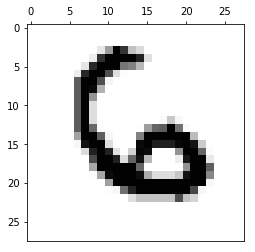

this is number
2
accuracy
0.474390675899


this is number
6
accuracy
0.668532196653


image


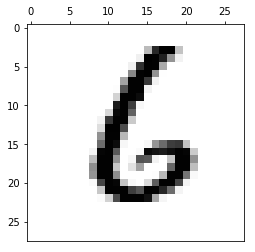

this is number
6
accuracy
0.710382535385


image


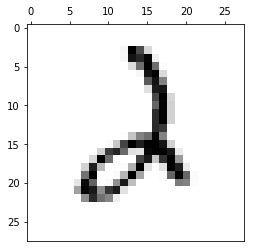

this is number
2
accuracy
0.554224951686


image


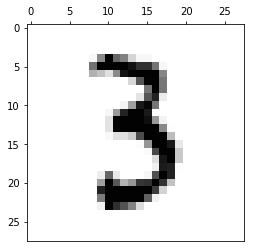

this is number
3
accuracy
0.593467720518


image


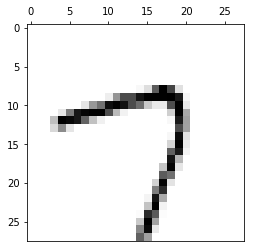

this is number
7
accuracy
0.623459637327


this is number
9
accuracy
0.333103005847


this is number
0
accuracy
0.342303583196


image


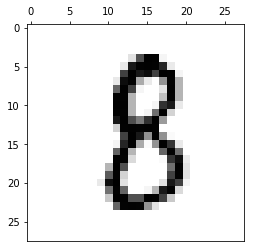

this is number
8
accuracy
0.356082258646


image


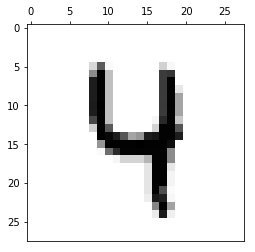

this is number
4
accuracy
0.611694411416


this is number
9
accuracy
0.367740526456


image


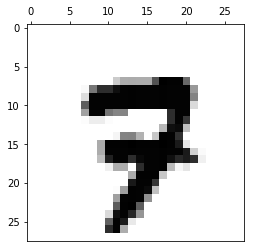

this is number
7
accuracy
0.378948243203


image


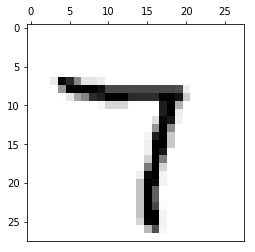

this is number
7
accuracy
0.808916455469


this is number
9
accuracy
0.352658556307


image


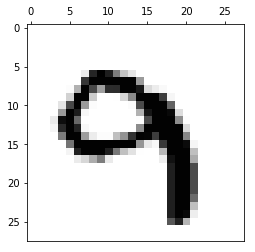

image


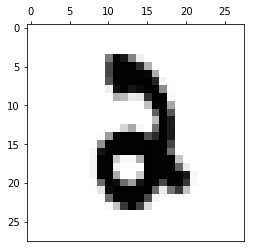

image


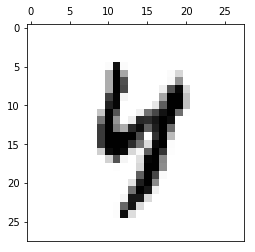

this is number
4
accuracy
0.374943192073


image


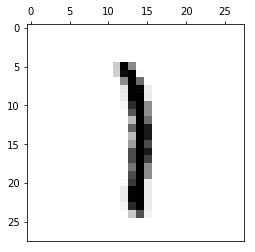

this is number
1
accuracy
0.696259106837


image


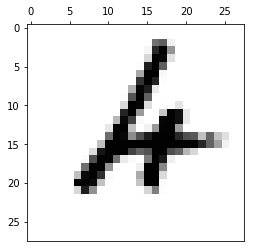

this is number
6
accuracy
0.336649730426


image


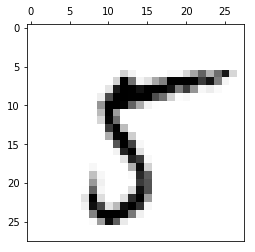

this is number
5
accuracy
0.420969749882


image


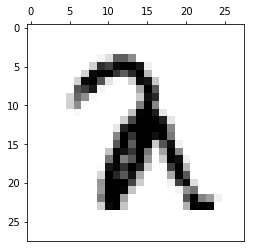

image


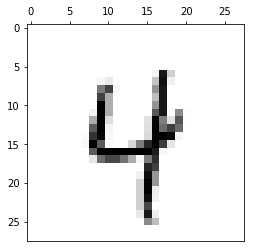

this is number
4
accuracy
0.572362831577


this is number
9
accuracy
0.450144519139


image


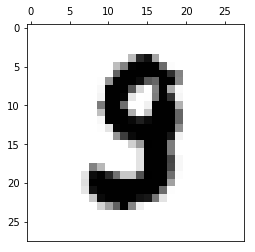

image


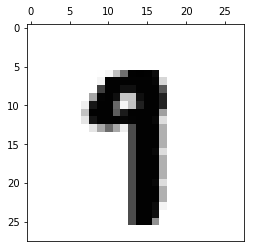

image


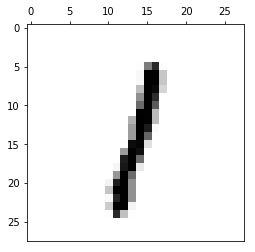

this is number
1
accuracy
0.81841043453


image


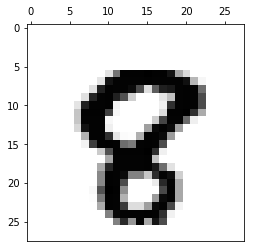

image


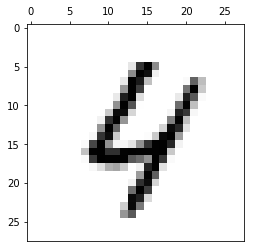

this is number
4
accuracy
0.30485340271


image


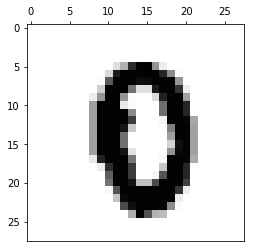

image


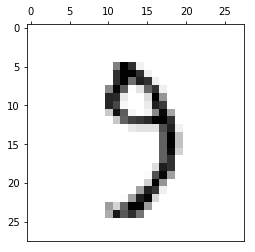

this is number
3
accuracy
0.456565495497


image


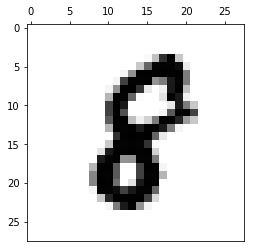

this is number
8
accuracy
0.422437325161


image


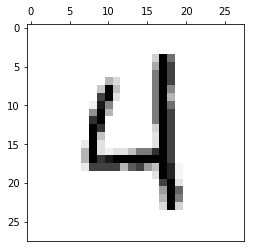

this is number
4
accuracy
0.389070439355


image


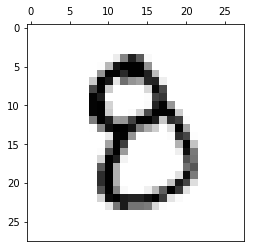

this is number
3
accuracy
0.318387687987


image


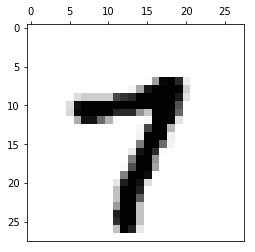

this is number
7
accuracy
0.683773732362


image


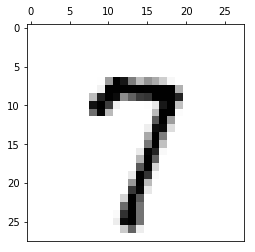

this is number
7
accuracy
0.767836429218


this is number
9
accuracy
0.416629379405


image


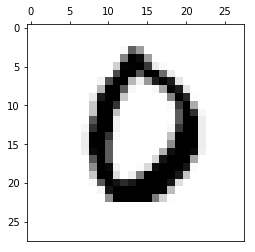

this is number
6
accuracy
0.343918843572


this is number
0
accuracy
0.566329825374


image


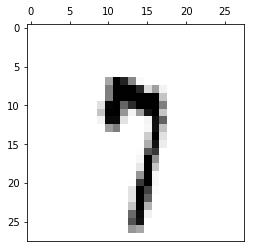

this is number
7
accuracy
0.550972559515


image


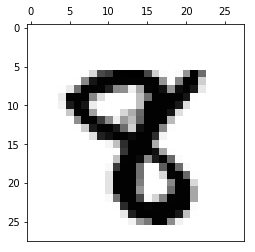

image


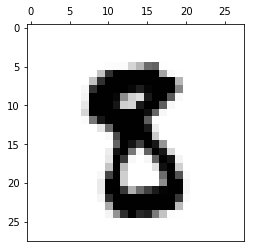

image


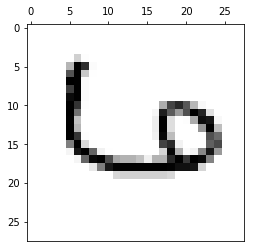

this is number
2
accuracy
0.432681140319


this is number
4
accuracy
0.415541617747


this is number
6
accuracy
0.42096326669


this is number
7
accuracy
0.307249869578


image


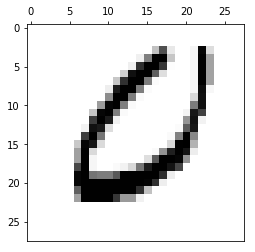

this is number
6
accuracy
0.324904110043


this is number
0
accuracy
0.671081815255


image


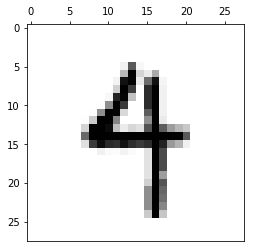

this is number
9
accuracy
0.443546508865


image


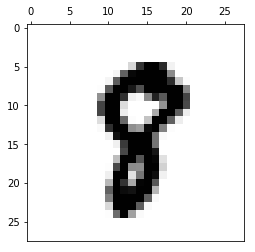

image


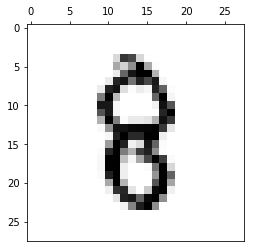

this is number
8
accuracy
0.33090827397


image


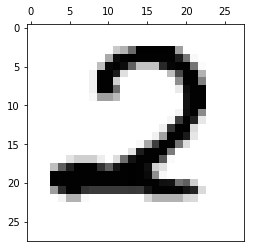

this is number
2
accuracy
0.826785004686


image


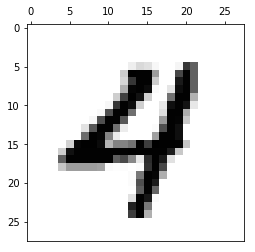

this is number
4
accuracy
0.366351108367


image


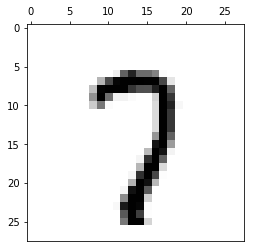

this is number
7
accuracy
0.59704597547


this is number
9
accuracy
0.365056065642


image


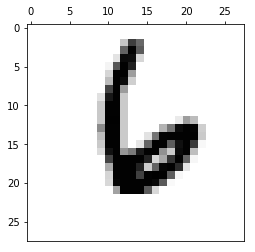

this is number
6
accuracy
0.770622023878


image


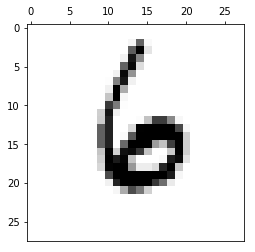

this is number
6
accuracy
0.664177613735


image


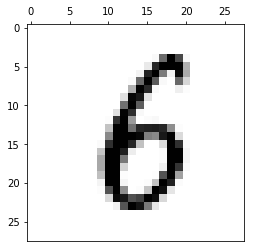

this is number
6
accuracy
0.308613292328


image


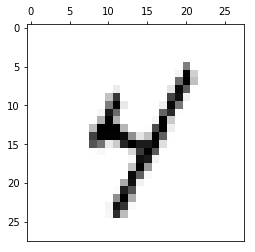

this is number
4
accuracy
0.568166892476


this is number
9
accuracy
0.305133337309


image


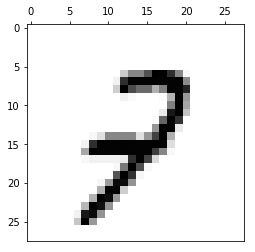

image


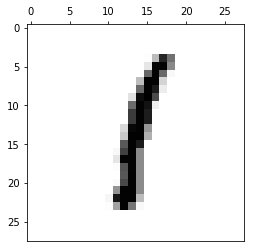

this is number
1
accuracy
0.808543083724


image


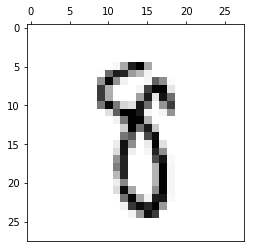

image


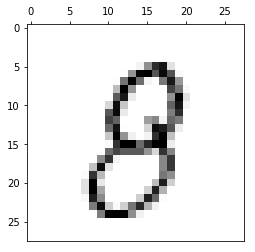

this is number
8
accuracy
0.421115390654


image


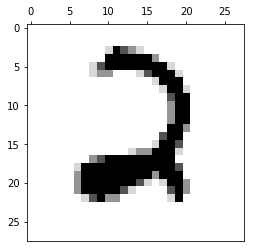

this is number
2
accuracy
0.885950319182


image


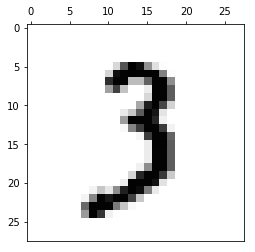

this is number
3
accuracy
0.518790892875


image


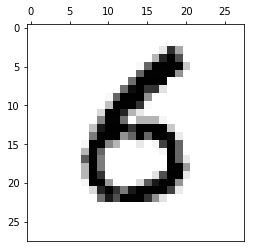

image


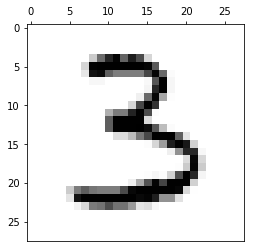

this is number
3
accuracy
0.803834850614


image


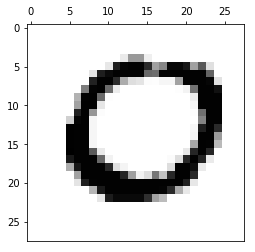

this is number
2
accuracy
0.390167424238


this is number
0
accuracy
0.823231078601


image


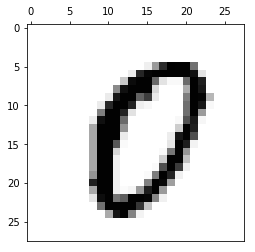

this is number
5
accuracy
0.362153330748


this is number
0
accuracy
0.666189163469


image


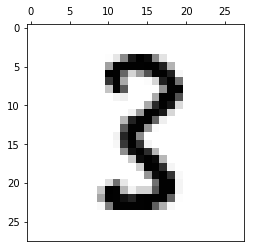

this is number
3
accuracy
0.390674282187


image


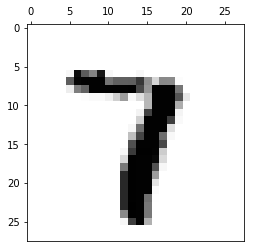

this is number
7
accuracy
0.398028143881


image


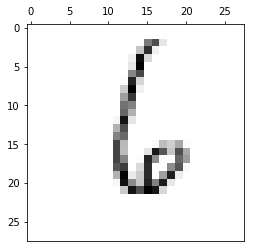

this is number
6
accuracy
0.623328540839


image


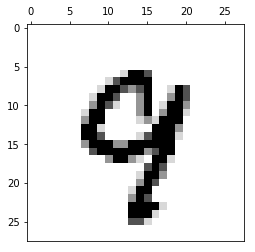

this is number
9
accuracy
0.383484349487


image


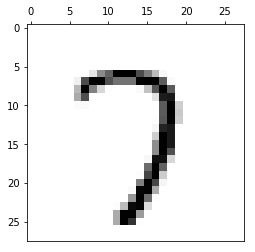

this is number
3
accuracy
0.414365960014


this is number
7
accuracy
0.497018640236


this is number
9
accuracy
0.300765919754


image


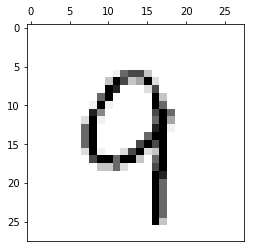

this is number
4
accuracy
0.345974125734


this is number
9
accuracy
0.397852085993


image


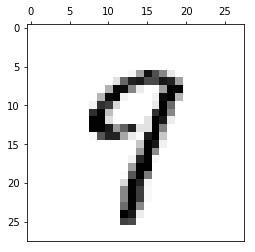

this is number
9
accuracy
0.38248799789


image


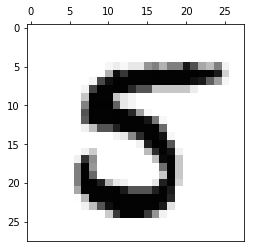

this is number
5
accuracy
0.493199511396


image


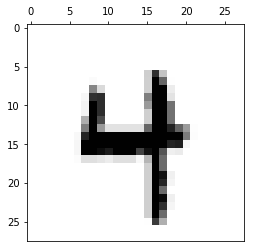

this is number
4
accuracy
0.589781019912


this is number
9
accuracy
0.438331408131


image


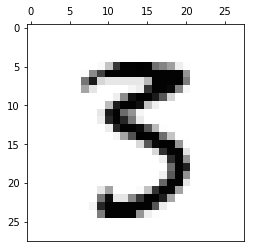

this is number
3
accuracy
0.561735862266


image


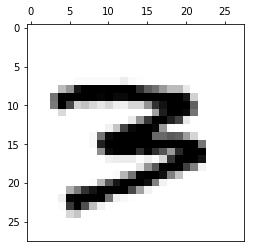

image


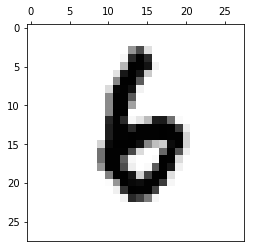

this is number
6
accuracy
0.565987799234


image


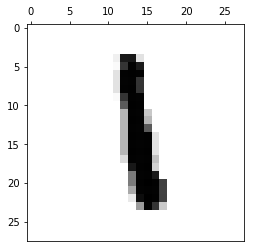

this is number
1
accuracy
0.475768781119


image


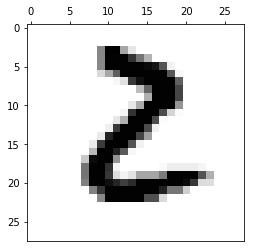

image


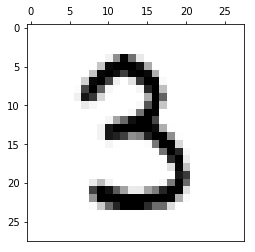

this is number
3
accuracy
0.805451572051


image


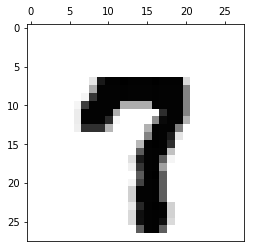

this is number
7
accuracy
0.645911683991


this is number
9
accuracy
0.382362619177


image


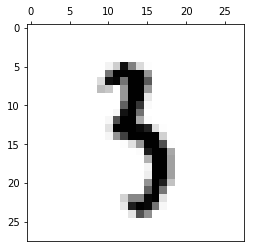

this is number
3
accuracy
0.364176788893


image


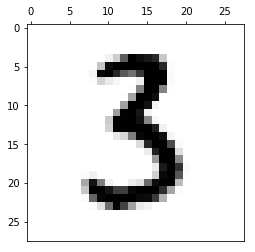

this is number
3
accuracy
0.621649056565


image


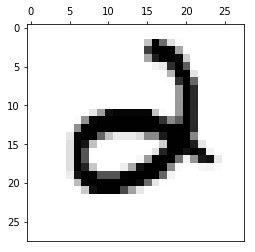

image


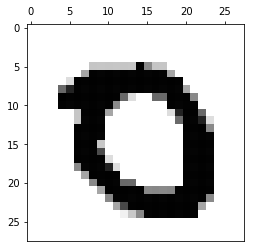

this is number
0
accuracy
0.787684655777


image


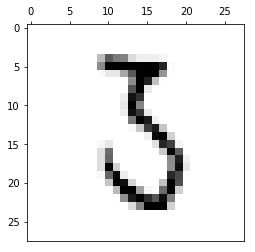

this is number
3
accuracy
0.420145295997


image


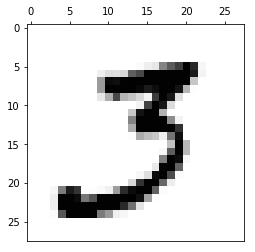

this is number
3
accuracy
0.55807014165


image


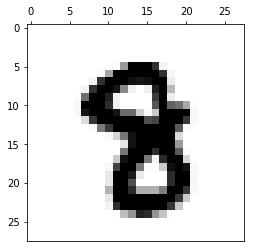

image


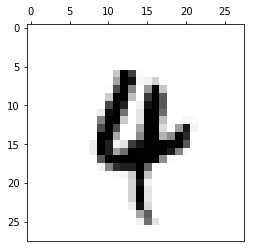

image


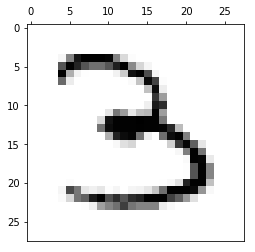

this is number
3
accuracy
0.736324662236


image


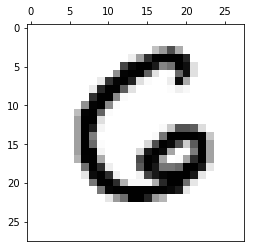

this is number
6
accuracy
0.319811075462


this is number
0
accuracy
0.322236797765


image


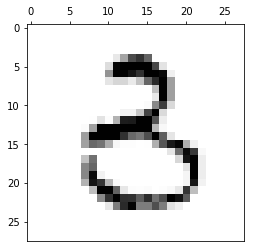

this is number
3
accuracy
0.593597751929


image


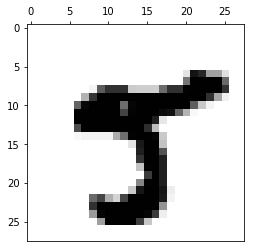

image


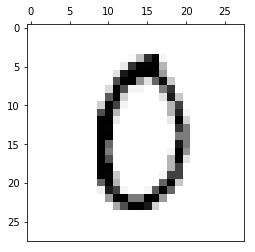

this is number
0
accuracy
0.473957689682


image


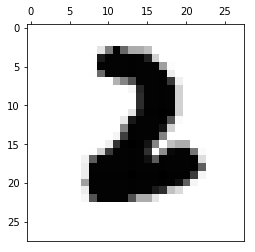

this is number
2
accuracy
0.314914987213


image


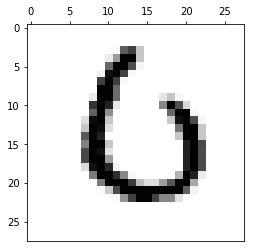

this is number
6
accuracy
0.521181227596


this is number
0
accuracy
0.613275667471


image


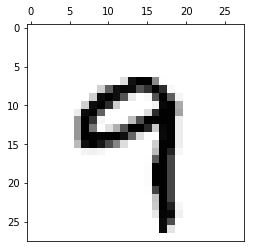

this is number
9
accuracy
0.572804972439


image


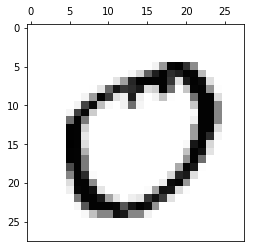

this is number
5
accuracy
0.385111897963


this is number
0
accuracy
0.859408145067


image


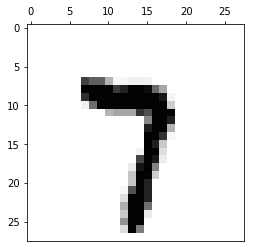

this is number
7
accuracy
0.758602351468


image


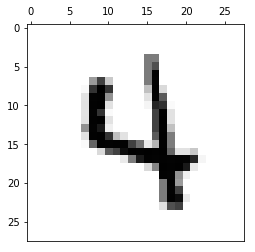

this is number
4
accuracy
0.442875207928


image


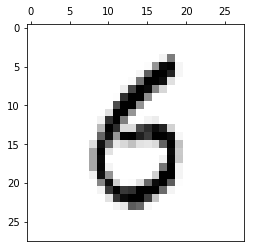

image


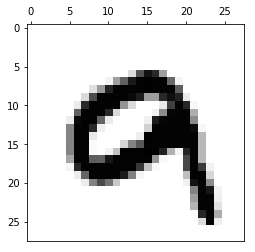

image


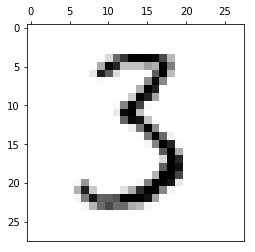

this is number
3
accuracy
0.638793135389


image


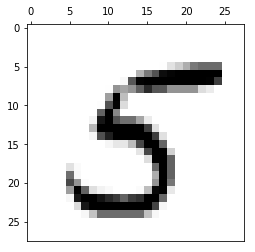

this is number
5
accuracy
0.616387350346


image


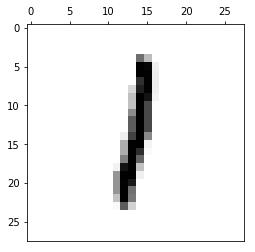

this is number
1
accuracy
0.825562984635


image


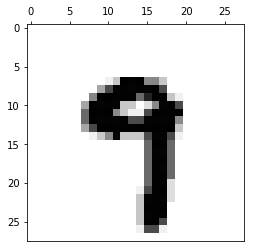

this is number
9
accuracy
0.422907568609


image


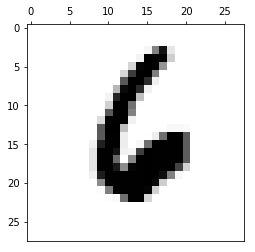

this is number
6
accuracy
0.748027769431


image


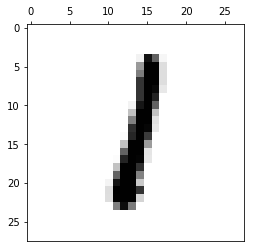

this is number
1
accuracy
0.835621538177


image


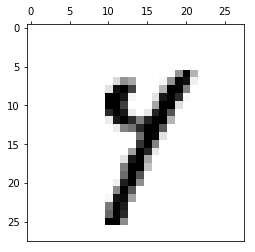

image


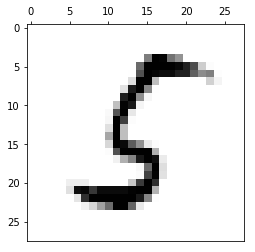

this is number
5
accuracy
0.307230254988


image


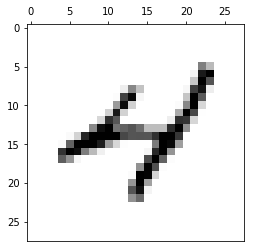

this is number
4
accuracy
0.63954156023


this is number
9
accuracy
0.350195200255


image


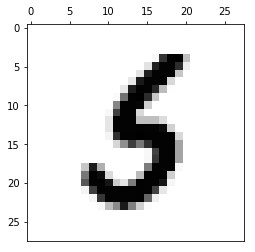

image


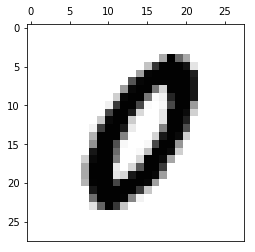

image


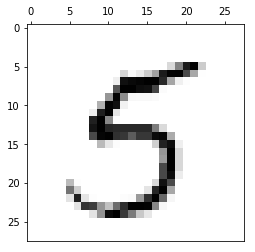

this is number
5
accuracy
0.470771296921


this is number
9
accuracy
0.327373242811


image


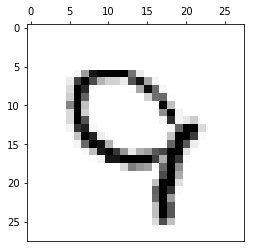

this is number
4
accuracy
0.340634164277


image


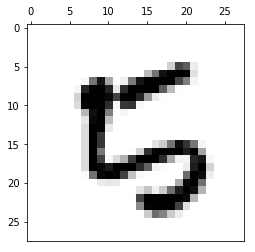

image


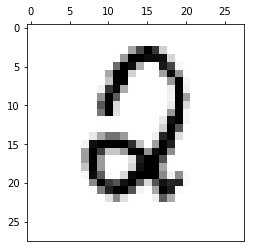

this is number
2
accuracy
0.425056094257


image


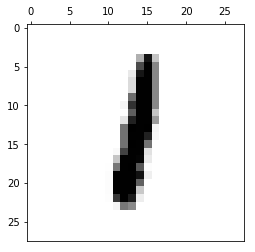

this is number
1
accuracy
0.83272746711


image


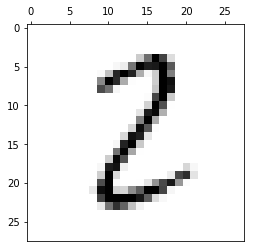

this is number
3
accuracy
0.378332265297


this is number
8
accuracy
0.33396852502


image


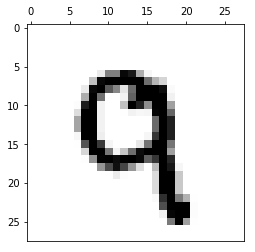

image


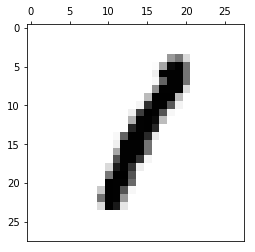

this is number
1
accuracy
0.720628029728


image


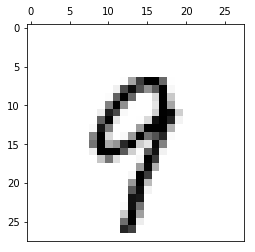

this is number
9
accuracy
0.535347126633


image


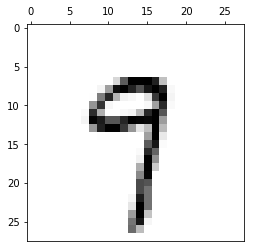

this is number
7
accuracy
0.306196941167


this is number
9
accuracy
0.408302881621


image


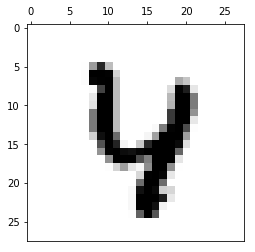

this is number
4
accuracy
0.567152380904


image


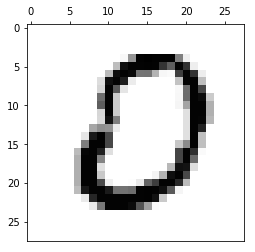

this is number
0
accuracy
0.88547949027


image


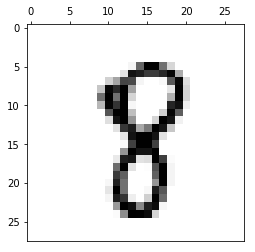

this is number
8
accuracy
0.502092973978


image


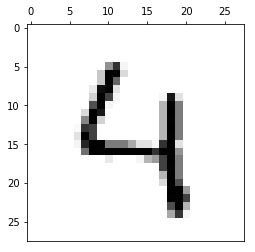

this is number
4
accuracy
0.683424971713


this is number
9
accuracy
0.375037066286


image


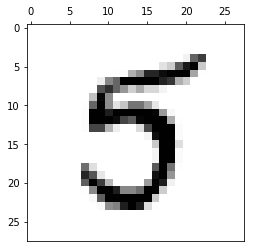

image


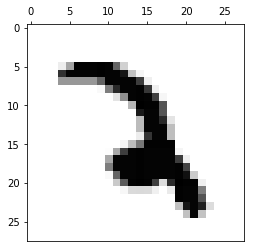

this is number
2
accuracy
0.310741694412


image


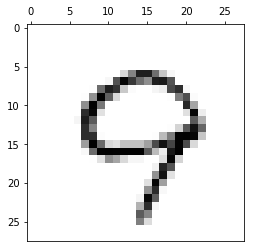

this is number
4
accuracy
0.318714706555


this is number
9
accuracy
0.303841407801


image


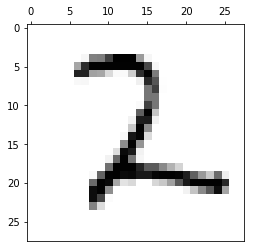

this is number
1
accuracy
0.47023137669


this is number
2
accuracy
0.727026151689


image


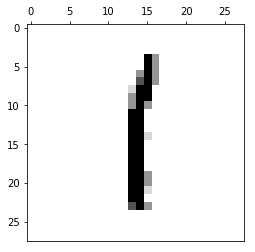

this is number
1
accuracy
0.767290700239


image


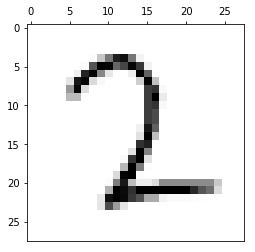

this is number
1
accuracy
0.419322483023


this is number
2
accuracy
0.321543139978


image


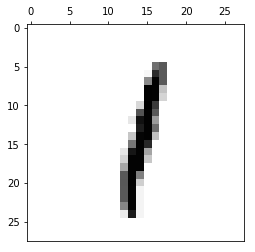

this is number
1
accuracy
0.796559324458


image


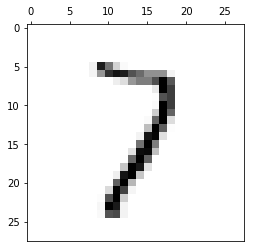

this is number
2
accuracy
0.313058181341


image


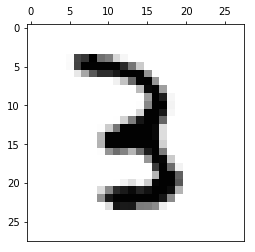

this is number
3
accuracy
0.501082202019


image


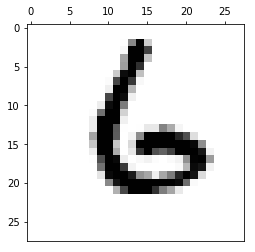

this is number
6
accuracy
0.829267601278


image


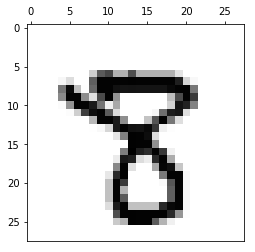

image


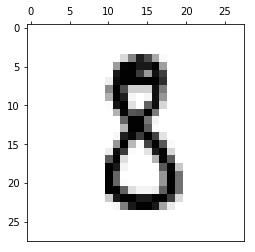

image


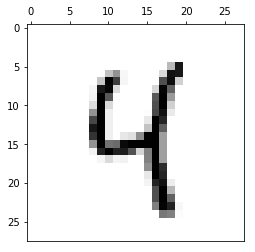

this is number
4
accuracy
0.517522201897


this is number
9
accuracy
0.368902691561


image


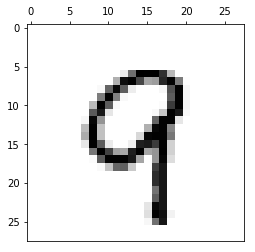

this is number
4
accuracy
0.333043406398


this is number
9
accuracy
0.468454943461


image


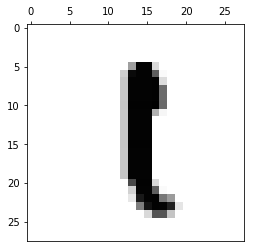

this is number
1
accuracy
0.701769642552


image


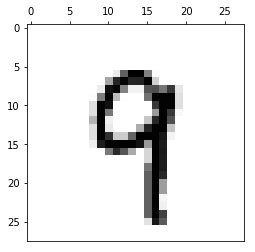

this is number
9
accuracy
0.48829881349


image


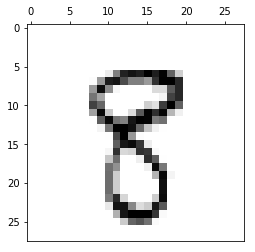

this is number
8
accuracy
0.461374108499


image


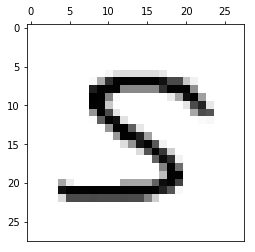

this is number
5
accuracy
0.303149873309


image


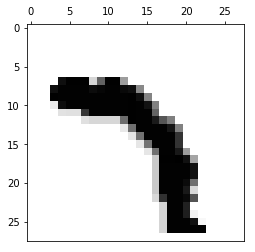

image


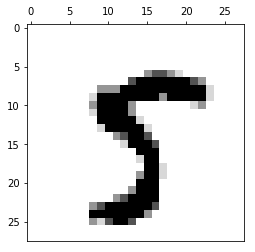

image


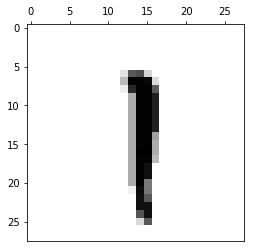

this is number
1
accuracy
0.701421556245


image


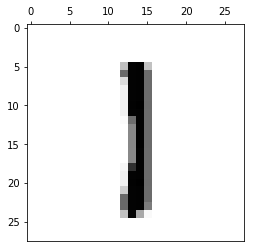

this is number
1
accuracy
0.676624816787


image


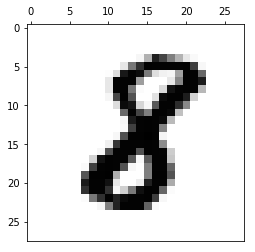

image


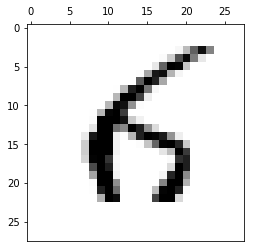

this is number
5
accuracy
0.314540552326


this is number
6
accuracy
0.482119648878


image


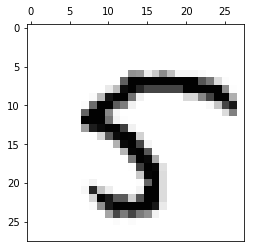

this is number
5
accuracy
0.420478064952


this is number
8
accuracy
0.322489441867


image


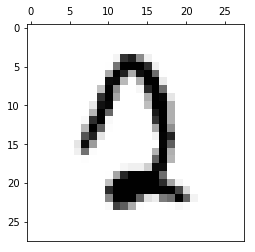

image


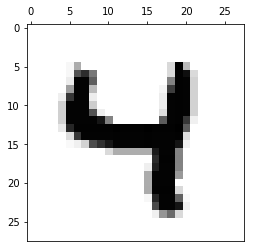

this is number
4
accuracy
0.638628610915


image


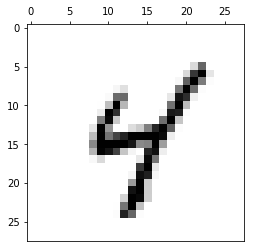

this is number
4
accuracy
0.602978923529


this is number
9
accuracy
0.354647872524


image


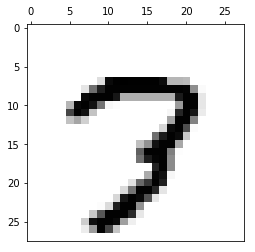

this is number
7
accuracy
0.74034354261


image


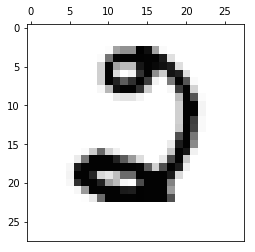

this is number
2
accuracy
0.546883005438


this is number
0
accuracy
0.514684135423


image


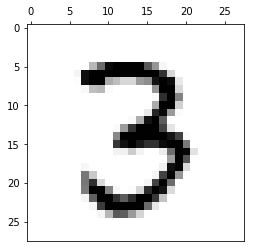

this is number
3
accuracy
0.774062687916


image


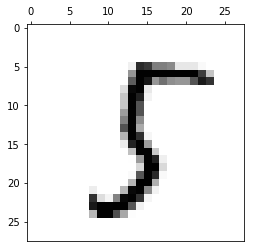

this is number
1
accuracy
0.305463542087


image


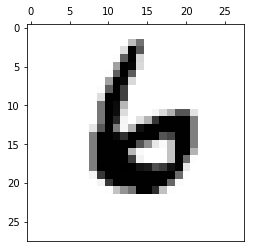

this is number
6
accuracy
0.763795823705


image


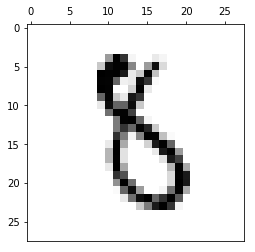

image


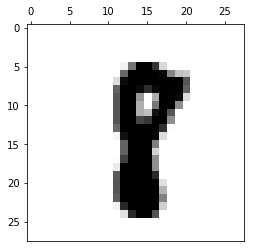

image


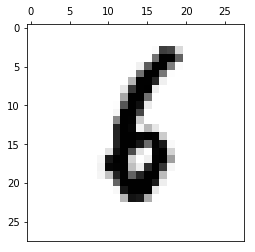

this is number
6
accuracy
0.377877267554


image


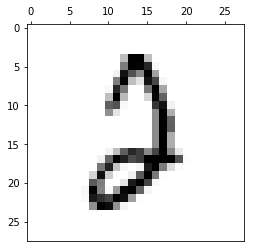

image


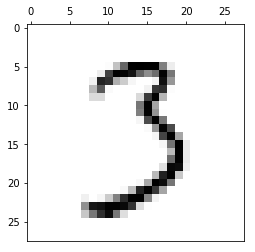

this is number
3
accuracy
0.730742207337


image


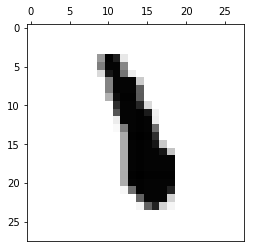

image


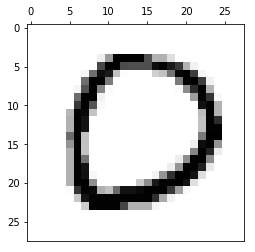

this is number
2
accuracy
0.342956185396


this is number
3
accuracy
0.432967488511


this is number
5
accuracy
0.302999327593


this is number
0
accuracy
0.784332885086


image


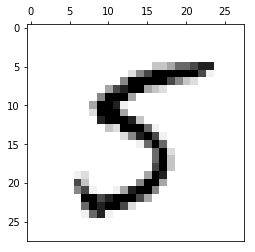

this is number
5
accuracy
0.478859028725


image


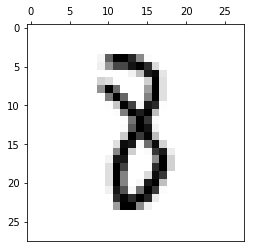

image


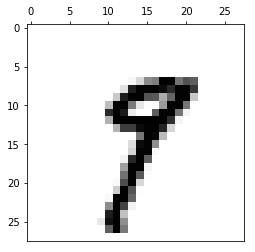

this is number
7
accuracy
0.321686054216


image


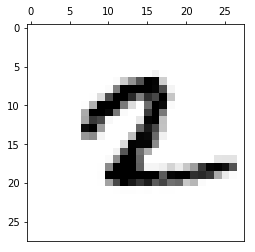

image


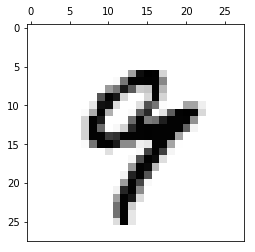

this is number
9
accuracy
0.407311317813


image


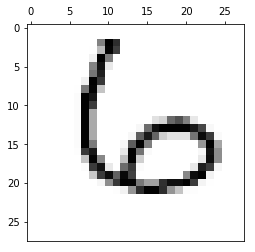

this is number
2
accuracy
0.343980943615


this is number
6
accuracy
0.549047277926


image


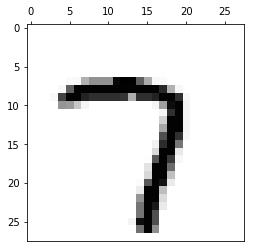

this is number
7
accuracy
0.767507337074


image


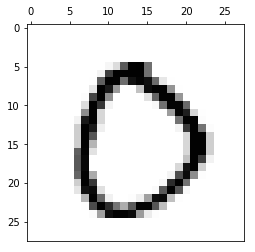

this is number
0
accuracy
0.701785103442


image


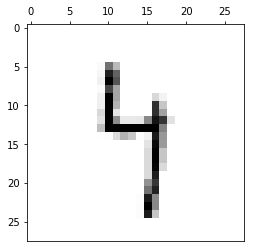

this is number
3
accuracy
0.328953023617


this is number
4
accuracy
0.357772208004


this is number
5
accuracy
0.302996984431


this is number
8
accuracy
0.304789351538


this is number
9
accuracy
0.347667863203


image


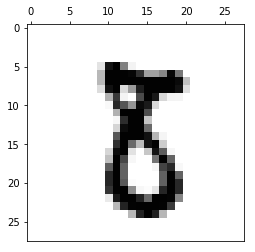

image


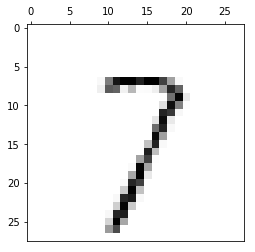

this is number
7
accuracy
0.557156078836


this is number
9
accuracy
0.399641152304


image


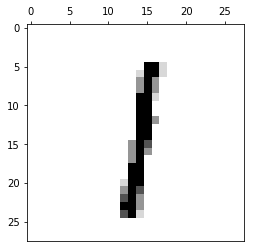

this is number
1
accuracy
0.77247693791


image


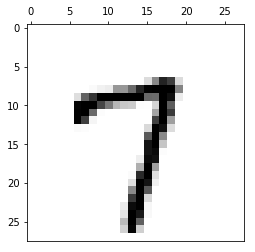

this is number
7
accuracy
0.764609624136


this is number
9
accuracy
0.381121373077


image


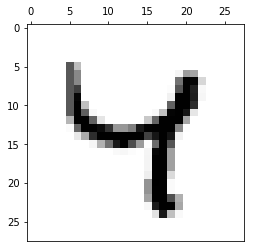

this is number
4
accuracy
0.611932109509


this is number
9
accuracy
0.379471659


image


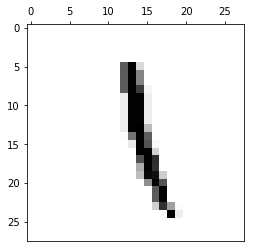

this is number
1
accuracy
0.451973760591


image


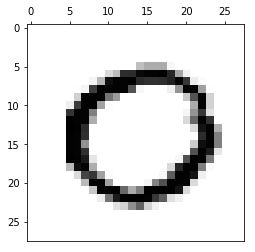

this is number
0
accuracy
0.868757692092


image


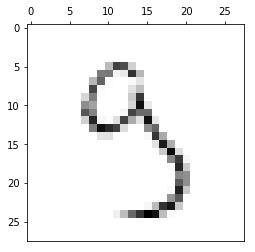

this is number
3
accuracy
0.470707797053


this is number
5
accuracy
0.393085350172


image


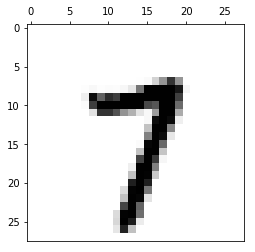

this is number
7
accuracy
0.757740436496


image


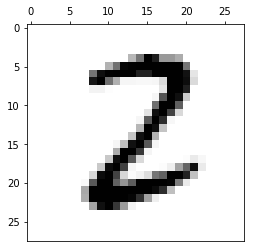

this is number
2
accuracy
0.401920391663


image


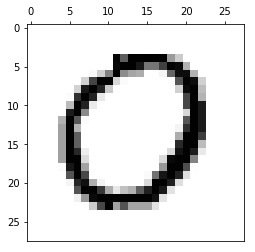

this is number
3
accuracy
0.45939190178


this is number
0
accuracy
0.819092371047


image


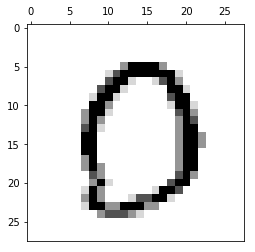

this is number
0
accuracy
0.787614822146


image


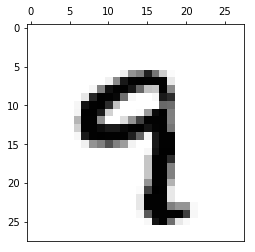

this is number
9
accuracy
0.529152718694


image


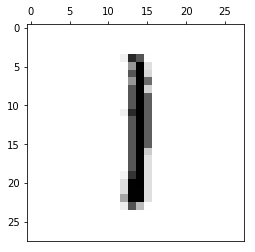

this is number
1
accuracy
0.769756695386


image


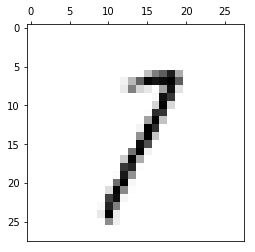

this is number
1
accuracy
0.502071630917


image


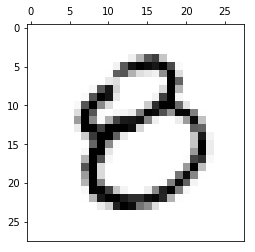

this is number
0
accuracy
0.518183180632


image


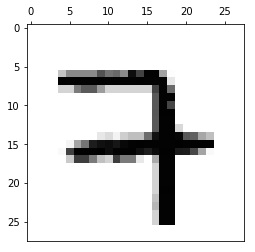

image


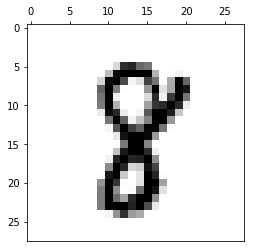

this is number
8
accuracy
0.380424556974


image


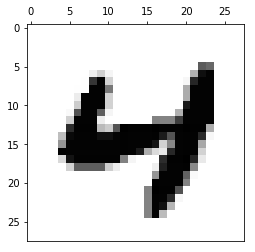

this is number
4
accuracy
0.584295009949


image


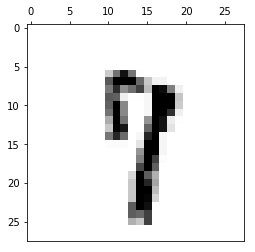

this is number
7
accuracy
0.331710169944


image


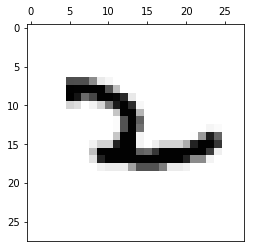

this is number
4
accuracy
0.374740862707


this is number
6
accuracy
0.387751076788


image


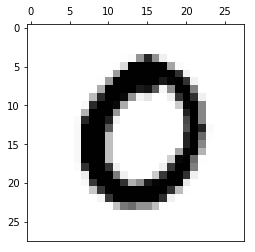

this is number
0
accuracy
0.872705234012


image


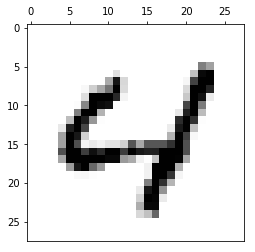

this is number
4
accuracy
0.494325054202


image


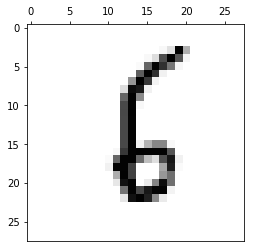

this is number
6
accuracy
0.358171941782


image


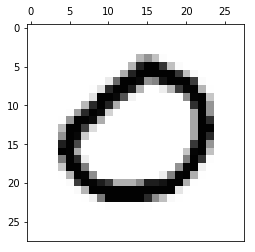

this is number
0
accuracy
0.889993539022


image


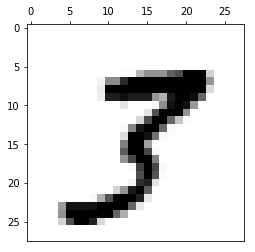

image


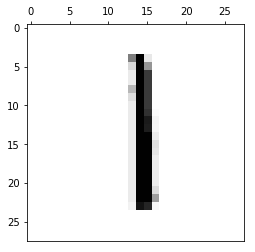

this is number
1
accuracy
0.678891563575


image


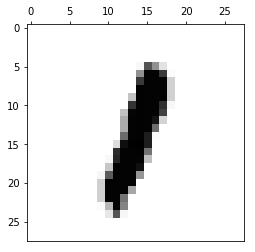

this is number
1
accuracy
0.776805976399


image


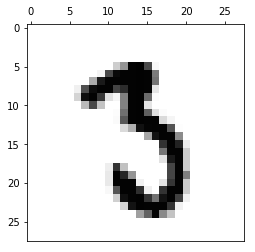

this is number
3
accuracy
0.31565444879


image


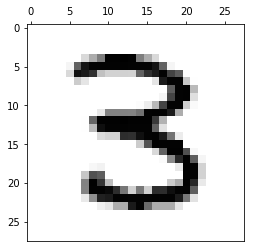

this is number
3
accuracy
0.652328906323


image


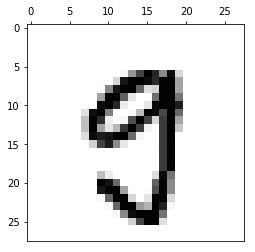

image


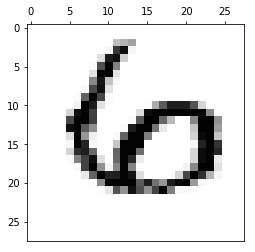

image


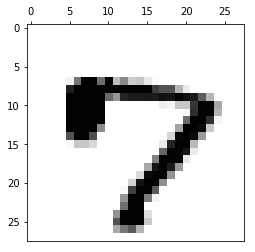

this is number
7
accuracy
0.676056227647


this is number
0
accuracy
0.406824984885


image


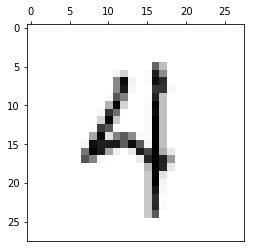

this is number
4
accuracy
0.43703348521


this is number
9
accuracy
0.415337902716


image


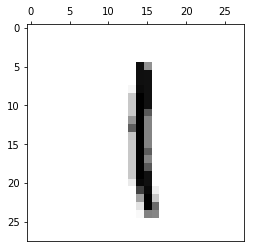

this is number
1
accuracy
0.731036577869


image


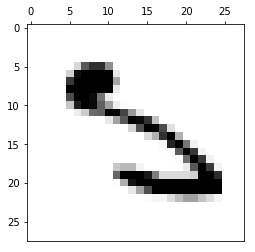

this is number
6
accuracy
0.336621904849


image


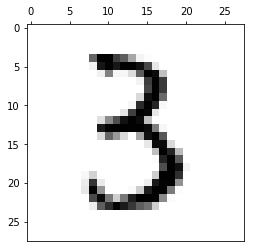

this is number
3
accuracy
0.733081444267


image


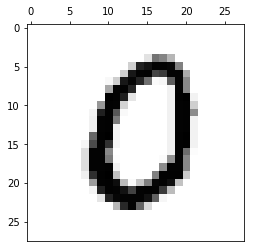

this is number
0
accuracy
0.693747339783


image


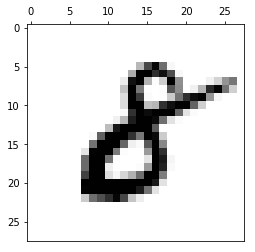

image


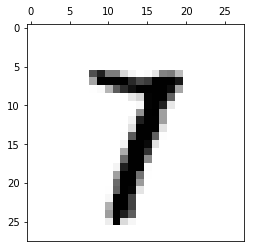

this is number
1
accuracy
0.515980461911


image


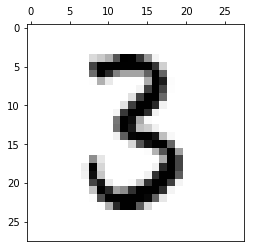

this is number
3
accuracy
0.612392122948


image


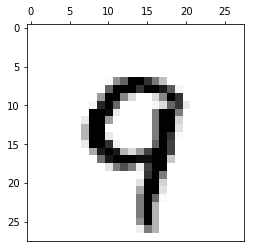

this is number
4
accuracy
0.319979003603


this is number
9
accuracy
0.530719971549


image


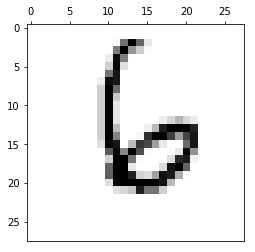

this is number
6
accuracy
0.789289312553


image


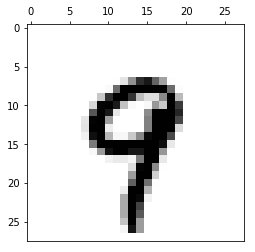

this is number
9
accuracy
0.517719090378


image


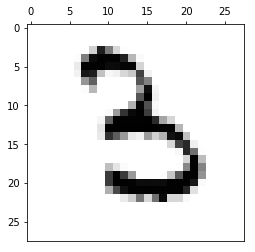

this is number
3
accuracy
0.483500457633


this is number
6
accuracy
0.380478901367


image


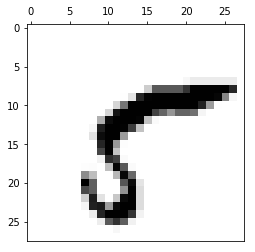

image


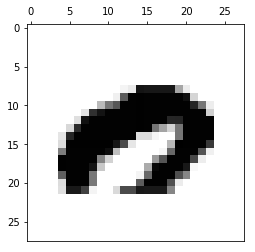

this is number
0
accuracy
0.383480200887


image


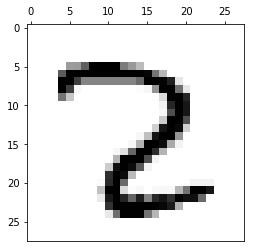

image


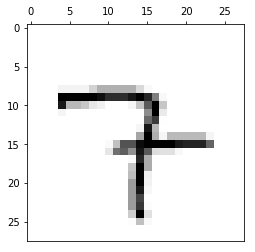

this is number
1
accuracy
0.301916827699


this is number
7
accuracy
0.41566975863


image


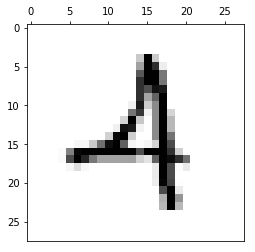

image


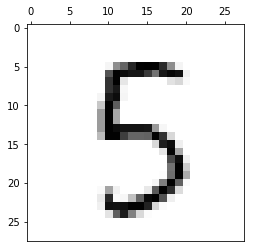

this is number
3
accuracy
0.501699402363


this is number
5
accuracy
0.451255759995


this is number
8
accuracy
0.376702110432


image


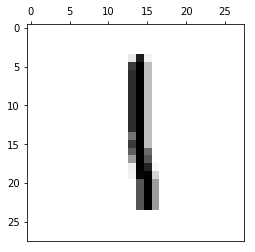

this is number
1
accuracy
0.669694851642


image


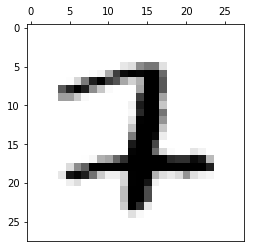

image


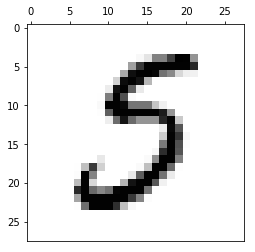

image


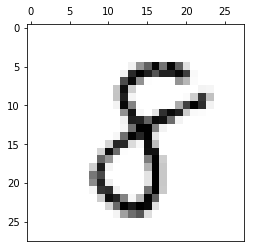

this is number
8
accuracy
0.558666010522


image


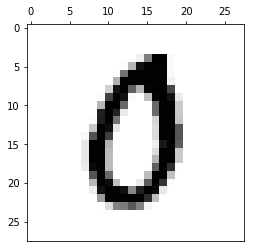

image


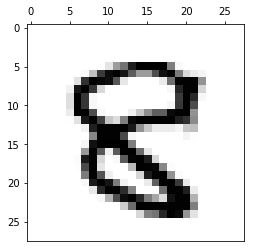

image


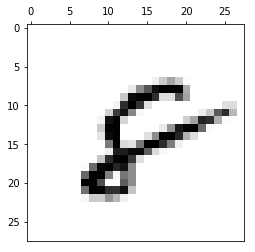

image


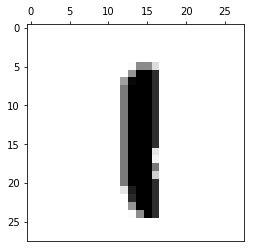

this is number
1
accuracy
0.629451590407


image


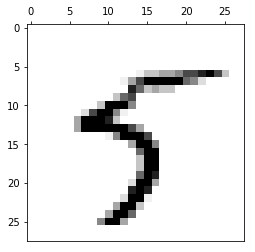

this is number
5
accuracy
0.36530885544


this is number
9
accuracy
0.313226456794


image


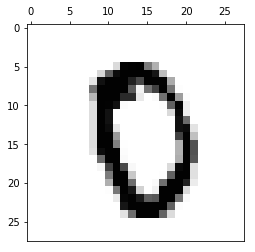

image


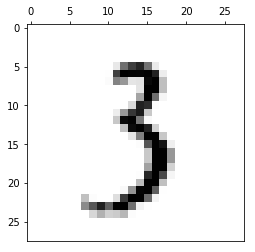

this is number
3
accuracy
0.489138393647


image


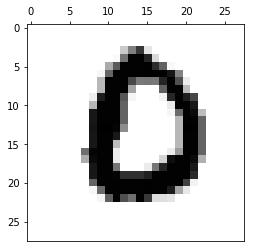

this is number
6
accuracy
0.370496244675


this is number
0
accuracy
0.649943246698


image


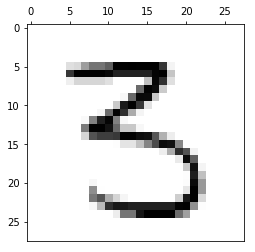

this is number
3
accuracy
0.387575970643


this is number
5
accuracy
0.341066659861


image


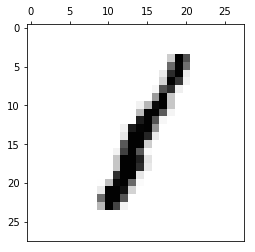

this is number
1
accuracy
0.769580612627


image


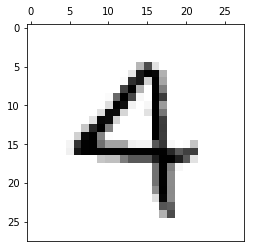

this is number
4
accuracy
0.363395446858


this is number
9
accuracy
0.349975340156


image


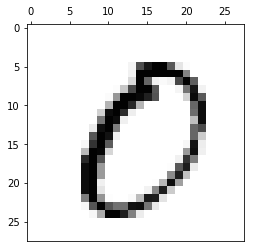

this is number
5
accuracy
0.385270313802


this is number
0
accuracy
0.810548781931


image


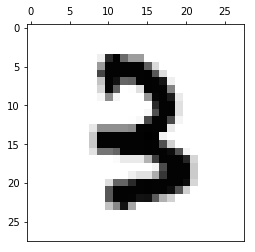

image


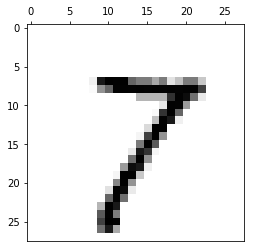

this is number
7
accuracy
0.56754578297


image


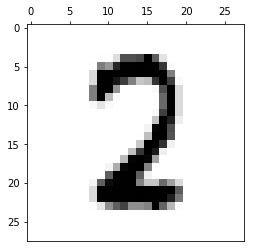

image


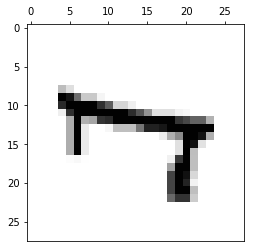

this is number
6
accuracy
0.359431145512


image


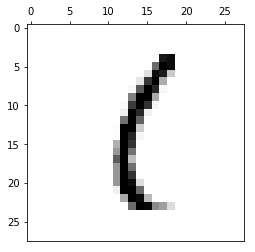

this is number
1
accuracy
0.605864575561


image


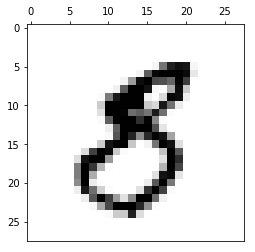

image


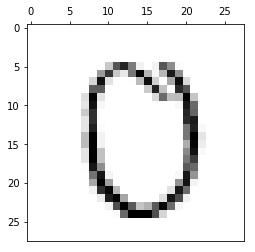

this is number
0
accuracy
0.711006317961


image


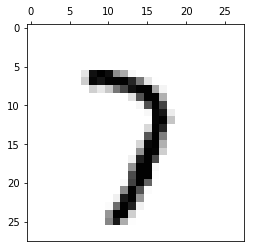

this is number
7
accuracy
0.550179136811


image


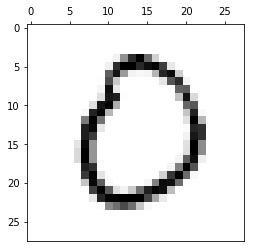

this is number
0
accuracy
0.836201014026


image


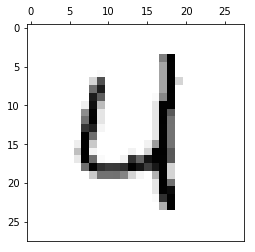

this is number
2
accuracy
0.305617062046


this is number
4
accuracy
0.423143684434


image


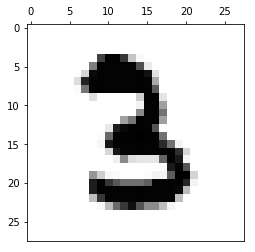

this is number
3
accuracy
0.412112414793


image


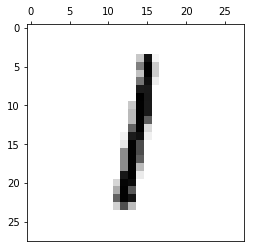

this is number
1
accuracy
0.810822864986


image


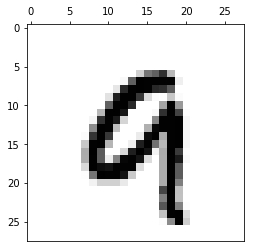

image


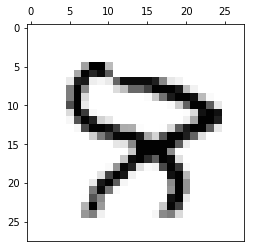

image


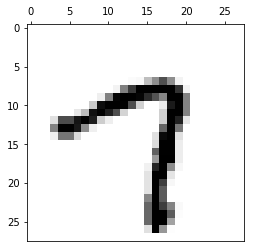

this is number
7
accuracy
0.641779233261


this is number
9
accuracy
0.510665216414


image


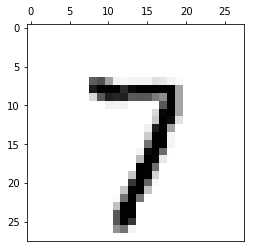

this is number
7
accuracy
0.797382947979


this is number
9
accuracy
0.326590113086


image


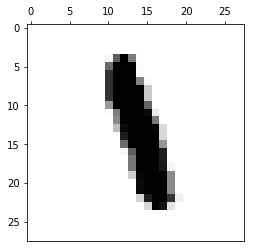

image


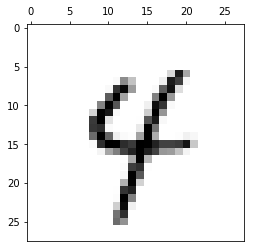

this is number
4
accuracy
0.373959867554


image


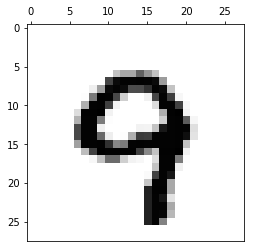

this is number
9
accuracy
0.446971863624


image


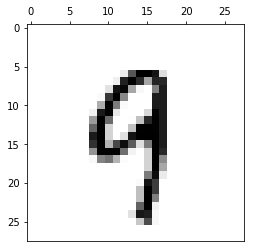

this is number
9
accuracy
0.49933962439


image


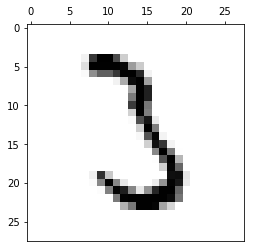

this is number
3
accuracy
0.552992412345


image


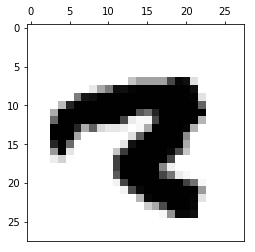

image


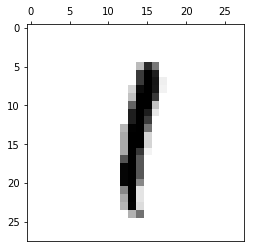

this is number
1
accuracy
0.825878725326


image


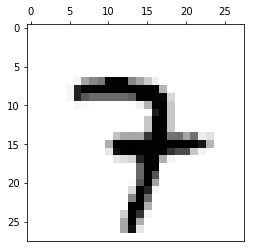

this is number
7
accuracy
0.401757295081


image


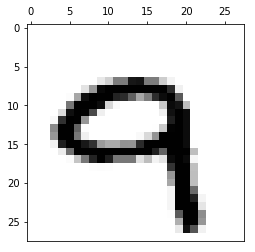

this is number
9
accuracy
0.30617448736


image


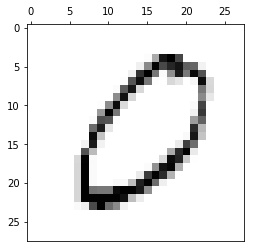

this is number
5
accuracy
0.392079085889


this is number
0
accuracy
0.741733626228


image


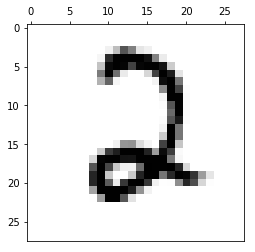

this is number
2
accuracy
0.784674831053


image


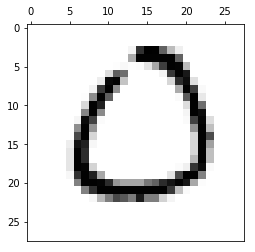

this is number
2
accuracy
0.31403296288


this is number
0
accuracy
0.853988829937


image


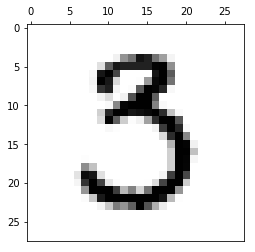

this is number
3
accuracy
0.477198253481


image


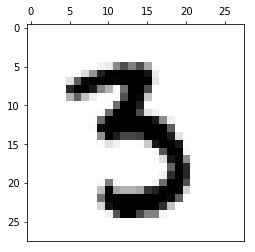

this is number
3
accuracy
0.565630393953


image


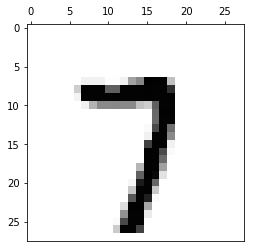

this is number
7
accuracy
0.805658899941


this is number
9
accuracy
0.340995302959


image


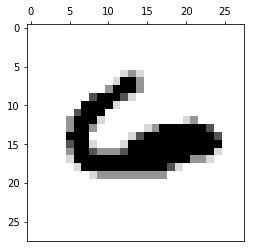

this is number
4
accuracy
0.401805668748


this is number
6
accuracy
0.427303913926


image


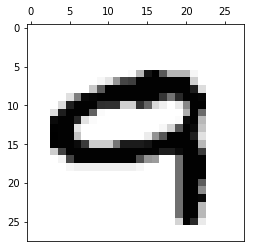

image


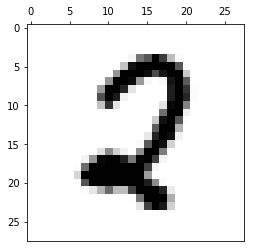

this is number
2
accuracy
0.451949151592


image


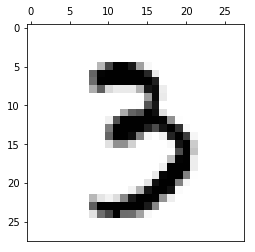

this is number
3
accuracy
0.825814478002


image


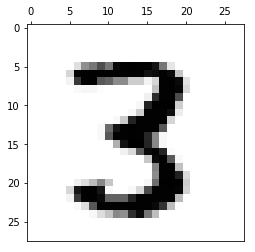

this is number
3
accuracy
0.770466810403


image


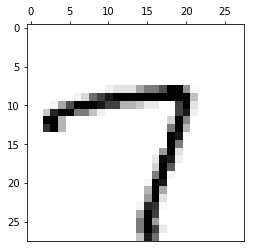

this is number
7
accuracy
0.748121959518


this is number
9
accuracy
0.301062994788


image


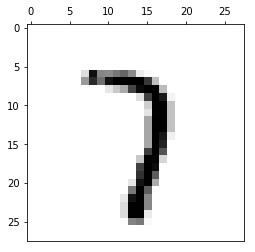

this is number
7
accuracy
0.490442134304


image


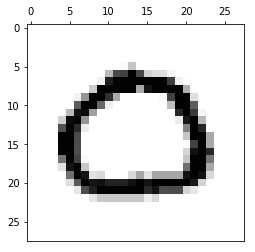

this is number
0
accuracy
0.78501151202


image


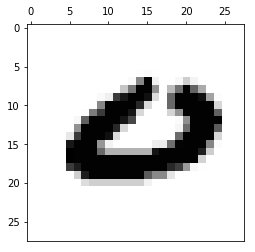

this is number
6
accuracy
0.347246600903


this is number
0
accuracy
0.575150956309


image


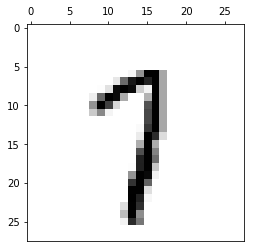

this is number
7
accuracy
0.375136148307


this is number
9
accuracy
0.320974000056


image


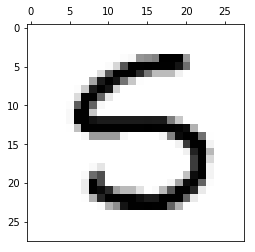

this is number
3
accuracy
0.351634230592


image


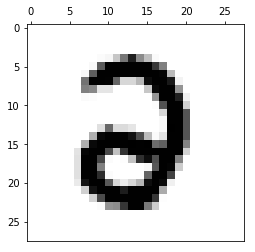

image


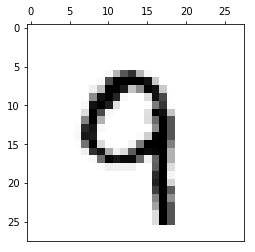

this is number
9
accuracy
0.462347434074


image


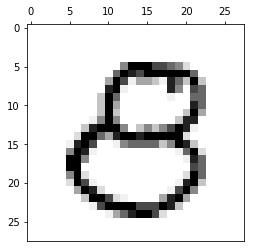

image


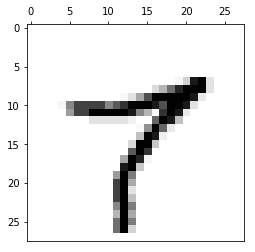

this is number
7
accuracy
0.49335224719


image


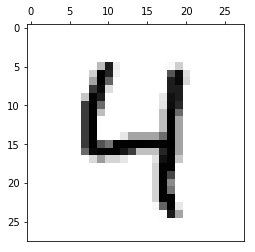

this is number
4
accuracy
0.675095942793


this is number
9
accuracy
0.302614733204


image


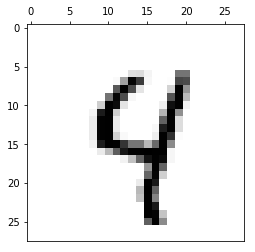

this is number
4
accuracy
0.529228839701


this is number
9
accuracy
0.484970449186


image


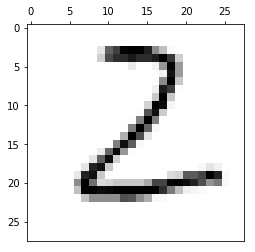

this is number
2
accuracy
0.523924218614


this is number
3
accuracy
0.324818676957


image


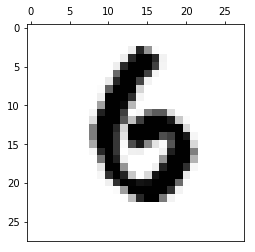

this is number
6
accuracy
0.561592118357


image


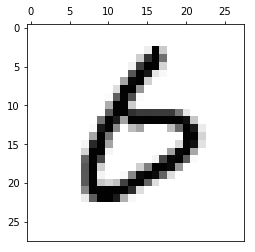

this is number
6
accuracy
0.397834340106


this is number
0
accuracy
0.3628710387


image


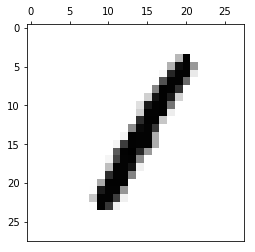

this is number
1
accuracy
0.694860389247


image


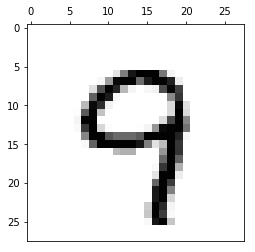

this is number
9
accuracy
0.446226228285


image


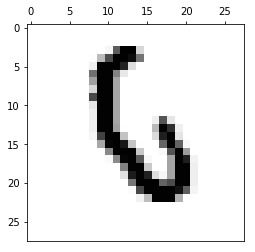

this is number
6
accuracy
0.426928363333


image


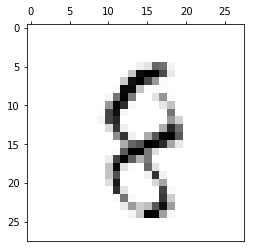

this is number
8
accuracy
0.368667731738


image


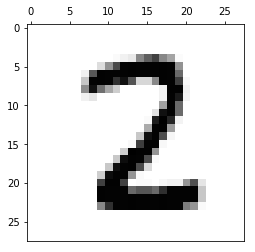

this is number
2
accuracy
0.347083235534


this is number
8
accuracy
0.302746679307


image


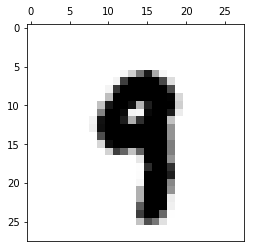

image


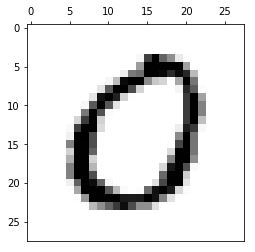

this is number
0
accuracy
0.909823049393


image


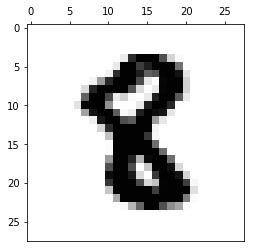

image


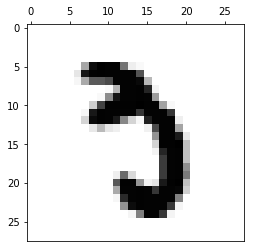

image


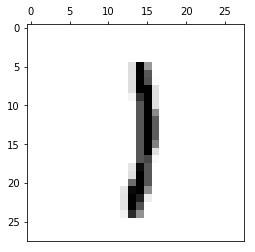

this is number
1
accuracy
0.619035209996


image


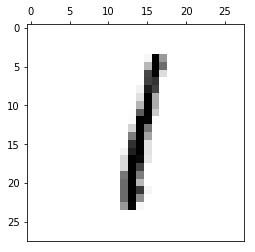

this is number
1
accuracy
0.806275458088


image


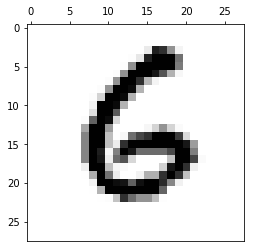

this is number
6
accuracy
0.575176309407


image


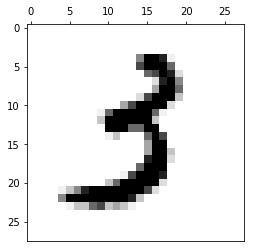

image


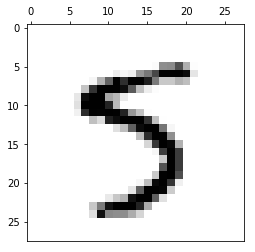

this is number
5
accuracy
0.335453859482


image


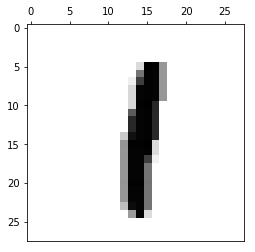

this is number
1
accuracy
0.769156344431


image


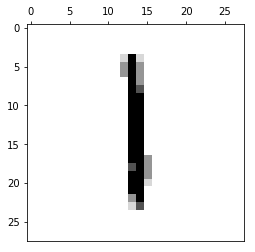

this is number
1
accuracy
0.72184483826


image


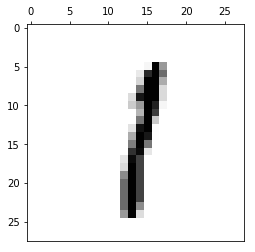

this is number
1
accuracy
0.775959371437


image


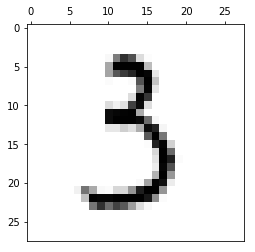

this is number
3
accuracy
0.584730092683


this is number
5
accuracy
0.311690402563


image


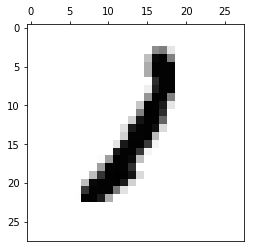

this is number
1
accuracy
0.666550919115


this is number
2
accuracy
0.358287977316


image


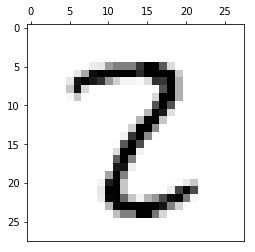

this is number
3
accuracy
0.367189513794


this is number
8
accuracy
0.449433336047


image


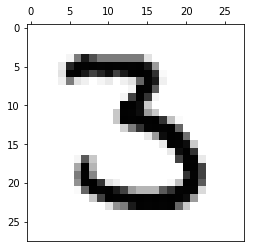

this is number
3
accuracy
0.68885578757


image


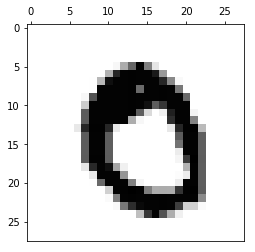

this is number
0
accuracy
0.449722843911


image


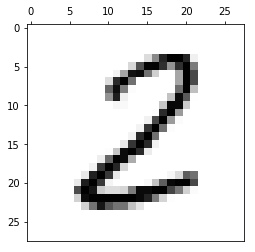

this is number
2
accuracy
0.329263408191


this is number
8
accuracy
0.518678455152


image


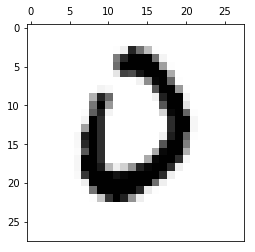

this is number
2
accuracy
0.332119929848


image


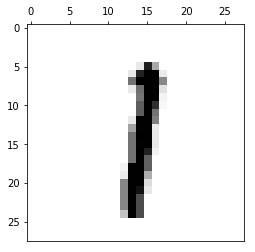

this is number
1
accuracy
0.750839917052


image


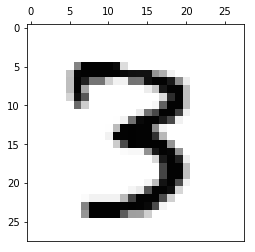

this is number
3
accuracy
0.751274947869


image


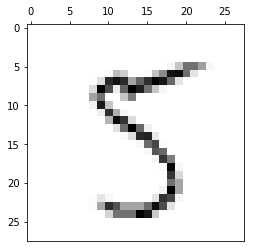

this is number
3
accuracy
0.303857118178


this is number
5
accuracy
0.465762827545


this is number
8
accuracy
0.415897867687


image


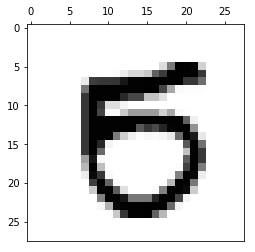

image


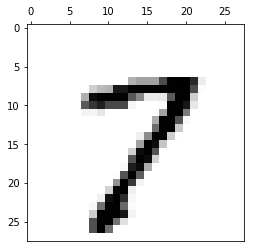

this is number
7
accuracy
0.737700364375


image


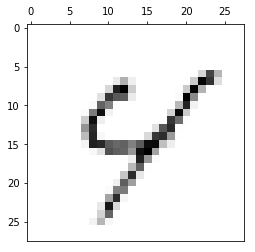

this is number
4
accuracy
0.530655574952


this is number
9
accuracy
0.398357025043


image


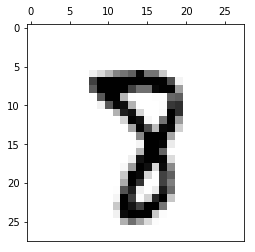

image


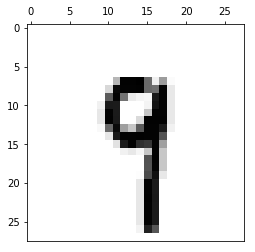

this is number
9
accuracy
0.429194758115


image


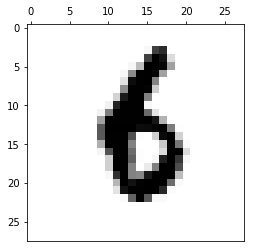

this is number
6
accuracy
0.446540726155


image


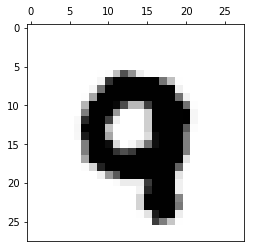

image


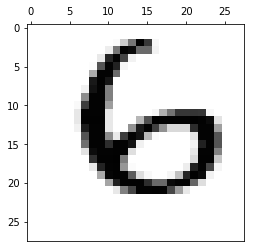

this is number
6
accuracy
0.605762854316


image


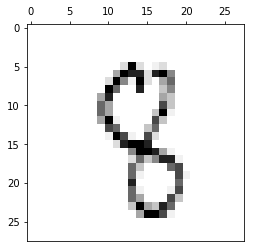

image


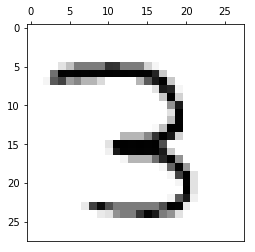

this is number
2
accuracy
0.336522827185


this is number
3
accuracy
0.355304558659


image


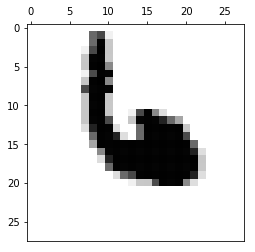

this is number
4
accuracy
0.431170038333


this is number
6
accuracy
0.347872691036


image


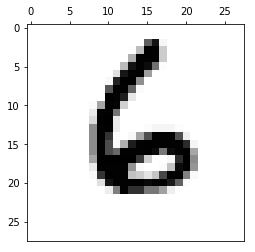

this is number
6
accuracy
0.794077616129


image


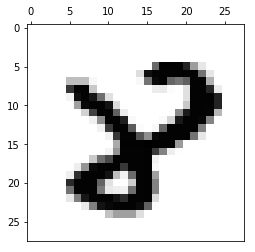

this is number
8
accuracy
0.347420286822


image


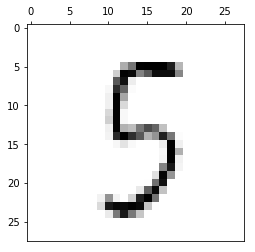

this is number
3
accuracy
0.495090496356


this is number
5
accuracy
0.396869883335


this is number
8
accuracy
0.448168004218


image


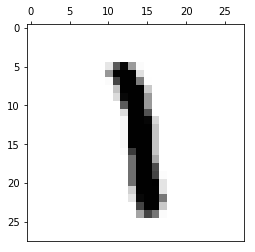

this is number
1
accuracy
0.478560880665


image


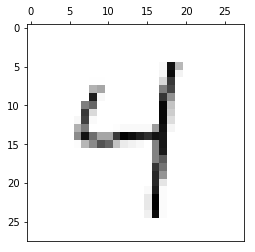

this is number
4
accuracy
0.539158393126


this is number
9
accuracy
0.441265194525


image


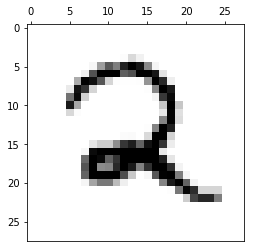

this is number
2
accuracy
0.790054898312


image


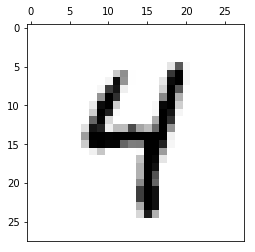

this is number
4
accuracy
0.527933319395


this is number
9
accuracy
0.392897520502


image


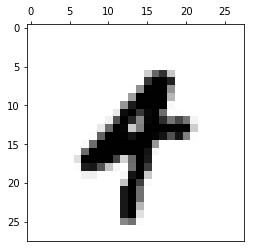

image


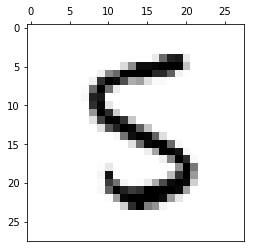

this is number
3
accuracy
0.329368540228


this is number
5
accuracy
0.316020942295


image


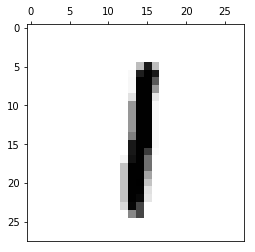

this is number
1
accuracy
0.798231729621


image


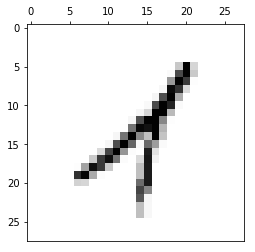

this is number
4
accuracy
0.313897943031


image


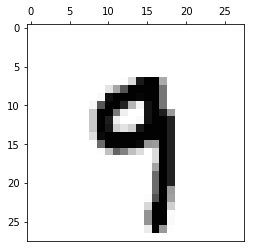

this is number
9
accuracy
0.490499946134


image


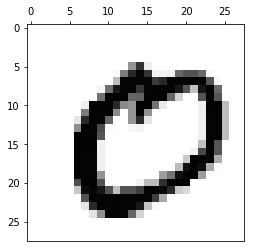

this is number
5
accuracy
0.304148185984


this is number
0
accuracy
0.800691372968


image


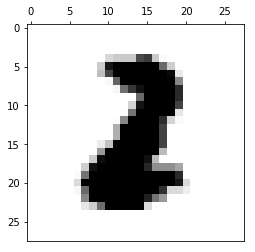

image


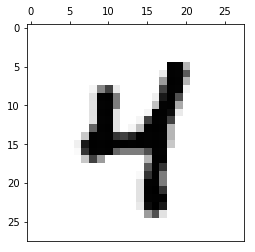

this is number
4
accuracy
0.632205668915


this is number
9
accuracy
0.324631261082


image


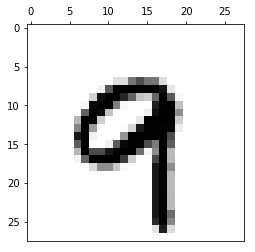

this is number
9
accuracy
0.482497366131


image


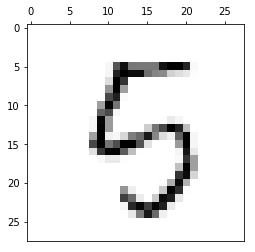

image


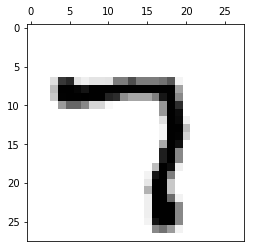

this is number
7
accuracy
0.696303261071


this is number
9
accuracy
0.330849876131


image


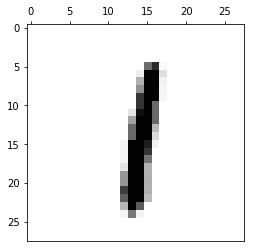

this is number
1
accuracy
0.8035570898


image


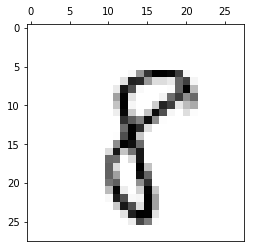

this is number
8
accuracy
0.483206481697


image


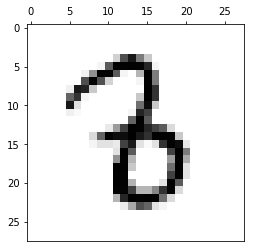

this is number
3
accuracy
0.401432063955


image


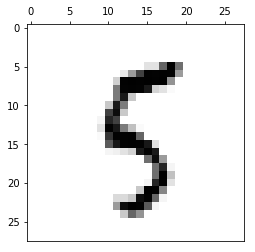

this is number
5
accuracy
0.340061029576


this is number
8
accuracy
0.369532859877


image


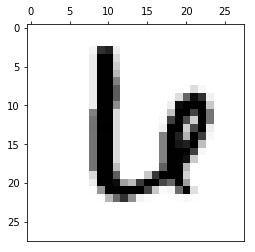

this is number
6
accuracy
0.628925339636


this is number
0
accuracy
0.505313347743


image


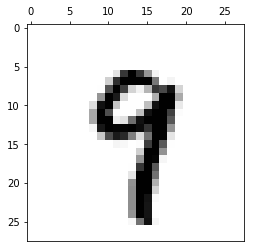

this is number
9
accuracy
0.315626764877


image


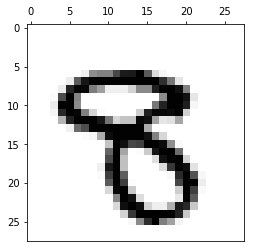

image


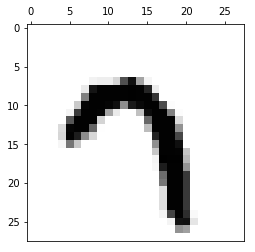

this is number
7
accuracy
0.481490082135


this is number
9
accuracy
0.35457571464


image


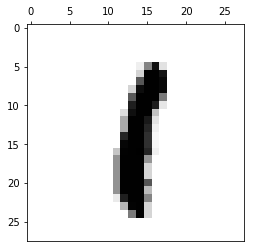

this is number
1
accuracy
0.782033346356


image


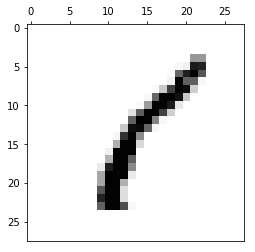

this is number
1
accuracy
0.55558653046


this is number
8
accuracy
0.448925157123


image


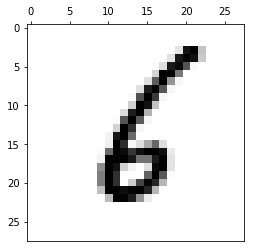

image


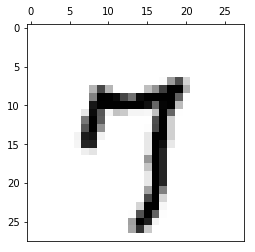

this is number
4
accuracy
0.306299811149


this is number
7
accuracy
0.619356290518


this is number
9
accuracy
0.381005345632


image


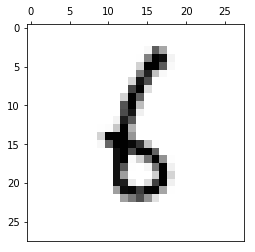

this is number
6
accuracy
0.464586266578


image


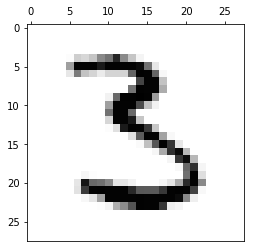

this is number
3
accuracy
0.434625373051


this is number
5
accuracy
0.337133082377


image


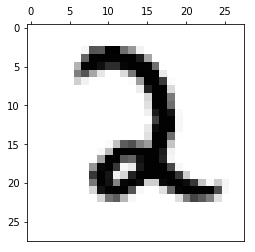

this is number
2
accuracy
0.750903615005


image


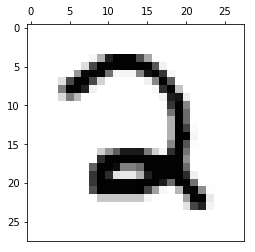

this is number
2
accuracy
0.795018109999


image


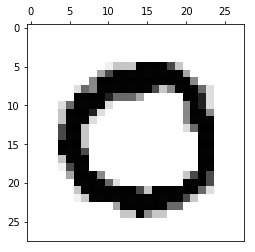

this is number
0
accuracy
0.856770943869


image


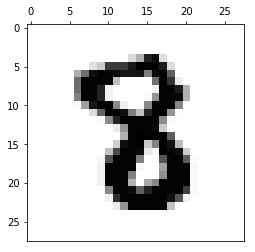

image


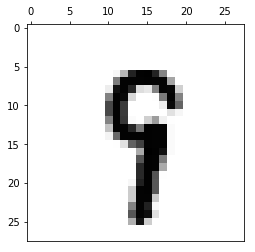

image


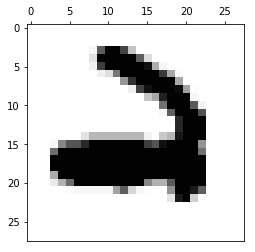

this is number
2
accuracy
0.792763065953


image


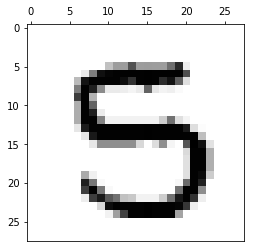

this is number
3
accuracy
0.332068786374


image


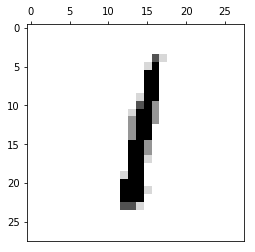

this is number
1
accuracy
0.823728297916


image


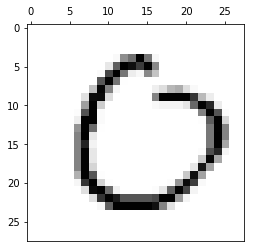

this is number
0
accuracy
0.712428645571


image


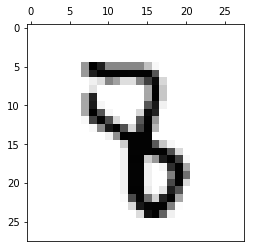

image


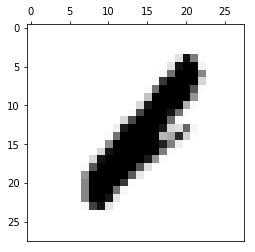

image


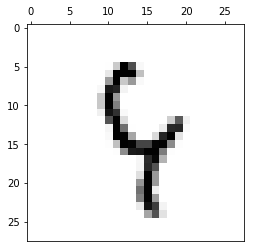

this is number
4
accuracy
0.364767591029


image


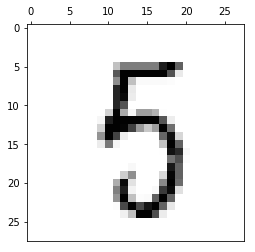

this is number
3
accuracy
0.451892227713


this is number
5
accuracy
0.372137997785


image


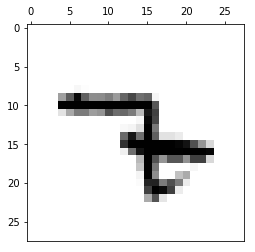

image


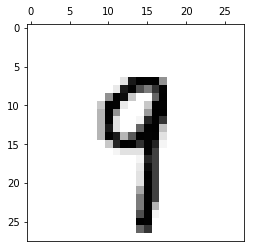

this is number
9
accuracy
0.440499069795


image


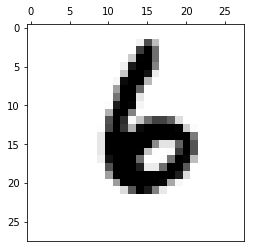

this is number
6
accuracy
0.707413536509


image


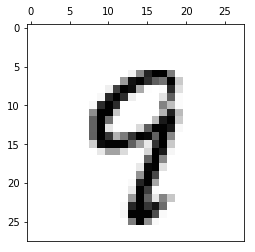

this is number
9
accuracy
0.573009810432


image


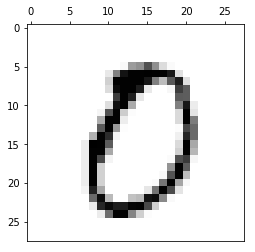

this is number
0
accuracy
0.707846328196


image


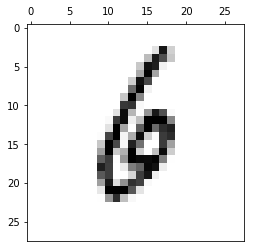

this is number
6
accuracy
0.325202586223


image


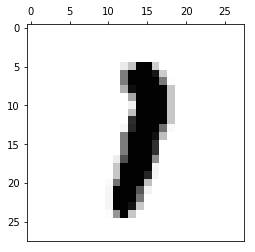

this is number
1
accuracy
0.561877729622


image


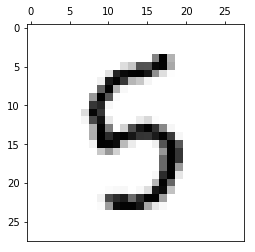

this is number
3
accuracy
0.359252508716


image


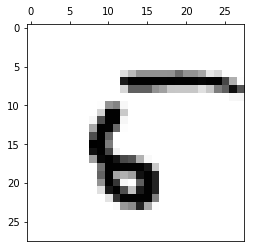

image


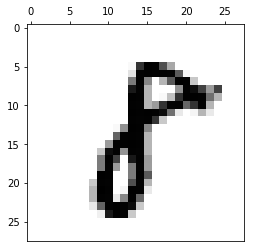

this is number
8
accuracy
0.384547949942


image


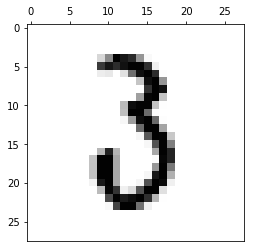

this is number
3
accuracy
0.351175416964


image


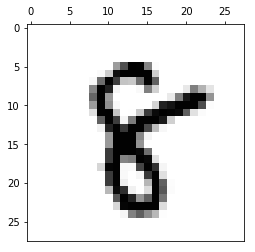

this is number
8
accuracy
0.502586287529


image


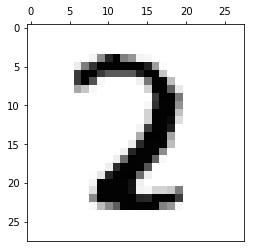

image


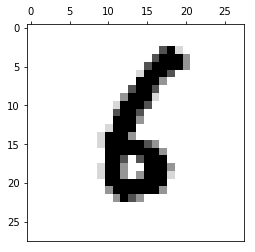

this is number
6
accuracy
0.407693938028


image


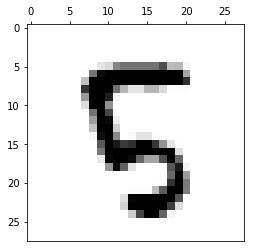

image


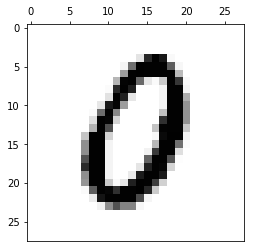

image


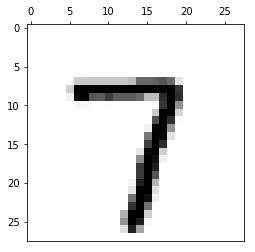

this is number
7
accuracy
0.773720027752


this is number
9
accuracy
0.32981296713


image


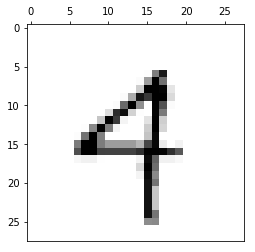

this is number
4
accuracy
0.403372469134


this is number
9
accuracy
0.330177196999


image


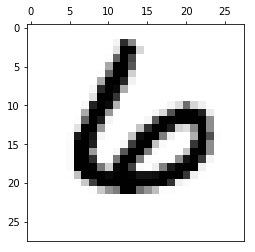

this is number
6
accuracy
0.48256467985


image


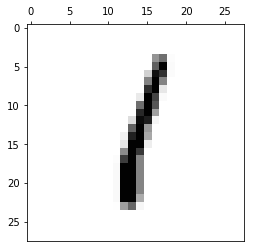

this is number
1
accuracy
0.825975944204


image


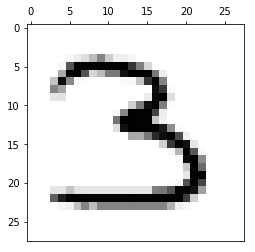

this is number
3
accuracy
0.849227429731


image


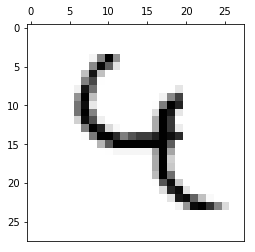

this is number
4
accuracy
0.643676205103


this is number
9
accuracy
0.424043292734


image


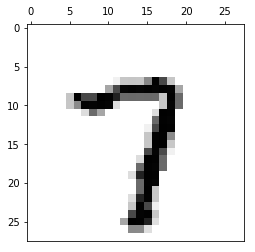

this is number
7
accuracy
0.773197165641


this is number
9
accuracy
0.450093081101


image


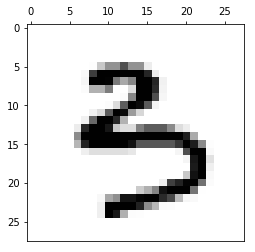

image


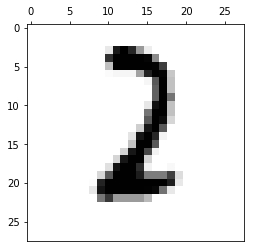

this is number
1
accuracy
0.306632815651


this is number
2
accuracy
0.393188744725


image


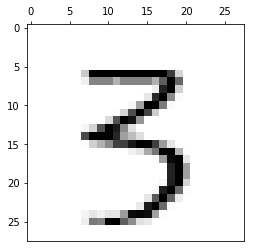

this is number
3
accuracy
0.497191586246


image


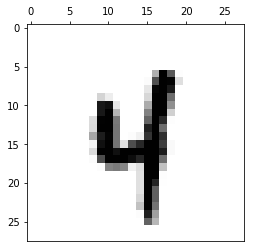

this is number
4
accuracy
0.433878456935


this is number
9
accuracy
0.308563773495


image


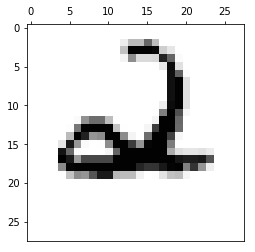

this is number
2
accuracy
0.369889172211


this is number
4
accuracy
0.53120213111


image


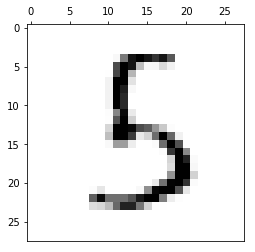

this is number
3
accuracy
0.601298220329


this is number
5
accuracy
0.444483508723


image


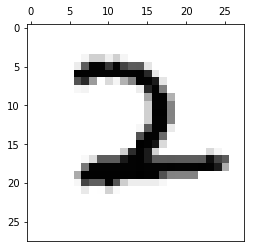

this is number
2
accuracy
0.713891223397


image


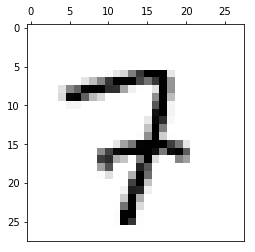

image


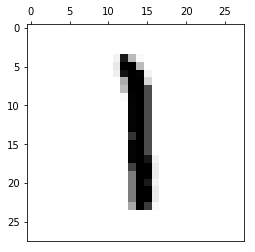

this is number
1
accuracy
0.711955110674


image


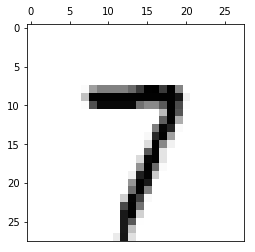

this is number
7
accuracy
0.844140896457


this is number
9
accuracy
0.313868266993


image


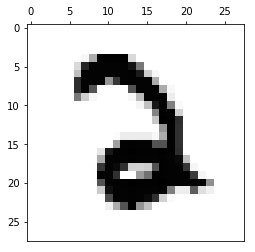

this is number
2
accuracy
0.372174439273


image


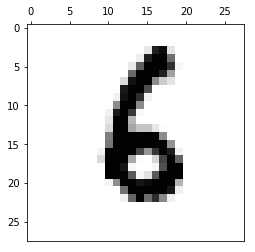

this is number
6
accuracy
0.497858811432


image


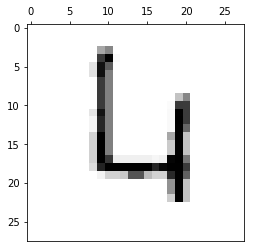

this is number
2
accuracy
0.378560317852


this is number
4
accuracy
0.386662494881


this is number
6
accuracy
0.571924596364


image


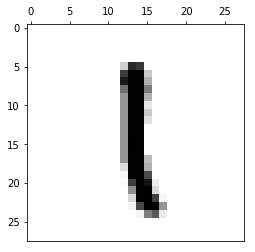

this is number
1
accuracy
0.623586891928


image


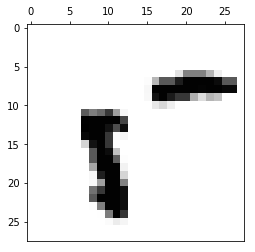

this is number
5
accuracy
0.476630857938


this is number
0
accuracy
0.569576057931


image


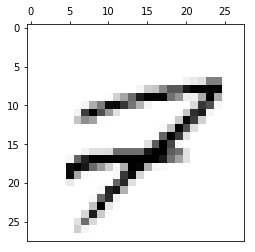

this is number
7
accuracy
0.311981212883


image


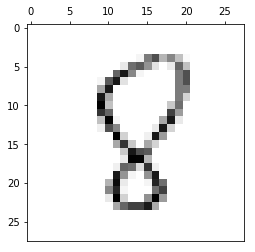

this is number
8
accuracy
0.387245828657


image


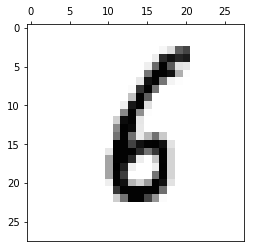

this is number
6
accuracy
0.302419458526


image


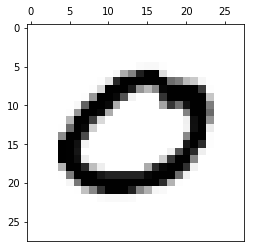

this is number
0
accuracy
0.839962229221


image


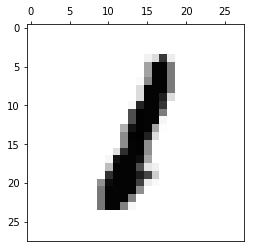

this is number
1
accuracy
0.771670221385


image


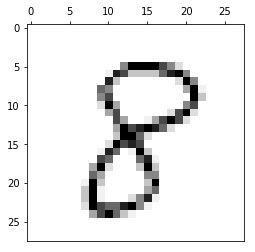

this is number
8
accuracy
0.639720711792


image


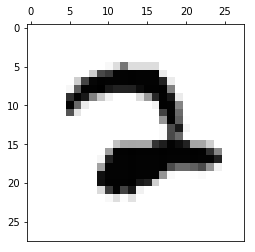

this is number
2
accuracy
0.403283583076


image


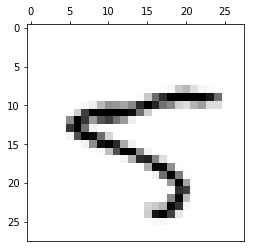

this is number
4
accuracy
0.491970358255


image


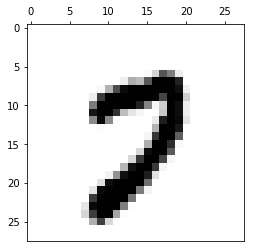

this is number
7
accuracy
0.58879833122


image


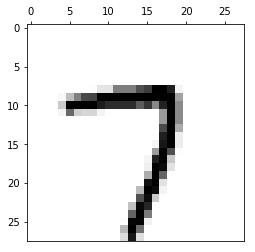

this is number
7
accuracy
0.82724601385


this is number
9
accuracy
0.314844754978


image


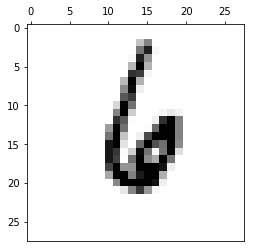

this is number
6
accuracy
0.599445964963


image


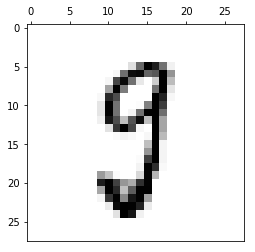

image


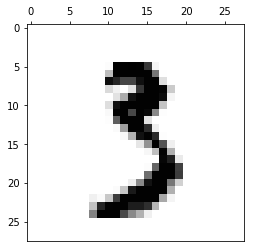

this is number
3
accuracy
0.504629752172


image


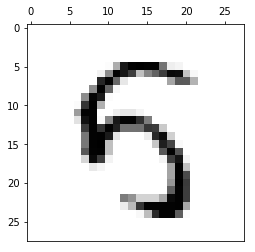

this is number
5
accuracy
0.306877628


image


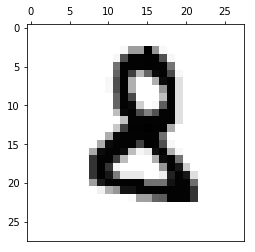

image


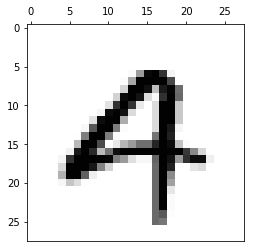

image


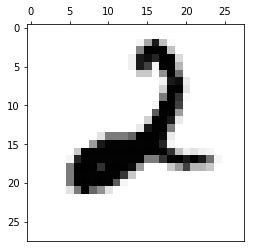

this is number
2
accuracy
0.698715831797


image


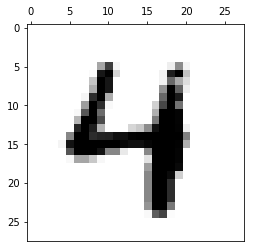

this is number
4
accuracy
0.678713539277


image


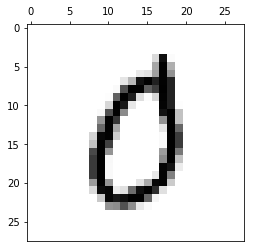

this is number
0
accuracy
0.355315296329


image


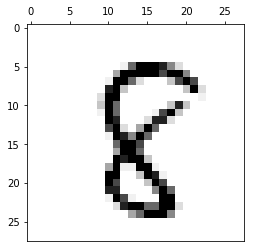

this is number
8
accuracy
0.627796967539


image


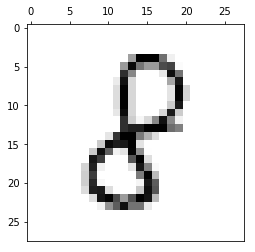

this is number
8
accuracy
0.37189310003


image


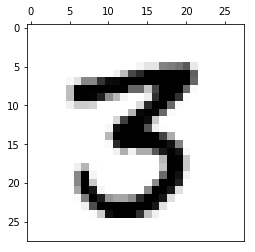

this is number
3
accuracy
0.507750205847


image


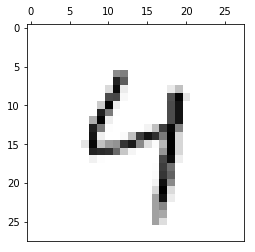

this is number
4
accuracy
0.576129564639


this is number
9
accuracy
0.487806173727


image


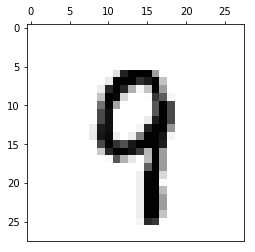

this is number
9
accuracy
0.472979091581


image


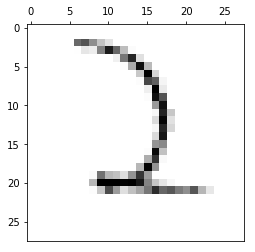

this is number
2
accuracy
0.487202603128


image


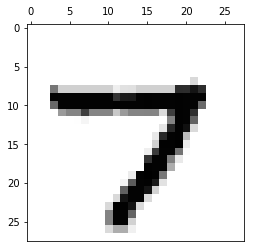

this is number
7
accuracy
0.855346215394


image


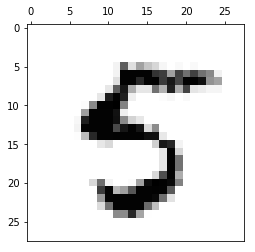

this is number
5
accuracy
0.547627202709


image


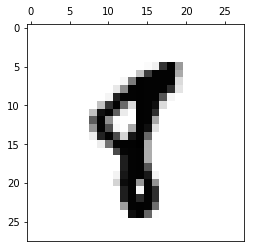

this is number
1
accuracy
0.324891581224


image


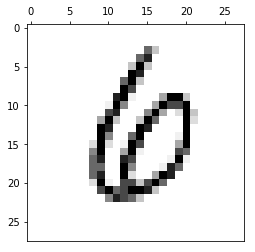

image


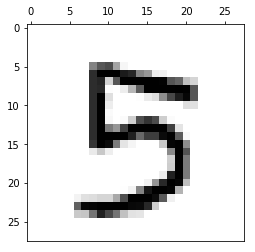

this is number
3
accuracy
0.472672200521


image


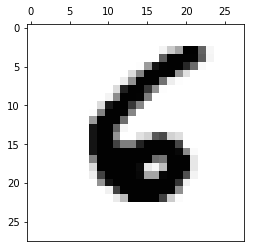

this is number
6
accuracy
0.550105909623


image


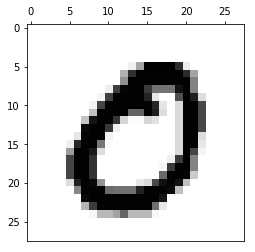

this is number
0
accuracy
0.896821772027


image


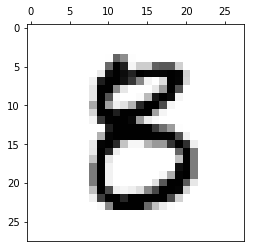

this is number
3
accuracy
0.361920151499


image


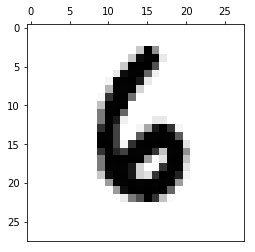

this is number
6
accuracy
0.649948313988


image


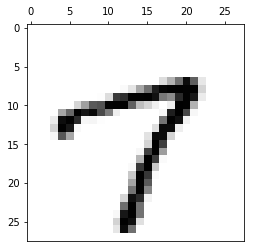

this is number
7
accuracy
0.790796168124


this is number
9
accuracy
0.32115010894


image


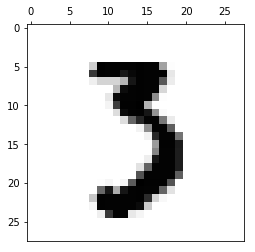

this is number
3
accuracy
0.433701330162


image


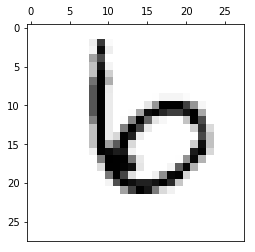

this is number
6
accuracy
0.460163423726


image


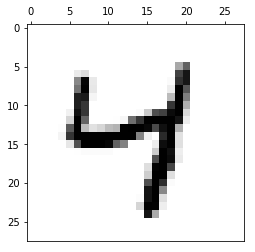

this is number
4
accuracy
0.535346933474


image


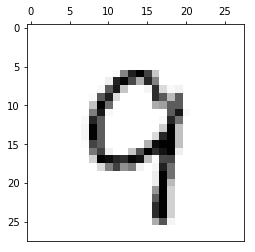

this is number
4
accuracy
0.329745367896


this is number
9
accuracy
0.404130350685


image


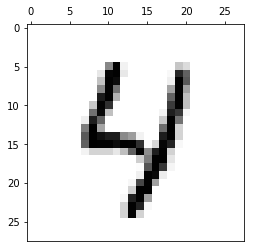

this is number
4
accuracy
0.587785393179


this is number
9
accuracy
0.305518516001


image


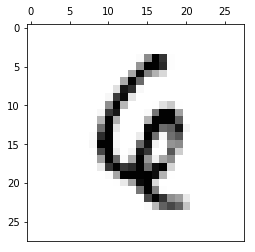

this is number
6
accuracy
0.325436962635


image


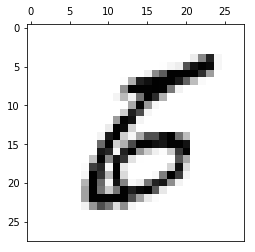

image


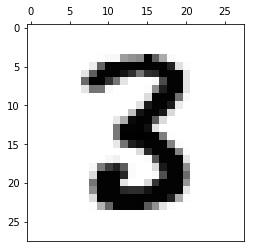

this is number
3
accuracy
0.531521478585


image


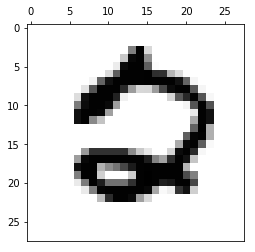

this is number
0
accuracy
0.423674280675


image


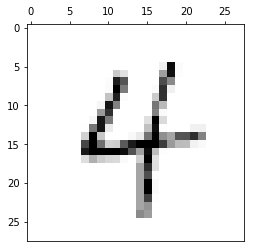

this is number
4
accuracy
0.547573312303


this is number
9
accuracy
0.351817304681


image


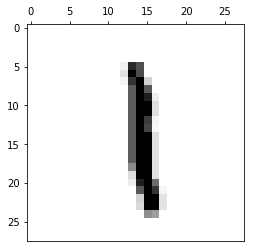

this is number
1
accuracy
0.70318689195


image


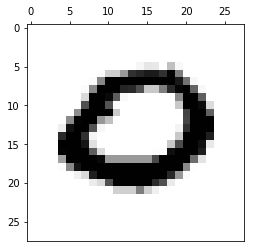

this is number
0
accuracy
0.711989490603


image


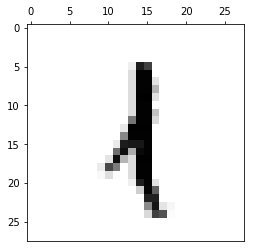

this is number
1
accuracy
0.727977656621


image


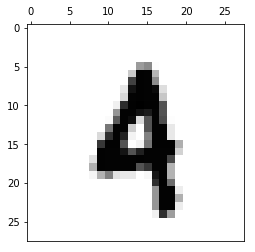

image


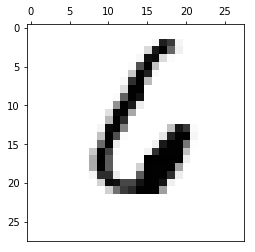

this is number
6
accuracy
0.801073836195


image


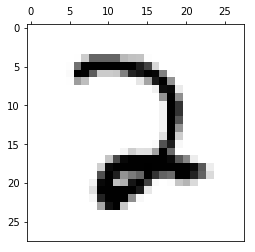

this is number
2
accuracy
0.662373154216


image


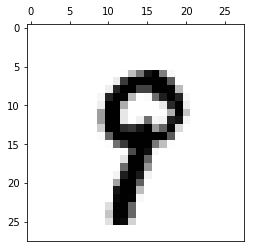

image


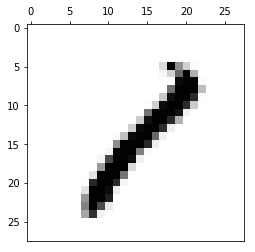

this is number
2
accuracy
0.349853748727


this is number
8
accuracy
0.585923258293


image


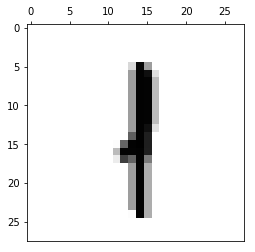

this is number
1
accuracy
0.78504575903


image


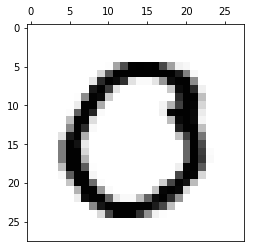

this is number
3
accuracy
0.304255587742


this is number
0
accuracy
0.807101891184


image


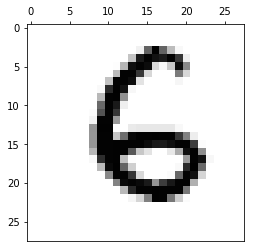

this is number
6
accuracy
0.682516518715


image


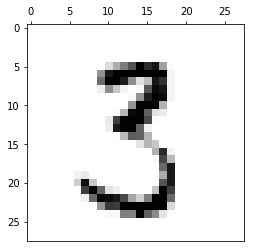

this is number
3
accuracy
0.725864437356


this is number
5
accuracy
0.31188062084


image


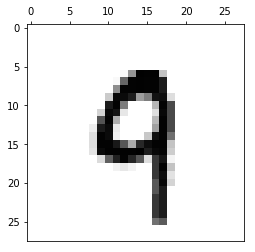

this is number
9
accuracy
0.510303096074


image


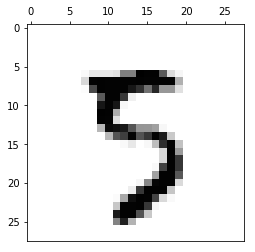

this is number
5
accuracy
0.33280429392


image


this is number
6
accuracy
0.695948522347


image


image


this is number
6
accuracy
0.707908520402


image


this is number
5
accuracy
0.334968055139


this is number
8
accuracy
0.365057773058


image


image


this is number
4
accuracy
0.425537292427


this is number
0
accuracy
0.403228558249


image


this is number
6
accuracy
0.333209959232


image


this is number
4
accuracy
0.417926911532


this is number
9
accuracy
0.352913374125


image


this is number
3
accuracy
0.497692784963


image


image


this is number
1
accuracy
0.441671801067


this is number
8
accuracy
0.303704291239


image


image


this is number
4
accuracy
0.457129836259


this is number
9
accuracy
0.329681698733


image


this is number
1
accuracy
0.5491338715


image


this is number
9
accuracy
0.52293692022


image


this is number
1
accuracy
0.666509167255


image


this is number
2
accuracy
0.48858973568


image


this is number
1
accuracy
0.714099881753


image


this is number
1
accuracy
0.416238320365


image


this is number
9
accuracy
0.464999622306


image


this is number
3
accuracy
0.771878372594


image


this is number
5
accuracy
0.308731994623


image


this is number
4
accuracy
0.622858487969


this is number
9
accuracy
0.38418384922


image


this is number
5
accuracy
0.398297885674


this is number
0
accuracy
0.682332700636


image


this is number
9
accuracy
0.460088049563


image


this is number
3
accuracy
0.442074606115


image


this is number
6
accuracy
0.700984195727


image


this is number
1
accuracy
0.638578325048


image


this is number
8
accuracy
0.349392916955


image


this is number
5
accuracy
0.318918085411


image


this is number
5
accuracy
0.378165548545


image


this is number
3
accuracy
0.57795021834


image


this is number
3
accuracy
0.826004868962


image


this is number
0
accuracy
0.678780690661


image


this is number
1
accuracy
0.683708765889


image


image


this is number
7
accuracy
0.784700639475


image


image


image


this is number
6
accuracy
0.31932054534


image


image


this is number
1
accuracy
0.691091524767


image


this is number
0
accuracy
0.839079042861


image


this is number
8
accuracy
0.480006255066


image


this is number
7
accuracy
0.612026432913


image


this is number
3
accuracy
0.742211383632


image


this is number
4
accuracy
0.59903219055


this is number
9
accuracy
0.499186994011


image


this is number
0
accuracy
0.344227693886


image


this is number
7
accuracy
0.453492965046


image


this is number
9
accuracy
0.395973125241


image


image


this is number
1
accuracy
0.823743888357


image


image


image


image


this is number
2
accuracy
0.690170131982


image


image


image


image


this is number
7
accuracy
0.646021870393


this is number
9
accuracy
0.412185234864


image


this is number
0
accuracy
0.364935214698


image


image


this is number
6
accuracy
0.541408251395


image


this is number
1
accuracy
0.377300098987


this is number
7
accuracy
0.369881532663


image


this is number
5
accuracy
0.313746832553


this is number
9
accuracy
0.310233749956


image


image


this is number
6
accuracy
0.607857357316


image


this is number
0
accuracy
0.452702862423


image


this is number
4
accuracy
0.392401334541


image


this is number
3
accuracy
0.602893025676


image


this is number
9
accuracy
0.303639320383


image


this is number
1
accuracy
0.542900983786


image


this is number
3
accuracy
0.659401615777


this is number
5
accuracy
0.302701529279


image


image


this is number
4
accuracy
0.585950769699


image


this is number
3
accuracy
0.517703464137


image


this is number
3
accuracy
0.713945230989


image


this is number
3
accuracy
0.31887036699


this is number
5
accuracy
0.376930263882


image


this is number
5
accuracy
0.408042669343


image


this is number
6
accuracy
0.531940597571


image


image


this is number
6
accuracy
0.304860294431


this is number
0
accuracy
0.652299891076


image


this is number
1
accuracy
0.482432728028


this is number
2
accuracy
0.358116658358


this is number
3
accuracy
0.393161225688


image


this is number
3
accuracy
0.770391471091


image


this is number
4
accuracy
0.659387042019


image


image


this is number
3
accuracy
0.489633607286


image


this is number
0
accuracy
0.799487405336


image


this is number
9
accuracy
0.438336243232


image


this is number
9
accuracy
0.363356773981


image


image


this is number
7
accuracy
0.456931574696


image


this is number
2
accuracy
0.461356831323


image


this is number
1
accuracy
0.31266075605


image


this is number
4
accuracy
0.314554947621


this is number
9
accuracy
0.366190457335


image


image


this is number
0
accuracy
0.839609880745


image


this is number
6
accuracy
0.631560896469


image


this is number
2
accuracy
0.375726899339


this is number
0
accuracy
0.806017078132


image


image


this is number
3
accuracy
0.524806473342


this is number
5
accuracy
0.320308257549


image


this is number
2
accuracy
0.543464894511


image


this is number
8
accuracy
0.564325436401


image


this is number
5
accuracy
0.411700703166


image


this is number
7
accuracy
0.631812583412


this is number
9
accuracy
0.387890221307


image


image


this is number
0
accuracy
0.845556656672


image


image


this is number
2
accuracy
0.336907854681


image


this is number
7
accuracy
0.323781718372


image


this is number
2
accuracy
0.395910004768


this is number
8
accuracy
0.611628976899


image


this is number
8
accuracy
0.478479787866


image


this is number
2
accuracy
0.544447209294


image


this is number
3
accuracy
0.325062175713


this is number
5
accuracy
0.330409911517


image


this is number
3
accuracy
0.469752316932


this is number
5
accuracy
0.484534678372


this is number
8
accuracy
0.327094023966


image


this is number
0
accuracy
0.562880841315


image


image


this is number
4
accuracy
0.304205156958


image


this is number
3
accuracy
0.359173930351


image


this is number
8
accuracy
0.519165696103


image


this is number
4
accuracy
0.319750408449


image


image


this is number
2
accuracy
0.570816336095


image


this is number
7
accuracy
0.528369093508


image


this is number
4
accuracy
0.681062650214


image


this is number
8
accuracy
0.322435395659


this is number
9
accuracy
0.358817660959


image


this is number
2
accuracy
0.818566224211


image


this is number
5
accuracy
0.426205206082


this is number
0
accuracy
0.911051658563


image


this is number
3
accuracy
0.860068675937


image


image


image


this is number
6
accuracy
0.360183976605


image


this is number
7
accuracy
0.681077349446


image


image


this is number
4
accuracy
0.361584877275


image


this is number
1
accuracy
0.620300978937


this is number
8
accuracy
0.349241857948


image


image


this is number
1
accuracy
0.821913740781


image


this is number
3
accuracy
0.306066219456


this is number
8
accuracy
0.566051312229


image


this is number
3
accuracy
0.790574796489


image


image


this is number
7
accuracy
0.765766586048


this is number
9
accuracy
0.324566216541


image


image


this is number
7
accuracy
0.319545919411


image


this is number
6
accuracy
0.32381900838


image


this is number
2
accuracy
0.359140381892


this is number
4
accuracy
0.545325368947


image


image


this is number
9
accuracy
0.393443614806


image


this is number
4
accuracy
0.337125501389


image


image


this is number
6
accuracy
0.637527372532


image


this is number
3
accuracy
0.313564909948


image


this is number
3
accuracy
0.315279784879


this is number
8
accuracy
0.311843678798


image


image


this is number
1
accuracy
0.82263676564


image


this is number
6
accuracy
0.416809416646


this is number
0
accuracy
0.861092555922


image


this is number
6
accuracy
0.628414104756


image


this is number
2
accuracy
0.570801267975


image


this is number
2
accuracy
0.561647921336


image


image


this is number
6
accuracy
0.748053274943


image


image


image


image


this is number
1
accuracy
0.77802882748


image


this is number
4
accuracy
0.674192331535


image


image


this is number
7
accuracy
0.8040231868


image


image


this is number
4
accuracy
0.484195487636


this is number
9
accuracy
0.347333257712


image


this is number
6
accuracy
0.533471199451


image


this is number
1
accuracy
0.576380429179


image


image


this is number
4
accuracy
0.559406576277


this is number
9
accuracy
0.305713210217


image


this is number
3
accuracy
0.461382699424


image


this is number
1
accuracy
0.7426121639


image


this is number
2
accuracy
0.698477348685


image


this is number
3
accuracy
0.305554692237


image


this is number
0
accuracy
0.930272049181


image


image


this is number
3
accuracy
0.471572038902


this is number
5
accuracy
0.305360706633


image


this is number
9
accuracy
0.317739327691


image


image


this is number
4
accuracy
0.425095064695


this is number
6
accuracy
0.465426381349


this is number
0
accuracy
0.360430443222


image


this is number
2
accuracy
0.623783325592


image


this is number
8
accuracy
0.365607346553


image


this is number
3
accuracy
0.498854851325


this is number
0
accuracy
0.454816700861


image


this is number
7
accuracy
0.807120334526


image


image


this is number
1
accuracy
0.573832302537


image


this is number
0
accuracy
0.451668442088


image


this is number
2
accuracy
0.418894835601


this is number
8
accuracy
0.518131393442


image


this is number
3
accuracy
0.581320395544


image


image


this is number
6
accuracy
0.795325004313


image


this is number
7
accuracy
0.68670822921


image


this is number
9
accuracy
0.449667716469


image


image


image


image


this is number
2
accuracy
0.428069707807


this is number
6
accuracy
0.330367649791


image


this is number
4
accuracy
0.402260518418


image


image


image


image


this is number
4
accuracy
0.35385711281


image


this is number
4
accuracy
0.535958052162


this is number
9
accuracy
0.415122116295


image


this is number
5
accuracy
0.358567335442


image


image


this is number
0
accuracy
0.300004372854


image


this is number
6
accuracy
0.671563777268


image


image


this is number
9
accuracy
0.49013528496


image


this is number
8
accuracy
0.563321493694


image


image


this is number
2
accuracy
0.333265147114


image


this is number
4
accuracy
0.33474983329


this is number
9
accuracy
0.441312118575


image


this is number
5
accuracy
0.317725022546


this is number
0
accuracy
0.828117436756


image


this is number
9
accuracy
0.333468776159


image


image


this is number
7
accuracy
0.867424807947


image


this is number
1
accuracy
0.659405571186


this is number
8
accuracy
0.354384178124


image


this is number
3
accuracy
0.498423754649


this is number
0
accuracy
0.37710020207


image


this is number
4
accuracy
0.553991325162


this is number
9
accuracy
0.327386170489


image


image


this is number
8
accuracy
0.36006023738


image


this is number
0
accuracy
0.765571809075


image


this is number
4
accuracy
0.375516704226


this is number
9
accuracy
0.559735261311


image


this is number
1
accuracy
0.770769422552


image


image


this is number
3
accuracy
0.7260241178


image


this is number
6
accuracy
0.785144254751


image


image


image


this is number
7
accuracy
0.613861719916


image


this is number
1
accuracy
0.576785032198


this is number
2
accuracy
0.346101958267


this is number
8
accuracy
0.366346964053


image


this is number
0
accuracy
0.858478465366


image


image


this is number
7
accuracy
0.518560556962


image


this is number
1
accuracy
0.786259114239


image


this is number
7
accuracy
0.812714417443


image


image


image


this is number
7
accuracy
0.731027269063


this is number
9
accuracy
0.314516135642


image


image


this is number
1
accuracy
0.715406365392


image


image


this is number
5
accuracy
0.331668328875


image


this is number
2
accuracy
0.598184850769


image


this is number
4
accuracy
0.749914742246


image


image


this is number
4
accuracy
0.581844003529


image


this is number
7
accuracy
0.645168099803


this is number
9
accuracy
0.307427514521


image


this is number
2
accuracy
0.410395790316


image


this is number
2
accuracy
0.463289722606


image


this is number
3
accuracy
0.54961303547


image


this is number
2
accuracy
0.303065855483


this is number
4
accuracy
0.628582354006


image


this is number
9
accuracy
0.364502625666


image


this is number
1
accuracy
0.696373241439


image


this is number
9
accuracy
0.455423104841


image


this is number
2
accuracy
0.558747654257


image


this is number
1
accuracy
0.706395414709


image


this is number
7
accuracy
0.625179554763


this is number
9
accuracy
0.358976092363


image


image


this is number
4
accuracy
0.550717344847


this is number
6
accuracy
0.365759140651


image


this is number
4
accuracy
0.415675481635


this is number
9
accuracy
0.302455560697


image


this is number
6
accuracy
0.387316392725


image


this is number
6
accuracy
0.786070841813


image


this is number
7
accuracy
0.434670217833


image


this is number
1
accuracy
0.538624526398


image


this is number
7
accuracy
0.743077662194


image


image


this is number
0
accuracy
0.358208663952


image


this is number
1
accuracy
0.71353490657


image


this is number
9
accuracy
0.463943453641


image


this is number
7
accuracy
0.770631859976


this is number
9
accuracy
0.450871790687


image


this is number
1
accuracy
0.561263005651


image


this is number
1
accuracy
0.752162331847


image


this is number
7
accuracy
0.834181947376


image


this is number
3
accuracy
0.571143481913


this is number
5
accuracy
0.326808690786


this is number
8
accuracy
0.329740624835


image


this is number
3
accuracy
0.464205383567


image


this is number
3
accuracy
0.593174020533


image


image


this is number
1
accuracy
0.829164273731


image


this is number
3
accuracy
0.702981736487


this is number
5
accuracy
0.328649288997


image


this is number
7
accuracy
0.716660037506


image


this is number
6
accuracy
0.377053553556


image


this is number
1
accuracy
0.644610944586


image


this is number
3
accuracy
0.543462587284


image


this is number
8
accuracy
0.381788575429


image


this is number
7
accuracy
0.518304809765


this is number
9
accuracy
0.316761470973


image


image


this is number
9
accuracy
0.384412088015


image


this is number
2
accuracy
0.372371222555


this is number
6
accuracy
0.461354716201


this is number
0
accuracy
0.370127799526


image


this is number
3
accuracy
0.390832048052


this is number
0
accuracy
0.662126474506


image


this is number
2
accuracy
0.306513155158


this is number
0
accuracy
0.796276494268


image


this is number
2
accuracy
0.332390425514


image


image


image


this is number
7
accuracy
0.323330112472


image


image


this is number
7
accuracy
0.658788435128


image


this is number
1
accuracy
0.725891302077


image


this is number
3
accuracy
0.692346213062


image


this is number
0
accuracy
0.869619774082


image


image


this is number
4
accuracy
0.488660449851


image


this is number
4
accuracy
0.524308635167


this is number
9
accuracy
0.387622895101


image


image


this is number
8
accuracy
0.367508755782


image


this is number
9
accuracy
0.405719150425


image


this is number
2
accuracy
0.377118973277


image


this is number
3
accuracy
0.483085556025


image


this is number
9
accuracy
0.345398260311


image


this is number
7
accuracy
0.510932297508


image


this is number
1
accuracy
0.752114423861


image


this is number
1
accuracy
0.740280744811


image


this is number
7
accuracy
0.624198368422


image


this is number
6
accuracy
0.433726802573


this is number
0
accuracy
0.76029021448


image


this is number
4
accuracy
0.359601324334


this is number
6
accuracy
0.32745437622


this is number
0
accuracy
0.309039508973


image


image


this is number
6
accuracy
0.748132892584


image


image


this is number
4
accuracy
0.305928852086


this is number
9
accuracy
0.527338829969


image


this is number
1
accuracy
0.670124411448


image


image


this is number
5
accuracy
0.352957699706


this is number
0
accuracy
0.610270561837


image


image


this is number
5
accuracy
0.473436764536


this is number
0
accuracy
0.844170514631


image


this is number
0
accuracy
0.865717429741


image


this is number
4
accuracy
0.687893925493


this is number
9
accuracy
0.342164220736


image


this is number
6
accuracy
0.653868178582


image


this is number
7
accuracy
0.84443498798


this is number
9
accuracy
0.374736527002


image


this is number
0
accuracy
0.595284072195


image


this is number
7
accuracy
0.361820069219


image


this is number
1
accuracy
0.735643658973


image


this is number
4
accuracy
0.675302092917


this is number
9
accuracy
0.356987824473


image


this is number
6
accuracy
0.421929047207


image


this is number
4
accuracy
0.634223160279


image


this is number
7
accuracy
0.307419245445


image


this is number
4
accuracy
0.725675923968


image


image


this is number
4
accuracy
0.334608305834


this is number
9
accuracy
0.328629344336


image


this is number
1
accuracy
0.740781531856


image


this is number
7
accuracy
0.644658665689


image


this is number
4
accuracy
0.31846620595


this is number
7
accuracy
0.371016119488


this is number
9
accuracy
0.494594723702


image


this is number
5
accuracy
0.308250396577


image


this is number
3
accuracy
0.577066227313


image


this is number
3
accuracy
0.338603732539


image


image


this is number
2
accuracy
0.705555924871


image


this is number
6
accuracy
0.343760628565


this is number
0
accuracy
0.545268428462


image


this is number
6
accuracy
0.738807416932


image


this is number
2
accuracy
0.400635675965


image


this is number
2
accuracy
0.556600733587


image


this is number
1
accuracy
0.665954714019


image


this is number
1
accuracy
0.567993589659


image


this is number
1
accuracy
0.833034383026


image


image


this is number
1
accuracy
0.829458245767


image


this is number
4
accuracy
0.328583117891


this is number
6
accuracy
0.714896609305


image


this is number
9
accuracy
0.363683942811


image


this is number
1
accuracy
0.337580872549


this is number
8
accuracy
0.313831918589


image


this is number
4
accuracy
0.460396990369


image


this is number
3
accuracy
0.66659889472


image


this is number
7
accuracy
0.495760944903


image


this is number
1
accuracy
0.683694136153


image


this is number
6
accuracy
0.591697477978


image


this is number
4
accuracy
0.643790688954


this is number
9
accuracy
0.386409301372


image


this is number
9
accuracy
0.359823806095


image


this is number
2
accuracy
0.397064372252


this is number
0
accuracy
0.677976046622


image


this is number
4
accuracy
0.368622057104


image


this is number
7
accuracy
0.64804347415


this is number
9
accuracy
0.426075794523


image


this is number
4
accuracy
0.642674060071


this is number
9
accuracy
0.393364243001


image


this is number
1
accuracy
0.404504616294


this is number
2
accuracy
0.323690445164


this is number
8
accuracy
0.381557717218


image


this is number
4
accuracy
0.556998857966


image


this is number
0
accuracy
0.633362239491


image


this is number
7
accuracy
0.407840725649


image


this is number
2
accuracy
0.345067185743


this is number
0
accuracy
0.469578884204


image


this is number
1
accuracy
0.8017858586


image


image


image


image


this is number
6
accuracy
0.710836057608


image


this is number
0
accuracy
0.485572001165


image


this is number
0
accuracy
0.805933227889


image


image


image


this is number
6
accuracy
0.618525463965


image


image


this is number
2
accuracy
0.320766321429


image


this is number
2
accuracy
0.726566078503


image


this is number
3
accuracy
0.748673249627


image


this is number
3
accuracy
0.343032751689


image


this is number
4
accuracy
0.313179581607


this is number
9
accuracy
0.418411954475


image


image


this is number
2
accuracy
0.317351908557


this is number
0
accuracy
0.431592559795


image


this is number
2
accuracy
0.37910610274


this is number
8
accuracy
0.602079011559


image


image


this is number
7
accuracy
0.818968325185


this is number
9
accuracy
0.328882950222


image


this is number
3
accuracy
0.435890454208


image


this is number
4
accuracy
0.696593358302


image


this is number
4
accuracy
0.617043723694


this is number
9
accuracy
0.45895589018


image


this is number
0
accuracy
0.726042559804


image


image


this is number
3
accuracy
0.726418633403


image


this is number
1
accuracy
0.369234717061


this is number
8
accuracy
0.316877324037


image


this is number
7
accuracy
0.776270517445


image


image


this is number
1
accuracy
0.787194772833


image


this is number
0
accuracy
0.422159699127


image


this is number
1
accuracy
0.804433565728


image


this is number
1
accuracy
0.35010642146


this is number
2
accuracy
0.695556395838


image


this is number
3
accuracy
0.449432018863


this is number
0
accuracy
0.350852592891


image


image


image


this is number
1
accuracy
0.742932527085


image


this is number
0
accuracy
0.772970518617


image


this is number
1
accuracy
0.790474541375


image


this is number
8
accuracy
0.358873122763


image


this is number
9
accuracy
0.308039544585


image


this is number
1
accuracy
0.549647199347


image


image


image


this is number
3
accuracy
0.652525910988


image


image


this is number
4
accuracy
0.375871632886


this is number
9
accuracy
0.474881275845


image


this is number
3
accuracy
0.611230101902


image


this is number
6
accuracy
0.756709624558


image


image


this is number
8
accuracy
0.312614984049


image


this is number
3
accuracy
0.42490269891


image


this is number
1
accuracy
0.329371483026


this is number
2
accuracy
0.476991879246


this is number
3
accuracy
0.303369690461


image


image


this is number
1
accuracy
0.458603954975


image


this is number
0
accuracy
0.851672111582


image


this is number
4
accuracy
0.415843946868


image


this is number
1
accuracy
0.334226148026


this is number
2
accuracy
0.54868436746


image


this is number
7
accuracy
0.355417733259


this is number
9
accuracy
0.367865546113


image


this is number
2
accuracy
0.516424629276


this is number
3
accuracy
0.540692521973


image


this is number
4
accuracy
0.548340394529


this is number
9
accuracy
0.309098980988


image


this is number
3
accuracy
0.437478427504


image


this is number
7
accuracy
0.797961097092


image


this is number
9
accuracy
0.54491446884


image


this is number
1
accuracy
0.722752843356


image


this is number
4
accuracy
0.338037553197


this is number
5
accuracy
0.300085436991


this is number
9
accuracy
0.321802787468


image


this is number
2
accuracy
0.645287073753


image


this is number
9
accuracy
0.352879710918


image


this is number
9
accuracy
0.418445905704


image


this is number
8
accuracy
0.35814139705


image


this is number
3
accuracy
0.333160289443


image


this is number
8
accuracy
0.407038892601


image


this is number
3
accuracy
0.466704010297


this is number
5
accuracy
0.311070152455


image


this is number
3
accuracy
0.560483043864


image


image


this is number
0
accuracy
0.595461279921


image


this is number
7
accuracy
0.314557288482


this is number
9
accuracy
0.393690849838


image


image


this is number
6
accuracy
0.83186634568


image


this is number
2
accuracy
0.538856286522


image


image


image


image


this is number
7
accuracy
0.640746892368


this is number
9
accuracy
0.438073617739


image


image


this is number
6
accuracy
0.749654561061


image


this is number
2
accuracy
0.315607341785


this is number
4
accuracy
0.388321639091


this is number
6
accuracy
0.748852500976


image


this is number
8
accuracy
0.436050363406


image


this is number
6
accuracy
0.558744817499


image


this is number
6
accuracy
0.607750083674


image


image


this is number
6
accuracy
0.714828520581


image


this is number
9
accuracy
0.354842593828


image


this is number
1
accuracy
0.317896763377


image


image


this is number
2
accuracy
0.328101832289


this is number
3
accuracy
0.304470741228


this is number
8
accuracy
0.459822949259


image


image


this is number
9
accuracy
0.389087727053


image


image


this is number
0
accuracy
0.726600188634


image


this is number
7
accuracy
0.513420834753


this is number
9
accuracy
0.306639420073


image


image


this is number
7
accuracy
0.743996638065


image


this is number
6
accuracy
0.711657823425


image


this is number
7
accuracy
0.665649416072


image


this is number
2
accuracy
0.34364022005


this is number
3
accuracy
0.384109730472


this is number
0
accuracy
0.793151085698


image


this is number
6
accuracy
0.858081971109


image


this is number
5
accuracy
0.439988533237


image


image


this is number
4
accuracy
0.535311898006


image


this is number
7
accuracy
0.608217264223


image


this is number
2
accuracy
0.687173944097


image


this is number
0
accuracy
0.710384085111


image


this is number
9
accuracy
0.426726833806


image


this is number
4
accuracy
0.33818406354


this is number
9
accuracy
0.626619646212


image


this is number
2
accuracy
0.54299162797


image


this is number
2
accuracy
0.441029535946


image


image


this is number
4
accuracy
0.685020064457


this is number
9
accuracy
0.311512209448


image


this is number
4
accuracy
0.591154958


this is number
9
accuracy
0.367384674333


image


this is number
1
accuracy
0.426740023901


this is number
2
accuracy
0.370190437869


image


this is number
3
accuracy
0.803793623051


image


this is number
3
accuracy
0.704104678041


image


this is number
2
accuracy
0.611933927939


image


this is number
1
accuracy
0.453944011293


image


this is number
7
accuracy
0.722334301999


image


this is number
0
accuracy
0.700646864844


image


image


this is number
2
accuracy
0.309790693596


this is number
4
accuracy
0.309240302145


this is number
6
accuracy
0.602989580561


image


this is number
4
accuracy
0.474884688437


this is number
9
accuracy
0.365393500368


image


this is number
1
accuracy
0.696885801662


this is number
8
accuracy
0.305907033842


image


this is number
3
accuracy
0.505890293552


image


image


image


this is number
4
accuracy
0.341224923293


image


image


image


this is number
2
accuracy
0.588735411261


image


this is number
5
accuracy
0.502875342832


image


this is number
1
accuracy
0.748812555343


image


image


this is number
7
accuracy
0.36142533669


image


this is number
3
accuracy
0.440395652179


image


this is number
4
accuracy
0.330648607218


this is number
7
accuracy
0.593731652


this is number
9
accuracy
0.32973192015


image


this is number
1
accuracy
0.721107879875


image


image


image


this is number
0
accuracy
0.653791283228


image


this is number
9
accuracy
0.304480281764


image


this is number
1
accuracy
0.819786360847


image


this is number
4
accuracy
0.423057565101


this is number
9
accuracy
0.306231453675


image


this is number
0
accuracy
0.873451963965


image


this is number
1
accuracy
0.407720379107


this is number
2
accuracy
0.333913004949


this is number
6
accuracy
0.530660472149


this is number
8
accuracy
0.335290546586


image


this is number
3
accuracy
0.430596047005


image


this is number
3
accuracy
0.309187168219


this is number
5
accuracy
0.32582755567


image


image


this is number
0
accuracy
0.849099740209


image


this is number
4
accuracy
0.472868202496


this is number
9
accuracy
0.378665257886


image


this is number
4
accuracy
0.30951943463


this is number
9
accuracy
0.493224913118


image


this is number
7
accuracy
0.471392707061


this is number
9
accuracy
0.324960849299


image


image


this is number
1
accuracy
0.722491351426


image


this is number
6
accuracy
0.328198001785


this is number
0
accuracy
0.587215954747


image


image


this is number
7
accuracy
0.326007556198


this is number
9
accuracy
0.506655786521


image


this is number
3
accuracy
0.380753472868


this is number
5
accuracy
0.306477073248


image


this is number
5
accuracy
0.408959548631


image


image


image


this is number
3
accuracy
0.302626623847


image


this is number
8
accuracy
0.331663951938


image


this is number
3
accuracy
0.540711544569


image


image


this is number
1
accuracy
0.798287652417


image


this is number
5
accuracy
0.337215708089


image


this is number
3
accuracy
0.823305845084


image


image


this is number
0
accuracy
0.345390960254


image


this is number
5
accuracy
0.385748696271


image


this is number
3
accuracy
0.581128167133


image


this is number
6
accuracy
0.399045503296


image


this is number
8
accuracy
0.580558368287


image


this is number
6
accuracy
0.340200973897


image


this is number
7
accuracy
0.78860281526


this is number
9
accuracy
0.331710179857


image


this is number
1
accuracy
0.433620564553


image


this is number
7
accuracy
0.732738288648


image


this is number
3
accuracy
0.403197355632


image


this is number
7
accuracy
0.813310452389


this is number
9
accuracy
0.321608821754


image


this is number
2
accuracy
0.389463923672


this is number
0
accuracy
0.747282137347


image


this is number
3
accuracy
0.39447932266


image


image


image


this is number
2
accuracy
0.434127801572


image


image


this is number
7
accuracy
0.313242033131


this is number
9
accuracy
0.302887779123


image


this is number
3
accuracy
0.488431815537


image


this is number
1
accuracy
0.703839946067


image


this is number
7
accuracy
0.566228752676


image


this is number
1
accuracy
0.358895812657


this is number
2
accuracy
0.34783546963


image


this is number
8
accuracy
0.412445731879


image


this is number
6
accuracy
0.650703031497


image


this is number
5
accuracy
0.34453871053


image


image


this is number
3
accuracy
0.706913028827


image


image


this is number
9
accuracy
0.432174135663


image


this is number
3
accuracy
0.348297065863


image


this is number
3
accuracy
0.548136626206


image


this is number
7
accuracy
0.719568087511


this is number
0
accuracy
0.439587850369


image


image


this is number
1
accuracy
0.727572446822


image


this is number
7
accuracy
0.74892357416


this is number
9
accuracy
0.336481735423


image


this is number
0
accuracy
0.916924881413


image


this is number
0
accuracy
0.834206430811


image


this is number
3
accuracy
0.498856071603


image


this is number
7
accuracy
0.799167718703


image


this is number
2
accuracy
0.616423197133


image


this is number
3
accuracy
0.402338629868


this is number
5
accuracy
0.44640642609


this is number
8
accuracy
0.39452234303


image


this is number
2
accuracy
0.316329396066


image


this is number
1
accuracy
0.728561889437


image


image


this is number
6
accuracy
0.671338397209


image


this is number
2
accuracy
0.587325701994


image


this is number
9
accuracy
0.428839310478


image


this is number
3
accuracy
0.511294107453


image


this is number
7
accuracy
0.636426344785


image


this is number
3
accuracy
0.309101737953


this is number
5
accuracy
0.443696578721


image


image


this is number
1
accuracy
0.318515880001


image


this is number
6
accuracy
0.514325489697


image


this is number
8
accuracy
0.742666113691


image


image


this is number
1
accuracy
0.541158671541


image


this is number
4
accuracy
0.72339064967


image


image


this is number
4
accuracy
0.56453858435


this is number
9
accuracy
0.352574196778


image


this is number
3
accuracy
0.477474562832


this is number
5
accuracy
0.402545178027


image


this is number
8
accuracy
0.423587975683


image


this is number
3
accuracy
0.733753558444


image


this is number
0
accuracy
0.721986129667


image


this is number
6
accuracy
0.328730317671


image


this is number
2
accuracy
0.487069948518


image


this is number
7
accuracy
0.497271993326


image


this is number
3
accuracy
0.676836712016


image


this is number
3
accuracy
0.460618530604


image


image


this is number
1
accuracy
0.769395502212


image


this is number
5
accuracy
0.343263888482


this is number
0
accuracy
0.818380007903


image


image


this is number
3
accuracy
0.600075354751


image


this is number
4
accuracy
0.534066962546


image


this is number
6
accuracy
0.461253878019


image


this is number
3
accuracy
0.766419918154


image


this is number
9
accuracy
0.325231126574


image


this is number
3
accuracy
0.711728314252


image


image


this is number
3
accuracy
0.318658006008


this is number
8
accuracy
0.39248221329


image


this is number
9
accuracy
0.393763540082


image


this is number
0
accuracy
0.854919807966


image


this is number
3
accuracy
0.546343650471


image


this is number
8
accuracy
0.462713550383


image


this is number
0
accuracy
0.787967086385


image


this is number
7
accuracy
0.483723725899


this is number
9
accuracy
0.431882032155


image


this is number
6
accuracy
0.732906038164


image


this is number
5
accuracy
0.388711050212


image


this is number
4
accuracy
0.564536600153


this is number
9
accuracy
0.464243978484


image


this is number
7
accuracy
0.680010863139


this is number
9
accuracy
0.313695384044


image


this is number
3
accuracy
0.456952134223


image


image


this is number
0
accuracy
0.495301974258


image


this is number
8
accuracy
0.471204000874


image


this is number
6
accuracy
0.306195612357


image


this is number
2
accuracy
0.325519113982


image


image


this is number
1
accuracy
0.354422593223


image


this is number
1
accuracy
0.818643065397


image


this is number
0
accuracy
0.594318984742


image


this is number
0
accuracy
0.865134244129


image


image


image


this is number
0
accuracy
0.627656879142


image


this is number
1
accuracy
0.82760083045


image


this is number
2
accuracy
0.577482946727


image


this is number
3
accuracy
0.376613793846


image


this is number
2
accuracy
0.753645634295


image


image


this is number
7
accuracy
0.76529609324


image


this is number
8
accuracy
0.619719170949


image


image


this is number
2
accuracy
0.88493831283


image


image


this is number
7
accuracy
0.43999431104


image


this is number
6
accuracy
0.701423328412


image


this is number
9
accuracy
0.487463907528


image


this is number
1
accuracy
0.648385652001


image


this is number
4
accuracy
0.491069682227


image


this is number
1
accuracy
0.748303427613


image


this is number
6
accuracy
0.722185487783


image


this is number
4
accuracy
0.459767334097


image


this is number
2
accuracy
0.705656326582


image


this is number
4
accuracy
0.535605315491


this is number
9
accuracy
0.344806401222


image


this is number
3
accuracy
0.352424753215


image


this is number
5
accuracy
0.373778563218


image


this is number
4
accuracy
0.484495336545


this is number
9
accuracy
0.442250565162


image


this is number
7
accuracy
0.308607124348


image


image


image


this is number
0
accuracy
0.732743788266


image


this is number
1
accuracy
0.684278778963


image


this is number
3
accuracy
0.478609532189


this is number
5
accuracy
0.399420209469


this is number
6
accuracy
0.348438139184


image


this is number
3
accuracy
0.318437473978


image


this is number
8
accuracy
0.301825053376


image


this is number
4
accuracy
0.31128261815


this is number
9
accuracy
0.471421229424


image


this is number
1
accuracy
0.797702546939


image


this is number
9
accuracy
0.575060216365


image


this is number
3
accuracy
0.360506478107


this is number
4
accuracy
0.346199765515


this is number
6
accuracy
0.449325032047


image


this is number
9
accuracy
0.431491405729


image


this is number
5
accuracy
0.31405439037


this is number
9
accuracy
0.374762609307


image


image


this is number
2
accuracy
0.423975249493


image


this is number
7
accuracy
0.675648205959


this is number
9
accuracy
0.355772194808


image


this is number
4
accuracy
0.552954942513


this is number
9
accuracy
0.448354694111


image


this is number
6
accuracy
0.619325885949


this is number
0
accuracy
0.483269033136


image


this is number
0
accuracy
0.80529006041


image


this is number
1
accuracy
0.701416829251


image


image


this is number
1
accuracy
0.712707367858


image


this is number
0
accuracy
0.908492387746


image


this is number
4
accuracy
0.392412225764


image


this is number
4
accuracy
0.321914467852


image


this is number
3
accuracy
0.3259179202


this is number
7
accuracy
0.598438494471


this is number
9
accuracy
0.425175495202


image


this is number
6
accuracy
0.483083936383


image


this is number
3
accuracy
0.685164951598


image


image


this is number
0
accuracy
0.914410693016


image


image


this is number
3
accuracy
0.414850941179


image


this is number
0
accuracy
0.843709254497


image


this is number
6
accuracy
0.451769191494


image


this is number
1
accuracy
0.735929981308


image


image


this is number
2
accuracy
0.303156245729


this is number
4
accuracy
0.304328068599


this is number
6
accuracy
0.468096076151


image


this is number
1
accuracy
0.461989729774


image


this is number
3
accuracy
0.548328204128


image


this is number
8
accuracy
0.427335627333


image


this is number
1
accuracy
0.775537818904


image


this is number
2
accuracy
0.630146559357


image


image


image


this is number
2
accuracy
0.747912081081


image


image


this is number
3
accuracy
0.546656444103


image


this is number
6
accuracy
0.508082895317


image


image


this is number
1
accuracy
0.700098007785


image


this is number
9
accuracy
0.448885566722


image


this is number
7
accuracy
0.603422512645


image


this is number
6
accuracy
0.746190157465


image


image


image


this is number
7
accuracy
0.304542521038


image


this is number
2
accuracy
0.585117754339


image


image


this is number
8
accuracy
0.395508626999


image


image


this is number
3
accuracy
0.477088926496


image


this is number
1
accuracy
0.764616966749


image


this is number
0
accuracy
0.653280468234


image


this is number
0
accuracy
0.470901408186


image


this is number
7
accuracy
0.429302527724


image


image


this is number
6
accuracy
0.474075287381


this is number
0
accuracy
0.501835598913


image


this is number
2
accuracy
0.708487003517


image


this is number
1
accuracy
0.480896084285


this is number
8
accuracy
0.479731574372


image


this is number
6
accuracy
0.754302822423


this is number
0
accuracy
0.686533300272


image


this is number
9
accuracy
0.477720980421


image


this is number
2
accuracy
0.30755083425


this is number
3
accuracy
0.352346449059


image


this is number
1
accuracy
0.724443090116


image


image


this is number
6
accuracy
0.82402973479


image


image


this is number
6
accuracy
0.574622574504


this is number
0
accuracy
0.768070724939


image


this is number
6
accuracy
0.49594222614


image


this is number
0
accuracy
0.707413938387


image


this is number
0
accuracy
0.457558372147


image


this is number
0
accuracy
0.885961058138


image


this is number
6
accuracy
0.459401307046


image


this is number
3
accuracy
0.752871594416


image


this is number
5
accuracy
0.462453884374


image


this is number
9
accuracy
0.326025242693


image


image


this is number
9
accuracy
0.349754205901


image


this is number
1
accuracy
0.335810632038


this is number
5
accuracy
0.353306880182


image


image


this is number
8
accuracy
0.59277283439


image


this is number
5
accuracy
0.302062898857


image


this is number
3
accuracy
0.414709013248


image


this is number
0
accuracy
0.835970056492


image


this is number
4
accuracy
0.35985828663


image


this is number
0
accuracy
0.844027488845


image


this is number
3
accuracy
0.395320784344


image


this is number
9
accuracy
0.436796869517


image


this is number
6
accuracy
0.58676218471


image


this is number
8
accuracy
0.535831121662


image


this is number
2
accuracy
0.375250909448


image


this is number
3
accuracy
0.705942759243


image


this is number
1
accuracy
0.714629139692


image


this is number
2
accuracy
0.511736481928


image


this is number
1
accuracy
0.77406752504


image


this is number
1
accuracy
0.600351063702


this is number
2
accuracy
0.312409062434


this is number
8
accuracy
0.387049314036


image


image


image


this is number
9
accuracy
0.619448134934


image


this is number
8
accuracy
0.488671760909


image


this is number
0
accuracy
0.39011191782


image


this is number
6
accuracy
0.790500382214


image


this is number
6
accuracy
0.569463075439


image


image


this is number
5
accuracy
0.367624021314


image


this is number
3
accuracy
0.685985373788


image


this is number
8
accuracy
0.349897875187


image


image


this is number
2
accuracy
0.377626211536


this is number
0
accuracy
0.492681979815


image


this is number
1
accuracy
0.564809724913


image


this is number
4
accuracy
0.466548699437


this is number
9
accuracy
0.355336468043


image


image


this is number
4
accuracy
0.543187606444


this is number
9
accuracy
0.333094976425


image


this is number
3
accuracy
0.746005581184


image


this is number
7
accuracy
0.559787932929


this is number
9
accuracy
0.497183816267


image


image


image


this is number
0
accuracy
0.812796036235


image


image


this is number
3
accuracy
0.490041223049


image


this is number
5
accuracy
0.378587137454


image


image


this is number
1
accuracy
0.794929449039


image


this is number
0
accuracy
0.512878295361


image


this is number
4
accuracy
0.364465737154


image


this is number
4
accuracy
0.705220182974


this is number
9
accuracy
0.413877599189


image


image


this is number
0
accuracy
0.730434386276


image


this is number
1
accuracy
0.629906230963


image


this is number
7
accuracy
0.424062395858


image


this is number
0
accuracy
0.445517075313


image


image


this is number
2
accuracy
0.453037522618


this is number
6
accuracy
0.682097809434


image


this is number
1
accuracy
0.705273232689


image


this is number
4
accuracy
0.562866311723


image


this is number
3
accuracy
0.363390595406


this is number
5
accuracy
0.328799388152


image


this is number
6
accuracy
0.358718471164


image


this is number
6
accuracy
0.657947098164


image


this is number
3
accuracy
0.542375642694


image


this is number
7
accuracy
0.51884023835


this is number
0
accuracy
0.304847103959


image


image


this is number
4
accuracy
0.49718344871


image


this is number
4
accuracy
0.386730375087


this is number
9
accuracy
0.349274719579


image


this is number
7
accuracy
0.875266740857


image


this is number
2
accuracy
0.328036115273


this is number
8
accuracy
0.330529564899


image


this is number
5
accuracy
0.458809253132


image


this is number
3
accuracy
0.500825294544


image


this is number
7
accuracy
0.549412717381


image


this is number
0
accuracy
0.831476663438


image


this is number
7
accuracy
0.414186694306


image


this is number
7
accuracy
0.804613125596


image


this is number
9
accuracy
0.318164348585


image


this is number
6
accuracy
0.628817073467


image


this is number
4
accuracy
0.455357086634


image


this is number
2
accuracy
0.46406074896


image


this is number
8
accuracy
0.589926517462


image


this is number
0
accuracy
0.331016684835


image


this is number
7
accuracy
0.364376908012


this is number
9
accuracy
0.427142590299


image


image


image


image


image


image


this is number
9
accuracy
0.366884959622


image


this is number
9
accuracy
0.353843072862


image


this is number
8
accuracy
0.301989030114


image


this is number
6
accuracy
0.395720119367


image


this is number
1
accuracy
0.332730792053


this is number
2
accuracy
0.314370569319


image


image


image


this is number
2
accuracy
0.4282992594


image


this is number
3
accuracy
0.706515804591


image


this is number
4
accuracy
0.327383371597


this is number
6
accuracy
0.413663663727


image


this is number
1
accuracy
0.704523784569


image


this is number
1
accuracy
0.725321350227


image


this is number
8
accuracy
0.336412030059


image


this is number
9
accuracy
0.404077071592


image


this is number
3
accuracy
0.546102786551


image


this is number
4
accuracy
0.592492559802


image


this is number
0
accuracy
0.863833686614


image


this is number
7
accuracy
0.776835859631


image


this is number
9
accuracy
0.338038224881


image


this is number
6
accuracy
0.654400230429


image


image


this is number
1
accuracy
0.644381692046


image


image


this is number
1
accuracy
0.826481015619


image


this is number
3
accuracy
0.66963729127


image


this is number
4
accuracy
0.5188380051


image


image


this is number
3
accuracy
0.60951794964


image


this is number
1
accuracy
0.763566623121


image


image


this is number
7
accuracy
0.816151521306


this is number
9
accuracy
0.326257593326


image


image


this is number
2
accuracy
0.308752060688


this is number
4
accuracy
0.594441913192


image


this is number
7
accuracy
0.66300479527


image


this is number
2
accuracy
0.434028442119


image


this is number
9
accuracy
0.409834350013


image


this is number
3
accuracy
0.623310609906


image


this is number
0
accuracy
0.394183429422


image


this is number
8
accuracy
0.603506016246


image


image


this is number
8
accuracy
0.574395294002


image


this is number
4
accuracy
0.356066972371


this is number
9
accuracy
0.336441546589


image


this is number
0
accuracy
0.744704648899


image


this is number
4
accuracy
0.359487505096


image


image


image


this is number
3
accuracy
0.421323885797


this is number
5
accuracy
0.409209700928


image


this is number
2
accuracy
0.880867203449


image


image


this is number
3
accuracy
0.324881602471


image


this is number
4
accuracy
0.377868020364


this is number
9
accuracy
0.399082386374


image


this is number
9
accuracy
0.336806454982


image


this is number
5
accuracy
0.377872097596


image


this is number
2
accuracy
0.67165504654


image


image


this is number
1
accuracy
0.736157493411


image


this is number
3
accuracy
0.323701892097


this is number
5
accuracy
0.341452344666


image


image


image


image


this is number
4
accuracy
0.415074393228


this is number
9
accuracy
0.340800051776


image


this is number
2
accuracy
0.626913035194


image


this is number
9
accuracy
0.420949226089


image


this is number
4
accuracy
0.406707823189


this is number
6
accuracy
0.605284683898


image


image


this is number
5
accuracy
0.427680593584


image


this is number
9
accuracy
0.479423721258


image


this is number
3
accuracy
0.700824818479


image


image


this is number
4
accuracy
0.360152845282


this is number
9
accuracy
0.584221217027


image


this is number
2
accuracy
0.39319438856


image


this is number
1
accuracy
0.817459343683


image


image


this is number
1
accuracy
0.314639963897


this is number
3
accuracy
0.413040743931


this is number
5
accuracy
0.392917510353


image


this is number
3
accuracy
0.339422435805


image


this is number
2
accuracy
0.524348901581


this is number
0
accuracy
0.683768695327


image


this is number
6
accuracy
0.657378744158


image


this is number
9
accuracy
0.400769329287


image


this is number
8
accuracy
0.47528543832


image


this is number
4
accuracy
0.677910126206


image


image


image


this is number
9
accuracy
0.447902685717


this is number
0
accuracy
0.30332377289


image


this is number
2
accuracy
0.417891942576


image


this is number
9
accuracy
0.544302992841


image


this is number
0
accuracy
0.744966059698


image


this is number
1
accuracy
0.73880644105


image


this is number
3
accuracy
0.332525543948


this is number
8
accuracy
0.432275170045


this is number
0
accuracy
0.497417015871


image


this is number
3
accuracy
0.318484863136


this is number
7
accuracy
0.334552810052


image


this is number
1
accuracy
0.306860844688


this is number
8
accuracy
0.37923615719


image


this is number
6
accuracy
0.619777647327


image


this is number
3
accuracy
0.426663416041


this is number
5
accuracy
0.51386640937


this is number
8
accuracy
0.303042759718


image


this is number
8
accuracy
0.343649960942


image


this is number
1
accuracy
0.821807801265


image


image


this is number
3
accuracy
0.449761694534


image


image


this is number
5
accuracy
0.326127247572


this is number
6
accuracy
0.313346588499


this is number
0
accuracy
0.630048958496


image


this is number
3
accuracy
0.541624876969


image


this is number
3
accuracy
0.354156256533


this is number
5
accuracy
0.312572131986


image


this is number
1
accuracy
0.347494052123


this is number
8
accuracy
0.370131207155


image


this is number
9
accuracy
0.413046673846


image


image


image


image


this is number
0
accuracy
0.439960564386


image


this is number
4
accuracy
0.596408310709


image


this is number
9
accuracy
0.333779511013


image


this is number
1
accuracy
0.765409538863


image


this is number
9
accuracy
0.428782462638


image


this is number
7
accuracy
0.764219748154


image


this is number
7
accuracy
0.731376680589


this is number
9
accuracy
0.37345038486


image


this is number
1
accuracy
0.33792930838


this is number
2
accuracy
0.395241632321


this is number
8
accuracy
0.387605156333


image


this is number
3
accuracy
0.35881904367


this is number
7
accuracy
0.346278345441


image


this is number
2
accuracy
0.438563683327


image


this is number
0
accuracy
0.36356476492


image


this is number
4
accuracy
0.347713924738


this is number
9
accuracy
0.408183441699


image


this is number
1
accuracy
0.828757064643


image


this is number
8
accuracy
0.314813229284


image


this is number
6
accuracy
0.471122818164


image


this is number
3
accuracy
0.362877132527


image


this is number
3
accuracy
0.635443150889


image


this is number
9
accuracy
0.366527717621


image


this is number
6
accuracy
0.77003970042


image


this is number
2
accuracy
0.650711129791


image


this is number
1
accuracy
0.782877135749


image


this is number
9
accuracy
0.526408967967


image


this is number
1
accuracy
0.648285080401


image


this is number
3
accuracy
0.679310306399


image


this is number
5
accuracy
0.318998465524


image


this is number
5
accuracy
0.372352532134


this is number
8
accuracy
0.300197400097


image


this is number
0
accuracy
0.668724595867


image


image


image


this is number
3
accuracy
0.467268893374


image


this is number
3
accuracy
0.360912756093


image


this is number
7
accuracy
0.592579820088


image


this is number
6
accuracy
0.557692140095


image


image


this is number
0
accuracy
0.757595586605


image


this is number
1
accuracy
0.703042994643


image


this is number
4
accuracy
0.363362701816


this is number
9
accuracy
0.484368698319


image


this is number
0
accuracy
0.553503061225


image


this is number
6
accuracy
0.530929051254


image


this is number
9
accuracy
0.319948408505


image


this is number
8
accuracy
0.349505955737


image


this is number
1
accuracy
0.528444097288


image


this is number
2
accuracy
0.324278964292


image


this is number
1
accuracy
0.478580822472


image


this is number
9
accuracy
0.450642579375


image


this is number
5
accuracy
0.424423250968


image


this is number
9
accuracy
0.444421096238


image


this is number
7
accuracy
0.502752609966


image


this is number
3
accuracy
0.638782736381


image


this is number
7
accuracy
0.435681792435


this is number
0
accuracy
0.434921955599


image


image


this is number
5
accuracy
0.341163243815


this is number
0
accuracy
0.874980841891


image


this is number
1
accuracy
0.772769820556


image


this is number
3
accuracy
0.691688563503


image


this is number
0
accuracy
0.568507501071


image


this is number
4
accuracy
0.67438364372


this is number
9
accuracy
0.327109930147


image


this is number
6
accuracy
0.666828047827


image


this is number
1
accuracy
0.790461528691


image


this is number
2
accuracy
0.366011266681


this is number
0
accuracy
0.709869413938


image


image


this is number
5
accuracy
0.310219959543


image


image


this is number
4
accuracy
0.664024702183


image


this is number
4
accuracy
0.540278052023


image


this is number
1
accuracy
0.675752383659


image


this is number
1
accuracy
0.835111318288


image


image


this is number
4
accuracy
0.398254268111


this is number
9
accuracy
0.413682802566


image


image


this is number
2
accuracy
0.487856085276


this is number
6
accuracy
0.590507960823


image


this is number
0
accuracy
0.677722643058


image


image


this is number
9
accuracy
0.455079561752


image


this is number
2
accuracy
0.665171860769


this is number
4
accuracy
0.406530636812


image


this is number
6
accuracy
0.738935775946


image


this is number
2
accuracy
0.801074087444


image


this is number
7
accuracy
0.347942704429


this is number
9
accuracy
0.315974990551


image


this is number
1
accuracy
0.614528135762


image


this is number
7
accuracy
0.744713043217


this is number
9
accuracy
0.313655221924


image


this is number
9
accuracy
0.501885099201


image


this is number
4
accuracy
0.311384966603


image


this is number
0
accuracy
0.751489694507


image


this is number
0
accuracy
0.754270157292


image


this is number
3
accuracy
0.768784098076


image


image


this is number
2
accuracy
0.419310257552


image


this is number
2
accuracy
0.535712672624


image


image


this is number
1
accuracy
0.803475745574


image


image


this is number
0
accuracy
0.878020661363


image


this is number
5
accuracy
0.413688256532


image


this is number
7
accuracy
0.752121734085


image


this is number
7
accuracy
0.334333009755


image


this is number
9
accuracy
0.383065128297


image


this is number
2
accuracy
0.502688556617


image


this is number
6
accuracy
0.586334983471


image


this is number
7
accuracy
0.541002802149


image


this is number
7
accuracy
0.485802151135


this is number
9
accuracy
0.30338655331


image


image


this is number
8
accuracy
0.353444770039


image


this is number
6
accuracy
0.535440912739


image


this is number
8
accuracy
0.44276356091


image


this is number
1
accuracy
0.303327289911


image


this is number
4
accuracy
0.356942761801


this is number
9
accuracy
0.308645535008


image


this is number
6
accuracy
0.664085291617


image


this is number
8
accuracy
0.435999749847


image


this is number
2
accuracy
0.380625677924


this is number
4
accuracy
0.485420640418


image


this is number
1
accuracy
0.702221463684


image


this is number
2
accuracy
0.753958735069


image


this is number
8
accuracy
0.405287883336


image


image


this is number
3
accuracy
0.756249360996


image


this is number
9
accuracy
0.437467786896


image


this is number
4
accuracy
0.654289380014


image


this is number
0
accuracy
0.688738614638


image


this is number
1
accuracy
0.311732102675


this is number
3
accuracy
0.391236718143


this is number
8
accuracy
0.360122075387


image


this is number
7
accuracy
0.854581292906


image


this is number
3
accuracy
0.729684534264


image


this is number
2
accuracy
0.856144964473


image


this is number
3
accuracy
0.649359988554


image


this is number
3
accuracy
0.556303336301


image


this is number
7
accuracy
0.605473638717


this is number
9
accuracy
0.559007060086


image


this is number
3
accuracy
0.646476316703


image


this is number
4
accuracy
0.329890600061


image


image


this is number
6
accuracy
0.606929030837


image


this is number
1
accuracy
0.343906658569


this is number
3
accuracy
0.318954763096


image


this is number
0
accuracy
0.359658904528


image


this is number
8
accuracy
0.305997071844


image


this is number
1
accuracy
0.665631598726


image


this is number
3
accuracy
0.45313495063


this is number
5
accuracy
0.386307694154


this is number
8
accuracy
0.306727320957


image


this is number
3
accuracy
0.739047207906


image


image


this is number
4
accuracy
0.481532312881


image


this is number
1
accuracy
0.693836211584


image


this is number
7
accuracy
0.553774689628


this is number
9
accuracy
0.530283211289


image


this is number
1
accuracy
0.633091339448


this is number
2
accuracy
0.315897984956


this is number
8
accuracy
0.397943844046


image


this is number
3
accuracy
0.492467115208


image


this is number
7
accuracy
0.704997419523


image


image


this is number
7
accuracy
0.627482186375


this is number
9
accuracy
0.409741267066


image


this is number
3
accuracy
0.608496471768


image


this is number
2
accuracy
0.61715850155


image


image


this is number
7
accuracy
0.638374905879


image


this is number
3
accuracy
0.313263452818


this is number
8
accuracy
0.326622376872


image


this is number
7
accuracy
0.367738064509


image


image


this is number
7
accuracy
0.673585159585


image


image


this is number
5
accuracy
0.492925930353


this is number
9
accuracy
0.322135589716


image


this is number
6
accuracy
0.469034201622


image


image


this is number
2
accuracy
0.816842684651


image


image


this is number
6
accuracy
0.542738232686


image


this is number
5
accuracy
0.429871253662


image


this is number
2
accuracy
0.322800360532


this is number
3
accuracy
0.491442928761


image


this is number
6
accuracy
0.752826045727


image


this is number
7
accuracy
0.348612916314


image


this is number
4
accuracy
0.329129241847


image


image


this is number
7
accuracy
0.706277075451


image


this is number
1
accuracy
0.821107320873


image


this is number
5
accuracy
0.410530659551


this is number
8
accuracy
0.376174106284


image


this is number
2
accuracy
0.453821520845


image


image


this is number
6
accuracy
0.450195417435


this is number
0
accuracy
0.548960801647


image


this is number
3
accuracy
0.677052265237


this is number
5
accuracy
0.309969709389


image


image


image


this is number
2
accuracy
0.380951023428


image


this is number
6
accuracy
0.771988168136


image


this is number
1
accuracy
0.305044883503


image


this is number
4
accuracy
0.622733159758


image


this is number
3
accuracy
0.418777694836


this is number
0
accuracy
0.507678290573


image


image


this is number
0
accuracy
0.494675430411


image


this is number
6
accuracy
0.639287278493


image


this is number
2
accuracy
0.776712253768


image


this is number
1
accuracy
0.599016490368


image


this is number
6
accuracy
0.683715853723


image


this is number
9
accuracy
0.587488608762


image


image


this is number
9
accuracy
0.39114280961


image


this is number
1
accuracy
0.811810571111


image


this is number
9
accuracy
0.385300810455


image


image


this is number
1
accuracy
0.412626287664


this is number
2
accuracy
0.301845511868


this is number
3
accuracy
0.311491502733


this is number
8
accuracy
0.312330108772


image


this is number
1
accuracy
0.685508914794


image


image


this is number
4
accuracy
0.309453032983


image


this is number
4
accuracy
0.504296065502


this is number
9
accuracy
0.426293773433


image


this is number
6
accuracy
0.776981279236


image


image


image


this is number
6
accuracy
0.62723265153


image


this is number
9
accuracy
0.333970467353


image


this is number
7
accuracy
0.749850324906


image


this is number
7
accuracy
0.760487634987


image


image


this is number
6
accuracy
0.529974094384


image


this is number
9
accuracy
0.540735690119


image


image


this is number
1
accuracy
0.390880857921


image


this is number
9
accuracy
0.395375218391


image


this is number
4
accuracy
0.623778127332


this is number
9
accuracy
0.348120003149


image


this is number
2
accuracy
0.308684025128


this is number
0
accuracy
0.784258322533


image


this is number
3
accuracy
0.306190425496


image


this is number
4
accuracy
0.435442885308


image


this is number
6
accuracy
0.646700308136


image


this is number
4
accuracy
0.728590726052


image


this is number
1
accuracy
0.399452719564


image


image


this is number
3
accuracy
0.677547459416


image


this is number
0
accuracy
0.596922797192


image


this is number
0
accuracy
0.905556040339


image


this is number
2
accuracy
0.381869619487


this is number
3
accuracy
0.343102444085


this is number
8
accuracy
0.300632576906


image


this is number
6
accuracy
0.56840232487


image


this is number
2
accuracy
0.370536618242


this is number
6
accuracy
0.731348987033


image


image


this is number
7
accuracy
0.654740643764


image


this is number
0
accuracy
0.594291259734


image


image


this is number
6
accuracy
0.639502879376


image


this is number
4
accuracy
0.682782087488


this is number
9
accuracy
0.343082039741


image


this is number
4
accuracy
0.411430162807


this is number
7
accuracy
0.304298708249


image


this is number
9
accuracy
0.528642751831


image


this is number
0
accuracy
0.545592625577


image


this is number
7
accuracy
0.670349576006


this is number
9
accuracy
0.430725076673


image


image


this is number
4
accuracy
0.479171077691


image


this is number
2
accuracy
0.477975684486


image


this is number
1
accuracy
0.642640865915


image


this is number
8
accuracy
0.537984260686


image


this is number
8
accuracy
0.481096433536


image


image


image


this is number
2
accuracy
0.665180191576


image


image


this is number
1
accuracy
0.770339690057


image


image


image


this is number
3
accuracy
0.359710068103


image


this is number
1
accuracy
0.334995136159


this is number
2
accuracy
0.416092525931


image


this is number
7
accuracy
0.562394529855


image


this is number
6
accuracy
0.623034035835


image


this is number
0
accuracy
0.349778184289


image


this is number
1
accuracy
0.698701724502


image


this is number
2
accuracy
0.483116025048


image


this is number
1
accuracy
0.361109011529


this is number
7
accuracy
0.536980117035


this is number
9
accuracy
0.308118889934


image


this is number
1
accuracy
0.605417875924


this is number
2
accuracy
0.326701236429


this is number
8
accuracy
0.431258094962


image


this is number
0
accuracy
0.802456164163


image


image


this is number
3
accuracy
0.668915681877


image


image


this is number
6
accuracy
0.530563402918


this is number
0
accuracy
0.519402360834


image


this is number
5
accuracy
0.4901442917


image


this is number
3
accuracy
0.590841675767


image


this is number
2
accuracy
0.347791710994


this is number
4
accuracy
0.302571413459


this is number
6
accuracy
0.414195744387


image


this is number
2
accuracy
0.802000892434


image


image


this is number
1
accuracy
0.538085120229


image


this is number
0
accuracy
0.795757151279


image


this is number
1
accuracy
0.732296693055


image


this is number
4
accuracy
0.334381694382


image


image


this is number
1
accuracy
0.606672865368


image


this is number
1
accuracy
0.579215899009


image


this is number
4
accuracy
0.589688743436


this is number
9
accuracy
0.371848915176


image


this is number
4
accuracy
0.323280015613


this is number
9
accuracy
0.344274248615


image


this is number
4
accuracy
0.684506746278


image


this is number
4
accuracy
0.404272267308


image


this is number
7
accuracy
0.365202474642


image


this is number
1
accuracy
0.69971142851


image


this is number
6
accuracy
0.621281345139


image


this is number
2
accuracy
0.553030142417


image


this is number
3
accuracy
0.380678717333


image


this is number
9
accuracy
0.41359160018


image


this is number
2
accuracy
0.422680799983


this is number
0
accuracy
0.809516214629


image


this is number
5
accuracy
0.346258404199


this is number
8
accuracy
0.379919392796


this is number
0
accuracy
0.605793421024


image


this is number
1
accuracy
0.802703454692


image


this is number
1
accuracy
0.322013530774


image


this is number
3
accuracy
0.316534175084


image


this is number
4
accuracy
0.626635750045


this is number
9
accuracy
0.458768703467


image


this is number
3
accuracy
0.639121691931


image


this is number
4
accuracy
0.501785415142


image


this is number
2
accuracy
0.573966432624


this is number
6
accuracy
0.325450594319


image


this is number
0
accuracy
0.691327471192


image


image


this is number
1
accuracy
0.814765015793


image


this is number
5
accuracy
0.365068142613


image


this is number
1
accuracy
0.767743163043


image


image


this is number
2
accuracy
0.745795847317


image


this is number
2
accuracy
0.396202190824


image


this is number
1
accuracy
0.549689916526


image


image


image


this is number
1
accuracy
0.375724020595


image


image


this is number
1
accuracy
0.684429186978


image


this is number
0
accuracy
0.868080125223


image


image


this is number
2
accuracy
0.761709902854


image


this is number
1
accuracy
0.708683995145


image


image


this is number
6
accuracy
0.38951304247


image


this is number
0
accuracy
0.888850280328


image


this is number
1
accuracy
0.762487290228


image


this is number
6
accuracy
0.690450693898


image


this is number
2
accuracy
0.555363674047


image


this is number
3
accuracy
0.491022909099


image


this is number
1
accuracy
0.799880307867


image


this is number
7
accuracy
0.370527863283


this is number
8
accuracy
0.314643565312


image


this is number
4
accuracy
0.576173260896


image


this is number
8
accuracy
0.455660264114


image


image


this is number
1
accuracy
0.791076316877


image


this is number
4
accuracy
0.440146326073


this is number
9
accuracy
0.368494790843


image


this is number
3
accuracy
0.410873912499


image


image


this is number
3
accuracy
0.310777388636


image


this is number
9
accuracy
0.598168906665


image


image


image


image


image


this is number
4
accuracy
0.318713530065


image


this is number
7
accuracy
0.506803659148


this is number
9
accuracy
0.43210745769


image


this is number
2
accuracy
0.821249836187


image


this is number
7
accuracy
0.590140419302


image


image


this is number
7
accuracy
0.644382888372


image


this is number
5
accuracy
0.309122336949


this is number
0
accuracy
0.860125678838


image


this is number
4
accuracy
0.317551344324


image


this is number
3
accuracy
0.710116765609


image


this is number
3
accuracy
0.436260361918


image


this is number
1
accuracy
0.416743320998


this is number
2
accuracy
0.376299584668


image


this is number
4
accuracy
0.348269718762


this is number
6
accuracy
0.467069595656


image


this is number
7
accuracy
0.563164176472


this is number
9
accuracy
0.348304364373


image


this is number
6
accuracy
0.450092522946


image


this is number
6
accuracy
0.348525026485


this is number
8
accuracy
0.318647583359


this is number
0
accuracy
0.309532837875


image


this is number
0
accuracy
0.736624147591


image


this is number
6
accuracy
0.406009642486


image


this is number
7
accuracy
0.783869363654


image


this is number
7
accuracy
0.710741608311


image


this is number
0
accuracy
0.713971059749


image


image


this is number
3
accuracy
0.440239077009


this is number
5
accuracy
0.310927878281


image


this is number
8
accuracy
0.354453837767


image


this is number
1
accuracy
0.771883740413


image


this is number
0
accuracy
0.720964003021


image


this is number
4
accuracy
0.326247950057


image


this is number
6
accuracy
0.308779342622


this is number
0
accuracy
0.340654090062


image


this is number
2
accuracy
0.640764307006


image


image


this is number
1
accuracy
0.8005128155


image


this is number
5
accuracy
0.467203191641


image


this is number
0
accuracy
0.436580031423


image


image


image


this is number
0
accuracy
0.843040271125


image


this is number
3
accuracy
0.672307566366


image


this is number
2
accuracy
0.377432093519


image


this is number
7
accuracy
0.734841314123


image


image


this is number
3
accuracy
0.487264226869


this is number
0
accuracy
0.375297436301


image


this is number
6
accuracy
0.653182133029


image


this is number
4
accuracy
0.683925109557


this is number
9
accuracy
0.329954597813


image


this is number
9
accuracy
0.33875881611


image


this is number
5
accuracy
0.386223115332


this is number
9
accuracy
0.325675215484


image


this is number
5
accuracy
0.352041351743


image


image


this is number
2
accuracy
0.348911830208


image


this is number
4
accuracy
0.449158548115


this is number
9
accuracy
0.403063760102


image


this is number
2
accuracy
0.373731898157


this is number
3
accuracy
0.34516439824


image


this is number
8
accuracy
0.318018234702


image


image


image


this is number
8
accuracy
0.560274590751


image


image


this is number
3
accuracy
0.306760854471


image


this is number
0
accuracy
0.884546184411


image


this is number
0
accuracy
0.326372631493


image


image


image


this is number
6
accuracy
0.824420843613


image


this is number
1
accuracy
0.545476624662


this is number
2
accuracy
0.393363537853


this is number
8
accuracy
0.462121284157


image


image


this is number
1
accuracy
0.586926970824


image


this is number
1
accuracy
0.733232947046


image


this is number
2
accuracy
0.84622582335


image


this is number
7
accuracy
0.72492668891


image


this is number
4
accuracy
0.696301506912


image


image


this is number
0
accuracy
0.714919130646


image


this is number
7
accuracy
0.740264016908


this is number
9
accuracy
0.395869390044


image


this is number
7
accuracy
0.612038512383


this is number
0
accuracy
0.303497210666


image


this is number
6
accuracy
0.824239524769


image


this is number
3
accuracy
0.472719712198


image


image


this is number
1
accuracy
0.308826303336


this is number
5
accuracy
0.313971711721


this is number
6
accuracy
0.457712099389


this is number
8
accuracy
0.373028105221


image


this is number
4
accuracy
0.578656210437


this is number
9
accuracy
0.344142228674


image


this is number
2
accuracy
0.493392637401


image


this is number
0
accuracy
0.481634723186


image


image


this is number
4
accuracy
0.392659282701


image


this is number
0
accuracy
0.846804172872


image


this is number
3
accuracy
0.388830146668


image


this is number
7
accuracy
0.555575145078


image


this is number
8
accuracy
0.48516358104


image


this is number
2
accuracy
0.491524562209


image


image


image


this is number
7
accuracy
0.750987899185


this is number
9
accuracy
0.346320098907


image


this is number
1
accuracy
0.665576950968


image


this is number
1
accuracy
0.802909706769


image


image


this is number
6
accuracy
0.602805495674


image


this is number
6
accuracy
0.505970180172


image


this is number
6
accuracy
0.519382900863


image


image


this is number
1
accuracy
0.785947288239


image


this is number
9
accuracy
0.500309599798


image


image


this is number
8
accuracy
0.300186600397


image


this is number
3
accuracy
0.561224384554


image


this is number
6
accuracy
0.635801576577


image


this is number
9
accuracy
0.440220535281


image


this is number
5
accuracy
0.340309382452


image


this is number
2
accuracy
0.41156215261


image


this is number
6
accuracy
0.725794184098


image


this is number
2
accuracy
0.673387603696


image


this is number
4
accuracy
0.685659428729


image


image


this is number
7
accuracy
0.550755644866


this is number
0
accuracy
0.36535939921


image


this is number
7
accuracy
0.87504414663


this is number
9
accuracy
0.305298314966


image


this is number
5
accuracy
0.351989699911


this is number
0
accuracy
0.856678280396


image


this is number
6
accuracy
0.374270264279


image


this is number
6
accuracy
0.659654316374


image


image


image


image


this is number
3
accuracy
0.538949728839


image


this is number
3
accuracy
0.339773774692


image


image


this is number
4
accuracy
0.358486676667


this is number
9
accuracy
0.318108319853


image


this is number
9
accuracy
0.359414246387


image


this is number
0
accuracy
0.811642371799


image


this is number
0
accuracy
0.420992843869


image


this is number
3
accuracy
0.521744479317


image


this is number
2
accuracy
0.543075556595


image


image


this is number
0
accuracy
0.70524042664


image


this is number
1
accuracy
0.340747813658


this is number
7
accuracy
0.546700159492


image


this is number
1
accuracy
0.747179192498


image


this is number
1
accuracy
0.776205029717


image


this is number
1
accuracy
0.788839240339


image


this is number
6
accuracy
0.361514903906


image


this is number
7
accuracy
0.71467644213


this is number
9
accuracy
0.472411372691


image


this is number
6
accuracy
0.606749847652


image


this is number
3
accuracy
0.305086238778


this is number
7
accuracy
0.588635551918


image


this is number
4
accuracy
0.312993851591


this is number
9
accuracy
0.42442517302


image


this is number
6
accuracy
0.34394267384


image


this is number
6
accuracy
0.638083725044


image


image


this is number
1
accuracy
0.572189016369


image


this is number
4
accuracy
0.461532690382


image


this is number
3
accuracy
0.416079436041


image


this is number
1
accuracy
0.816794343456


image


this is number
1
accuracy
0.792826689653


image


this is number
2
accuracy
0.652899613747


image


this is number
7
accuracy
0.3383994243


image


image


this is number
1
accuracy
0.821774908391


image


image


this is number
8
accuracy
0.435600202194


image


this is number
7
accuracy
0.305886939364


image


this is number
6
accuracy
0.426271019776


image


this is number
3
accuracy
0.555975794107


image


this is number
4
accuracy
0.476358357889


image


this is number
0
accuracy
0.880882991805


image


this is number
3
accuracy
0.333615767917


this is number
0
accuracy
0.771341023972


image


image


this is number
3
accuracy
0.419779863751


image


this is number
3
accuracy
0.816265114827


image


image


this is number
7
accuracy
0.556606347756


image


this is number
1
accuracy
0.807856215671


image


this is number
1
accuracy
0.424505346989


image


this is number
1
accuracy
0.72899266972


image


this is number
1
accuracy
0.619914064089


image


image


this is number
1
accuracy
0.652802937585


image


this is number
0
accuracy
0.891176541322


image


image


image


this is number
7
accuracy
0.706276856844


image


this is number
5
accuracy
0.387122822291


image


this is number
4
accuracy
0.542360847288


this is number
9
accuracy
0.302101317846


image


this is number
1
accuracy
0.321255690905


image


this is number
4
accuracy
0.559777965862


this is number
9
accuracy
0.328997050378


image


this is number
8
accuracy
0.395159561327


image


image


image


this is number
3
accuracy
0.377979667565


image


image


this is number
1
accuracy
0.736617550234


image


this is number
4
accuracy
0.339919483087


this is number
9
accuracy
0.363320984748


image


image


this is number
2
accuracy
0.401543717592


image


image


this is number
3
accuracy
0.330873185202


this is number
8
accuracy
0.318055352058


image


image


this is number
4
accuracy
0.379103883968


this is number
9
accuracy
0.557751015811


image


this is number
3
accuracy
0.32752968085


this is number
5
accuracy
0.429457799112


this is number
8
accuracy
0.394404033171


this is number
0
accuracy
0.756789597474


image


this is number
1
accuracy
0.721305639787


image


this is number
0
accuracy
0.609832018398


image


this is number
2
accuracy
0.710441803227


image


image


this is number
3
accuracy
0.702019180111


image


this is number
9
accuracy
0.48785542331


image


this is number
3
accuracy
0.729527409425


image


this is number
3
accuracy
0.576460180751


image


this is number
6
accuracy
0.563828072211


image


this is number
2
accuracy
0.575790614963


image


image


this is number
4
accuracy
0.35128685242


this is number
9
accuracy
0.580548901806


image


image


this is number
3
accuracy
0.744226102287


image


this is number
1
accuracy
0.324095445838


image


this is number
4
accuracy
0.496550435932


this is number
9
accuracy
0.312278329871


image


this is number
0
accuracy
0.444533515072


image


this is number
4
accuracy
0.505132989594


image


this is number
7
accuracy
0.486749300829


this is number
9
accuracy
0.500629556145


image


image


this is number
4
accuracy
0.728538414721


image


this is number
9
accuracy
0.575774944704


image


image


image


this is number
9
accuracy
0.363886133846


image


this is number
7
accuracy
0.653974177524


image


this is number
6
accuracy
0.38510377892


image


image


this is number
2
accuracy
0.681653136956


image


image


this is number
1
accuracy
0.415322157683


this is number
3
accuracy
0.39348941846


image


image


this is number
0
accuracy
0.760315700937


image


this is number
2
accuracy
0.841400787981


image


this is number
2
accuracy
0.375134299489


this is number
3
accuracy
0.326212000994


image


this is number
3
accuracy
0.850241678728


image


this is number
8
accuracy
0.327514294101


image


this is number
4
accuracy
0.72854040273


image


this is number
6
accuracy
0.627779397274


image


this is number
3
accuracy
0.338436962774


image


this is number
4
accuracy
0.799309316516


this is number
6
accuracy
0.342676464124


this is number
9
accuracy
0.385580802773


image


image


image


image


this is number
6
accuracy
0.585906615008


image


image


this is number
9
accuracy
0.329733278783


image


this is number
3
accuracy
0.613825106604


image


this is number
3
accuracy
0.585858789731


image


this is number
9
accuracy
0.416770675181


image


image


this is number
3
accuracy
0.520616988549


image


this is number
1
accuracy
0.691236767017


image


this is number
4
accuracy
0.388004978987


image


image


this is number
7
accuracy
0.707661706233


image


this is number
0
accuracy
0.451592279911


image


image


this is number
9
accuracy
0.438732803628


image


this is number
6
accuracy
0.522867700255


image


this is number
0
accuracy
0.66858780401


image


this is number
4
accuracy
0.637025999895


image


this is number
4
accuracy
0.590727897654


image


image


this is number
4
accuracy
0.51167813831


this is number
7
accuracy
0.333627328144


image


this is number
6
accuracy
0.509974120054


image


this is number
1
accuracy
0.81216460957


image


image


this is number
3
accuracy
0.647311605433


image


image


this is number
6
accuracy
0.386348748831


image


this is number
4
accuracy
0.4754798207


this is number
9
accuracy
0.304270226015


image


this is number
5
accuracy
0.347652188555


this is number
8
accuracy
0.379105777253


this is number
0
accuracy
0.534918618883


image


this is number
9
accuracy
0.511469198754


image


this is number
6
accuracy
0.767597879697


image


image


image


image


image


this is number
8
accuracy
0.442493584266


image


this is number
6
accuracy
0.675488234599


image


this is number
4
accuracy
0.403781849149


this is number
9
accuracy
0.312876028484


image


this is number
1
accuracy
0.826552387367


image


image


this is number
6
accuracy
0.425021123733


image


this is number
3
accuracy
0.405367442182


image


this is number
1
accuracy
0.378803011447


this is number
2
accuracy
0.408054669602


image


this is number
5
accuracy
0.332625730744


this is number
8
accuracy
0.42929951734


image


this is number
4
accuracy
0.534643476718


this is number
9
accuracy
0.315955203759


image


this is number
3
accuracy
0.394003515216


this is number
5
accuracy
0.417977067317


image


this is number
5
accuracy
0.320503798531


image


this is number
4
accuracy
0.467007319898


this is number
9
accuracy
0.413640048743


image


this is number
7
accuracy
0.832194730081


image


image


this is number
9
accuracy
0.345520349142


this is number
0
accuracy
0.582124635564


image


image


this is number
8
accuracy
0.403600299719


image


this is number
1
accuracy
0.313363151289


this is number
2
accuracy
0.334571271443


this is number
3
accuracy
0.349395549922


this is number
8
accuracy
0.354873749479


image


this is number
7
accuracy
0.340320457603


image


this is number
3
accuracy
0.685064254662


image


this is number
1
accuracy
0.332687158679


image


this is number
0
accuracy
0.633244455581


image


this is number
1
accuracy
0.488004994412


image


image


this is number
0
accuracy
0.915272864122


image


this is number
7
accuracy
0.569792657544


image


this is number
1
accuracy
0.497008897767


image


this is number
9
accuracy
0.362733405564


image


this is number
8
accuracy
0.472012777415


image


this is number
7
accuracy
0.741049942578


this is number
9
accuracy
0.34104085548


image


this is number
5
accuracy
0.466824943182


this is number
8
accuracy
0.318337424151


image


image


this is number
4
accuracy
0.32663533972


this is number
9
accuracy
0.554772101855


image


this is number
1
accuracy
0.584147438588


this is number
8
accuracy
0.347638131069


image


this is number
7
accuracy
0.66183212044


image


this is number
5
accuracy
0.31557104997


image


this is number
4
accuracy
0.638444623173


image


this is number
3
accuracy
0.543693571784


image


image


image


image


this is number
1
accuracy
0.362131333569


image


this is number
6
accuracy
0.768741859868


image


this is number
6
accuracy
0.713178485732


image


image


this is number
1
accuracy
0.785707382311


image


this is number
1
accuracy
0.741184092172


image


this is number
4
accuracy
0.598049502168


image


this is number
0
accuracy
0.938505161701


image


this is number
7
accuracy
0.780765571832


this is number
9
accuracy
0.30598223646


image


this is number
4
accuracy
0.739939861736


this is number
9
accuracy
0.46021278568


image


image


this is number
4
accuracy
0.522339196966


image


this is number
0
accuracy
0.639596055354


image


image


this is number
4
accuracy
0.455049661678


image


this is number
7
accuracy
0.680782783721


image


this is number
6
accuracy
0.455664099257


image


this is number
7
accuracy
0.355238187569


this is number
9
accuracy
0.309278448785


image


this is number
5
accuracy
0.370282412245


image


this is number
3
accuracy
0.485693252128


image


this is number
4
accuracy
0.585521382078


image


this is number
6
accuracy
0.823597986702


image


this is number
5
accuracy
0.311227130746


image


this is number
0
accuracy
0.741566148976


image


this is number
1
accuracy
0.786362470978


image


image


image


this is number
2
accuracy
0.777971402204


image


image


this is number
3
accuracy
0.526189468858


image


this is number
5
accuracy
0.410665160591


this is number
9
accuracy
0.332969438032


image


this is number
7
accuracy
0.781590647809


image


this is number
8
accuracy
0.51646427017


image


this is number
0
accuracy
0.391288435425


image


image


this is number
9
accuracy
0.319815175439


image


this is number
7
accuracy
0.609680745547


this is number
9
accuracy
0.301115257675


image


this is number
1
accuracy
0.833322934788


image


this is number
1
accuracy
0.717935005116


image


this is number
3
accuracy
0.351311651369


this is number
8
accuracy
0.328848283149


this is number
0
accuracy
0.62341287493


image


this is number
1
accuracy
0.644809643167


image


this is number
3
accuracy
0.858488630294


image


this is number
7
accuracy
0.558419570631


image


this is number
8
accuracy
0.468421722064


image


this is number
7
accuracy
0.387036157113


this is number
9
accuracy
0.385181743079


image


this is number
6
accuracy
0.346516922078


image


this is number
7
accuracy
0.667544293934


image


this is number
1
accuracy
0.822564503567


image


this is number
1
accuracy
0.641277628934


image


this is number
0
accuracy
0.764604400793


image


this is number
1
accuracy
0.569616861042


image


this is number
1
accuracy
0.800001020063


image


this is number
4
accuracy
0.476010857619


this is number
9
accuracy
0.398886783852


image


this is number
5
accuracy
0.351608073639


this is number
8
accuracy
0.4784037726


image


this is number
1
accuracy
0.464665269588


this is number
2
accuracy
0.400239388543


image


this is number
7
accuracy
0.375321836576


this is number
9
accuracy
0.323543832753


image


this is number
6
accuracy
0.40480603001


image


image


this is number
3
accuracy
0.6450945396


image


this is number
0
accuracy
0.908727834932


image


this is number
2
accuracy
0.699669777009


image


image


this is number
5
accuracy
0.344995546796


image


this is number
4
accuracy
0.352765968654


image


this is number
2
accuracy
0.33424227479


this is number
6
accuracy
0.510590230973


this is number
0
accuracy
0.311127794429


image


this is number
9
accuracy
0.464179988759


image


this is number
7
accuracy
0.437279956125


image


this is number
2
accuracy
0.915823736144


image


this is number
1
accuracy
0.71122110917


image


this is number
3
accuracy
0.603058572293


image


this is number
6
accuracy
0.568938033366


image


image


this is number
1
accuracy
0.763621369332


image


image


this is number
2
accuracy
0.801203194439


image


this is number
4
accuracy
0.607280890697


this is number
9
accuracy
0.43450878514


image


this is number
0
accuracy
0.662381943549


image


this is number
3
accuracy
0.415836770405


this is number
5
accuracy
0.350231486021


image


this is number
1
accuracy
0.794322205515


image


this is number
0
accuracy
0.786315059524


image


this is number
3
accuracy
0.445103317787


image


this is number
2
accuracy
0.546862323234


this is number
6
accuracy
0.322712216993


image


this is number
6
accuracy
0.41951512556


image


this is number
4
accuracy
0.733258616728


this is number
9
accuracy
0.433418937279


image


this is number
2
accuracy
0.305184375631


this is number
4
accuracy
0.354976825673


this is number
0
accuracy
0.442472698464


image


this is number
3
accuracy
0.382675732996


image


this is number
9
accuracy
0.306242267439


image


this is number
6
accuracy
0.343351633286


image


this is number
1
accuracy
0.785718062608


image


this is number
6
accuracy
0.639893294265


image


image


this is number
7
accuracy
0.838879389834


image


this is number
9
accuracy
0.530060343748


image


this is number
2
accuracy
0.60669102483


image


this is number
0
accuracy
0.692683159532


image


this is number
1
accuracy
0.301391328897


this is number
2
accuracy
0.368818866842


this is number
3
accuracy
0.359235814273


this is number
8
accuracy
0.318311915583


image


this is number
6
accuracy
0.56632226526


image


this is number
0
accuracy
0.423072921692


image


this is number
1
accuracy
0.751542565224


image


this is number
4
accuracy
0.605905394643


image


this is number
3
accuracy
0.578895887621


image


this is number
3
accuracy
0.316159411298


image


this is number
1
accuracy
0.37863793349


this is number
2
accuracy
0.473022222109


image


this is number
8
accuracy
0.406207524909


image


this is number
8
accuracy
0.36783593226


image


this is number
0
accuracy
0.749859405615


image


this is number
8
accuracy
0.387589416265


image


this is number
8
accuracy
0.343822719892


image


image


this is number
3
accuracy
0.431327509264


this is number
0
accuracy
0.702871925999


image


this is number
9
accuracy
0.415604074233


image


this is number
6
accuracy
0.674720273537


image


image


this is number
6
accuracy
0.808716340691


image


this is number
3
accuracy
0.707791638287


image


this is number
3
accuracy
0.354491413675


image


this is number
3
accuracy
0.445814824536


image


this is number
7
accuracy
0.343162412089


this is number
9
accuracy
0.38904071752


image


this is number
7
accuracy
0.672527244736


this is number
9
accuracy
0.413955126293


image


this is number
7
accuracy
0.585680057523


image


this is number
7
accuracy
0.358848454216


image


this is number
4
accuracy
0.438865135907


image


image


this is number
0
accuracy
0.580677974517


image


this is number
4
accuracy
0.373997304665


this is number
6
accuracy
0.459850864681


image


image


image


this is number
4
accuracy
0.454222583597


image


this is number
2
accuracy
0.317947157836


image


this is number
7
accuracy
0.368127064332


this is number
9
accuracy
0.613119573839


image


this is number
2
accuracy
0.68352111284


image


this is number
1
accuracy
0.435558283705


image


this is number
1
accuracy
0.668806894986


image


this is number
0
accuracy
0.720166112757


image


this is number
2
accuracy
0.347168625808


this is number
0
accuracy
0.796302736164


image


image


image


this is number
3
accuracy
0.331122698487


this is number
0
accuracy
0.356300071789


image


this is number
3
accuracy
0.45769201146


this is number
5
accuracy
0.311294607286


image


this is number
3
accuracy
0.564101474927


image


this is number
1
accuracy
0.604094186957


image


this is number
3
accuracy
0.335205783119


image


this is number
7
accuracy
0.721742748594


image


image


this is number
1
accuracy
0.633809441988


image


this is number
3
accuracy
0.414358541868


image


this is number
1
accuracy
0.517863873188


image


image


image


this is number
5
accuracy
0.321936746226


image


this is number
1
accuracy
0.377654556984


image


this is number
2
accuracy
0.335587515928


image


this is number
7
accuracy
0.570116546787


image


image


image


this is number
3
accuracy
0.457131311156


this is number
8
accuracy
0.318734316578


image


image


this is number
4
accuracy
0.418893631905


this is number
9
accuracy
0.451745515502


image


this is number
4
accuracy
0.334842463319


this is number
9
accuracy
0.525255975142


image


image


this is number
1
accuracy
0.664769039727


image


image


this is number
4
accuracy
0.342029051024


image


this is number
9
accuracy
0.319935940058


this is number
0
accuracy
0.72918814468


image


this is number
1
accuracy
0.649603482322


image


this is number
3
accuracy
0.374557012755


image


this is number
2
accuracy
0.497695024116


this is number
8
accuracy
0.37148086663


image


this is number
0
accuracy
0.567959061377


image


image


this is number
4
accuracy
0.44019037463


image


this is number
8
accuracy
0.312443252619


image


image


this is number
2
accuracy
0.5380338303


this is number
3
accuracy
0.390787220846


image


this is number
0
accuracy
0.762110095743


image


this is number
2
accuracy
0.867459746296


image


this is number
8
accuracy
0.449717112987


image


this is number
1
accuracy
0.652663999537


image


this is number
6
accuracy
0.363242041889


image


this is number
1
accuracy
0.590451244609


image


this is number
6
accuracy
0.615672678093


image


this is number
8
accuracy
0.399343788377


image


image


this is number
9
accuracy
0.4116486916


image


this is number
1
accuracy
0.689315789239


image


image


this is number
1
accuracy
0.413079676389


image


image


this is number
5
accuracy
0.475842036133


image


this is number
1
accuracy
0.419436608329


image


this is number
0
accuracy
0.812346746372


image


this is number
9
accuracy
0.308624062057


image


this is number
4
accuracy
0.683695869162


this is number
9
accuracy
0.331742250164


image


this is number
4
accuracy
0.523053469229


this is number
9
accuracy
0.39276676583


image


image


this is number
3
accuracy
0.327341688097


image


this is number
1
accuracy
0.46966202553


this is number
8
accuracy
0.366806783291


image


this is number
5
accuracy
0.443105576186


image


this is number
9
accuracy
0.390858986633


image


this is number
7
accuracy
0.541431591391


image


image


this is number
0
accuracy
0.568844817087


image


this is number
2
accuracy
0.806248234645


image


this is number
0
accuracy
0.70304016928


image


this is number
0
accuracy
0.704420104768


image


this is number
0
accuracy
0.59875551355


image


image


this is number
8
accuracy
0.589606529348


image


this is number
3
accuracy
0.315355400288


this is number
8
accuracy
0.49305430033


image


this is number
1
accuracy
0.810406062292


image


image


image


this is number
3
accuracy
0.542157861574


image


image


this is number
5
accuracy
0.442136142564


image


this is number
1
accuracy
0.835789058794


image


this is number
8
accuracy
0.364289403243


image


image


this is number
2
accuracy
0.314373503102


this is number
6
accuracy
0.390556032536


this is number
0
accuracy
0.547375138531


image


this is number
4
accuracy
0.700081338592


image


this is number
0
accuracy
0.408781712283


image


this is number
4
accuracy
0.55987824764


image


this is number
4
accuracy
0.318137549513


this is number
6
accuracy
0.5840249362


image


this is number
2
accuracy
0.449746972268


image


this is number
3
accuracy
0.374174856808


image


this is number
3
accuracy
0.480378799877


image


this is number
5
accuracy
0.448927123375


image


this is number
6
accuracy
0.391240687457


image


this is number
4
accuracy
0.498162485227


image


image


this is number
0
accuracy
0.745788820385


image


image


image


image


this is number
3
accuracy
0.32100852351


image


image


image


this is number
5
accuracy
0.357265297769


image


this is number
1
accuracy
0.408176201055


image


image


this is number
9
accuracy
0.332476823282


image


this is number
4
accuracy
0.729959001499


image


this is number
9
accuracy
0.452532692585


image


this is number
1
accuracy
0.795856436586


image


this is number
2
accuracy
0.664543758804


image


this is number
8
accuracy
0.588753309602


image


this is number
2
accuracy
0.329753018592


image


this is number
3
accuracy
0.328812004898


this is number
0
accuracy
0.706762124613


image


image


this is number
0
accuracy
0.826057027191


image


this is number
4
accuracy
0.462902026035


image


this is number
1
accuracy
0.66162888311


image


this is number
1
accuracy
0.738343039324


image


this is number
5
accuracy
0.402795652916


this is number
0
accuracy
0.502111288395


image


this is number
7
accuracy
0.584262962492


image


image


image


this is number
9
accuracy
0.419006499143


image


this is number
1
accuracy
0.777832621337


image


this is number
2
accuracy
0.355496255704


image


image


image


this is number
3
accuracy
0.47256020987


image


this is number
5
accuracy
0.522136038595


this is number
8
accuracy
0.306600570178


image


this is number
5
accuracy
0.301403341453


this is number
8
accuracy
0.357424738885


this is number
0
accuracy
0.701396551268


image


this is number
4
accuracy
0.700422628373


image


this is number
1
accuracy
0.382712403565


image


this is number
0
accuracy
0.796023109998


image


image


image


this is number
0
accuracy
0.882346416453


image


image


this is number
9
accuracy
0.41014652957


image


image


this is number
9
accuracy
0.477590509673


image


this is number
2
accuracy
0.33547071244


this is number
4
accuracy
0.642744353072


image


this is number
3
accuracy
0.362425968001


image


this is number
5
accuracy
0.35064792386


image


this is number
7
accuracy
0.546448329928


image


this is number
0
accuracy
0.308766846262


image


image


this is number
4
accuracy
0.322363943434


this is number
9
accuracy
0.448534059866


image


image


this is number
0
accuracy
0.908780661441


image


this is number
2
accuracy
0.454677684331


image


image


this is number
6
accuracy
0.648328501573


image


this is number
8
accuracy
0.486526161346


image


this is number
4
accuracy
0.333619537375


this is number
9
accuracy
0.447834066546


image


this is number
9
accuracy
0.582224377889


image


image


this is number
9
accuracy
0.377991759088


image


this is number
8
accuracy
0.446490003615


image


this is number
6
accuracy
0.399423683156


this is number
0
accuracy
0.355171498291


image


this is number
1
accuracy
0.774517415393


image


this is number
0
accuracy
0.682086669247


image


this is number
3
accuracy
0.62068750173


image


this is number
3
accuracy
0.338116568907


image


this is number
5
accuracy
0.382305942252


image


this is number
2
accuracy
0.751253778053


image


this is number
1
accuracy
0.706939526413


image


this is number
6
accuracy
0.374646115291


image


image


this is number
0
accuracy
0.760978553202


image


image


image


this is number
3
accuracy
0.50649184977


image


this is number
5
accuracy
0.38279213388


image


this is number
6
accuracy
0.556196219541


image


this is number
2
accuracy
0.33225185969


image


this is number
3
accuracy
0.693964871253


image


this is number
0
accuracy
0.787832844987


image


this is number
2
accuracy
0.467051097972


this is number
4
accuracy
0.318118095246


image


this is number
2
accuracy
0.612425186953


image


this is number
6
accuracy
0.574556873954


image


this is number
4
accuracy
0.48449037951


image


image


this is number
5
accuracy
0.3253835336


image


image


this is number
1
accuracy
0.719330365567


image


this is number
7
accuracy
0.658953072066


image


this is number
2
accuracy
0.423861856695


image


this is number
1
accuracy
0.828431208


image


this is number
6
accuracy
0.689170432843


image


this is number
4
accuracy
0.355480790708


this is number
9
accuracy
0.415170871605


image


this is number
1
accuracy
0.37407687131


this is number
2
accuracy
0.35135619167


this is number
8
accuracy
0.414036699885


image


this is number
3
accuracy
0.357548356404


image


this is number
4
accuracy
0.306997453332


this is number
7
accuracy
0.429077556706


this is number
9
accuracy
0.523808722065


image


this is number
3
accuracy
0.437288579501


this is number
5
accuracy
0.31083354342


image


this is number
3
accuracy
0.340759983641


this is number
8
accuracy
0.356868167742


image


this is number
1
accuracy
0.778021892035


image


this is number
6
accuracy
0.542706776395


image


this is number
2
accuracy
0.686143092169


this is number
0
accuracy
0.31441717084


image


this is number
2
accuracy
0.702653934874


image


this is number
8
accuracy
0.54058894803


image


this is number
6
accuracy
0.713719615586


image


this is number
7
accuracy
0.641930628287


image


this is number
1
accuracy
0.633574533607


image


this is number
4
accuracy
0.346108775429


this is number
9
accuracy
0.325035762358


image


this is number
2
accuracy
0.547946864366


this is number
6
accuracy
0.604556468627


image


this is number
0
accuracy
0.635004486539


image


this is number
6
accuracy
0.46611121236


image


this is number
0
accuracy
0.746559428194


image


this is number
3
accuracy
0.465866851704


this is number
5
accuracy
0.388972759577


image


this is number
3
accuracy
0.656760757438


image


this is number
2
accuracy
0.693215946983


image


this is number
1
accuracy
0.47328782301


image


this is number
3
accuracy
0.845931123974


image


this is number
2
accuracy
0.433347080975


this is number
6
accuracy
0.583023044042


image


image


image


image


this is number
3
accuracy
0.37550734672


image


this is number
3
accuracy
0.580130613399


image


image


image


this is number
4
accuracy
0.656671544966


image


this is number
5
accuracy
0.366906360817


image


this is number
2
accuracy
0.470640869712


image


this is number
0
accuracy
0.772940332856


image


this is number
5
accuracy
0.345266596249


image


image


image


this is number
2
accuracy
0.41604827059


image


image


this is number
3
accuracy
0.545427692941


this is number
5
accuracy
0.371790654173


image


image


this is number
7
accuracy
0.302200398699


this is number
9
accuracy
0.453256905228


image


this is number
3
accuracy
0.508696259036


this is number
5
accuracy
0.31034589624


image


this is number
7
accuracy
0.417992847139


image


image


this is number
4
accuracy
0.323216161842


image


this is number
6
accuracy
0.66724381243


image


this is number
7
accuracy
0.759487363435


this is number
9
accuracy
0.375866075128


image


this is number
1
accuracy
0.727101973855


image


image


this is number
1
accuracy
0.472009818781


image


this is number
3
accuracy
0.48706837748


image


this is number
6
accuracy
0.779296719324


image


this is number
6
accuracy
0.77667916398


image


this is number
0
accuracy
0.877045556688


image


this is number
9
accuracy
0.381373756108


image


this is number
0
accuracy
0.797785106535


image


this is number
1
accuracy
0.685640729721


this is number
8
accuracy
0.304616493595


image


image


this is number
4
accuracy
0.325502876155


this is number
9
accuracy
0.404372985365


image


image


image


this is number
8
accuracy
0.313044618966


image


image


this is number
1
accuracy
0.829637696707


image


this is number
6
accuracy
0.632588594419


image


this is number
9
accuracy
0.39018286837


image


this is number
7
accuracy
0.800511769731


this is number
9
accuracy
0.414854318374


image


this is number
8
accuracy
0.34005594889


image


this is number
3
accuracy
0.489096887355


image


this is number
4
accuracy
0.73967913692


image


this is number
7
accuracy
0.609557060692


image


this is number
6
accuracy
0.417199219776


image


this is number
9
accuracy
0.622002106623


image


this is number
4
accuracy
0.386690252968


image


this is number
4
accuracy
0.61878970007


this is number
9
accuracy
0.393508442597


image


image


this is number
6
accuracy
0.536842186256


image


this is number
3
accuracy
0.683397972138


this is number
5
accuracy
0.405974827498


image


this is number
1
accuracy
0.758854461837


image


this is number
1
accuracy
0.785182697035


image


image


this is number
6
accuracy
0.696479010794


image


this is number
9
accuracy
0.373302408272


image


this is number
1
accuracy
0.787974356


image


image


this is number
4
accuracy
0.633914690672


image


image


this is number
1
accuracy
0.738231215617


image


this is number
9
accuracy
0.322820402157


image


this is number
9
accuracy
0.340929001268


image


image


image


this is number
6
accuracy
0.564467430943


image


image


this is number
1
accuracy
0.840232527204


image


this is number
6
accuracy
0.598689625466


image


this is number
0
accuracy
0.857366624853


image


this is number
4
accuracy
0.475295732674


this is number
9
accuracy
0.345430460591


image


this is number
1
accuracy
0.612181218629


image


this is number
3
accuracy
0.758994252449


image


this is number
7
accuracy
0.341655696547


this is number
9
accuracy
0.345862187014


image


this is number
7
accuracy
0.767464532145


image


this is number
4
accuracy
0.413555397161


this is number
9
accuracy
0.331639114149


image


this is number
9
accuracy
0.370012875118


image


this is number
3
accuracy
0.527314421633


this is number
5
accuracy
0.324398217867


this is number
8
accuracy
0.335090754363


image


this is number
1
accuracy
0.768040267812


image


this is number
0
accuracy
0.883063364962


image


this is number
0
accuracy
0.909311988629


image


this is number
1
accuracy
0.699895825068


image


this is number
1
accuracy
0.722768817416


image


image


this is number
1
accuracy
0.304509386354


this is number
2
accuracy
0.326882129801


this is number
3
accuracy
0.37728027956


image


this is number
1
accuracy
0.811004631966


image


this is number
9
accuracy
0.512274310425


image


image


this is number
4
accuracy
0.705147115499


image


this is number
0
accuracy
0.840711076876


image


this is number
3
accuracy
0.35682454871


image


this is number
2
accuracy
0.311457756147


this is number
6
accuracy
0.465450238339


image


this is number
4
accuracy
0.540701025994


image


this is number
9
accuracy
0.518913169613


image


this is number
3
accuracy
0.418984114138


this is number
5
accuracy
0.32578667326


this is number
0
accuracy
0.732731322493


image


this is number
7
accuracy
0.876377704792


image


this is number
1
accuracy
0.710258955558


image


image


this is number
3
accuracy
0.538951366679


this is number
5
accuracy
0.382779550272


image


this is number
7
accuracy
0.45646332747


image


image


this is number
2
accuracy
0.56051536192


image


image


this is number
1
accuracy
0.711202238473


image


this is number
8
accuracy
0.412527373916


image


this is number
2
accuracy
0.320986091016


image


this is number
4
accuracy
0.626652465117


this is number
9
accuracy
0.31284983422


image


this is number
7
accuracy
0.683011541783


image


this is number
0
accuracy
0.47753845702


image


this is number
5
accuracy
0.376726682195


image


this is number
7
accuracy
0.873564652906


image


this is number
6
accuracy
0.30061559594


image


this is number
2
accuracy
0.645615318634


image


this is number
5
accuracy
0.332282424372


image


this is number
3
accuracy
0.431391847136


image


this is number
1
accuracy
0.631365298868


image


this is number
0
accuracy
0.894340215359


image


image


image


this is number
7
accuracy
0.893024325902


image


this is number
1
accuracy
0.620970809579


image


this is number
0
accuracy
0.323519231734


image


this is number
8
accuracy
0.314939034825


this is number
9
accuracy
0.335953757313


image


this is number
1
accuracy
0.467722651425


image


image


this is number
0
accuracy
0.740407030899


image


this is number
8
accuracy
0.300194955043


image


image


this is number
0
accuracy
0.714330731434


image


this is number
7
accuracy
0.89074689432


image


this is number
3
accuracy
0.618016874877


image


this is number
1
accuracy
0.731098944598


image


image


this is number
3
accuracy
0.59764575618


image


this is number
9
accuracy
0.417174403189


image


this is number
7
accuracy
0.76848064455


image


this is number
0
accuracy
0.602671915655


image


this is number
0
accuracy
0.754166712374


image


image


image


this is number
5
accuracy
0.300480574157


image


this is number
9
accuracy
0.487260495736


image


this is number
8
accuracy
0.536240427687


image


this is number
3
accuracy
0.494548914797


image


this is number
2
accuracy
0.541004789532


image


this is number
7
accuracy
0.442663797529


image


this is number
2
accuracy
0.449425132889


image


image


this is number
7
accuracy
0.437157180533


image


this is number
2
accuracy
0.776691298702


image


this is number
1
accuracy
0.685051790689


image


this is number
1
accuracy
0.806428209773


image


this is number
3
accuracy
0.537930640323


this is number
8
accuracy
0.388091528685


image


this is number
7
accuracy
0.608712135448


image


this is number
7
accuracy
0.407313057622


image


this is number
3
accuracy
0.667856259919


this is number
5
accuracy
0.31236249195


image


this is number
1
accuracy
0.73956838472


image


this is number
2
accuracy
0.456640545807


image


image


this is number
2
accuracy
0.544080065374


image


this is number
2
accuracy
0.416947894148


image


this is number
2
accuracy
0.490402654978


image


image


this is number
8
accuracy
0.434160010771


image


this is number
5
accuracy
0.383728819966


this is number
8
accuracy
0.353840515009


image


this is number
7
accuracy
0.731546165351


image


this is number
3
accuracy
0.653080153428


image


this is number
3
accuracy
0.312654537126


this is number
8
accuracy
0.389433075475


image


this is number
9
accuracy
0.311399947972


image


this is number
8
accuracy
0.370079143544


image


this is number
3
accuracy
0.312860770076


image


this is number
6
accuracy
0.814533368887


image


image


this is number
2
accuracy
0.30864700992


image


this is number
3
accuracy
0.60187418449


image


this is number
9
accuracy
0.405515720923


image


this is number
7
accuracy
0.69974185779


image


this is number
1
accuracy
0.321434921648


image


this is number
6
accuracy
0.513915069192


image


this is number
2
accuracy
0.838050190635


this is number
6
accuracy
0.440754519932


image


image


this is number
2
accuracy
0.496591980024


image


this is number
8
accuracy
0.464048359965


image


this is number
8
accuracy
0.448119879757


image


this is number
1
accuracy
0.765584863158


image


this is number
4
accuracy
0.520925404096


this is number
6
accuracy
0.490554819422


image


this is number
3
accuracy
0.321108923205


image


image


this is number
7
accuracy
0.488921345601


image


image


this is number
1
accuracy
0.682459264815


image


image


image


this is number
1
accuracy
0.731204092032


image


this is number
7
accuracy
0.523867407104


image


this is number
2
accuracy
0.650247486541


image


this is number
0
accuracy
0.947585480106


image


this is number
7
accuracy
0.589779048156


this is number
0
accuracy
0.467369510931


image


this is number
1
accuracy
0.693618242287


image


this is number
1
accuracy
0.780355464147


image


this is number
4
accuracy
0.310132107616


image


this is number
0
accuracy
0.880627712983


image


image


this is number
0
accuracy
0.711780880043


image


image


image


this is number
6
accuracy
0.499133738415


image


this is number
2
accuracy
0.474773083607


image


this is number
3
accuracy
0.310949736743


image


this is number
0
accuracy
0.451953622786


image


this is number
3
accuracy
0.644338856141


image


image


image


this is number
2
accuracy
0.449443907851


this is number
8
accuracy
0.497868753253


image


this is number
1
accuracy
0.751576691113


image


this is number
1
accuracy
0.729103224897


image


this is number
1
accuracy
0.48390448655


image


this is number
1
accuracy
0.366722838622


image


this is number
4
accuracy
0.598402878724


this is number
9
accuracy
0.390097522562


image


this is number
2
accuracy
0.341982761585


image


this is number
9
accuracy
0.353351104544


image


this is number
7
accuracy
0.635332953913


image


this is number
6
accuracy
0.302669770311


image


image


this is number
1
accuracy
0.671801427944


this is number
8
accuracy
0.429388664521


image


this is number
1
accuracy
0.740269266432


image


image


this is number
1
accuracy
0.720975325162


image


this is number
4
accuracy
0.344098133704


this is number
9
accuracy
0.599619326266


image


this is number
9
accuracy
0.494916054031


image


this is number
9
accuracy
0.479731522665


image


this is number
1
accuracy
0.587297426354


this is number
8
accuracy
0.408187230152


image


this is number
0
accuracy
0.775283087589


image


this is number
6
accuracy
0.312822333797


image


this is number
5
accuracy
0.366034160989


this is number
0
accuracy
0.897806219977


image


this is number
2
accuracy
0.593565096682


image


this is number
1
accuracy
0.629324549194


image


this is number
1
accuracy
0.776395465086


image


this is number
4
accuracy
0.707149001931


this is number
9
accuracy
0.316244596536


image


this is number
6
accuracy
0.546714380296


image


this is number
9
accuracy
0.33801972237


image


this is number
1
accuracy
0.58016806255


image


this is number
3
accuracy
0.366931933158


image


this is number
4
accuracy
0.37950516543


image


this is number
9
accuracy
0.565463174274


image


this is number
5
accuracy
0.310055243985


this is number
7
accuracy
0.393126314763


this is number
9
accuracy
0.525941109817


image


this is number
7
accuracy
0.700424662024


this is number
9
accuracy
0.332174357102


image


image


this is number
5
accuracy
0.46443549278


this is number
8
accuracy
0.388486132222


image


image


this is number
2
accuracy
0.341714672499


image


image


this is number
2
accuracy
0.548611000675


image


this is number
8
accuracy
0.336067516743


image


this is number
6
accuracy
0.354372379906


this is number
0
accuracy
0.829415347109


image


this is number
6
accuracy
0.538262823129


image


this is number
9
accuracy
0.336317031561


image


image


image


this is number
9
accuracy
0.37777434092


image


this is number
7
accuracy
0.603040578614


this is number
9
accuracy
0.306827261311


image


image


this is number
1
accuracy
0.78389190993


image


this is number
4
accuracy
0.510512410557


this is number
9
accuracy
0.363632878631


image


this is number
8
accuracy
0.533626247347


image


this is number
5
accuracy
0.470647403941


image


this is number
3
accuracy
0.622987307414


image


image


image


this is number
4
accuracy
0.63303528904


image


this is number
7
accuracy
0.518770671132


this is number
9
accuracy
0.447945474173


image


image


this is number
5
accuracy
0.335840424197


image


this is number
0
accuracy
0.396965802044


image


image


this is number
4
accuracy
0.687095385581


image


image


this is number
8
accuracy
0.342851530615


image


this is number
1
accuracy
0.648656804483


image


this is number
5
accuracy
0.46088291536


image


this is number
3
accuracy
0.737946150249


image


this is number
4
accuracy
0.400665740919


this is number
9
accuracy
0.488986781869


image


this is number
5
accuracy
0.432459190552


image


this is number
4
accuracy
0.30197210597


this is number
9
accuracy
0.481829242748


image


this is number
9
accuracy
0.310466998351


image


image


this is number
9
accuracy
0.394984636426


image


this is number
0
accuracy
0.814924011079


image


this is number
3
accuracy
0.653745931104


image


this is number
6
accuracy
0.504302258863


image


this is number
3
accuracy
0.649190863819


image


this is number
4
accuracy
0.343478743952


this is number
9
accuracy
0.511176032205


image


image


this is number
2
accuracy
0.534407344103


image


image


this is number
1
accuracy
0.711427326181


image


this is number
2
accuracy
0.768613187002


this is number
3
accuracy
0.310105790911


image


this is number
8
accuracy
0.313980103962


image


this is number
6
accuracy
0.597328975388


image


image


this is number
3
accuracy
0.302787390373


image


image


this is number
0
accuracy
0.481697382265


image


this is number
9
accuracy
0.318951010308


image


this is number
4
accuracy
0.617357929668


this is number
9
accuracy
0.357677822178


image


this is number
9
accuracy
0.388366544196


image


image


image


this is number
1
accuracy
0.614562237272


this is number
8
accuracy
0.300778791681


image


this is number
3
accuracy
0.559042578905


this is number
5
accuracy
0.314858764539


image


this is number
1
accuracy
0.693144979911


image


image


this is number
4
accuracy
0.375100458038


this is number
9
accuracy
0.329929077502


image


this is number
1
accuracy
0.821053641296


image


this is number
4
accuracy
0.718055831909


this is number
6
accuracy
0.396210915607


this is number
9
accuracy
0.355235649962


image


this is number
2
accuracy
0.393242367697


this is number
4
accuracy
0.53711029935


this is number
6
accuracy
0.380607707069


image


this is number
3
accuracy
0.367396273208


image


this is number
3
accuracy
0.519448432101


this is number
5
accuracy
0.327922195903


image


this is number
4
accuracy
0.350248492153


this is number
9
accuracy
0.399994983085


image


this is number
1
accuracy
0.711616230873


image


image


this is number
2
accuracy
0.670715134236


image


this is number
3
accuracy
0.610807255571


image


this is number
3
accuracy
0.3952949345


image


this is number
0
accuracy
0.900593166566


image


this is number
2
accuracy
0.517151968923


this is number
4
accuracy
0.355721112435


image


this is number
9
accuracy
0.329977281352


image


this is number
0
accuracy
0.303192300129


image


this is number
0
accuracy
0.874090394297


image


image


this is number
3
accuracy
0.357202277988


image


this is number
6
accuracy
0.417925629105


image


this is number
2
accuracy
0.528210730581


this is number
3
accuracy
0.352476992519


this is number
0
accuracy
0.762531694786


image


image


this is number
3
accuracy
0.883033787281


image


this is number
7
accuracy
0.500253120779


image


image


this is number
2
accuracy
0.339812582164


this is number
4
accuracy
0.459906576704


image


this is number
1
accuracy
0.816597523777


image


this is number
4
accuracy
0.325159739635


image


image


this is number
7
accuracy
0.529114292468


this is number
9
accuracy
0.330324241521


image


this is number
2
accuracy
0.635311344011


image


this is number
1
accuracy
0.363057639146


image


this is number
4
accuracy
0.310783204012


image


image


image


image


this is number
1
accuracy
0.334437465848


image


this is number
1
accuracy
0.766811889702


this is number
8
accuracy
0.314033839434


image


this is number
1
accuracy
0.727354278742


image


this is number
8
accuracy
0.31334214403


image


this is number
7
accuracy
0.540171561271


image


image


this is number
1
accuracy
0.714605838415


this is number
8
accuracy
0.306766443753


image


this is number
9
accuracy
0.522690691435


image


this is number
5
accuracy
0.317302375032


image


this is number
3
accuracy
0.595201841365


this is number
5
accuracy
0.304277137214


image


this is number
1
accuracy
0.446550170147


image


image


this is number
9
accuracy
0.362778419953


image


image


this is number
7
accuracy
0.31823873096


this is number
9
accuracy
0.477311151673


image


this is number
7
accuracy
0.363931879601


image


this is number
1
accuracy
0.74440107085


image


this is number
9
accuracy
0.50859241551


image


this is number
0
accuracy
0.911785643704


image


image


this is number
7
accuracy
0.793575983042


image


image


this is number
4
accuracy
0.386791179514


this is number
9
accuracy
0.422508042186


image


image


this is number
2
accuracy
0.381414699011


image


this is number
3
accuracy
0.422934208421


this is number
0
accuracy
0.716483922803


image


this is number
1
accuracy
0.765607423172


image


this is number
0
accuracy
0.757546266636


image


image


this is number
1
accuracy
0.668128923701


image


this is number
4
accuracy
0.488848402151


image


this is number
9
accuracy
0.305892644924


image


this is number
3
accuracy
0.565279732599


image


this is number
3
accuracy
0.376227225125


image


this is number
6
accuracy
0.696915356915


image


this is number
1
accuracy
0.655488051216


image


this is number
3
accuracy
0.465836030695


image


image


this is number
3
accuracy
0.488280682123


this is number
5
accuracy
0.424778833522


image


this is number
3
accuracy
0.398283054939


image


this is number
2
accuracy
0.772019764635


image


this is number
0
accuracy
0.636366663519


image


this is number
4
accuracy
0.410745460258


this is number
6
accuracy
0.314742992286


this is number
9
accuracy
0.317564191469


image


this is number
2
accuracy
0.462929998878


image


this is number
6
accuracy
0.634622325608


image


this is number
6
accuracy
0.689562108235


image


this is number
5
accuracy
0.426946834516


this is number
0
accuracy
0.905582552597


image


this is number
1
accuracy
0.405015484491


image


this is number
2
accuracy
0.47647682649


this is number
8
accuracy
0.308094406685


image


this is number
0
accuracy
0.87488870829


image


this is number
3
accuracy
0.677502092147


this is number
8
accuracy
0.308427986518


image


this is number
0
accuracy
0.304149849576


image


this is number
2
accuracy
0.396350423621


image


image


image


this is number
7
accuracy
0.66127389279


image


image


this is number
7
accuracy
0.312320683707


image


image


image


this is number
8
accuracy
0.405816411228


image


this is number
9
accuracy
0.537368087184


image


image


this is number
0
accuracy
0.676718593888


image


this is number
3
accuracy
0.775231752581


image


this is number
2
accuracy
0.737386810473


this is number
6
accuracy
0.537707790095


image


this is number
3
accuracy
0.327345374293


image


this is number
9
accuracy
0.307351540847


image


this is number
6
accuracy
0.418056613796


this is number
0
accuracy
0.540818634462


image


this is number
8
accuracy
0.312288521771


image


this is number
8
accuracy
0.333183364666


image


image


image


this is number
8
accuracy
0.377281560446


image


image


this is number
4
accuracy
0.610123867069


this is number
9
accuracy
0.370014829047


image


this is number
5
accuracy
0.556037425192


image


this is number
4
accuracy
0.514882812499


this is number
9
accuracy
0.413577385797


image


image


this is number
3
accuracy
0.347200589858


this is number
5
accuracy
0.365616902643


image


image


image


this is number
2
accuracy
0.449503190576


image


this is number
2
accuracy
0.336379623956


image


this is number
1
accuracy
0.751517814706


image


this is number
2
accuracy
0.695589033619


image


this is number
6
accuracy
0.650236973246


image


image


image


this is number
4
accuracy
0.360272683053


this is number
7
accuracy
0.426823768506


this is number
9
accuracy
0.384269644536


image


this is number
0
accuracy
0.905531996201


image


this is number
3
accuracy
0.70004352247


image


this is number
6
accuracy
0.760801813691


image


image


this is number
4
accuracy
0.324950303388


image


this is number
3
accuracy
0.46961541224


this is number
5
accuracy
0.326646311125


image


image


image


this is number
7
accuracy
0.306002150243


image


this is number
2
accuracy
0.587575727454


image


this is number
2
accuracy
0.492576380546


image


this is number
2
accuracy
0.399231676611


this is number
0
accuracy
0.489698715087


image


this is number
0
accuracy
0.667642910705


image


this is number
4
accuracy
0.319686230579


this is number
9
accuracy
0.412544651965


image


this is number
3
accuracy
0.403092032115


image


this is number
7
accuracy
0.301178125551


this is number
9
accuracy
0.438511334615


image


image


this is number
1
accuracy
0.799432111677


image


this is number
9
accuracy
0.391722360728


image


this is number
8
accuracy
0.522666310954


image


this is number
6
accuracy
0.627106951224


image


image


this is number
4
accuracy
0.665706314792


this is number
9
accuracy
0.371691004861


image


this is number
2
accuracy
0.381116512859


this is number
0
accuracy
0.386459181093


image


this is number
6
accuracy
0.508701475483


image


this is number
9
accuracy
0.408846071444


image


this is number
2
accuracy
0.690625899147


image


image


this is number
3
accuracy
0.482496357829


image


this is number
2
accuracy
0.310073606375


this is number
4
accuracy
0.407172915394


image


this is number
3
accuracy
0.478890394133


image


image


this is number
9
accuracy
0.498674247242


image


image


this is number
9
accuracy
0.318246529243


image


this is number
1
accuracy
0.357651953078


image


this is number
1
accuracy
0.786510510674


image


image


this is number
3
accuracy
0.728823577331


image


image


this is number
0
accuracy
0.677867047786


image


image


image


image


this is number
9
accuracy
0.534417034709


image


this is number
2
accuracy
0.307191122921


this is number
3
accuracy
0.550214528582


image


image


image


this is number
3
accuracy
0.434070309277


this is number
5
accuracy
0.316908343707


image


this is number
6
accuracy
0.400729345251


image


this is number
2
accuracy
0.472662978419


image


this is number
3
accuracy
0.404920554762


image


this is number
9
accuracy
0.442994081873


image


this is number
2
accuracy
0.729687328556


this is number
6
accuracy
0.417846832588


image


this is number
6
accuracy
0.723880215388


image


this is number
0
accuracy
0.398967306132


image


this is number
0
accuracy
0.857663897844


image


this is number
0
accuracy
0.401485508751


image


this is number
1
accuracy
0.740922726431


image


this is number
8
accuracy
0.444757622965


image


this is number
8
accuracy
0.511865512519


image


this is number
7
accuracy
0.599790226739


image


image


image


image


this is number
0
accuracy
0.663625916328


image


this is number
4
accuracy
0.697102707044


this is number
9
accuracy
0.313135091884


image


this is number
7
accuracy
0.800444033123


image


this is number
3
accuracy
0.343474700498


this is number
7
accuracy
0.456875682654


image


this is number
5
accuracy
0.397591899174


this is number
7
accuracy
0.375173554512


image


this is number
0
accuracy
0.816692670156


image


image


this is number
2
accuracy
0.365928697988


this is number
6
accuracy
0.39112559584


image


this is number
4
accuracy
0.563419166742


this is number
9
accuracy
0.385801879944


image


this is number
6
accuracy
0.532556114806


image


this is number
7
accuracy
0.568271160479


image


this is number
4
accuracy
0.556029875111


image


this is number
3
accuracy
0.481801767841


image


this is number
0
accuracy
0.411424783809


image


this is number
7
accuracy
0.70302440754


image


this is number
5
accuracy
0.382142047782


image


image


this is number
7
accuracy
0.704925998627


image


this is number
4
accuracy
0.586597436552


this is number
9
accuracy
0.403518144317


image


this is number
2
accuracy
0.43292656828


image


image


image


image


this is number
9
accuracy
0.367056601389


image


this is number
4
accuracy
0.351772660136


this is number
9
accuracy
0.327591216312


image


this is number
2
accuracy
0.312373199734


image


this is number
9
accuracy
0.318483699625


image


this is number
6
accuracy
0.761469747008


image


this is number
7
accuracy
0.735497341736


image


this is number
8
accuracy
0.439963102184


image


this is number
7
accuracy
0.348138384723


this is number
8
accuracy
0.311006603634


image


this is number
6
accuracy
0.497238874313


image


image


this is number
4
accuracy
0.626403116576


image


this is number
1
accuracy
0.359185379979


image


this is number
3
accuracy
0.413214491474


image


this is number
7
accuracy
0.666769837118


this is number
9
accuracy
0.390961199452


image


image


this is number
0
accuracy
0.787157272601


image


image


this is number
7
accuracy
0.37757513861


image


image


image


this is number
1
accuracy
0.335319882573


image


this is number
3
accuracy
0.507801362684


image


this is number
9
accuracy
0.447180895919


image


this is number
1
accuracy
0.403087628865


image


image


image


this is number
2
accuracy
0.499732615425


this is number
0
accuracy
0.412651427214


image


this is number
1
accuracy
0.391903047299


this is number
2
accuracy
0.384983931618


this is number
8
accuracy
0.349272233032


image


this is number
8
accuracy
0.327169159274


image


image


this is number
2
accuracy
0.754899946534


image


this is number
4
accuracy
0.337193601259


image


this is number
6
accuracy
0.788621689892


image


image


image


image


this is number
1
accuracy
0.753361748456


image


this is number
2
accuracy
0.677021718151


image


this is number
8
accuracy
0.390926197608


image


this is number
4
accuracy
0.405424855168


this is number
9
accuracy
0.30849377142


image


image


this is number
7
accuracy
0.55761101026


image


this is number
7
accuracy
0.814561905979


this is number
9
accuracy
0.366407503458


image


image


this is number
1
accuracy
0.795328862219


image


this is number
1
accuracy
0.760753962946


image


this is number
3
accuracy
0.74121298776


image


this is number
0
accuracy
0.824712670026


image


this is number
3
accuracy
0.524098673549


image


this is number
5
accuracy
0.388988853199


image


this is number
7
accuracy
0.636738202289


this is number
9
accuracy
0.320322711211


image


this is number
0
accuracy
0.550409419928


image


this is number
3
accuracy
0.67733085361


image


this is number
1
accuracy
0.762769734937


image


image


this is number
3
accuracy
0.579774166017


image


image


this is number
3
accuracy
0.753017386455


image


this is number
1
accuracy
0.329376875794


image


this is number
7
accuracy
0.663223632233


image


this is number
8
accuracy
0.315413629777


image


image


this is number
0
accuracy
0.928348714692


image


image


this is number
4
accuracy
0.437436372815


image


this is number
8
accuracy
0.531965968015


image


this is number
2
accuracy
0.422145494924


this is number
8
accuracy
0.333062535545


image


this is number
4
accuracy
0.401939405458


this is number
6
accuracy
0.558532992714


image


this is number
0
accuracy
0.449244015018


image


this is number
2
accuracy
0.439973128486


image


this is number
9
accuracy
0.478490662544


image


this is number
4
accuracy
0.477359089302


this is number
7
accuracy
0.478102731746


this is number
9
accuracy
0.339610133699


image


image


this is number
9
accuracy
0.305939810743


image


this is number
2
accuracy
0.419774633868


this is number
0
accuracy
0.91933356666


image


image


this is number
9
accuracy
0.455958302946


image


this is number
6
accuracy
0.655177492219


image


image


this is number
2
accuracy
0.636789520197


image


image


this is number
7
accuracy
0.617119459907


this is number
9
accuracy
0.354592102964


image


this is number
2
accuracy
0.638170182037


image


this is number
1
accuracy
0.648680514942


image


this is number
1
accuracy
0.813604374699


image


this is number
6
accuracy
0.563576014135


image


this is number
7
accuracy
0.315639883318


image


image


this is number
7
accuracy
0.642630792833


image


image


image


image


image


this is number
2
accuracy
0.381406473305


image


this is number
1
accuracy
0.53793915542


image


image


this is number
4
accuracy
0.595632668141


this is number
9
accuracy
0.486967785732


image


this is number
8
accuracy
0.404040068063


image


this is number
9
accuracy
0.326786430117


image


this is number
6
accuracy
0.504260238628


image


this is number
1
accuracy
0.753844515765


image


this is number
3
accuracy
0.491474573022


image


this is number
2
accuracy
0.50319910021


image


this is number
8
accuracy
0.422419672041


image


this is number
9
accuracy
0.318930571206


image


image


this is number
3
accuracy
0.759839949323


image


this is number
6
accuracy
0.807399030573


image


this is number
1
accuracy
0.503473431891


image


this is number
1
accuracy
0.730006778213


this is number
8
accuracy
0.308784574345


image


this is number
4
accuracy
0.582480996282


this is number
9
accuracy
0.339622309566


image


this is number
6
accuracy
0.746407251115


image


image


this is number
3
accuracy
0.316108441657


this is number
7
accuracy
0.605586862979


image


this is number
2
accuracy
0.448242752445


this is number
3
accuracy
0.33375354012


image


this is number
1
accuracy
0.718919377837


image


this is number
5
accuracy
0.460578028666


image


this is number
1
accuracy
0.789634220433


image


this is number
4
accuracy
0.488453743615


this is number
9
accuracy
0.351730091549


image


this is number
6
accuracy
0.612890801936


image


this is number
3
accuracy
0.751193242982


image


this is number
4
accuracy
0.399258395571


image


this is number
1
accuracy
0.830228234147


image


this is number
1
accuracy
0.620090376437


image


this is number
0
accuracy
0.372362243878


image


image


this is number
1
accuracy
0.743660142863


image


this is number
6
accuracy
0.564175706152


image


image


this is number
4
accuracy
0.548787405407


this is number
9
accuracy
0.303446974305


image


this is number
9
accuracy
0.46605561783


image


this is number
0
accuracy
0.917572053861


image


this is number
7
accuracy
0.827065796207


image


image


this is number
0
accuracy
0.657406348883


image


this is number
4
accuracy
0.33719636558


image


this is number
4
accuracy
0.382193461597


this is number
9
accuracy
0.423140852536


image


this is number
0
accuracy
0.697089084056


image


this is number
6
accuracy
0.511489063952


this is number
0
accuracy
0.47096795401


image


image


this is number
6
accuracy
0.521022124602


this is number
0
accuracy
0.434063584408


image


this is number
3
accuracy
0.764634971568


image


this is number
6
accuracy
0.677687805224


image


this is number
7
accuracy
0.752531304554


image


this is number
7
accuracy
0.695922597642


this is number
9
accuracy
0.407355288748


image


this is number
1
accuracy
0.336223170893


this is number
2
accuracy
0.331985805215


image


this is number
8
accuracy
0.487082504929


image


this is number
6
accuracy
0.794204503833


image


this is number
0
accuracy
0.84341198447


image


this is number
8
accuracy
0.325513003828


image


In [ ]:
predicted = predictAll(thethas, testingF)
conf = 0.5
answers = np.zeros((len(testingF),10))

for i in range(len(testingF)):
    for k in range(len(predicted)):
        res = 0
        if predicted[k][i] > 0.3:
            res = 1
        answers[i][k] = res
        
for i in range(len(testingF)):
    print("image")
    show(FD[i].reshape((imageSize, imageSize)))
    for z in range(len(predicted)):
        if answers[i][z] == 1:
            print("this is number")
            a = z + 1 - 10
            if a < 0:
                a = z + 1
            print(a)
            print("accuracy")
            print(predicted[z][i])
            print("\n")
